<a href="https://colab.research.google.com/github/Dawoon-Jeong0523/Economic-Complexity/blob/main/Learning%20from%20Rivals_SITC%20code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
class_directory = r'/content/drive/MyDrive/Research/Learning from Rivals/Class_SITC'
data_directory = r'/content/drive/MyDrive/Research/Learning from Rivals/Data'
output_directory = r'/content/drive/MyDrive/Research/Learning from Rivals/Output'

# Config

In [ ]:
!pip install adjustText

In [ ]:
import pandas as pd

location_df = pd.read_stata(data_directory+r'/location.dta')
location_df.head()

,location_id,location_code,location_name_short_en,level,parent_id
0,0,ABW,Aruba,country,356.0
1,1,AFG,Afghanistan,country,353.0
2,2,AGO,Angola,country,352.0
3,3,AIA,Anguilla,country,356.0
4,4,ALB,Albania,country,355.0


In [ ]:
location_iso_dict=dict(zip(location_df['location_name_short_en'],location_df['location_code']))

In [ ]:
len(location_iso_dict)

258

In [ ]:
#country_name_df = pd.read_csv(data_directory+r'/Country Complexity Rankings 1995 - 2021.csv')
#country_name_list = list([x for x in country_name_df['Country']])
#country_name_df.head()

In [ ]:
#len(country_name_list) # 133 countries
#temp_countries_name1=[location_iso_dict[item] for item in country_name_list if item in location_iso_dict.keys()]
#temp_countries_name1+=['RUS','CZE','COD','COG']
#len(temp_countries_name1)

In [ ]:
import pandas as pd

product_df=pd.read_csv(data_directory+ r'/country_sitcproduct4digit_year.csv')
product_df.head()

<ipython-input-11-ff8abb06f1e4>:3: DtypeWarning: Columns (6,18) have mixed types. Specify dtype option on import or set low_memory=False.
  product_df=pd.read_csv(data_directory+ r'/country_sitcproduct4digit_year.csv')


,location_id,product_id,year,export_value,import_value,export_rca,product_status,cog,distance,normalized_distance,normalized_cog,normalized_pci,export_rpop,is_new,sitc_eci,sitc_coi,pci,location_code,sitc_product_code
0,0,650,1988,0,0,0.0,NaN,0.001867,0.986446,-0.130232,-0.259245,-0.319975,0.000000,False,1.405828,-0.393986,-0.323743,ABW,11
1,0,650,1989,0,0,0.0,NaN,0.000961,0.965502,-0.322815,-0.514154,-0.634648,0.000000,False,0.845417,-0.246491,-0.628165,ABW,11
2,0,650,1990,0,0,0.0,NaN,0.001900,0.987239,-0.096446,-0.373286,-0.615639,0.000000,False,-0.242892,-0.676147,-0.598484,ABW,11
3,0,650,1991,0,0,0.0,NaN,0.002087,0.989742,0.119916,-0.271822,-0.537233,0.000000,False,-0.529015,-0.719439,-0.524367,ABW,11
4,0,650,1992,0,0,0.0,NaN,0.000430,0.983168,0.394458,-0.693315,-0.445166,0.356035,False,-0.260923,-0.700814,-0.428505,ABW,11


In [ ]:
temp_countries_name=list(set(product_df['location_code']))
len(temp_countries_name)

249

In [ ]:
# Pinheiro 논문

sitc_countries = [
    "ago", "alb", "are", "arg", "aus", "aut", "aze", "bel", "bgd", "bgr", "bhr", "bih", "blr", "bol", "bra", "bwa", "can", "che", "chl", "chn",
    "civ", "cmr", "cog", "col", "cri", "cub", "cze", "deu", "dnk", "dom", "dza", "ecu", "egy", "esp", "est", "eth", "fin", "fra", "gab", "gbr",
    "geo", "gha", "gin", "grc", "gtm", "hkg", "hnd", "hrv", "hun", "idn", "ind", "irl", "irn", "isr", "ita", "jor", "jpn", "kaz", "ken", "kgz",
    "khm", "kor", "kwt", "lao", "lbn", "lby", "lka", "ltu", "lva", "mar", "mda", "mdg", "mex", "mkd", "mmr", "mng", "moz", "mrt", "mus", "mys",
    "nam", "nga", "nic", "nld", "nor", "nzl", "omn", "pak", "pan", "per", "phl", "png", "pol", "prk", "prt", "pry", "qat", "rus", "sau", "sdn",
    "sen", "sgp", "slv", "srb", "svk", "svn", "swe", "syr", "tha", "tkm", "tto", "tun", "tur", "tza", "ukr", "ury", "usa", "uzb", "ven", "vnm",
    "yem", "zaf", "zmb", "zwe"
]
sitc_countries = [code.upper() for code in sitc_countries]
temp_countries_name = sitc_countries
len(temp_countries_name)

124

In [ ]:
product_df= product_df[product_df['location_code'].isin(temp_countries_name)]
len(product_df)

5180250

In [ ]:
product_df['sitc_product_code']=product_df['sitc_product_code'].astype(str)
product_df['sitc_product_code']=product_df['sitc_product_code'].apply(lambda item:str(item).zfill(4))

In [ ]:
min(product_df.year.unique()), max(product_df.year.unique())

(1962, 2020)

In [ ]:
# Filter out non-numeric SITC product codes
str_list=[]
for item in list(set(product_df['sitc_product_code'])):
    try:
        int(item)
    except:
        str_list.append(item)
str_list

['0ict', 'unspecified', 'ZZZZ', 'financial', 'travel', 'transport']

In [ ]:
temp_codes = list(product_df[product_df['year']==2018]['sitc_product_code'].unique())
#temp_codes = list(product_df['sitc_product_code'].unique())
#temp_codes = [code for code in temp_codes if code not in str_list]
len(set(temp_codes))

774

In [ ]:
#temp_codes = [code for code in temp_codes if int(code)]
len(temp_codes)

774

In [ ]:
sitc_dictionary_df=pd.read_csv(data_directory+r'/sitc_product.tab',delimiter='\t')
sitc_dictionary_df['sitc_product_code']=sitc_dictionary_df['sitc_product_code'].apply(lambda item:str(item).zfill(4))
sitc_dictionary_df=sitc_dictionary_df[sitc_dictionary_df['sitc_product_code'].isin(temp_codes)]
temp_sitc_dict=dict(zip(
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_code'],
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_name_short_en']
))
len(temp_sitc_dict)

774

# Export Matrix

In [ ]:
product_df=product_df[product_df['sitc_product_code'].isin(temp_codes)]
len(product_df)

5117303

In [ ]:
len(temp_countries_name), len(temp_codes)

(124, 774)

In [ ]:
start_year=1962
end_year=2020

In [ ]:
years = [year for year in range(start_year,end_year+1)]
len(years)

59

In [ ]:
product_df.reset_index(inplace=True,drop=True)
product_df.head()

,location_id,product_id,year,export_value,import_value,export_rca,product_status,cog,distance,normalized_distance,normalized_cog,normalized_pci,export_rpop,is_new,sitc_eci,sitc_coi,pci,location_code,sitc_product_code
0,2,650,1988,0,0,0.0,absent,0.345495,0.994533,-0.201209,-0.294744,-0.342336,0.0,False,-1.544848,-0.975225,-0.323743,AGO,0011
1,2,650,1989,0,0,0.0,absent,0.162287,0.994626,0.356208,-0.593764,-0.642618,0.0,False,-1.732794,-0.957246,-0.628165,AGO,0011
2,2,650,1990,0,0,0.0,absent,0.088544,0.996106,0.279521,-0.722398,-0.611471,0.0,False,-1.725009,-0.950251,-0.598484,AGO,0011
3,2,650,1991,0,0,0.0,absent,0.157498,0.996174,-0.523332,-0.623429,-0.536309,0.0,False,-1.137805,-0.971209,-0.524367,AGO,0011
4,2,650,1992,0,23281,0.0,absent,0.054020,0.996789,-0.046155,-0.784799,-0.439734,0.0,False,-1.906420,-1.061544,-0.428505,AGO,0011


In [ ]:
import numpy as np
from tqdm import tqdm

# Dictionary to store export matrices by year
export = {}

# Iterate over each year and create an export matrix
for year in tqdm(years):
    # Filter the DataFrame for the current year
    temp_df = product_df[product_df["year"] == year]

    # Create a pivot table with location_code as index, sitc_product_code as columns, and export_value as values
    temp_export = temp_df.pivot_table(
        index='location_code',
        columns='sitc_product_code',
        values='export_value',
        fill_value=0
    )

    # Reindex to ensure all countries and codes are included, filling missing entries with zeros
    temp_export = temp_export.reindex(
        index=sorted(temp_countries_name),
        columns=sorted(temp_codes),
        fill_value=0
    )

    # Add the resulting matrix to the export dictionary
    export[year] = temp_export


100%|██████████| 59/59 [00:03<00:00, 15.17it/s]


In [ ]:
export[1962].shape, export[2018].shape

((124, 774), (124, 774))

In [ ]:
export[1962]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,9683.0,0.0,0.0,0.0,0.0,568384.0,0.0,0.0,2708.0,48310.0,...,78192.0,4227.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ALB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ARE,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ARG,26015374.0,199897.0,13852.0,30119.0,1233528.0,143752816.0,11642657.0,1841826.0,69804.0,6917142.0,...,2327234.0,83860.0,2840.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AUS,1172093.0,2386643.0,21983.0,340126.0,752770.0,147433616.0,27970090.0,178228.0,1849.0,0.0,...,4970020.0,181904.0,1533521.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,54651.0,0.0,0.0,2234.0,0.0,0.0,0.0,0.0,103495.0,0.0,...,179508.0,25749.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
YEM,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ZAF,0.0,17872.0,0.0,0.0,0.0,5165080.0,16718.0,157767.0,10971.0,0.0,...,2185393.0,57149.0,8904.0,6483.0,0.0,0.0,0.0,0.0,0.0,0.0


# Revealed Comparative Advantage (RCA)
$$ \mathbb{RCA}_{cp} = \left(\frac{E_{c,p}}{\sum_{p'} E_{c,p'}} \right) {\Large /} \left( \frac{\sum_{c'} E_{c',p}}{\sum_{c',p'} E_{c',p'}} \right)$$
"*Index used for calculating the relative advantage or disadvantage of a certain country in a certain class of goods or services as evidenced by trade flows*" (Wikipedia)

**References**
- Balassa, R., (1965), *Trade Liberalisation and "Revealed" Comparative Advantage*, The Manchester School, 33(2))

In [ ]:
rca = {}
for year in range(start_year, end_year+1):
    mat = export[year].copy()
    rcamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    rca[year] = rcamat

In [ ]:
# Specialization Matrix
binary_rca = {}
for year in range(start_year, end_year+1):
    mat = export[year].copy()
    rcamat = ((mat/mat.sum(0)).transpose()/mat.sum(1)*mat.sum().sum()).transpose().fillna(0)
    binary_rca[year] = (rcamat>=1).astype(int)

In [ ]:
binary_rca[start_year]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
ALB,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ARE,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ARG,1,0,0,0,1,1,1,1,0,1,...,0,0,0,0,0,0,0,0,0,0
AUS,0,1,0,0,0,1,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0,0,0,0,0,0,0,0,1,0,...,0,1,0,0,0,0,0,0,0,0
YEM,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ZAF,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# ECI metrics

In [ ]:
# this routine computes the eigenvalue ECI and PCI
def ECI_PCI_eigenvalue(Mcp):

    # the matrices used to project on the country and product spaces separately
    vec = np.sum(Mcp,1).astype(float)
    np.divide(np.ones_like(vec), vec, out=vec, where=vec != 0)
    Pcp = np.transpose(np.transpose(Mcp)*vec)

    vec = np.sum(Mcp,0).astype(float)
    np.divide(np.ones_like(vec), vec, out=vec, where=vec != 0)
    Ppc = np.transpose(Mcp*vec)

    # the projections
    Mcc = np.matmul(Pcp,Ppc)
    Mpp = np.matmul(Ppc,Pcp)

    # eci eigenvector
    eigvalues, eigvectors = np.linalg.eig(Mcc)
    eci = np.real(eigvectors[:, eigvalues.argsort()[-2]])

    # the score of the eigenvector
    eci = (eci - eci.mean())/eci.std()

    if np.corrcoef(eci,np.sum(Mcp,1))[0,1] < 0:
        eci *= -1

    eigvalues, eigvectors = np.linalg.eig(Mpp)
    pci = np.real(eigvectors[:, eigvalues.argsort()[-2]])

    # the score of the eigenvector
    pci = (pci - pci.mean())/pci.std()


    if np.corrcoef(pci,np.sum(Mcp,0))[0,1] > 0:
        pci *= -1

    return eci, pci

In [ ]:
# the iterative FC routine returning fitness and complexity
def fitness_complexity_algorithm(Mcp, maximal_iterations = 100):

    # initial condition (here I consider the degrees of each node)
    fitness = np.array(np.sum(Mcp, axis = 1)/np.sum(Mcp))

    #complexity = np.nan_to_num(1./np.array(np.sum(Mcp, axis = 0)))
    complexity = np.array(np.sum(Mcp, axis = 0)).astype(np.float64)
    one_fit = np.ones_like(fitness)
    one_com = np.ones_like(complexity)
    np.divide(one_com, complexity, out=complexity, where=complexity != 0)

    complexity /= complexity.sum()
    Mpc = np.transpose(Mcp)
    inverse_fitness = np.zeros_like(fitness)

    # loop over the iterations
    for iteration in range(maximal_iterations):

        # compute the inverse fitness
        np.divide(one_fit, fitness, out=inverse_fitness, where=fitness != 0)

        # update the fitness
        fitness = Mcp.dot(complexity)
        fitness /= fitness.sum()

        # update the complexity
        complexity = Mpc.dot(inverse_fitness)
        np.divide(one_com, complexity, out=complexity, where=complexity != 0)
        complexity /= complexity.sum()

    return fitness/fitness.mean(),complexity/complexity.mean()

In [ ]:
# create empty variables storing the diversification and the ubiquity, using the pandas DataFrames
diversification = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
ubiquity = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

# loop over the years
for year in range(start_year, end_year+1):
    mat = binary_rca[year]
    diversification[year] = pd.Series(mat.sum(1), index=mat.index)
    ubiquity[year] = pd.Series(mat.sum(0), index=mat.columns)

In [ ]:
# loop over the time series
fitness = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
complexity = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

for year in range(start_year, end_year+1):
    mat = binary_rca[year].copy()

    fit, com = fitness_complexity_algorithm(mat.to_numpy(), maximal_iterations = 200)

    fitness[year] = pd.Series(fit, index=mat.index)
    complexity[year] = pd.Series(com, index=mat.columns)

In [ ]:
from tqdm import tqdm

# loop over the time series
eci = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].index)
pci = pd.DataFrame(columns=range(start_year, end_year+1), index=binary_rca[start_year].columns)

for year in tqdm(range(start_year, end_year+1)):
    mat = binary_rca[year].copy()
    eci_score, pci_score = ECI_PCI_eigenvalue(mat.to_numpy())
    eci[year] = pd.Series(eci_score, index=mat.index)
    pci[year] = pd.Series(pci_score, index=mat.columns)

    # sign adjust
    eci[year] = np.sign(np.corrcoef(diversification[year], eci[year])[0,1])*eci[year]
    pci[year] = -np.sign(np.corrcoef(ubiquity[year], pci[year])[0,1])*pci[year]

100%|██████████| 59/59 [00:37<00:00,  1.57it/s]


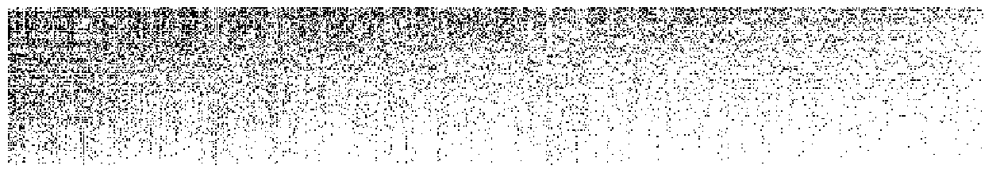

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Routine to reorder the matrix based on given row and column order
def matrix_ordering(matrix, order_row, order_columns):
    """
    Reorders the input matrix based on specified row and column order.

    Parameters:
    - matrix (pd.DataFrame): Input matrix to reorder.
    - order_row (pd.Index or list): Order for rows.
    - order_columns (pd.Index or list): Order for columns.

    Returns:
    - pd.DataFrame: Reordered matrix.
    """
    # Reindex the matrix based on the specified row and column orders
    ordered_matrix = matrix.reindex(index=order_row, columns=order_columns)
    return ordered_matrix

# Define colormap and input matrix for the specified year
colormap = 'binary'
mcp = binary_rca[end_year]

# Order rows and columns by descending sums
ordered_row = mcp.sum(axis=1).sort_values(ascending=False).index
ordered_columns = mcp.sum(axis=0).sort_values(ascending=False).index

# Reorder the matrix
ordered_matrix = matrix_ordering(mcp, ordered_row, ordered_columns)

# Plot the ordered matrix
plt.matshow(ordered_matrix, cmap=colormap)
plt.gca().set_axis_off()
plt.show()

In [ ]:
len(binary_rca[1976].loc['KOR'][binary_rca[1976].loc['KOR']==1].index)

168

In [ ]:
eci.loc['KOR']

,KOR
1962,0.236066
1963,0.472573
1964,0.687809
1965,0.848601
1966,0.698960
1967,0.755053
1968,0.769993
1969,0.760854
1970,0.683647
1971,0.620337


# Proximity

The first study of relatedness in Economic Complexity, is the Product Space (Hidalgo 2007), based on exported products.
The similitude is evaluated using the **proximity**, a measure of normalized export pair co-occurrence:
$$\large S_{p p'} = \frac{1}{max(u_p,u_{p'})}\sum_{c}M_{c p} M_{c p'}, \qquad u_p = \sum_cM_{cp}.$$

The proximity was described as the *conditional probability of exporting good product i given that you export good j*, (although it has not a clear structure of a conditional probability).


In [ ]:
def Proximity_network(M, rows=False):
    if rows:
        M = M.transpose()
    Cooc = np.matmul(np.transpose(M),M)
    ubiquity = M.sum(0)
    ubiMat = np.tile(ubiquity,[M.shape[1],1])
    ubiMax = np.maximum(ubiMat,np.transpose(ubiMat)).astype(float)
    np.divide(np.ones_like(ubiMax,dtype=float), ubiMax, out=ubiMax, where=ubiMax != 0)
    Product_Space = np.multiply(Cooc,ubiMax)
    return Product_Space

In [ ]:
Proximity_network(binary_rca[end_year].to_numpy()).shape

(774, 774)

In [ ]:
proximity = {}
for year in tqdm(range(start_year, end_year+1)):
    proximity[year] = Proximity_network(binary_rca[year].to_numpy().copy())

100%|██████████| 59/59 [00:03<00:00, 16.25it/s]


In [ ]:
ubiquity

,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,...,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
sitc_product_code,,,,,,,,,,,,,,,,,,,,,
0011,18,21,22,23,23,23,21,22,22,22,...,31,35,35,34,38,35,36,33,36,32
0012,12,15,14,13,18,18,17,17,21,14,...,19,23,22,19,18,18,19,21,25,26
0013,14,15,13,12,12,12,7,6,7,7,...,18,18,17,16,17,17,14,15,14,17
0014,10,9,12,9,13,13,17,14,15,13,...,24,24,28,25,27,27,27,29,26,27
0015,13,17,17,19,17,16,17,16,18,18,...,13,16,15,14,15,15,13,13,12,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZZZZ,0,0,0,0,0,0,0,0,0,0,...,9,3,0,1,2,1,0,1,0,3
financial,0,0,0,0,0,0,0,0,0,0,...,10,16,15,12,13,14,13,14,14,0
transport,0,0,0,0,0,0,0,0,0,0,...,56,55,55,55,56,61,54,55,56,0


# Relatedness Density

*Following the literature, we define predictive models from the relatedness topologies by considering the density of products in which a country has RCA > 1 around the target product p weighted by the relatedness score. More precisely, given a relatedness matrix B computed on data that excludes country c, we define*

$$ \mathcal{M}_p\left( M^t_{cp} \right) = \mathcal{S}_{c,p}^{t+\delta} = \frac{\sum_{p'}B_{pp'}M_{cp'}^t}{\sum_{p'}B_{pp'}} $$

(Tacchella 2021)

In [ ]:
def density_calculation(similarity_matrix, mcp, type = 'relatedness'):
    similarity_matrix = similarity_matrix.copy()
    similarity_matrix = similarity_matrix.transpose()
    row = similarity_matrix.sum(1)
    row[row == 0] = 1
    if type == 'relatedness':
      pr = np.dot(mcp, similarity_matrix) / row
      pr = np.nan_to_num(pr)
    elif type == 'imitation':
        # Calculate imitation density
        similarity_matrix = similarity_matrix.fillna(0)
        pr = np.dot(similarity_matrix, mcp)

        # Convert to DataFrame for easier handling and ensure alignment
        pr = pd.DataFrame(pr, index=similarity_matrix.index, columns=mcp.columns)

        # Normalize each row by row sums, avoiding division by zero
        pr = pr.div(row, axis=0).fillna(0)  # Dividing by row-wise sums and filling NaNs with 0
    return pr

In [ ]:
relatedness_density = {}
for year in range(start_year, end_year+1):
    relatedness_density[year] = pd.DataFrame(density_calculation(proximity[year].copy(), binary_rca[year].copy(),type = 'relatedness'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
relatedness_density[year]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.004959,0.007041,0.002535,0.003956,0.003002,0.006845,0.004063,0.002700,0.003761,0.003534,...,0.005993,0.008410,0.004905,0.003164,0.013671,0.004675,0.0,0.0,0.0,0.0
ALB,0.188977,0.207236,0.138472,0.174553,0.100431,0.164791,0.175844,0.111908,0.139719,0.141633,...,0.179103,0.224375,0.127113,0.105744,0.234274,0.137582,0.0,0.0,0.0,0.0
ARE,0.073119,0.083192,0.058274,0.068402,0.053847,0.078429,0.063703,0.048868,0.065125,0.058085,...,0.077271,0.090646,0.065064,0.056397,0.132142,0.063354,0.0,0.0,0.0,0.0
ARG,0.188867,0.204071,0.148560,0.161785,0.186227,0.261411,0.219850,0.150138,0.198836,0.202966,...,0.182719,0.187029,0.139579,0.134393,0.253691,0.057421,0.0,0.0,0.0,0.0
AUS,0.158925,0.179347,0.108580,0.113611,0.166502,0.197502,0.230132,0.111515,0.123730,0.131303,...,0.150069,0.138590,0.108045,0.161753,0.211512,0.065708,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.187230,0.190499,0.166343,0.184470,0.152070,0.183545,0.178710,0.128788,0.164196,0.145922,...,0.165651,0.196035,0.155405,0.113246,0.226915,0.264007,0.0,0.0,0.0,0.0
YEM,0.041731,0.044766,0.028534,0.034933,0.024686,0.048087,0.045046,0.025994,0.030819,0.032098,...,0.045470,0.047704,0.027359,0.024437,0.075478,0.019464,0.0,0.0,0.0,0.0
ZAF,0.209525,0.263816,0.162403,0.190164,0.169726,0.227216,0.247593,0.164282,0.185519,0.183982,...,0.205634,0.244466,0.207738,0.225718,0.310858,0.121451,0.0,0.0,0.0,0.0


In [ ]:
relatedness_density[year].shape

(124, 774)

# Relative relatedness

# Relative Relatedness

Unlike relatedness ($\omega_{cp}$), which is an absolute measure, relative relatedness ($\tilde{\omega}_{cp}$) is a measure that compares the relatedness of a country’s new activities with the average relatedness of the activities in the country’s option set (activities with $R_{cp} < 1$). The relative relatedness of country $c$ in product $p$, in year $y$, is computed as a simple z-transform:

$$
\tilde{\omega}_{cp} = \frac{\omega_{cp} - \frac{\sum_{p'} \omega_{cp'}}{N_{Oc}}}{\sigma_{\omega_{cp'}}}
\tag{7}
$$

where $\frac{\sum_{p'} \omega_{cp'}}{N_{Oc}}$ is the simple average relatedness of all products ($p'$) in $O_c$, $N_{Oc}$ is the number of products in the set of opportunities of country $c$, and $\sigma_{\omega_{cp'}}$ is the standard deviation of the relatedness of the products ($p'$) in $O_c$.

Relative relatedness ($\tilde{\omega}_{cp}$) is comparable across countries because it indicates whether a location enters a product that was more or less related than the average product in its option set. Note that we are omitting the year index from all the formulas, but these quantities are measured independently on a year-by-year basis.


In [ ]:
Opportunity = {}
for year in range(start_year, end_year+1):
  Opportunity[year] = binary_rca[year].copy()
  # Transform Opportunity: Set values of 1 to 0 and other values to 1
  Opportunity[year] = Opportunity[year].applymap(lambda x: 0 if x == 1 else 1)

<ipython-input-48-a4c0129cbb5c>:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  Opportunity[year] = Opportunity[year].applymap(lambda x: 0 if x == 1 else 1)


In [ ]:
Relative_relatedness_density = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = relatedness_density[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country]!=0].index
    temp_std = relatedness_density[year].loc[temp_country][Ops].std()
    temp_mean = relatedness_density[year].loc[temp_country][Ops].mean()
    relative_density = (relatedness_density[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_relatedness_density[year] = temp_mat

100%|██████████| 59/59 [00:07<00:00,  8.41it/s]


## Validation

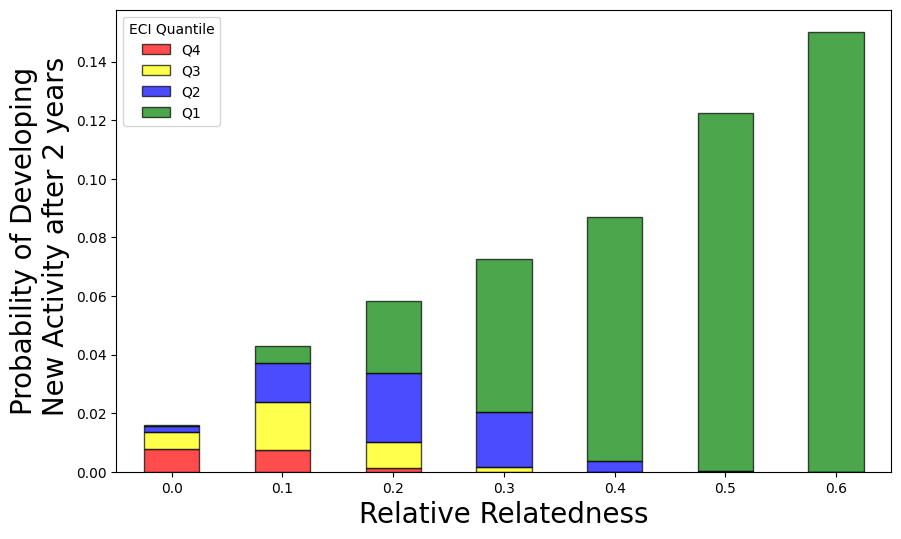

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * relatedness_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * relatedness_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * relatedness_density[year]) > i) & \
                               ((Opportunity[year] * relatedness_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Relatedness",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


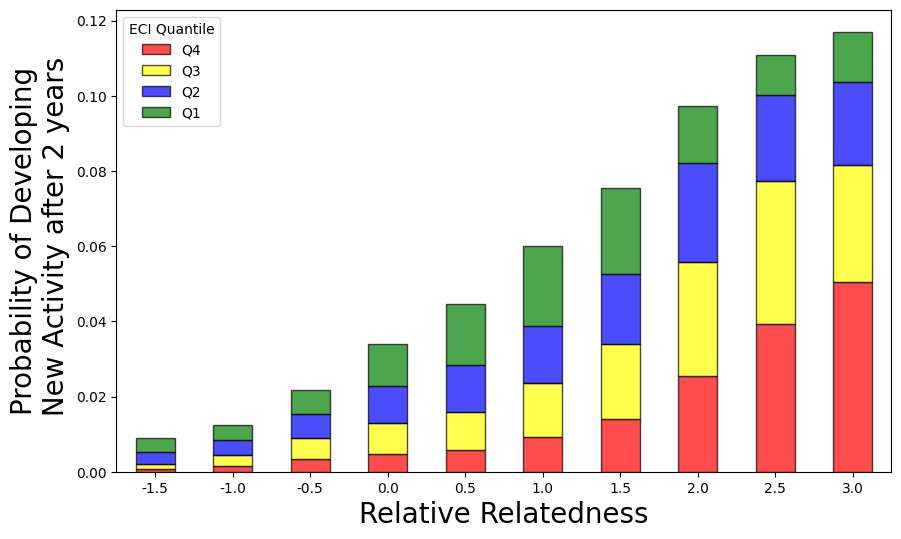

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * Relative_relatedness_density[year]) > i) & \
                               ((Opportunity[year] * Relative_relatedness_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Relatedness",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


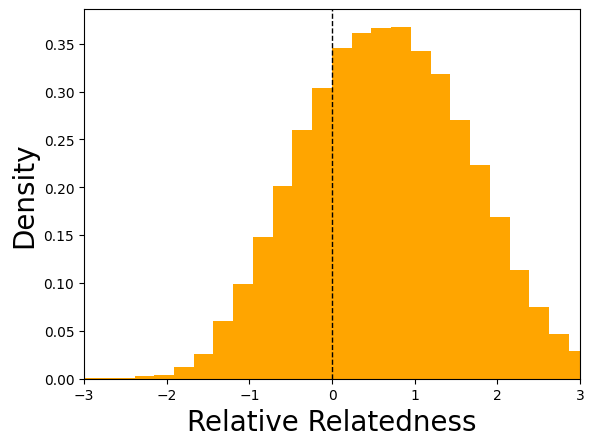

In [ ]:
temp_list = []
for year in years:
  temp_df = binary_rca[year+2] * Opportunity[year] * Relative_relatedness_density[year]
  temp_df = temp_df[temp_df!=0].values
  valid_values = temp_df[~np.isnan(temp_df)]
  temp_list.extend(list(valid_values))
plt.hist(temp_list,density = True,bins = 100, color = 'orange')
plt.xlim(-3,3)
plt.axvline(x= 0, color='black', linestyle='dashed', linewidth=1)
plt.xlabel("Relative Relatedness",fontsize = 20)
plt.ylabel("Density",fontsize = 20)
plt.show()

# Relative PCI

The relative complexity of a product ($\tilde{\text{PCI}}_{cp}$) compares its complexity to the average complexity (PCI) of all products in a country’s option set. Formally, the relative complexity of product $p$ in country $c$ is defined as:

$$
\tilde{\text{PCI}}_{cp} = \frac{\text{PCI}_{cp} - \frac{\sum_{p'} \text{PCI}_{cp'}}{N_{O_c}}}{\sigma_{\text{PCI}_{cp'}}}
\tag{9}
$$

where $\frac{\sum_{p'} \text{PCI}_{cp'}}{N_{O_c}}$ is the simple average PCI of all products ($p'$) in $O_c$, and $\sigma_{\text{PCI}_{cp'}}$ is the standard deviation of the PCI of the same set of products.

This measure of relative complexity indicates whether a location entered an activity that was more or less complex than the average activity that was not yet present in that location.


In [ ]:
Relative_pci = {}

for year in tqdm(range(start_year, end_year + 1)):
    # Initialize a matrix with zeros, same shape as binary_rca[start_year]
    temp_mat = pd.DataFrame(np.zeros((len(binary_rca[start_year].index), len(binary_rca[start_year].columns))),
                            index=binary_rca[start_year].index, columns=binary_rca[start_year].columns)

    # Loop through each country in the index
    for temp_country in temp_mat.index:
        # Get the opportunity set (Ops) for the country, filtering non-zero columns
        Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country] != 0].index

        # Calculate mean and standard deviation of PCI for the opportunity set
        if not Ops.empty:
            temp_std = pci[year].loc[Ops].std()
            temp_mean = pci[year].loc[Ops].mean()

            # Calculate relative PCI, only for products in Ops
            relative_pci = (pci[year] - temp_mean) / temp_std
            relative_pci = relative_pci.fillna(0)  # Reindex to ensure all columns are included

            # Assign relative PCI to the corresponding row in temp_mat
            temp_mat.loc[temp_country] = relative_pci

    # Store the matrix for the year
    Relative_pci[year] = temp_mat

100%|██████████| 59/59 [00:06<00:00,  8.97it/s]


In [ ]:
eci

,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,...,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,-0.866697,-1.407475,-1.422261,-1.305573,-1.343270,-1.316934,-1.385132,-1.147416,-1.401312,-1.438635,...,-1.260432,-1.591623,-1.108300,-1.266715,-0.879522,-0.982967,-1.589656,-1.310142,-1.119552,-1.958862
ALB,-0.809401,-0.002639,-1.097746,-0.741417,-0.008608,0.204942,-0.026815,-0.000123,-0.155587,-0.053914,...,-0.716614,-0.576293,-0.687341,-0.796360,-0.854572,-0.826728,-0.625270,-0.832191,-0.758087,-0.305690
ARE,0.775018,0.727728,0.742918,0.757007,0.718546,0.509918,1.104752,0.178428,-1.192381,-0.634587,...,-0.198629,0.078623,-0.343754,-0.161675,-0.078646,-0.065005,0.204194,-0.132153,-0.182620,-0.282790
ARG,-0.546232,-0.530644,-0.055735,-0.166190,-0.469294,-0.141198,-0.126056,-0.060153,-0.249722,-0.240254,...,-0.047180,0.005066,-0.041981,-0.093679,-0.161520,-0.397396,-0.317356,-0.305126,-0.428459,-0.362371
AUS,-0.188033,-0.079855,-0.005306,-0.004555,0.238128,0.032946,-0.058161,-0.146963,-0.223386,-0.192868,...,-0.423558,-0.515346,-0.579229,-0.630204,-0.517458,-0.545884,-0.630239,-0.575593,-0.491907,-0.478055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,-0.511349,-0.702315,-0.639607,-0.469401,-0.145521,-0.402323,0.243102,-0.246555,-0.275495,-0.124998,...,0.017241,0.069635,-0.037209,0.046835,-0.062625,-0.003348,-0.002686,0.032839,-0.016375,0.060242
YEM,-1.217601,-1.448417,-1.084282,-1.026886,-1.178300,-1.100781,-0.911485,-0.734454,-1.229252,-1.317015,...,-0.938613,-1.200396,-1.285125,-1.254680,-0.816294,-1.163876,-1.218860,-1.374111,-1.207763,-1.005572
ZAF,-0.511874,-0.614908,-0.590698,-0.627929,-0.570145,-0.503164,-0.647063,-0.664358,-0.524193,-0.468329,...,-0.061343,0.022751,-0.004294,0.062893,-0.036285,-0.068831,-0.048925,-0.024953,-0.046907,-0.174277


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the years range
years = range(1984, 1996)

# Initialize lists to store x and y values for the scatter plot
x_list = []
y_list = []
year_list = []
country_list = []
# Loop through each year and filter the data
for year in years:
    mask = (Opportunity[year] * binary_rca[year + 2]) == 1
    for temp_country in mask.index:
        for temp_product in mask.columns:
            if mask.loc[temp_country, temp_product]:
                x_list.append(Relative_pci[year].loc[temp_country, temp_product])
                y_list.append(Relative_relatedness_density[year].loc[temp_country, temp_product])
                year_list.append(year)
                country_list.append(temp_country)

In [ ]:
temp_df = pd.DataFrame(list(zip(x_list, y_list, year_list, country_list)), columns=['Relative PCI', 'Relative Relatedness', 'year', 'country'])
temp_df['ECI'] = temp_df[['country','year']].apply(lambda x: eci[x[1]].loc[x[0]],axis = 1)
temp_df.head()

<ipython-input-56-c8c2a0d301b8>:2: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  temp_df['ECI'] = temp_df[['country','year']].apply(lambda x: eci[x[1]].loc[x[0]],axis = 1)


,Relative PCI,Relative Relatedness,year,country,ECI
0,-1.376776,1.787021,1984,AGO,-1.960763
1,-1.036683,1.537718,1984,AGO,-1.960763
2,-1.141763,1.287028,1984,AGO,-1.960763
3,-0.658598,0.713706,1984,ALB,-0.383354
4,-0.328956,0.480511,1984,ALB,-0.383354


In [ ]:
temp_result_list = []
for temp_country in temp_df['country'].unique():
  for year in temp_df['year'].unique():
    temp_list = []
    temp_list.append(temp_country)
    temp_list.append(year)
    temp_df2 = temp_df[(temp_df['country'] == temp_country) & (temp_df['year'] == year)]
    temp_list.append(temp_df2['Relative PCI'].mean())
    temp_list.append(temp_df2['Relative Relatedness'].mean())
    temp_result_list.append(temp_list)

plot_df = pd.DataFrame(temp_result_list)
plot_df.columns = ['country', 'year', 'Relative PCI', 'Relative Relatedness']
plot_df['ECI'] = plot_df[['country','year']].apply(lambda x: eci[x[1]].loc[x[0]],axis = 1)
plot_df.dropna(inplace=True)
plot_df = plot_df[plot_df['year'].isin(range(1984,2018))]
plot_df.head()


<ipython-input-57-de12a50e4d7d>:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plot_df['ECI'] = plot_df[['country','year']].apply(lambda x: eci[x[1]].loc[x[0]],axis = 1)


,country,year,Relative PCI,Relative Relatedness,ECI
0,AGO,1984,-1.185074,1.537256,-1.960763
1,AGO,1985,-0.602060,0.550280,-2.007515
2,AGO,1986,-1.283968,2.266798,-1.544180
3,AGO,1987,-1.084038,3.129649,-1.362244
4,AGO,1988,-0.930313,1.850954,-1.630637


<ipython-input-58-71c8906340c9>:25: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


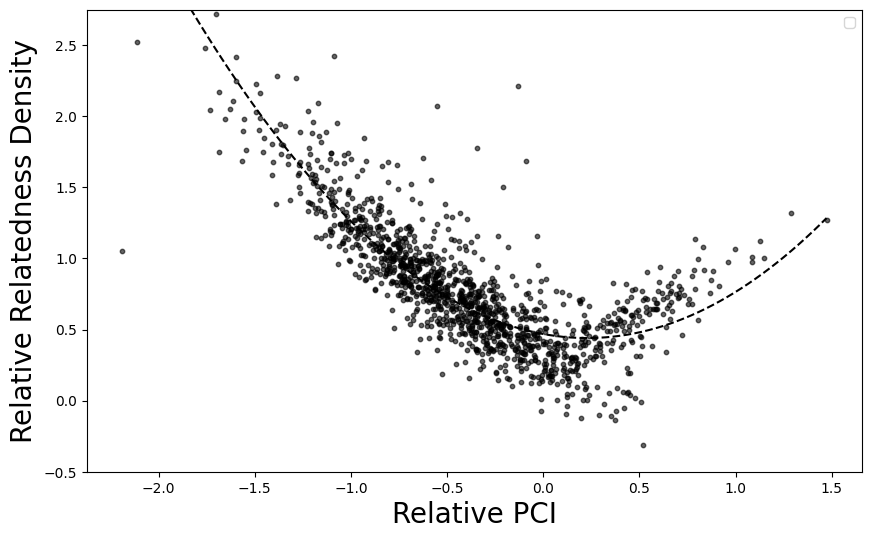

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Remove NaN values from the data
filtered_df = plot_df[['Relative PCI', 'Relative Relatedness']].dropna()

plt.figure(figsize=(10, 6))

# Scatter plot
plt.scatter(
    filtered_df['Relative PCI'], filtered_df['Relative Relatedness'],
    alpha=0.6, color='black', s=10
)

# Fit and plot the 2nd degree polynomial trendline
z = np.polyfit(filtered_df['Relative PCI'], filtered_df['Relative Relatedness'], 2)  # Fit a 2nd-degree polynomial
p = np.poly1d(z)  # Create a polynomial function
trendline_x = np.linspace(filtered_df['Relative PCI'].min(), filtered_df['Relative PCI'].max(), 100)  # Generate x values
plt.plot(trendline_x, p(trendline_x), color='black', linestyle='--')

# Set labels and title
plt.xlabel("Relative PCI",fontsize = 20)
plt.ylabel("Relative Relatedness Density",fontsize = 20)
plt.ylim(-0.5, 2.75)
plt.legend()
#plt.title("Scatter Plot with 2nd Degree Trendline")
plt.show()



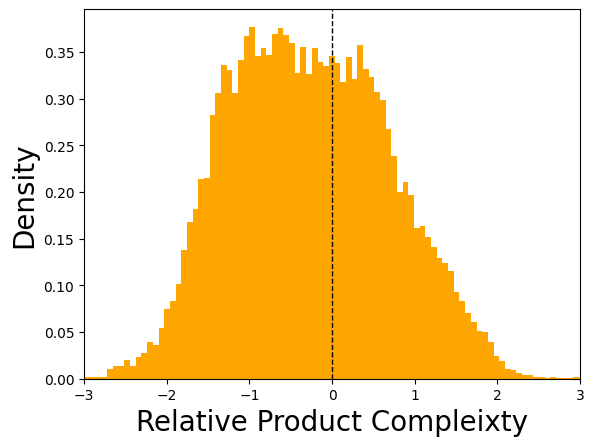

In [ ]:
temp_list = []
for year in years:
  temp_df = binary_rca[year+2] * Opportunity[year] * Relative_pci[year]
  temp_df = temp_df[temp_df!=0].values
  valid_values = temp_df[~np.isnan(temp_df)]
  temp_list.extend(list(valid_values))
plt.hist(temp_list,density = True,bins = 100, color = 'orange')
plt.xlim(-3,3)
plt.axvline(x= 0, color='black', linestyle='dashed', linewidth=1)
plt.xlabel("Relative Product Compleixty",fontsize = 20)
plt.ylabel("Density",fontsize = 20)
plt.show()

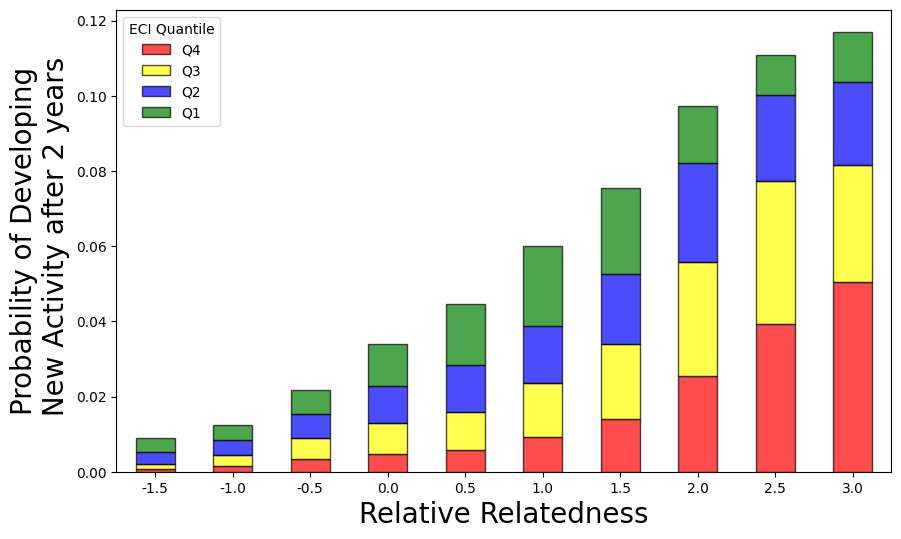

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * Relative_relatedness_density[year]) > i) & \
                               ((Opportunity[year] * Relative_relatedness_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative Relatedness",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


In [ ]:
years

range(1984, 2011)

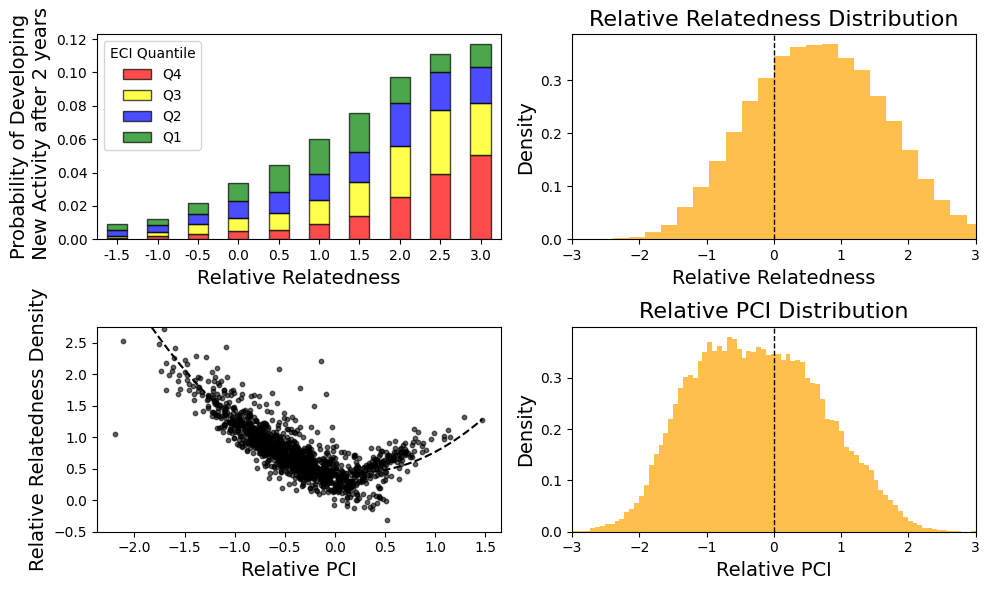

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * Relative_relatedness_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * Relative_relatedness_density[year]) > i) & \
                               ((Opportunity[year] * Relative_relatedness_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Define figure and axes for 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(14, 12))


# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors, ax = axes[0, 0])
axes[0, 0].set_xlabel("Relative Relatedness", fontsize=14)
axes[0, 0].set_ylabel("Probability of Developing\n New Activity after 2 years", fontsize=14)
#axes[0, 0].set_title("Stacked Bar Chart", fontsize=16)
axes[0, 0].legend(title="ECI Quantile")
axes[0, 0].tick_params(axis='x', rotation=0)

# Plot 2: Histogram (Relative Relatedness Density)
temp_list = []
for year in years:
    temp_df = binary_rca[year+2] * Opportunity[year] * Relative_relatedness_density[year]
    temp_df = temp_df[temp_df != 0].values
    valid_values = temp_df[~np.isnan(temp_df)]
    temp_list.extend(list(valid_values))

axes[0, 1].hist(temp_list, density=True, bins=100, color='orange', alpha=0.7)
axes[0, 1].set_xlim(-3, 3)
axes[0, 1].axvline(x=0, color='black', linestyle='dashed', linewidth=1)
axes[0, 1].set_xlabel("Relative Relatedness", fontsize=14)
axes[0, 1].set_ylabel("Density", fontsize=14)
axes[0, 1].set_title("Relative Relatedness Distribution", fontsize=16)

# Plot 3: Scatter Plot with Trendline
filtered_df = plot_df[['Relative PCI', 'Relative Relatedness']].dropna()
axes[1, 0].scatter(
    filtered_df['Relative PCI'], filtered_df['Relative Relatedness'],
    alpha=0.6, color='black', s=10
)
z = np.polyfit(filtered_df['Relative PCI'], filtered_df['Relative Relatedness'], 2)
p = np.poly1d(z)
trendline_x = np.linspace(filtered_df['Relative PCI'].min(), filtered_df['Relative PCI'].max(), 100)
axes[1, 0].plot(trendline_x, p(trendline_x), color='black', linestyle='--')
axes[1, 0].set_xlabel("Relative PCI", fontsize=14)
axes[1, 0].set_ylabel("Relative Relatedness Density", fontsize=14)
axes[1, 0].set_ylim(-0.5, 2.75)
#axes[1, 0].set_title("Scatter Plot with Trendline", fontsize=16)

# Plot 4: Histogram (Relative PCI)
temp_list = []
for year in years:
    temp_df = binary_rca[year+2] * Opportunity[year] * Relative_pci[year]
    temp_df = temp_df[temp_df != 0].values
    valid_values = temp_df[~np.isnan(temp_df)]
    temp_list.extend(list(valid_values))

axes[1, 1].hist(temp_list, density=True, bins=100, color='orange', alpha=0.7)
axes[1, 1].set_xlim(-3, 3)
axes[1, 1].axvline(x=0, color='black', linestyle='dashed', linewidth=1)
axes[1, 1].set_xlabel("Relative PCI", fontsize=14)
axes[1, 1].set_ylabel("Density", fontsize=14)
axes[1, 1].set_title("Relative PCI Distribution", fontsize=16)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


# Country Export Structure and Export Similarity

We define a country vector $ \mathbf{v}_c $ that lists the RCA values of products. This vector represents a country’s export structure (Bahar et al., 2014). Then, export similarity $ \phi_{ij}^c $ between countries' export structures can be measured using the cosine similarity between vectors, as shown in Equation follow:

$$
\mathbf{v}_c = [\text{RCA}_{c1}, \text{RCA}_{c2}, \text{RCA}_{c3}, \dots, \text{RCA}_{cN}]
$$

$$
\phi_{ij}^c = \text{cosine similarity}(\mathbf{v}_i, \mathbf{v}_j) \tag{Eq.}
$$


In [ ]:
import seaborn as sns

In [ ]:
def cosine_similarity(x, y):
  if np.linalg.norm(x) == 0 or np.linalg.norm(y) == 0:
    return None
  else:
    return np.dot(x, y) / (np.linalg.norm(x) * np.linalg.norm(y))
cosine_similarity(np.array([1,2,3]),np.array([2,4,6]))

1.0

In [ ]:
from scipy.spatial.distance import pdist, squareform, cosine

Export_Similarity = {}
for year in tqdm(range(start_year, end_year + 1)):
    # Extract matrix values as a 2D NumPy array for faster processing
    matrix = binary_rca[year].values

    # Compute pairwise cosine distances and convert to a export similarity matrix
    cosine_distances = pdist(matrix, metric='cosine')
    cosine_similarity_matrix = 1 - squareform(cosine_distances)  # Convert distances to similarities

    # Create DataFrame for similarity with indices and columns of binary_rca[year]
    indices = binary_rca[year].index
    Export_Similarity[year] = pd.DataFrame(cosine_similarity_matrix, index=indices, columns=indices)
    Export_Similarity[year].fillna(0, inplace= True)

100%|██████████| 59/59 [00:00<00:00, 305.47it/s]


In [ ]:
!pip install xlrd==2.0.1

In [ ]:
geo_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/geo_cepii.xls')
dist_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/dist_cepii.xls')


Dist_m = pd.DataFrame(np.zeros(shape = (len(Export_Similarity[year].columns),len(Export_Similarity[year].columns))),index = Export_Similarity[year].columns, columns = Export_Similarity[year].columns)
for i in tqdm(Export_Similarity[year].index):
  for j in Export_Similarity[year].columns:
    try:
      Dist_m.loc[i,j] = dist_df[(dist_df['iso_o']==i) & (dist_df['iso_d']==j)].iloc[0]['dist']
    except:
      Dist_m.loc[i,j] = None

CapDist_m = pd.DataFrame(np.zeros(shape = (len(Export_Similarity[year].columns),len(Export_Similarity[year].columns))),index = Export_Similarity[year].columns, columns = Export_Similarity[year].columns)
for i in tqdm(Export_Similarity[year].index):
  for j in Export_Similarity[year].columns:
    try:
      CapDist_m.loc[i,j] = dist_df[(dist_df['iso_o']==i) & (dist_df['iso_d']==j)].iloc[0]['distcap']
    except:
      CapDist_m.loc[i,j] = None

100%|██████████| 124/124 [01:33<00:00,  1.33it/s]


In [ ]:
Export_Similarity[year]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,1.000000,0.083045,0.186052,0.042448,0.046374,0.027420,0.077850,0.055470,0.000000,0.059761,...,0.036515,0.000000,0.054534,0.000000,0.084515,0.036394,0.172133,0.074023,0.055048,0.122859
ALB,0.083045,1.000000,0.167384,0.149816,0.154046,0.182171,0.177790,0.155471,0.435159,0.353608,...,0.227429,0.134790,0.090576,0.265729,0.175466,0.362680,0.178685,0.192103,0.137145,0.242319
ARE,0.186052,0.167384,1.000000,0.105300,0.172559,0.110535,0.265543,0.240807,0.054162,0.185312,...,0.158519,0.115039,0.169103,0.176394,0.235864,0.067711,0.213504,0.275444,0.204837,0.228582
ARG,0.042448,0.149816,0.105300,1.000000,0.334639,0.168770,0.165227,0.288435,0.049428,0.260015,...,0.271244,0.452746,0.312504,0.231404,0.125562,0.146759,0.146132,0.329922,0.186933,0.221641
AUS,0.046374,0.154046,0.172559,0.334639,1.000000,0.139875,0.072204,0.205789,0.000000,0.207853,...,0.228600,0.397849,0.246574,0.153883,0.176369,0.084386,0.179605,0.369021,0.229752,0.227898
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.036394,0.362680,0.067711,0.146759,0.084386,0.159669,0.099164,0.105985,0.370812,0.315366,...,0.225915,0.109702,0.094273,0.189775,0.123033,1.000000,0.156614,0.148169,0.130222,0.100604
YEM,0.172133,0.178685,0.213504,0.146132,0.179605,0.082599,0.100504,0.095482,0.125274,0.141445,...,0.047140,0.119737,0.093871,0.081599,0.254588,0.156614,1.000000,0.143346,0.142134,0.105740
ZAF,0.074023,0.192103,0.275444,0.329922,0.369021,0.208049,0.216102,0.272027,0.075422,0.259895,...,0.263538,0.240292,0.297714,0.228088,0.172043,0.148169,0.143346,1.000000,0.356549,0.306937


In [ ]:
len(['Country1', 'Country2', 'Dist','CapDist']+[year for year in range(start_year,end_year+1)])

63

In [ ]:
temp_result_list[0]

['AGO', 1984, -1.1850736425019903, 1.5372556895779887]

In [ ]:
temp_result_list = []

for i in tqdm(range(len(CapDist_m.index))):
  for j in range(i+1,len(CapDist_m.columns)):
    temp_list = []
    country_i = CapDist_m.index[i]
    country_j = CapDist_m.columns[j]
    temp_list.append(country_i)
    temp_list.append(country_j)
    temp_list.append(Dist_m.loc[country_i,country_j])
    temp_list.append(CapDist_m.loc[country_i,country_j])
    for year in range(start_year,end_year+1):
      temp_list.append(Export_Similarity[year].loc[country_i,country_j])
    temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list,
                       columns = ['Country1', 'Country2', 'Dist','CapDist']+[year for year in range(start_year,end_year+1)])

100%|██████████| 124/124 [00:03<00:00, 36.38it/s]


In [ ]:
len(temp_df)

7626

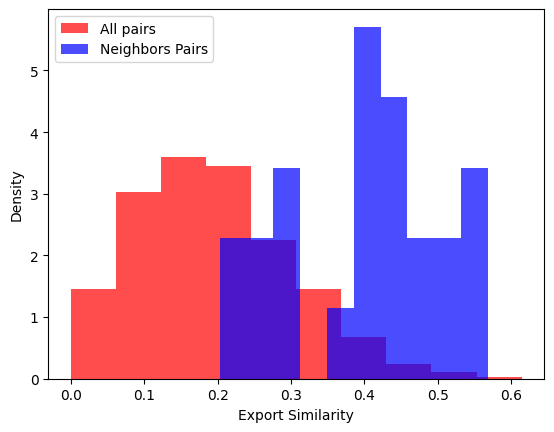

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Make a copy and filter the DataFrame
temp_df2 = temp_df.copy()
temp_df2 = temp_df[['Dist', 2000]]

# Calculate the mean of the 'Dist' column
mean_dist = np.mean(temp_df2['Dist'])

# Plot histograms with density=True
plt.hist(
    temp_df2[temp_df2['Dist']>=0][2000].dropna(),
    color='red',
    density=True,
    alpha=0.7,
    label='All pairs'
)
plt.hist(
    temp_df2[temp_df2['Dist'] < 250][2000].dropna(),
    color='blue',
    density=True,
    alpha=0.7,
    label='Neighbors Pairs'
)

# Add labels and legend
plt.xlabel('Export Similarity')
plt.ylabel('Density')
plt.legend()
plt.show()


<Axes: xlabel='Dist', ylabel='2018'>

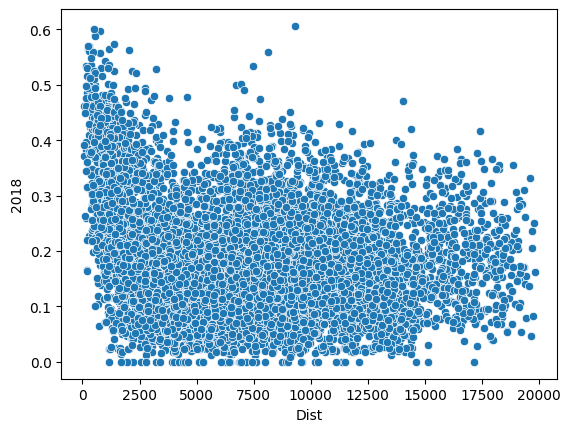

In [ ]:
sns.scatterplot(data = temp_df, x = 'Dist', y = 2018)

<Axes: xlabel='Dist', ylabel='CapDist'>

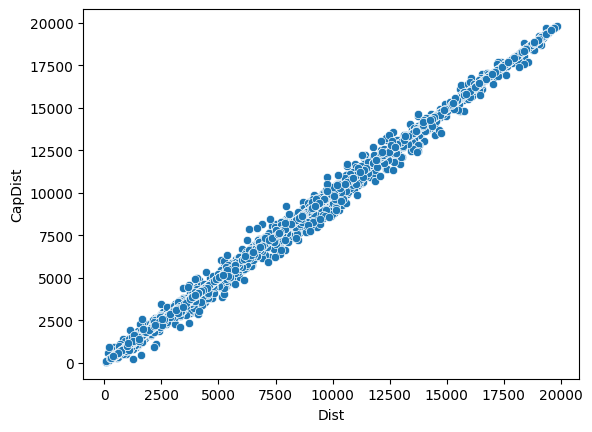

In [ ]:
sns.scatterplot(data = temp_df, x = 'Dist', y = 'CapDist')

<ipython-input-76-e55c8ae1ab68>:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)


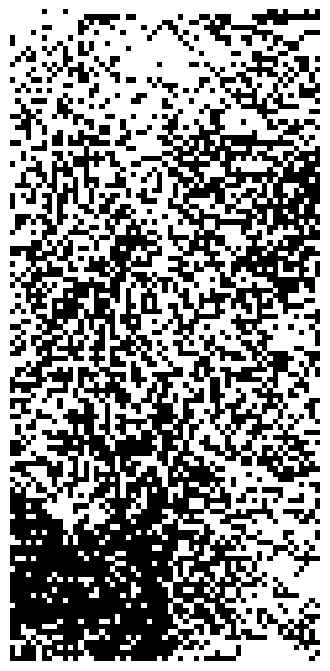

In [ ]:
input_country = 'VNM'

temp_result_list = []
for year in range(start_year, end_year + 1):
  temp_list = Export_Similarity[year].loc[input_country].sort_values(ascending=False).index.tolist()
  temp_list = [eci[year][item] for item in temp_list]
  temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list)
temp_df = temp_df.T
temp_df.columns = [year for year in range(start_year, end_year + 1)]
temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)
colormap = 'binary'
plt.matshow(temp_df, cmap = colormap)
plt.gca().set_axis_off()
plt.show()

<ipython-input-77-76f0432cce13>:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)


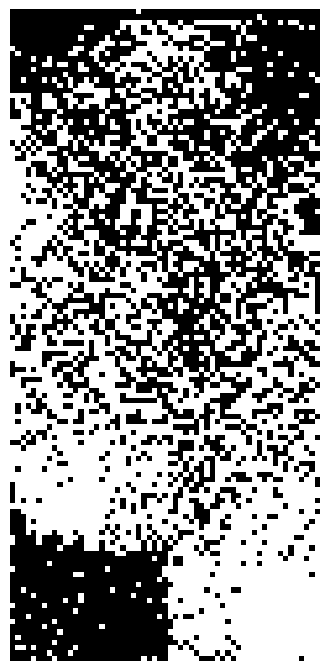

In [ ]:
input_country = 'CHN'

temp_result_list = []
for year in range(start_year, end_year + 1):
  temp_list = Export_Similarity[year].loc[input_country].sort_values(ascending=False).index.tolist()
  temp_list = [eci[year][item] for item in temp_list]
  temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list)
temp_df = temp_df.T
temp_df.columns = [year for year in range(start_year, end_year + 1)]
temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)
colormap = 'binary'
plt.matshow(temp_df, cmap = colormap)
plt.gca().set_axis_off()
plt.show()

<ipython-input-78-cb544b0b0398>:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)


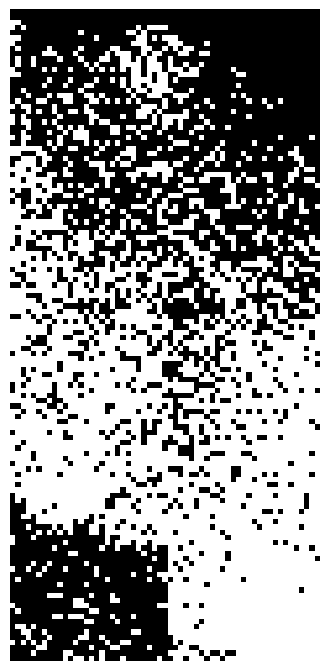

In [ ]:
input_country = 'KOR'

temp_result_list = []
for year in range(start_year, end_year + 1):
  temp_list = Export_Similarity[year].loc[input_country].sort_values(ascending=False).index.tolist()
  temp_list = [eci[year][item] for item in temp_list]
  temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list)
temp_df = temp_df.T
temp_df.columns = [year for year in range(start_year, end_year + 1)]
temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)
colormap = 'binary'
plt.matshow(temp_df, cmap = colormap)
plt.gca().set_axis_off()
plt.show()

<ipython-input-79-374c333e8e24>:12: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)


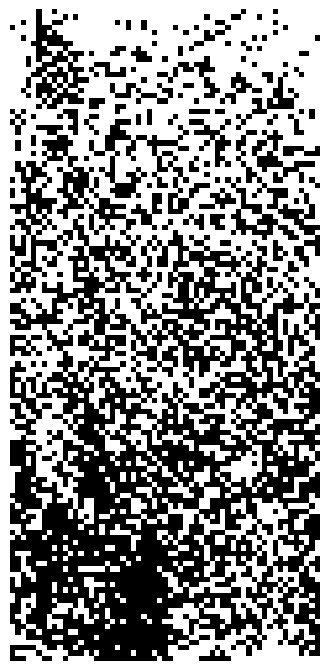

In [ ]:
input_country = 'CUB'

temp_result_list = []
for year in range(start_year, end_year + 1):
  temp_list = Export_Similarity[year].loc[input_country].sort_values(ascending=False).index.tolist()
  temp_list = [eci[year][item] for item in temp_list]
  temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list)
temp_df = temp_df.T
temp_df.columns = [year for year in range(start_year, end_year + 1)]
temp_df = temp_df.applymap(lambda x: 1 if x >= 0 else 0)
colormap = 'binary'
plt.matshow(temp_df, cmap = colormap)
plt.gca().set_axis_off()
plt.show()

## Proximity using Mcc

In [ ]:
M= binary_rca[2018]
Cooc = np.matmul(M,np.transpose(M))
div = M.sum(1)
divMat = np.tile(div,[M.shape[0],1])
divMax = np.maximum(divMat,np.transpose(divMat)).astype(float)
Country_proximity = np.divide(np.ones_like(divMax,dtype=float), divMax, out=divMax, where=divMax != 0)
pd.DataFrame(Country_proximity, index=M.index, columns=M.index)

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.062500,0.012346,0.014085,0.007519,0.010417,0.003861,0.037037,0.003817,0.015625,0.004202,...,0.005618,0.010753,0.004808,0.012658,0.035714,0.005464,0.018182,0.005495,0.013699,0.016667
ALB,0.012346,0.012346,0.012346,0.007519,0.010417,0.003861,0.012346,0.003817,0.012346,0.004202,...,0.005618,0.010753,0.004808,0.012346,0.012346,0.005464,0.012346,0.005495,0.012346,0.012346
ARE,0.014085,0.012346,0.014085,0.007519,0.010417,0.003861,0.014085,0.003817,0.014085,0.004202,...,0.005618,0.010753,0.004808,0.012658,0.014085,0.005464,0.014085,0.005495,0.013699,0.014085
ARG,0.007519,0.007519,0.007519,0.007519,0.007519,0.003861,0.007519,0.003817,0.007519,0.004202,...,0.005618,0.007519,0.004808,0.007519,0.007519,0.005464,0.007519,0.005495,0.007519,0.007519
AUS,0.010417,0.010417,0.010417,0.007519,0.010417,0.003861,0.010417,0.003817,0.010417,0.004202,...,0.005618,0.010417,0.004808,0.010417,0.010417,0.005464,0.010417,0.005495,0.010417,0.010417
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.005464,0.005464,0.005464,0.005464,0.005464,0.003861,0.005464,0.003817,0.005464,0.004202,...,0.005464,0.005464,0.004808,0.005464,0.005464,0.005464,0.005464,0.005464,0.005464,0.005464
YEM,0.018182,0.012346,0.014085,0.007519,0.010417,0.003861,0.018182,0.003817,0.015625,0.004202,...,0.005618,0.010753,0.004808,0.012658,0.018182,0.005464,0.018182,0.005495,0.013699,0.016667
ZAF,0.005495,0.005495,0.005495,0.005495,0.005495,0.003861,0.005495,0.003817,0.005495,0.004202,...,0.005495,0.005495,0.004808,0.005495,0.005495,0.005464,0.005495,0.005495,0.005495,0.005495


In [ ]:
def Country_proximity(M, rows=False):
  Cooc = np.matmul(M,np.transpose(M))
  div = M.sum(1)
  divMat = np.tile(div,[M.shape[0],1])
  divMax = np.maximum(divMat,np.transpose(divMat)).astype(float)
  Country_proximity = np.divide(np.ones_like(divMax,dtype=float), divMax, out=divMax, where=divMax != 0)
  return pd.DataFrame(Country_proximity, index=M.index, columns=M.index)

In [ ]:
Export_Similarity_2 = {}
for year in tqdm(range(start_year, end_year + 1)):
  Export_Similarity_2[year] = Country_proximity(binary_rca[year])

100%|██████████| 59/59 [00:01<00:00, 54.69it/s]


In [ ]:
Export_Similarity_2[year]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.200000,0.008621,0.019231,0.009009,0.010753,0.003759,0.030303,0.003846,0.016949,0.004464,...,0.006667,0.010753,0.003717,0.011236,0.035714,0.006623,0.037037,0.006849,0.015152,0.018868
ALB,0.008621,0.008621,0.008621,0.008621,0.008621,0.003759,0.008621,0.003846,0.008621,0.004464,...,0.006667,0.008621,0.003717,0.008621,0.008621,0.006623,0.008621,0.006849,0.008621,0.008621
ARE,0.019231,0.008621,0.019231,0.009009,0.010753,0.003759,0.019231,0.003846,0.016949,0.004464,...,0.006667,0.010753,0.003717,0.011236,0.019231,0.006623,0.019231,0.006849,0.015152,0.018868
ARG,0.009009,0.008621,0.009009,0.009009,0.009009,0.003759,0.009009,0.003846,0.009009,0.004464,...,0.006667,0.009009,0.003717,0.009009,0.009009,0.006623,0.009009,0.006849,0.009009,0.009009
AUS,0.010753,0.008621,0.010753,0.009009,0.010753,0.003759,0.010753,0.003846,0.010753,0.004464,...,0.006667,0.010753,0.003717,0.010753,0.010753,0.006623,0.010753,0.006849,0.010753,0.010753
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.006623,0.006623,0.006623,0.006623,0.006623,0.003759,0.006623,0.003846,0.006623,0.004464,...,0.006623,0.006623,0.003717,0.006623,0.006623,0.006623,0.006623,0.006623,0.006623,0.006623
YEM,0.037037,0.008621,0.019231,0.009009,0.010753,0.003759,0.030303,0.003846,0.016949,0.004464,...,0.006667,0.010753,0.003717,0.011236,0.035714,0.006623,0.037037,0.006849,0.015152,0.018868
ZAF,0.006849,0.006849,0.006849,0.006849,0.006849,0.003759,0.006849,0.003846,0.006849,0.004464,...,0.006667,0.006849,0.003717,0.006849,0.006849,0.006623,0.006849,0.006849,0.006849,0.006849


## Mealy's Similarity Matrix

The ECI and PCI were originally defined through an iterative, self-referential **method of reflections** algorithm that first calculates diversity and ubiquity and then recursively uses the information in one to correct the other [3]. However, it can be shown [1, 20] that the method of reflections is equivalent to finding the eigenvalues of a matrix $M$, whose rows and columns correspond to countries and whose entries are given by:

$$
M_{cc'} \equiv \sum_p M_{cp} M_{c'p}.
$$

Equivalently, we can write $M$ in matrix notation as:

$$
M = D^{-1} M U^{-1} M',
$$

where $D$ is the diagonal matrix formed from the vector of country diversity values, and $U$ is the diagonal matrix formed from the vector of product ubiquity values.

When applied to country trade data, one can think of $M$ as a **diversity-weighted (or normalized) similarity matrix**, reflecting how similar two countries’ export baskets are.

Further, from Eq. 5, we can see that:

$$
M = D^{-1} S,
$$

where $S = M U^{-1} M'$ is a symmetric similarity matrix in which each element $S_{cc'}$ represents the products that country $c$ has in common with country $c'$, weighted by the inverse of each product’s ubiquity.

Since $M$ is a **row-stochastic matrix** (its rows sum to one), its entries can also be interpreted as conditional transition probabilities in a Markov transition matrix [3, 18]. The ECI is defined as the eigenvector associated with the second largest right eigenvalue of $M$. This eigenvector determines a **diffusion distance** between the stationary probabilities of states reached by a random walk described by this Markov transition matrix (see the “Diffusion map distance” section and the Supplementary Materials).

The PCI is symmetrically defined by transposing the country-product matrix $M$ and finding the eigenvector corresponding to the second largest right eigenvalue of $\hat{M}$, given by:

$$
\hat{M} = U^{-1} M' D^{-1} M.
$$

Here, we denote the ECI vector by $\tilde{y}^{[2]}$, and the ECI of country $c$ is denoted $\tilde{y}^{[2]}_c$. We also denote the diversity vector by $d$, where $d_c = k^{(0)}_c$ is the diversity of country $c$.

In addition, we note that the ECI is commonly standardized by subtracting the mean and dividing the difference by the standard deviation of $\tilde{y}^{[2]}$ to allow for comparisons across years [2, 3]. However, for clarity, we use the unstandardized ECI vector throughout this paper.


In [ ]:
Export_Similarity_3 = {}
for year in tqdm(range(start_year, end_year + 1)):

  M_cp = binary_rca[year]

  # Diagonal matrices
  diversity = M_cp.sum(axis=1).replace(0, np.nan)  # Avoid division by zero
  ubiquity = M_cp.sum(axis=0).replace(0, np.nan)  # Avoid division by zero

  D_inv = np.diag(1 / diversity.fillna(1))  # Fill NaN to avoid errors
  U_inv = np.diag(1 / ubiquity.fillna(1))  # Fill NaN to avoid errors

  # Symmetric similarity matrix
  S = M_cp.values @ U_inv @ M_cp.values.T  # Explicit matrix multiplication
  S = pd.DataFrame(S, index=M_cp.index, columns=M_cp.index)
  Export_Similarity_3[year] = S

100%|██████████| 59/59 [00:00<00:00, 102.30it/s]


In [ ]:
temp_result_list = []

for i in tqdm(range(len(CapDist_m.index))):
  for j in range(i+1,len(CapDist_m.columns)):
    temp_list = []
    country_i = CapDist_m.index[i]
    country_j = CapDist_m.columns[j]
    temp_list.append(country_i)
    temp_list.append(country_j)
    temp_list.append(Dist_m.loc[country_i,country_j])
    temp_list.append(CapDist_m.loc[country_i,country_j])
    for year in range(start_year,end_year+1):
      temp_list.append(Export_Similarity_3[year].loc[country_i,country_j])
    temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list,
                       columns = ['Country1', 'Country2', 'Dist','CapDist']+[year for year in range(start_year,end_year+1)])

100%|██████████| 124/124 [00:03<00:00, 34.86it/s]


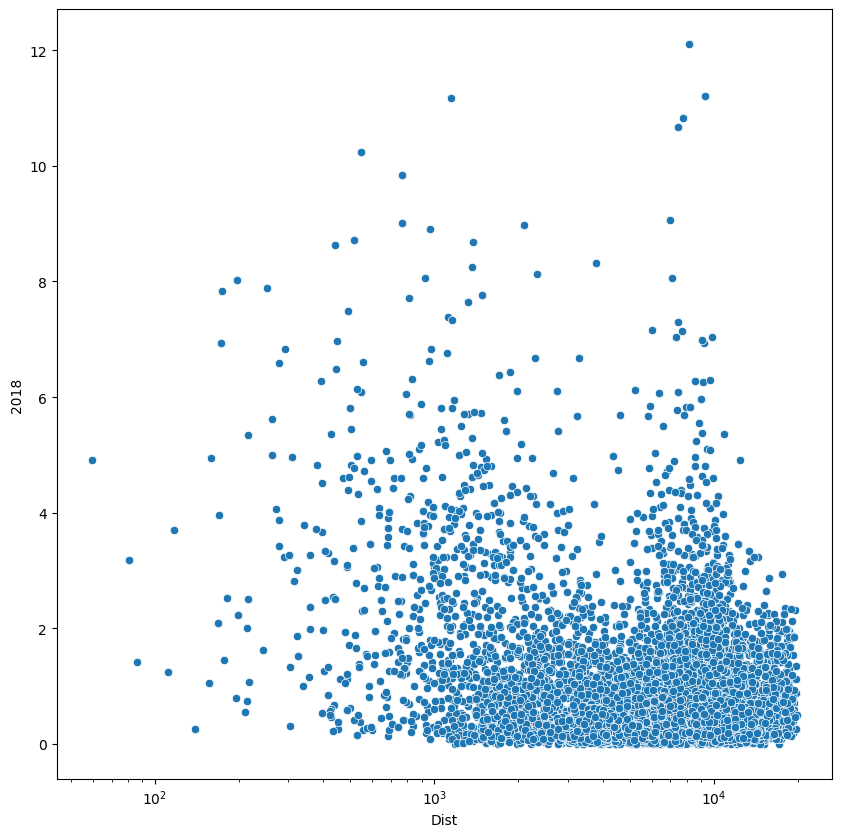

In [ ]:
# Make a copy and filter the DataFrame
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)

temp_df2 = temp_df.copy()
temp_df2 = temp_df2[['Dist', 2018]]
sns.scatterplot(data = temp_df2, x = 'Dist', y = 2018, ax = ax)
ax.set_xscale('log')
#ax.set_yscale('log')

# Export Similarity는 Knowledge diffusion이며 거리의 영향을 받습니다.
# 주변 국가가 비교우위를 가지면, 나도 비교우위를 가질 확률이 높습니다.

# 주변 국가가 선진국이면, PCI가 높은 상품에 대한 비교우위를 가질수도 있습니다. Knowledge diffusion
# Imitation 이잖아 이게

# Distance와 Export Similarity는 Negative correlated하지만
# Distance와 무관한 Export Similarity의 비중도 상당함


In [ ]:
#import seaborn as sns

#sns.heatmap(S_dict[2018], vmin = 0, vmax = 1)

## Export Similarity Index (D.Bahar etal. 2014)

As a descriptive exercise, we first study the correlation between geographic proximity and the similarity in exports of countries. To do so, we measure the intensity with which a country exports each product by computing its revealed comparative advantage (RCA) (Balassa, 1965). The RCA that a country has in a product is defined as the ratio between the share of total exports that the product represents in the country's export basket and the product's share of global trade.

For example, in the year 2000, “aircrafts (between 2 and 15 tons)” represented 4.5% of Brazil's exports, but accounted only for 0.23% of total world trade. Hence, Brazil's RCA in aircrafts for that year was:

$$
\text{RCA}_{\text{BRA, Aircrafts}} = \frac{4.5}{0.23} = 19.56
$$

indicating that aircrafts are about 20 times more prevalent in Brazil's export basket than in that of the world. A product is over-represented in a country's export basket if its RCA is above 1.

Formally, if $exp_{c,p}$ is equal to the dollar exports of country $c$ in product $p$, then the RCA of country $c$ in product $p$ is defined as:

$$
\text{RCA}_{c,p} \equiv \frac{\frac{exp_{c,p}}{\sum_p exp_{c,p}}}{\frac{\sum_c exp_{c,p}}{\sum_c \sum_p exp_{c,p}}} \tag{1}
$$

To create a measure of similarity in the export structure of a pair of countries $c$ and $c'$ we define the **Export Similarity Index** ($S_{c,c'}$) as the Pearson correlation between the logarithm of the RCA vectors of the two countries. The Export Similarity Index is defined as:

$$
S_{c,c'} \equiv \frac{\sum_p \left(r_{c,p} - \bar{r}_c\right) \left(r_{c',p} - \bar{r}_{c'}\right)}{\sqrt{\sum_p \left(r_{c,p} - \bar{r}_c\right)^2 \sum_p \left(r_{c',p} - \bar{r}_{c'}\right)^2}} \tag{2}
$$

where $r_{c,p} = \ln(\text{RCA}_{c,p} + \varepsilon)$ and $\bar{r}_c$ is the average of $r_{c,p}$ over all products for country $c$.

We chose a log form to prevent the correlation from being driven by the few products that countries export with very high RCA. Additionally, we add $\varepsilon$, defined as $0.1$, to assign a value to zeroes, while also preventing the correlation being driven by similarities in the RCA of products that countries export very little of or not at all.


In [ ]:
geo_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/geo_cepii.xls')
dist_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/dist_cepii.xls')

In [ ]:
geo_df.index = geo_df['iso3']

In [ ]:
rcp = {}
for year in range(start_year, end_year + 1):
    rcp[year] = np.log(rca[year] + 0.1)

/usr/local/lib/python3.11/dist-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


In [ ]:
Export_Similarity_4 = {}
for year in tqdm(range(start_year, end_year + 1)):
    Export_Similarity_4[year] = rcp[year].T.corr()

100%|██████████| 59/59 [00:01<00:00, 45.39it/s]


In [ ]:
geo_df['continent'].unique()

array(['America', 'Asia', 'Africa', 'Europe', 'No', 'Pacific'],
      dtype=object)

In [ ]:
continent_color_dict = dict(zip(geo_df['continent'].unique(), sns.color_palette('tab10', len(geo_df['continent'].unique()))))

In [ ]:
continent_color_dict

{'America': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 'Asia': (1.0, 0.4980392156862745, 0.054901960784313725),
 'Africa': (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 'Europe': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 'No': (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 'Pacific': (0.5490196078431373, 0.33725490196078434, 0.29411764705882354)}

In [ ]:
geo_df.loc['BOL', 'continent']

,continent
iso3,
BOL,America
BOL,America


In [ ]:
geo_df2 = geo_df.copy()
geo_df2 = geo_df2[~geo_df2.index.duplicated(keep='first')]
geo_df2

,iso2,iso3,cnum,country,pays,area,dis_int,landlocked,continent,city_en,...,lang9_2,lang9_3,lang9_4,colonizer1,colonizer2,colonizer3,colonizer4,short_colonizer1,short_colonizer2,short_colonizer3
iso3,,,,,,,,,,,,,,,,,,,,,
ABW,AW,ABW,533,Aruba,Aruba,193,5.225315,0,America,Oranjestad,...,.,.,.,NLD,.,.,.,.,.,.
AFG,AF,AFG,4,Afghanistan,Afghanistan,652225,303.761400,1,Asia,Kabul,...,Uzbek,.,.,.,.,.,.,GBR,.,.
AGO,AO,AGO,24,Angola,Angola,1246700,419.966600,0,Africa,Luanda,...,.,.,.,PRT,.,.,.,.,.,.
AIA,AI,AIA,660,Anguilla,Anguilla,102,3.798690,0,America,The Valley,...,.,.,.,GBR,.,.,.,.,.,.
ALB,AL,ALB,8,Albania,Albanie,28748,63.773110,0,Europe,Tirana,...,.,.,.,TUR,.,.,.,.,.,.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YUG,YU,YUG,891,Serbia and Montenegro,Serbie et Monténégro (ex-Yougoslavie),102173,120.227000,0,Europe,Belgrade,...,.,.,.,TUR,.,.,.,.,.,.
ZAF,ZA,ZAF,711,South Africa,Afrique du Sud,1219912,415.430200,0,Africa,Pretoria,...,Shoto,.,.,GBR,NLD,.,.,.,.,.
ZAR,ZR,ZAR,180,Congo (Democratic Republic of the),"Congo, Rép. dém. du",2345410,576.027500,0,Africa,Kinshasa,...,Luba-Kasai,French,.,BEL,.,.,.,.,.,.


In [ ]:
geo_df2['continent'] = geo_df2['continent'].replace('No','Etc')

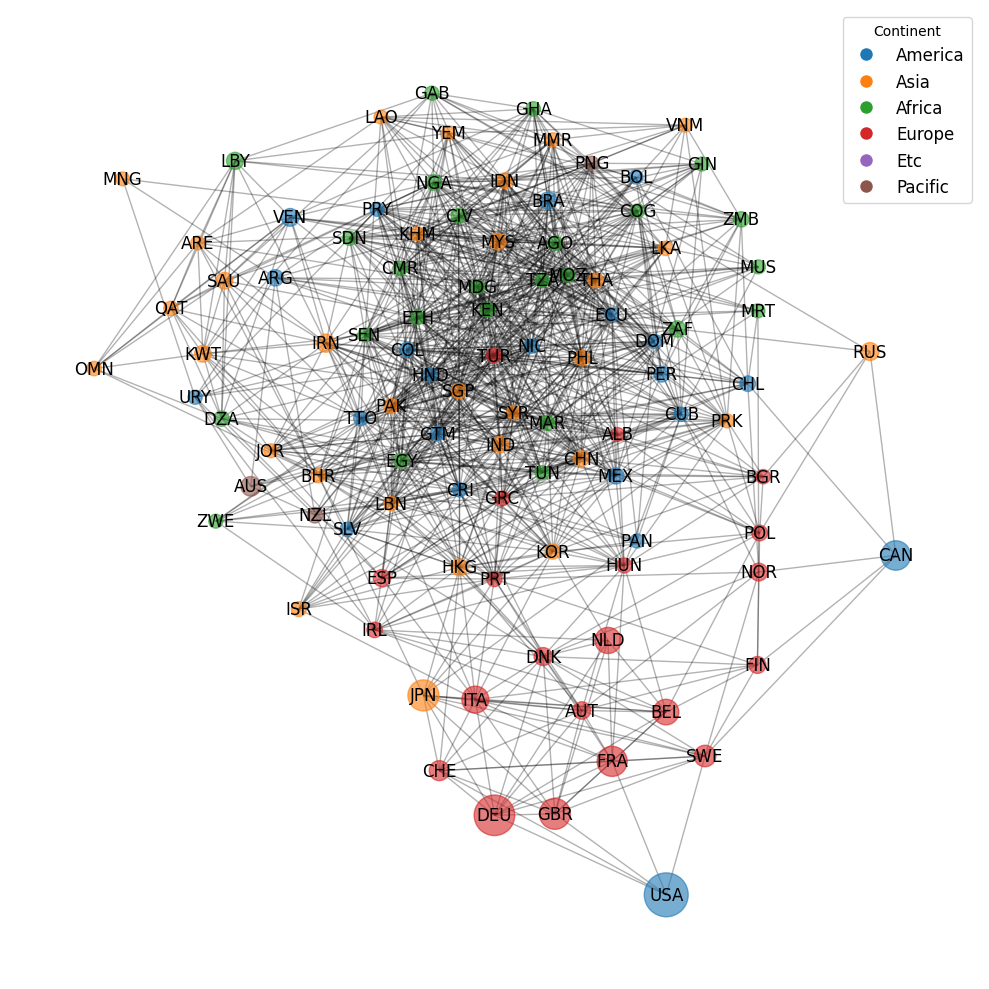

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 1970

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_4[year].copy()
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_4[year].index, columns=Export_Similarity_4[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
    for j in range(i + 1, len(temp_adj.columns)):
        if temp_adj.iloc[i, j] == 1:
            G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value
    sizes.append(export_value)

# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_1970.graphml")
nx.write_gexf(G, "graph_gephi_1970.gexf")


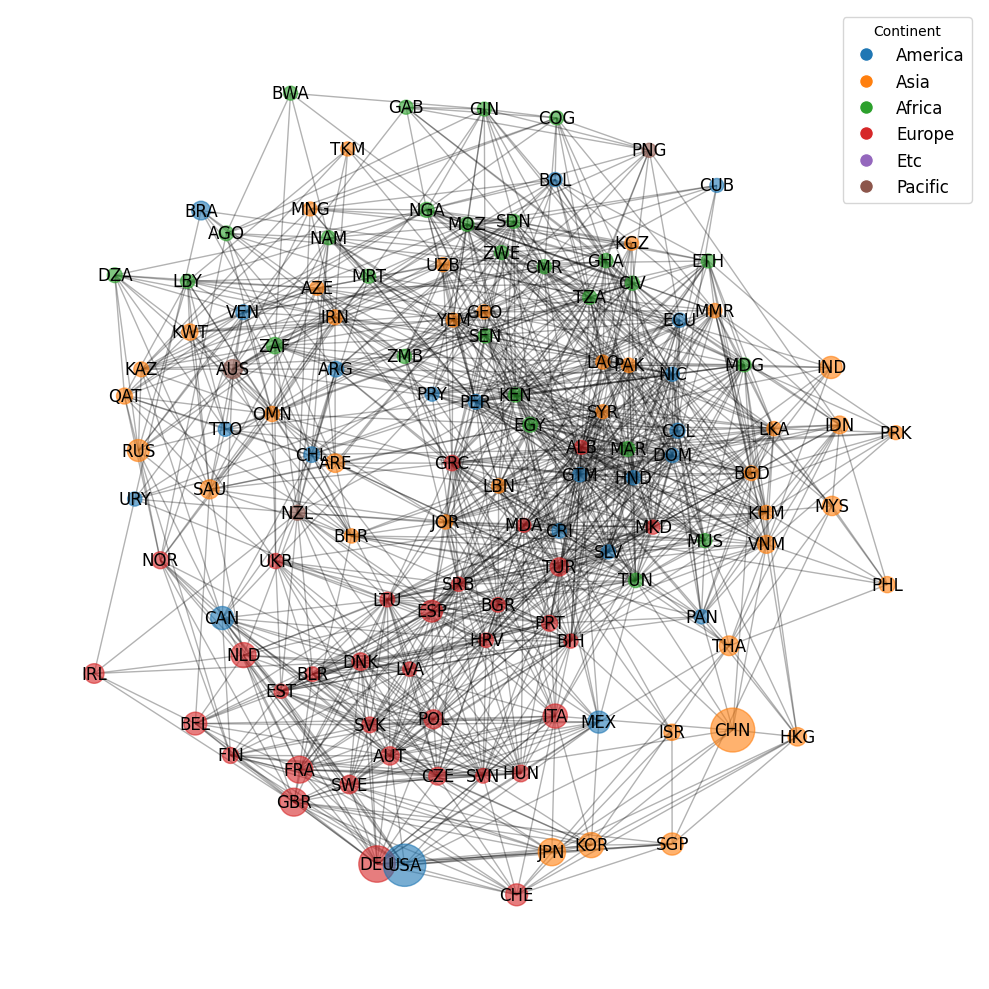

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 2015

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_4[year].copy()
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_4[year].index, columns=Export_Similarity_4[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
    for j in range(i + 1, len(temp_adj.columns)):
        if temp_adj.iloc[i, j] == 1:
            G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    if node =='SRB':
      G.nodes[node]['color'] = continent_color_dict['Europe']
    else:
      G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value

    sizes.append(export_value)


# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_2015.graphml")
nx.write_gexf(G, "graph_gephi_2015.gexf")


In [ ]:
temp_result_list = []

for i in tqdm(range(len(CapDist_m.index))):
  for j in range(i+1,len(CapDist_m.columns)):
    temp_list = []
    country_i = CapDist_m.index[i]
    country_j = CapDist_m.columns[j]
    temp_list.append(country_i)
    temp_list.append(country_j)
    temp_list.append(Dist_m.loc[country_i,country_j])
    temp_list.append(CapDist_m.loc[country_i,country_j])
    for year in range(start_year,end_year+1):
      temp_list.append(Export_Similarity_4[year].loc[country_i,country_j])
    temp_result_list.append(temp_list)

temp_df = pd.DataFrame(temp_result_list,
                       columns = ['Country1', 'Country2', 'Dist','CapDist']+[year for year in range(start_year,end_year+1)])

100%|██████████| 124/124 [00:03<00:00, 39.19it/s]


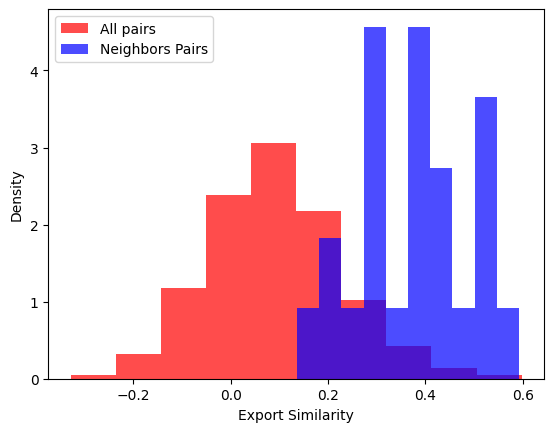

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Make a copy and filter the DataFrame
temp_df2 = temp_df.copy()
temp_df2 = temp_df[['Dist', 2000]]

# Calculate the mean of the 'Dist' column
mean_dist = np.mean(temp_df2['Dist'])

# Plot histograms with density=True
plt.hist(
    temp_df2[temp_df2['Dist']>=0][2000].dropna(),
    color='red',
    density=True,
    alpha=0.7,
    label='All pairs'
)
plt.hist(
    temp_df2[temp_df2['Dist'] < 250][2000].dropna(),
    color='blue',
    density=True,
    alpha=0.7,
    label='Neighbors Pairs'
)

# Add labels and legend
plt.xlabel('Export Similarity')
plt.ylabel('Density')
plt.legend()
plt.show()


In [ ]:
temp_df2

,Dist,2000
0,5623.8270,0.017066
1,5805.2550,0.144129
2,7792.0300,0.044959
3,13528.2000,0.097609
4,6357.0170,-0.150991
...,...,...
7621,3857.8970,0.181683
7622,3971.4740,0.163189
7623,2278.5820,0.300088
7624,2186.2060,0.378600


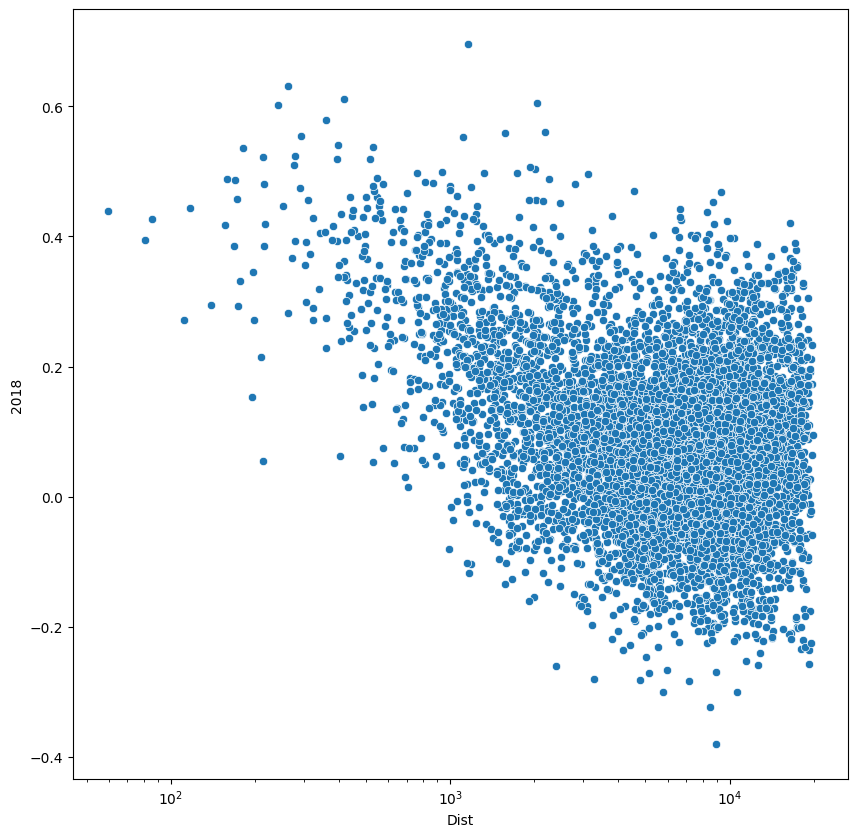

In [ ]:
# Make a copy and filter the DataFrame
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)

temp_df2 = temp_df.copy()
temp_df2 = temp_df2[['Dist', 2018]]
sns.scatterplot(data = temp_df2, x = 'Dist', y = 2018, ax = ax)
ax.set_xscale('log')

<ipython-input-104-4e4aae704111>:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)
<ipython-input-104-4e4aae704111>:39: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend().set_visible(False)


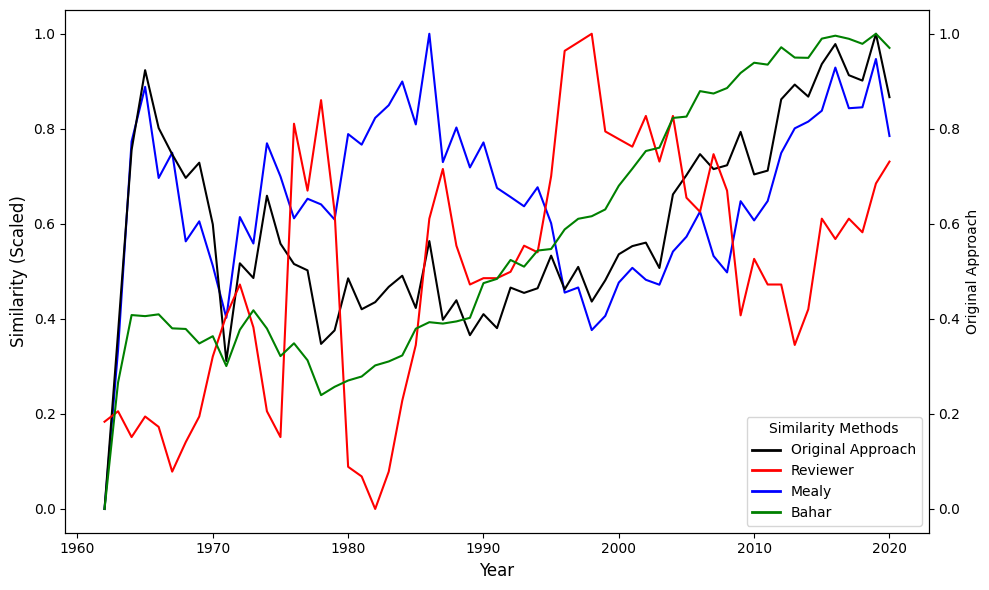

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D
import pandas as pd

# KOR, JPN
temp_result_list = []
for year in range(start_year, end_year + 1):
    temp_list = [
        year,
        Export_Similarity[year].loc['KOR', 'JPN'],
        Export_Similarity_2[year].loc['KOR', 'JPN'],
        Export_Similarity_3[year].loc['KOR', 'JPN'],
        Export_Similarity_4[year].loc['KOR', 'JPN'],
    ]
    temp_result_list.append(temp_list)

# Create DataFrame
temp_df = pd.DataFrame(temp_result_list, columns=['Year', 'Original Approach', 'Reviewer', 'Mealy', 'Bahar'])

# Min-Max Scaling
scaler = MinMaxScaler()
scaled_columns = ['Original Approach', 'Reviewer', 'Mealy', 'Bahar']
temp_df[scaled_columns] = scaler.fit_transform(temp_df[scaled_columns])

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
ax1 = ax.twinx()

# Plot lines
sns.lineplot(data=temp_df, x='Year', y='Original Approach', ax=ax1, color='black', label=None)
sns.lineplot(data=temp_df, x='Year', y='Reviewer', ax=ax1, color='red', label=None)
sns.lineplot(data=temp_df, x='Year', y='Mealy', ax=ax, color='blue', label=None)
sns.lineplot(data=temp_df, x='Year', y='Bahar', ax=ax1, color='green', label=None)

# Disable auto legends
ax.legend().set_visible(False)
ax1.legend().set_visible(False)

# Custom legend elements
custom_legend = [
    Line2D([0], [0], color='black', lw=2, label='Original Approach'),
    Line2D([0], [0], color='red', lw=2, label='Reviewer'),
    Line2D([0], [0], color='blue', lw=2, label='Mealy'),
    Line2D([0], [0], color='green', lw=2, label='Bahar'),
]

# Add custom legend to ax
ax.legend(handles=custom_legend, loc='lower right', fontsize=10, title="Similarity Methods")

# Customize the plot
ax.set_ylabel("Similarity (Scaled)", fontsize=12)
ax.set_xlabel("Year", fontsize=12)

# Finalize layout
plt.tight_layout()
plt.show()


<ipython-input-105-376a9dff9c79>:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)
<ipython-input-105-376a9dff9c79>:39: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend().set_visible(False)


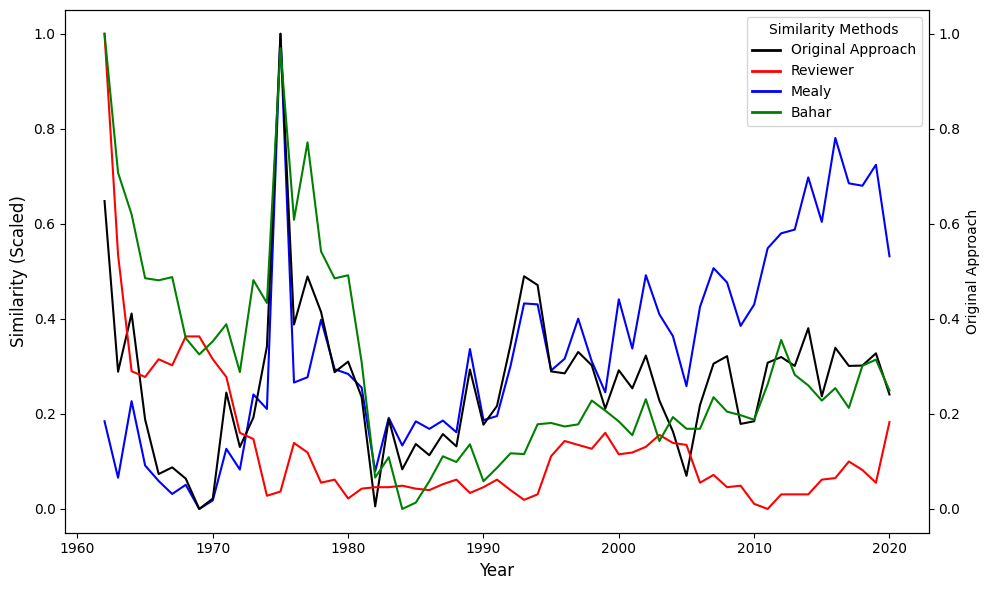

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D
import pandas as pd

# KOR, VNM
temp_result_list = []
for year in range(start_year, end_year + 1):
    temp_list = [
        year,
        Export_Similarity[year].loc['KOR', 'VNM'],
        Export_Similarity_2[year].loc['KOR', 'VNM'],
        Export_Similarity_3[year].loc['KOR', 'VNM'],
        Export_Similarity_4[year].loc['KOR', 'VNM'],
    ]
    temp_result_list.append(temp_list)

# Create DataFrame
temp_df = pd.DataFrame(temp_result_list, columns=['Year', 'Original Approach', 'Reviewer', 'Mealy', 'Bahar'])

# Min-Max Scaling
scaler = MinMaxScaler()
scaled_columns = ['Original Approach', 'Reviewer', 'Mealy', 'Bahar']
temp_df[scaled_columns] = scaler.fit_transform(temp_df[scaled_columns])

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
ax1 = ax.twinx()

# Plot lines
sns.lineplot(data=temp_df, x='Year', y='Original Approach', ax=ax1, color='black', label=None)
sns.lineplot(data=temp_df, x='Year', y='Reviewer', ax=ax1, color='red', label=None)
sns.lineplot(data=temp_df, x='Year', y='Mealy', ax=ax, color='blue', label=None)
sns.lineplot(data=temp_df, x='Year', y='Bahar', ax=ax1, color='green', label=None)

# Disable auto legends
ax.legend().set_visible(False)
ax1.legend().set_visible(False)

# Custom legend elements
custom_legend = [
    Line2D([0], [0], color='black', lw=2, label='Original Approach'),
    Line2D([0], [0], color='red', lw=2, label='Reviewer'),
    Line2D([0], [0], color='blue', lw=2, label='Mealy'),
    Line2D([0], [0], color='green', lw=2, label='Bahar'),
]

# Add custom legend to ax
ax.legend(handles=custom_legend, loc='best', fontsize=10, title="Similarity Methods")

# Customize the plot
ax.set_ylabel("Similarity (Scaled)", fontsize=12)
ax.set_xlabel("Year", fontsize=12)

# Finalize layout
plt.tight_layout()
plt.show()


<ipython-input-106-6e6e3e6bf154>:38: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend().set_visible(False)
<ipython-input-106-6e6e3e6bf154>:39: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax1.legend().set_visible(False)


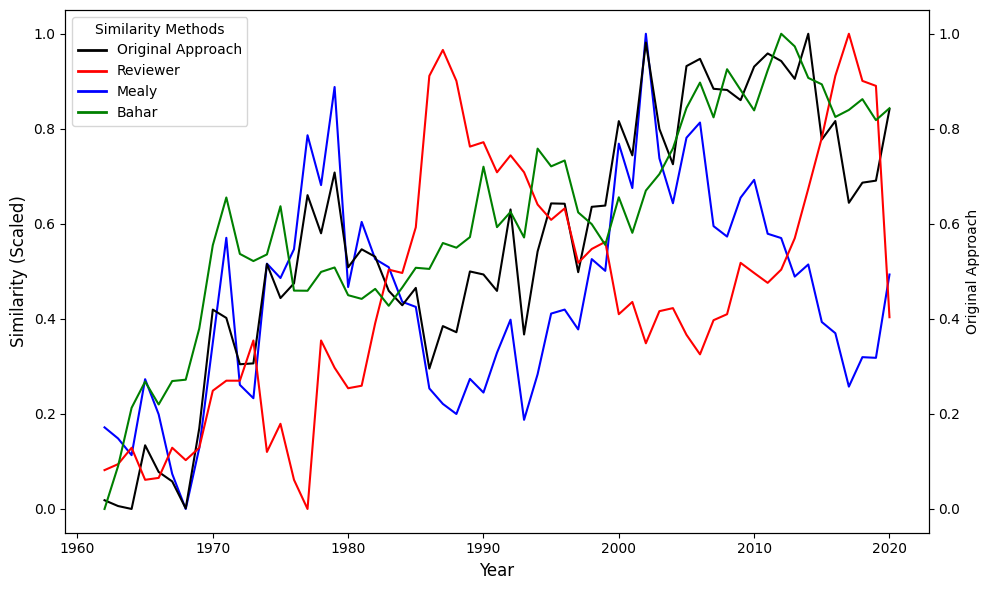

In [ ]:
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D
import pandas as pd

# ZAF, USA
temp_result_list = []
for year in range(start_year, end_year + 1):
    temp_list = [
        year,
        Export_Similarity[year].loc['ZAF', 'USA'],
        Export_Similarity_2[year].loc['ZAF', 'USA'],
        Export_Similarity_3[year].loc['ZAF', 'USA'],
        Export_Similarity_4[year].loc['ZAF', 'USA'],
    ]
    temp_result_list.append(temp_list)

# Create DataFrame
temp_df = pd.DataFrame(temp_result_list, columns=['Year', 'Original Approach', 'Reviewer', 'Mealy', 'Bahar'])

# Min-Max Scaling
scaler = MinMaxScaler()
scaled_columns = ['Original Approach', 'Reviewer', 'Mealy', 'Bahar']
temp_df[scaled_columns] = scaler.fit_transform(temp_df[scaled_columns])

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
ax1 = ax.twinx()

# Plot lines
sns.lineplot(data=temp_df, x='Year', y='Original Approach', ax=ax1, color='black', label=None)
sns.lineplot(data=temp_df, x='Year', y='Reviewer', ax=ax1, color='red', label=None)
sns.lineplot(data=temp_df, x='Year', y='Mealy', ax=ax, color='blue', label=None)
sns.lineplot(data=temp_df, x='Year', y='Bahar', ax=ax1, color='green', label=None)

# Disable auto legends
ax.legend().set_visible(False)
ax1.legend().set_visible(False)

# Custom legend elements
custom_legend = [
    Line2D([0], [0], color='black', lw=2, label='Original Approach'),
    Line2D([0], [0], color='red', lw=2, label='Reviewer'),
    Line2D([0], [0], color='blue', lw=2, label='Mealy'),
    Line2D([0], [0], color='green', lw=2, label='Bahar'),
]

# Add custom legend to ax
ax1.legend(handles=custom_legend, loc='best', fontsize=10, title="Similarity Methods")

# Customize the plot
ax.set_ylabel("Similarity (Scaled)", fontsize=12)
ax.set_xlabel("Year", fontsize=12)

# Finalize layout
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import euclidean

def calculate_similarity(df1, df2):

    if df1.shape != df2.shape:
        raise ValueError("Shape Error.")

    df1 = df1.fillna(0)
    df2 = df2.fillna(0)

    arr1 = df1.to_numpy().flatten()
    arr2 = df2.to_numpy().flatten()

    cos_sim = cosine_similarity([arr1], [arr2])[0][0]

    euclid_dist = euclidean(arr1, arr2)

    corr_coeff = np.corrcoef(arr1, arr2)[0, 1]

    return {
        "cosine_similarity": cos_sim,
        "euclidean_distance": euclid_dist,
        "correlation_coefficient": corr_coeff
    }

In [ ]:
calculate_similarity(Export_Similarity[year], Export_Similarity[year])

{'cosine_similarity': 0.9999999999999984,
 'euclidean_distance': 0.0,
 'correlation_coefficient': 1.0}

In [ ]:
calculate_similarity(Export_Similarity_3[year], Export_Similarity_4[year]).keys()

dict_keys(['cosine_similarity', 'euclidean_distance', 'correlation_coefficient'])

In [ ]:
np.sum((binary_rca[2015]>=1).astype(int).values)

15609

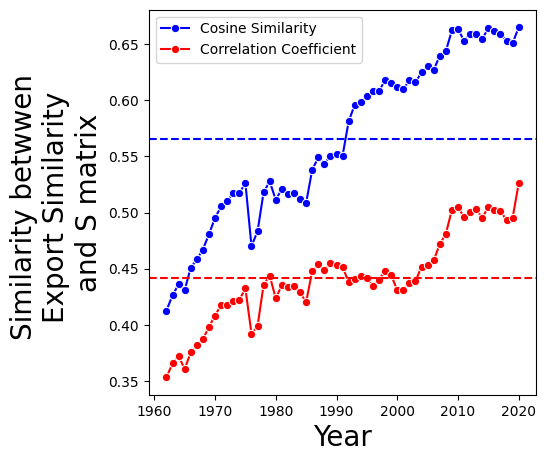

In [ ]:
temp_list1 = []
temp_list2 = []
temp_list3 = []
temp_list4 = []
for year in range(start_year, end_year + 1):
    #print(calculate_similarity(Export_Similarity[year], Export_Similarity_2[year]))
    #print(calculate_similarity(Export_Similarity[year], Export_Similarity_3[year]))
    temp_list1.append(calculate_similarity(Export_Similarity_3[year], Export_Similarity_4[year])['cosine_similarity'])
    temp_list2.append(calculate_similarity(Export_Similarity_3[year], Export_Similarity_4[year])['euclidean_distance'])
    temp_list3.append(calculate_similarity(Export_Similarity_3[year], Export_Similarity_4[year])['correlation_coefficient'])
    temp_list4.append(np.sum((binary_rca[year]>=1).astype(int).values))
    #print(calculate_similarity(Export_Similarity[year], Export_Similarity_4[year]))
    #print('------------------')

fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)

sns.lineplot(x = range(start_year,end_year+1), y = temp_list1, ax = ax, color = 'blue', label = 'Cosine Similarity', marker = 'o')
sns.lineplot(x = range(start_year,end_year+1), y = temp_list3, ax = ax, color = 'red', label = 'Correlation Coefficient', marker = 'o')

ax.axhline (y = np.mean(temp_list1), color = 'blue', linestyle = '--')
ax.axhline (y = np.mean(temp_list3), color = 'red', linestyle = '--')

ax.legend()
ax.set_xlabel("Year",fontsize = 20)
ax.set_ylabel('Similarity betwwen \nExport Similarity \nand S matrix', fontsize = 20)
plt.savefig(output_directory+'/A Figure.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/A Figure.pdf',dpi = 600, transparent=True, bbox_inches="tight")

In [ ]:
temp_df = pd.DataFrame()

temp_df['cosine_similarity'] = temp_list1
temp_df['euclidean_distance'] = temp_list2
temp_df['correlation_coefficient'] = temp_list3
temp_df['RCA'] = temp_list4

temp_df.corr()

,cosine_similarity,euclidean_distance,correlation_coefficient,RCA
cosine_similarity,1.000000,-0.891510,0.912499,0.965706
euclidean_distance,-0.891510,1.000000,-0.804856,-0.823750
correlation_coefficient,0.912499,-0.804856,1.000000,0.786938
RCA,0.965706,-0.823750,0.786938,1.000000


<Axes: xlabel='cosine_similarity', ylabel='RCA'>

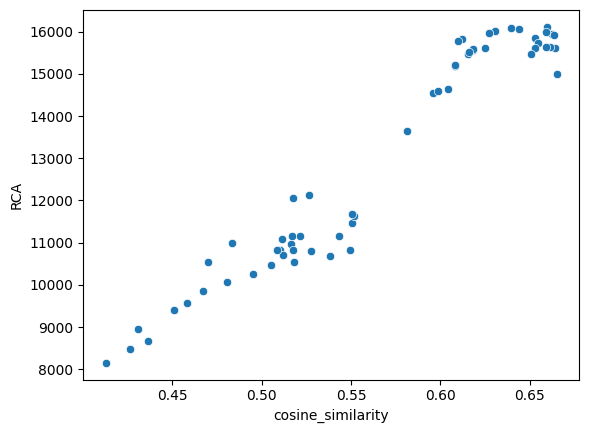

In [ ]:
sns.scatterplot(temp_df, x = 'cosine_similarity', y = 'RCA')

In [ ]:
import numpy as np

def min_max_scaling(df):
    scaled_df = df.copy()
    for column in df.columns:
        if np.issubdtype(df[column].dtype, np.number):
            min_val = df[column].min()
            max_val = df[column].max()
            if max_val > min_val:
                scaled_df[column] = (df[column] - min_val) / (max_val - min_val)
            else:
                scaled_df[column] = 0
    return scaled_df

scaled_temp_df = min_max_scaling(temp_df)

print(scaled_temp_df.head())


   cosine_similarity  euclidean_distance  correlation_coefficient       RCA
0           0.000000            1.000000                 0.000000  0.000000
1           0.053084            0.990633                 0.070928  0.042243
2           0.092969            0.963566                 0.109610  0.064747
3           0.071585            0.933826                 0.041537  0.100704
4           0.151228            0.811498                 0.128028  0.155771


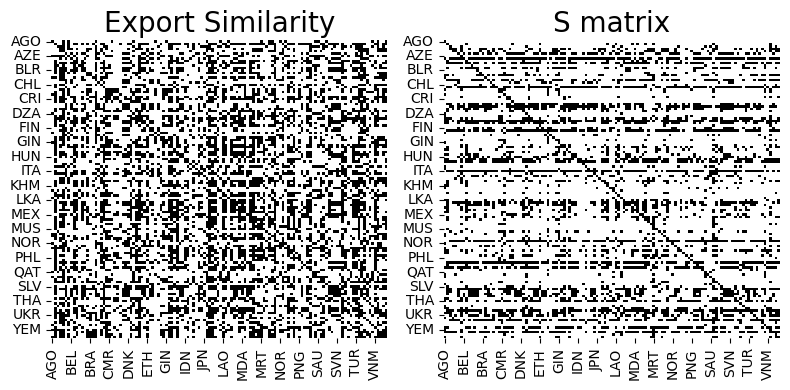

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, ax = plt.subplots(1, 2, figsize=(8, 4))

year = 2010
temp_df = Export_Similarity_4[year].copy()
scaled_temp_df = min_max_scaling(temp_df)
scaled_temp_df = (scaled_temp_df>=0.25).astype(int)
sns.heatmap(scaled_temp_df, vmin=0, vmax=1, ax=ax[0], cbar=False, cbar_kws={'label': 'Similarity'}, cmap = 'binary')
ax[0].set_title('Export Similarity', fontsize = 20)
ax[0].set_xlabel('')
ax[0].set_ylabel('')
#ax[0].collections[0].colorbar.ax.tick_params(labelsize=12)  # Adjust tick font size
#ax[0].collections[0].colorbar.set_label('Similarity', fontsize=15)  # Set label size

temp_df = Export_Similarity_3[year].copy()
scaled_temp_df = min_max_scaling(temp_df)
scaled_temp_df = (scaled_temp_df>=0.25).astype(int)
sns.heatmap(scaled_temp_df, vmin=0, vmax=1, ax=ax[1], cbar=False, cbar_kws={'label': 'Similarity'}, cmap = 'binary')
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].set_title('S matrix', fontsize = 20)
#ax[1].collections[0].colorbar.ax.tick_params(labelsize=12)  # Adjust tick font size
#ax[1].collections[0].colorbar.set_label('Similarity', fontsize=15)  # Set label size

plt.tight_layout()
plt.savefig(output_directory+'/Figure_matrix_2010.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/Figure_matrix_2010.pdf',dpi = 600, transparent=True, bbox_inches="tight")

#


In [ ]:
Export_Similarity_4[2010].loc['USA'].sort_values(ascending=False)

,USA
location_code,
USA,1.000000
JPN,0.344577
SGP,0.328595
DEU,0.325965
FRA,0.312426
...,...
ALB,-0.181258
IDN,-0.193506
LKA,-0.219050


In [ ]:
import pandas as pd

# Step 1: Create DataFrame for rank comparison
temp_df = pd.DataFrame()
temp_df['country'] = Export_Similarity_4[2010].loc['USA'].sort_values(ascending=False).index
temp_df['Rank_export similarity'] = range(1, len(Export_Similarity_4[2010].loc['USA'].sort_values(ascending=False)) + 1)

# Step 2: Create rank mapping for Export Similarity (S matrix)
temp_dict = dict(
    zip(
        Export_Similarity_3[2010].loc['USA'].sort_values(ascending=False).index,
        range(1, len(Export_Similarity_3[2010].loc['USA'].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_S'] = temp_df['country'].map(temp_dict)

# Step 3: Create rank mapping for ECI
temp_dict = dict(
    zip(
        eci[2010].loc[temp_df['country']].sort_values(ascending=False).index,
        range(1, len(eci[2010].loc[temp_df['country']].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_eci'] = temp_df['country'].map(temp_dict)

np.corrcoef(temp_df['Rank_export similarity'], temp_df['Rank_S'])[0, 1]

0.5472918961447679

In [ ]:
np.corrcoef(temp_df['Rank_export similarity'], temp_df['Rank_eci'])[0, 1]

0.6033107789142407

In [ ]:
np.corrcoef(temp_df['Rank_S'], temp_df['Rank_eci'])[0, 1]

0.8780613690007867

In [ ]:
import pandas as pd

# Step 1: Create DataFrame for rank comparison
temp_df = pd.DataFrame()
temp_df['country'] = Export_Similarity_4[1990].loc['CUB'].sort_values(ascending=False).index
temp_df['Rank_export similarity'] = range(1, len(Export_Similarity_4[1990].loc['CUB'].sort_values(ascending=False)) + 1)

# Step 2: Create rank mapping for Export Similarity (S matrix)
temp_dict = dict(
    zip(
        Export_Similarity_3[1990].loc['CUB'].sort_values(ascending=False).index,
        range(1, len(Export_Similarity_3[1990].loc['CUB'].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_S'] = temp_df['country'].map(temp_dict)

# Step 3: Create rank mapping for ECI
temp_dict = dict(
    zip(
        eci[1990].loc[temp_df['country']].sort_values(ascending=False).index,
        range(1, len(eci[1990].loc[temp_df['country']].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_eci'] = temp_df['country'].map(temp_dict)
temp_df.sort_values(by='Rank_S',inplace=True)
temp_df.head(20)

,country,Rank_export similarity,Rank_S,Rank_eci
0,CUB,1,1,87
2,ZWE,3,2,73
69,NLD,70,3,13
63,CAN,64,4,18
8,ZAF,9,5,70
12,PHL,13,6,80
55,POL,56,7,24
87,BEL,88,8,12
95,FRA,96,9,10
29,BRA,30,10,26


In [ ]:
Export_Similarity_3[1980].loc['VNM'].sort_values(ascending=False).reindex(temp_df['country'])

,VNM
country,
CUB,0.141295
ZWE,0.257074
NLD,0.858206
CAN,0.486780
ZAF,0.542057
...,...
MKD,0.000000
SVN,0.000000
SVK,0.000000


In [ ]:
import pandas as pd

# Step 1: Create DataFrame for rank comparison
temp_df = pd.DataFrame()
temp_df['country'] = Export_Similarity_4[1980].loc['USA'].sort_values(ascending=False).index
temp_df['export similarity'] = Export_Similarity_4[1980].loc['USA'].sort_values(ascending=False).values
temp_df['S'] = Export_Similarity_3[1980].loc['USA'].sort_values(ascending=False).reindex(temp_df['country']).values
temp_df['eci'] = eci[1980].sort_values(ascending=False).reindex(temp_df['country']).values

temp_df

,country,export similarity,S,eci
0,USA,1.000000,27.628519,1.394131
1,GBR,0.201945,13.382618,1.836734
2,CAN,0.199767,7.158776,0.670021
3,SWE,0.170251,9.759446,1.923628
4,DEU,0.142854,15.890521,1.995237
...,...,...,...,...
119,SVK,NaN,0.000000,0.618243
120,SVN,NaN,0.000000,0.618243
121,TKM,NaN,0.000000,0.618243
122,UKR,NaN,0.000000,0.618243


In [ ]:
temp_df['S'] = (temp_df['S']-min(temp_df['S']))/(max(temp_df['S'])-min(temp_df['S']))
temp_df['S'] = 1 - temp_df['S']
temp_df['export similarity'] = 1-temp_df['export similarity']

<Axes: xlabel='eci', ylabel='S'>

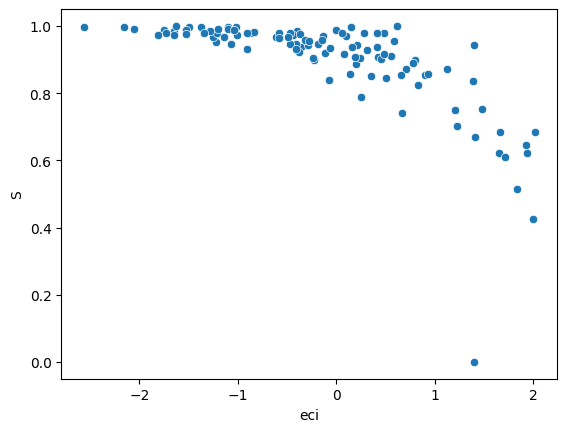

In [ ]:
sns.scatterplot(data = temp_df, x = 'eci', y='S')

<Axes: xlabel='eci', ylabel='export similarity'>

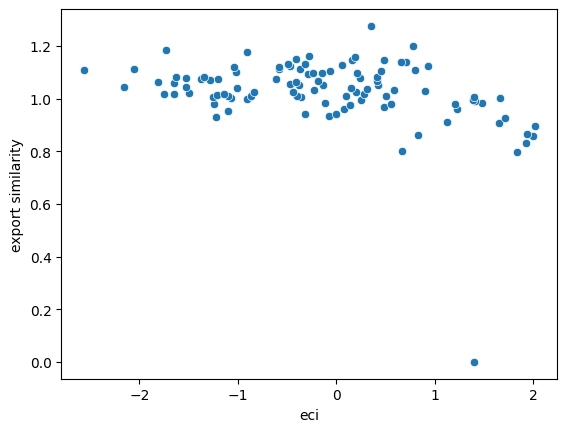

In [ ]:
sns.scatterplot(data = temp_df, x = 'eci', y='export similarity')

In [ ]:
import pandas as pd

input_country = 'KOR'
year = 2000

temp_df = pd.DataFrame()
temp_df['country'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).index
temp_df['export similarity'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).values
temp_df['S'] = Export_Similarity_3[year].loc[input_country].sort_values(ascending=False).reindex(temp_df['country']).values
temp_df['eci'] = eci[year].sort_values(ascending=False).reindex(temp_df['country']).values
temp_df['eci_diff'] = temp_df['eci'] - eci[year][input_country]
temp_df['eci_diff'] = np.abs(temp_df['eci_diff'])

temp_df['S'] = (temp_df['S']-min(temp_df['S']))/(max(temp_df['S'])-min(temp_df['S']))
temp_df['S'] = 1 - temp_df['S']
temp_df['export similarity'] = 1-temp_df['export similarity']

<Axes: xlabel='eci_diff', ylabel='S'>

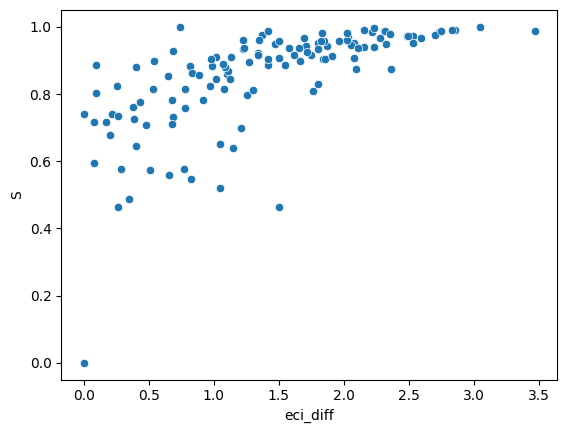

In [ ]:
sns.scatterplot(data = temp_df, x = 'eci_diff', y='S')

<Axes: xlabel='eci_diff', ylabel='export similarity'>

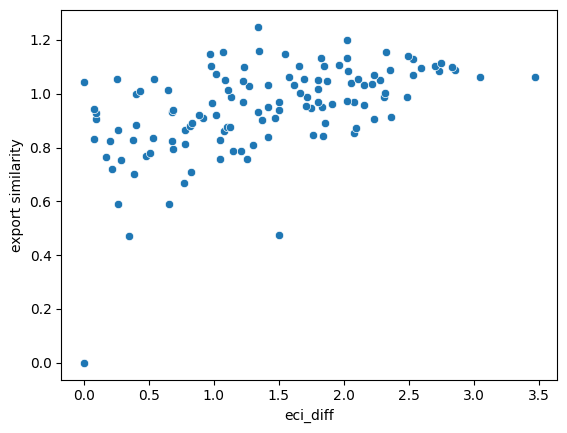

In [ ]:
sns.scatterplot(data = temp_df, x = 'eci_diff', y='export similarity')

In [ ]:
import pandas as pd

temp_result_df = pd.DataFrame()

year = 2000

for year in tqdm(range(start_year,end_year+1)):
  for input_country in eci[year].index:

    temp_df = pd.DataFrame()
    temp_df['country'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).index
    temp_df['export similarity'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).values
    temp_df['S'] = Export_Similarity_3[year].loc[input_country].sort_values(ascending=False).reindex(temp_df['country']).values
    temp_df['eci'] = eci[year].sort_values(ascending=False).reindex(temp_df['country']).values
    temp_df['eci_diff'] = temp_df['eci'] - eci[year][input_country]
    temp_df['eci_diff'] = np.abs(temp_df['eci_diff'])

    temp_df['S'] = (temp_df['S']-min(temp_df['S']))/(max(temp_df['S'])-min(temp_df['S']))
    temp_df['S'] = 1 - temp_df['S']
    temp_df['export similarity'] = 1-temp_df['export similarity']

    temp_result_df = pd.concat([temp_result_df,temp_df])

temp_result_df

100%|██████████| 59/59 [00:46<00:00,  1.27it/s]


,country,export similarity,S,eci,eci_diff
0,AGO,0.000000,0.000000,-0.866697,0.000000
1,CIV,0.511996,0.725969,-1.042850,0.176153
2,NGA,0.597074,0.830098,-1.366803,0.500106
3,MOZ,0.600997,0.710569,-0.938465,0.071768
4,COG,0.602966,0.808644,-1.200097,0.333400
...,...,...,...,...,...
119,SWE,1.114297,0.918028,1.571719,2.520417
120,KOR,1.158881,0.945141,1.898894,2.847592
121,CHN,1.166890,0.861859,1.157024,2.105722
122,DEU,1.167925,0.921161,1.851550,2.800248


In [ ]:
temp_result_df = temp_result_df[temp_result_df['S']!=0]
temp_result_df.dropna(inplace=True)
temp_result_df.reset_index(drop=True, inplace=True)

<ipython-input-130-01829d1acc1a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_result_df.dropna(inplace=True)


In [ ]:
len(temp_result_df)

750781

In [ ]:
np.corrcoef(temp_result_df['eci_diff'], temp_result_df['export similarity'])[0, 1]

0.5869963386149666

In [ ]:
np.corrcoef(temp_result_df['eci_diff'], temp_result_df['S'])[0, 1]

0.2267757345803657

In [ ]:
temp_result_df = pd.DataFrame()
for year in tqdm(range(start_year,end_year+1)):
  for input_country in eci[year].index:

    temp_df = pd.DataFrame()
    temp_df['country'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).index
    temp_df['export similarity'] = Export_Similarity_4[year].loc[input_country].sort_values(ascending=False).values
    temp_df['S'] = Export_Similarity_3[year].loc[input_country].sort_values(ascending=False).reindex(temp_df['country']).values
    temp_df['eci'] = eci[year].sort_values(ascending=False).reindex(temp_df['country']).values
    temp_df['eci_diff'] = temp_df['eci'] - eci[year][input_country]

    #temp_df['eci_diff'] = np.abs(temp_df['eci_diff'])

    temp_df['S'] = (temp_df['S']-min(temp_df['S']))/(max(temp_df['S'])-min(temp_df['S']))
    temp_df['export similarity'] = (temp_df['export similarity']-min(temp_df['export similarity']))/(max(temp_df['export similarity'])-min(temp_df['export similarity']))
    temp_df['eci_diff'] = temp_df['eci'] - eci[year][input_country]
    #temp_df['eci_diff'] = (temp_df['eci_diff']-min(temp_df['eci_diff']))/(max(temp_df['eci_diff'])-min(temp_df['eci_diff']))
    #temp_df['S'] = 1 - temp_df['S']
    #temp_df['export similarity'] = 1-temp_df['export similarity']

    #temp_df = temp_df[temp_df['eci_diff']<=0.1]
    temp_result_df = pd.concat([temp_result_df,temp_df])

#temp_result_df.reset_index(drop=True, inplace=True)
temp_result_df.dropna(inplace=True)

100%|██████████| 59/59 [00:46<00:00,  1.28it/s]


In [ ]:
len(temp_result_df)

757890

In [ ]:
temp_result_df = temp_result_df.drop(index=0)
len(temp_result_df)

751232

In [ ]:
temp_result_df.reset_index(inplace=True,drop=True)

In [ ]:
temp_result_df.head()

,country,export similarity,S,eci,eci_diff
0,CIV,0.618487,0.274031,-1.042850,-0.176153
1,NGA,0.555091,0.169902,-1.366803,-0.500106
2,MOZ,0.552167,0.289431,-0.938465,-0.071768
3,COG,0.550701,0.191356,-1.200097,-0.333400
4,PRY,0.544206,0.335857,-1.094795,-0.228098


In [ ]:
temp_result_df.describe()

,export similarity,S,eci,eci_diff
count,751232.000000,751232.000000,751232.000000,7.512320e+05
mean,0.228755,0.162376,-0.056948,-7.566693e-20
std,0.118014,0.131141,1.024300,1.451851e+00
min,0.000000,0.000000,-4.044529,-5.795849e+00
25%,0.142490,0.058813,-0.814428,-9.813017e-01
50%,0.216728,0.135623,-0.179604,0.000000e+00
75%,0.302434,0.236886,0.636693,9.813017e-01
max,0.898069,1.000000,2.769452,5.795849e+00


In [ ]:
temp_result_df['ECI Distance'] = temp_result_df['eci_diff'].apply(
    lambda x: 'Similar & Developed' if (x >=0.5 and x<=0.75) else
              'Non-Similar & Developed' if x > 0.75 else
              'Similar & UnderDeveloped' if (x >= 0.25 and x < 0.5) else
              'Non-Similar & UnderDeveloped'
)

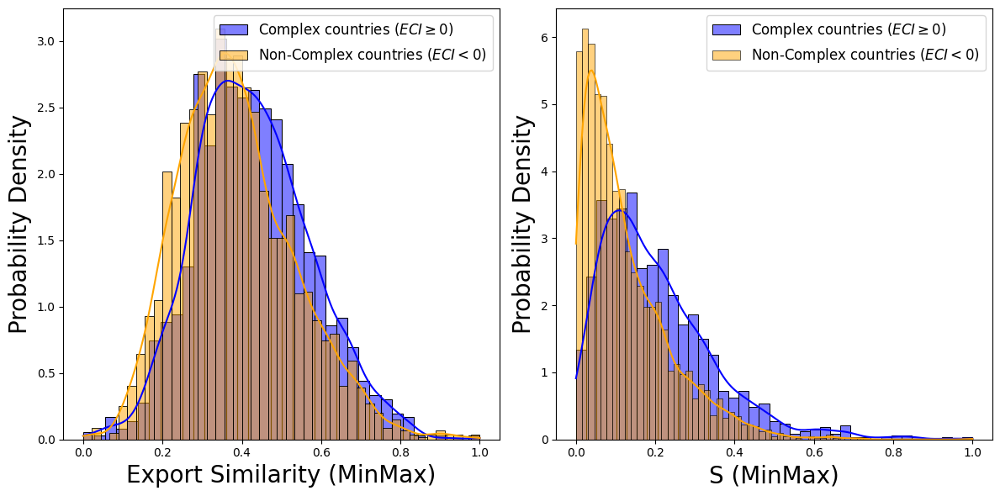

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Define the year
year = 2015

# Define the countries based on ECI
country1 = eci[year][eci[year] >= 0].index
country2 = eci[year][eci[year] < 0].index

# Retrieve data for Export Similarity 4
temp_df1_4 = Export_Similarity_4[year].loc[country1, country1].copy()
temp_df2_4 = Export_Similarity_4[year].loc[country2, country2].copy()

# Retrieve data for Export Similarity 3
temp_df1_3 = Export_Similarity_3[year].loc[country1, country1].copy()
temp_df2_3 = Export_Similarity_3[year].loc[country2, country2].copy()

# Set diagonal values to 0 for both datasets
np.fill_diagonal(temp_df1_4.values, 0)
np.fill_diagonal(temp_df2_4.values, 0)
np.fill_diagonal(temp_df1_3.values, 0)
np.fill_diagonal(temp_df2_3.values, 0)

# Normalize data for both datasets
temp_df1_4 = (temp_df1_4 - temp_df1_4.min().min()) / (temp_df1_4.max().max() - temp_df1_4.min().min())
temp_df2_4 = (temp_df2_4 - temp_df2_4.min().min()) / (temp_df2_4.max().max() - temp_df2_4.min().min())
temp_df1_3 = (temp_df1_3 - temp_df1_3.min().min()) / (temp_df1_3.max().max() - temp_df1_3.min().min())
temp_df2_3 = (temp_df2_3 - temp_df2_3.min().min()) / (temp_df2_3.max().max() - temp_df2_3.min().min())

# Create 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Plot for Export Similarity 4
sns.histplot(temp_df1_4.values.flatten(), kde=True, color='blue', label='Complex countries ($ECI \geq 0$)', stat='density', ax=axes[0])
sns.histplot(temp_df2_4.values.flatten(), kde=True, color='orange', label='Non-Complex countries ($ECI<0$)', stat='density', ax=axes[0])
#axes[0].set_title('Export Similarity', fontsize=20)
axes[0].set_xlabel('Export Similarity (MinMax)', fontsize=20)
axes[0].set_ylabel('Probability Density', fontsize=20)
axes[0].legend(fontsize=12)

# Plot for Export Similarity 3
sns.histplot(temp_df1_3.values.flatten(), kde=True, color='blue', label='Complex countries ($ECI \geq 0$)', stat='density', ax=axes[1])
sns.histplot(temp_df2_3.values.flatten(), kde=True, color='orange', label='Non-Complex countries ($ECI<0$)', stat='density', ax=axes[1])
#axes[1].set_title('S matrix', fontsize=20)
axes[1].set_xlabel('S (MinMax)', fontsize=20)
axes[1].set_ylabel('Probability Density', fontsize=20)
axes[1].legend(fontsize=12)

# Adjust layout
plt.tight_layout()

plt.savefig(output_directory+'/Figure_histogram_2010.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/Figure_histogram_2010.pdf',dpi = 600, transparent=True, bbox_inches="tight")

# Show the plot
plt.show()


In [ ]:
import pandas as pd

# Step 1: Create DataFrame for rank comparison
temp_df = pd.DataFrame()
temp_df['country'] = Export_Similarity_4[1980].loc['VNM'].sort_values(ascending=False).index
temp_df['Rank_export similarity'] = range(1, len(Export_Similarity_4[1980].loc['VNM'].sort_values(ascending=False)) + 1)

# Step 2: Create rank mapping for Export Similarity (S matrix)
temp_dict = dict(
    zip(
        Export_Similarity_3[1980].loc['VNM'].sort_values(ascending=False).index,
        range(1, len(Export_Similarity_3[1980].loc['VNM'].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_S'] = temp_df['country'].map(temp_dict)

# Step 3: Create rank mapping for ECI
temp_dict = dict(
    zip(
        eci[1980].loc[temp_df['country']].sort_values(ascending=False).index,
        range(1, len(eci[1980].loc[temp_df['country']].sort_values(ascending=False)) + 1)
    )
)
temp_df['Rank_eci'] = temp_df['country'].map(temp_dict)
temp_df.sort_values(by='Rank_S',inplace=True)
temp_df

,country,Rank_export similarity,Rank_S,Rank_eci
0,VNM,1,1,90
1,CHN,2,2,54
6,IND,7,3,61
3,THA,4,4,76
89,ITA,90,5,7
...,...,...,...,...
118,SRB,119,120,37
79,LBY,80,121,112
110,HRV,111,122,36
111,KAZ,112,123,42


In [ ]:
!pip install adjustText

## Product Space and Producer Space

#### Product Space

In [ ]:
sitc_code_dict={
    "0":"Food and Live Animals",
    "1":"Beverage and Tobacco",
    "2":"Crude Materials",
    "3":"Mineral, Fuels, Lubricants and Related Material",
    "4":"Animal and Vegetable Oils and Fats",
    "5":"Chemicals and Related Products",
    "6":"Manufacturing and Goods",
    "7":"Machinerary and Transport Equipment",
    "8":"Miscellaneous Manufacturing Articles",
    "9":"Commodities and Transactions not classified elsewhere in SITC"
}

In [ ]:
import matplotlib.colors as mcolors
color_list=list(mcolors.TABLEAU_COLORS)
len(color_list)

10

In [ ]:
sitc_code_color_dict={
    "0":color_list[0],
    "1":color_list[1],
    "2":color_list[2],
    "3":color_list[3],
    "4":color_list[4],
    "5":color_list[5],
    "6":color_list[6],
    "7":color_list[7],
    "8":color_list[8],
    "9":color_list[9]
    }

In [ ]:
temp_net_df = proximity[2018].copy()
temp_net_df = pd.DataFrame(temp_net_df, index = binary_rca[2018].columns, columns = binary_rca[2018].columns)
temp_net_df.head()

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
sitc_product_code,,,,,,,,,,,,,,,,,,,,,
0011,1.000000,0.424242,0.333333,0.363636,0.121212,0.363636,0.272727,0.151515,0.333333,0.363636,...,0.303030,0.375,0.272727,0.242424,0.184211,0.0,0.030303,0.345455,0.333333,0.272727
0012,0.424242,1.000000,0.190476,0.172414,0.047619,0.130435,0.380952,0.095238,0.190476,0.260870,...,0.214286,0.250,0.190476,0.047619,0.131579,0.0,0.047619,0.218182,0.242424,0.111111
0013,0.333333,0.190476,1.000000,0.310345,0.266667,0.173913,0.100000,0.400000,0.300000,0.217391,...,0.142857,0.250,0.333333,0.222222,0.078947,0.0,0.066667,0.145455,0.075758,0.185185
0014,0.363636,0.172414,0.310345,1.000000,0.241379,0.275862,0.137931,0.275862,0.344828,0.310345,...,0.206897,0.375,0.206897,0.310345,0.078947,0.0,0.137931,0.309091,0.257576,0.310345
0015,0.121212,0.047619,0.266667,0.241379,1.000000,0.304348,0.300000,0.307692,0.300000,0.260870,...,0.178571,0.125,0.111111,0.277778,0.131579,0.0,0.357143,0.127273,0.106061,0.296296


In [ ]:
product_df

,location_id,product_id,year,export_value,import_value,export_rca,product_status,cog,distance,normalized_distance,normalized_cog,normalized_pci,export_rpop,is_new,sitc_eci,sitc_coi,pci,location_code,sitc_product_code
0,2,650,1988,0,0,0.0,absent,0.345495,0.994533,-0.201209,-0.294744,-0.342336,0.0,False,-1.544848,-0.975225,-0.323743,AGO,0011
1,2,650,1989,0,0,0.0,absent,0.162287,0.994626,0.356208,-0.593764,-0.642618,0.0,False,-1.732794,-0.957246,-0.628165,AGO,0011
2,2,650,1990,0,0,0.0,absent,0.088544,0.996106,0.279521,-0.722398,-0.611471,0.0,False,-1.725009,-0.950251,-0.598484,AGO,0011
3,2,650,1991,0,0,0.0,absent,0.157498,0.996174,-0.523332,-0.623429,-0.536309,0.0,False,-1.137805,-0.971209,-0.524367,AGO,0011
4,2,650,1992,0,23281,0.0,absent,0.054020,0.996789,-0.046155,-0.784799,-0.439734,0.0,False,-1.906420,-1.061544,-0.428505,AGO,0011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5117298,232,2004,1983,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,-0.357442,UZB,financial
5117299,232,2004,1984,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,-0.403399,UZB,financial
5117300,232,2004,1985,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,-0.357057,UZB,financial
5117301,232,2004,1986,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,-0.432297,UZB,financial


In [ ]:
product_df.head()

,location_id,product_id,year,export_value,import_value,export_rca,product_status,cog,distance,normalized_distance,normalized_cog,normalized_pci,export_rpop,is_new,sitc_eci,sitc_coi,pci,location_code,sitc_product_code
0,2,650,1988,0,0,0.0,absent,0.345495,0.994533,-0.201209,-0.294744,-0.342336,0.0,False,-1.544848,-0.975225,-0.323743,AGO,0011
1,2,650,1989,0,0,0.0,absent,0.162287,0.994626,0.356208,-0.593764,-0.642618,0.0,False,-1.732794,-0.957246,-0.628165,AGO,0011
2,2,650,1990,0,0,0.0,absent,0.088544,0.996106,0.279521,-0.722398,-0.611471,0.0,False,-1.725009,-0.950251,-0.598484,AGO,0011
3,2,650,1991,0,0,0.0,absent,0.157498,0.996174,-0.523332,-0.623429,-0.536309,0.0,False,-1.137805,-0.971209,-0.524367,AGO,0011
4,2,650,1992,0,23281,0.0,absent,0.054020,0.996789,-0.046155,-0.784799,-0.439734,0.0,False,-1.906420,-1.061544,-0.428505,AGO,0011


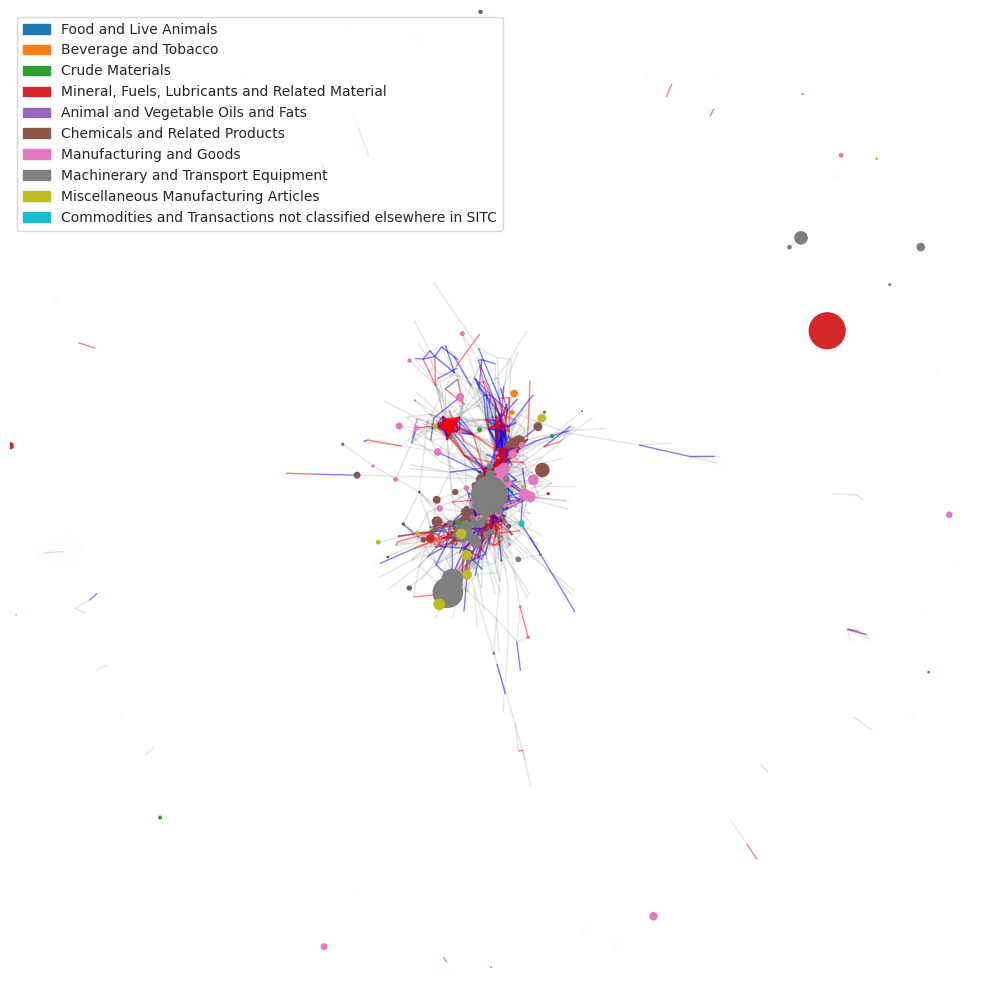

In [ ]:
import random

temp_year = 2018
temp_country = 'KOR'

random.seed(123)
sns.set_theme(style="white")

temp_net_df = proximity[temp_year].copy()
temp_net_df = pd.DataFrame(temp_net_df, index = binary_rca[temp_year].columns, columns = binary_rca[temp_year].columns)
input_Proximity_Matrix = temp_net_df.copy()

threshold = 0.5
temp_nodes=sorted(input_Proximity_Matrix.columns)

temp_G=nx.Graph()
for i in range(len(temp_nodes)):
  temp_G.add_node(temp_nodes[i])
  for j in range(i+1,len(temp_nodes)):
    if input_Proximity_Matrix.loc[temp_nodes[i],temp_nodes[j]]>=threshold:
      temp_G.add_edge(temp_nodes[i],temp_nodes[j],weight=input_Proximity_Matrix.loc[temp_nodes[i],temp_nodes[j]])

pos1=nx.spring_layout(temp_G)

# Group by 'sitc_product_code' and sum the 'export_value'
temp_product_df = product_df[product_df['year']==temp_year].copy()
grouped_product_df = temp_product_df[['sitc_product_code', 'export_value']].groupby('sitc_product_code').sum()

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Apply MinMax scaling to the 'export_value'
grouped_product_df['export_value_scaled'] = scaler.fit_transform(grouped_product_df[['export_value']])
#grouped_product_df['export_value_scaled'] = np.log1p(grouped_product_df['export_value'])

node_size_dict = dict(zip(grouped_product_df.index,1000*grouped_product_df['export_value_scaled']))

temp_rca_products = (binary_rca[temp_year].loc[temp_country]==1).astype(int)
temp_rca_products = temp_rca_products[temp_rca_products==1].index

fig=plt.figure(figsize=(10,10))
ax=plt.subplot(111)
for i in range(1,10):
  temp_sub_nodes=[node for node in temp_nodes if len(node)==4 if node[0]==str(i) if node in node_size_dict.keys()]
  node_size_list1= []
  node_size_list2 = []
  for node in temp_sub_nodes:
    if node in temp_rca_products:
      node_size_list1.append(node_size_dict[node]*1.5)
    else:
      node_size_list2.append(node_size_dict[node])

  node1 = [node for node in temp_sub_nodes if node in temp_rca_products]
  node2 = [node for node in temp_sub_nodes if node not in temp_rca_products]

  nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=node1,node_size=node_size_list1,node_color=sitc_code_color_dict[str(i)],alpha=1,ax=ax)
  nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=node2,node_size=node_size_list2,node_color='grey',alpha=0.01,ax=ax)

nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.5 if temp_G[x[0]][x[1]]["weight"]<0.55],alpha=0.2,edge_color="grey",ax=ax)
nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.55 if temp_G[x[0]][x[1]]["weight"]<0.6],alpha=0.5,edge_color="blue",ax=ax)
nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6],alpha=0.5,edge_color="red",ax=ax)

# Boundary
ax.set_xlim(min(pos1[x][0] for x in pos1.keys()),
          max(pos1[x][0] for x in pos1.keys()))
ax.set_ylim(min(pos1[x][1] for x in pos1.keys()),
          max(pos1[x][1] for x in pos1.keys()))

# Legend
temp_arr_list=[]
temp_key_list=[]
for key in sitc_code_dict.keys():
  temp_arr_list.append(
      plt.arrow(0,0, 0,0, head_width=0, color=sitc_code_color_dict[key], length_includes_head=True,label=sitc_code_dict[key])
  )
  temp_key_list.append(
      sitc_code_dict[key]
  )
ax.axis('off')
ax.legend(temp_arr_list,temp_key_list,fontsize=10, loc='upper left')
plt.tight_layout()



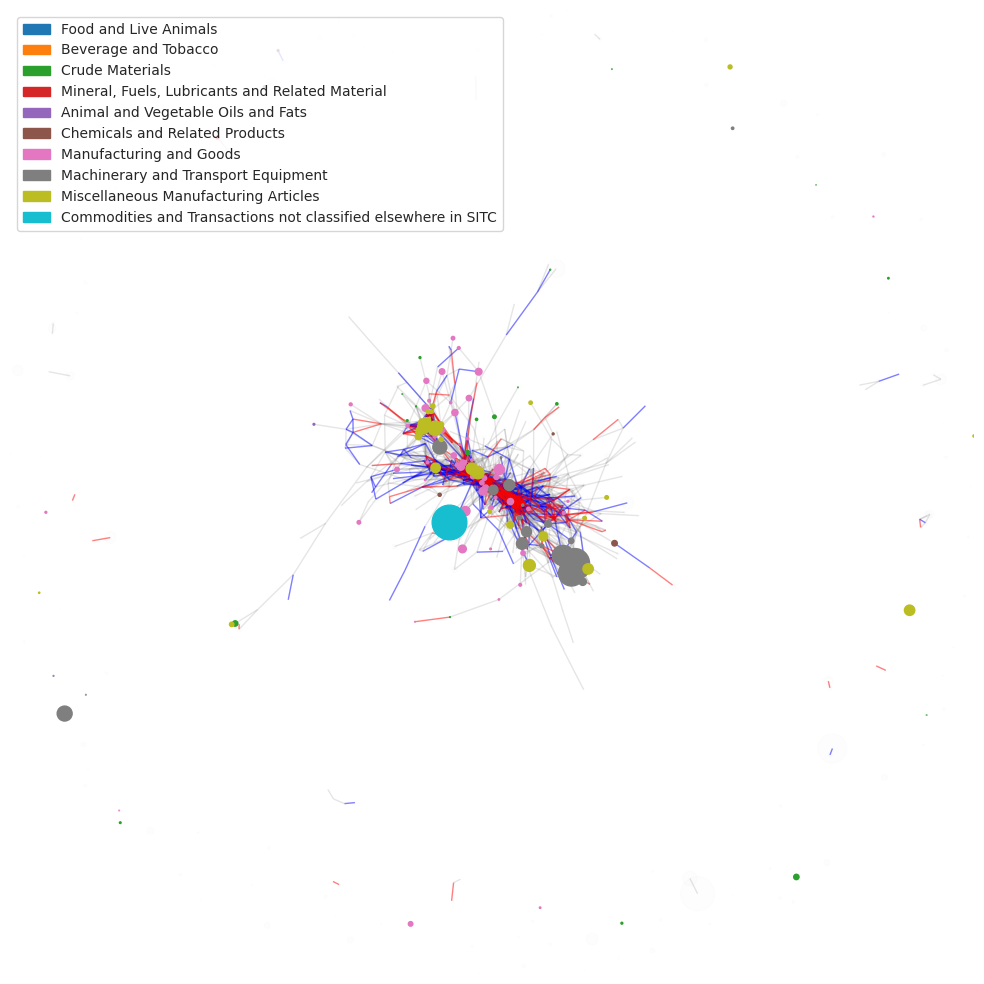

In [ ]:
import random

temp_year = 2018
temp_country = 'VNM'

random.seed(123)
sns.set_theme(style="white")

temp_net_df = proximity[temp_year].copy()
temp_net_df = pd.DataFrame(temp_net_df, index = binary_rca[temp_year].columns, columns = binary_rca[temp_year].columns)
input_Proximity_Matrix = temp_net_df.copy()

threshold = 0.5
temp_nodes=sorted(input_Proximity_Matrix.columns)

temp_G=nx.Graph()
for i in range(len(temp_nodes)):
  temp_G.add_node(temp_nodes[i])
  for j in range(i+1,len(temp_nodes)):
    if input_Proximity_Matrix.loc[temp_nodes[i],temp_nodes[j]]>=threshold:
      temp_G.add_edge(temp_nodes[i],temp_nodes[j],weight=input_Proximity_Matrix.loc[temp_nodes[i],temp_nodes[j]])

pos1=nx.spring_layout(temp_G)

# Group by 'sitc_product_code' and sum the 'export_value'
temp_product_df = product_df[product_df['year']==temp_year].copy()
grouped_product_df = temp_product_df[['sitc_product_code', 'export_value']].groupby('sitc_product_code').sum()

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Apply MinMax scaling to the 'export_value'
grouped_product_df['export_value_scaled'] = scaler.fit_transform(grouped_product_df[['export_value']])
#grouped_product_df['export_value_scaled'] = np.log1p(grouped_product_df['export_value'])

node_size_dict = dict(zip(grouped_product_df.index,1000*grouped_product_df['export_value_scaled']))


temp_rca_products = (binary_rca[temp_year].loc[temp_country]==1).astype(int)
temp_rca_products = temp_rca_products[temp_rca_products==1].index

fig=plt.figure(figsize=(10,10))
ax=plt.subplot(111)
for i in range(1,10):
  temp_sub_nodes=[node for node in temp_nodes if len(node)==4 if node[0]==str(i) if node in node_size_dict.keys()]
  node_size_list1= []
  node_size_list2 = []
  for node in temp_sub_nodes:
    if node in temp_rca_products:
      node_size_list1.append(node_size_dict[node]*1.5)
    else:
      node_size_list2.append(node_size_dict[node])

  node1 = [node for node in temp_sub_nodes if node in temp_rca_products]
  node2 = [node for node in temp_sub_nodes if node not in temp_rca_products]

  nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=node1,node_size=node_size_list1,node_color=sitc_code_color_dict[str(i)],alpha=1,ax=ax)
  nx.draw_networkx_nodes(temp_G,pos=pos1,nodelist=node2,node_size=node_size_list2,node_color='grey',alpha=0.01,ax=ax)

nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.5 if temp_G[x[0]][x[1]]["weight"]<0.55],alpha=0.2,edge_color="grey",ax=ax)
nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>0.55 if temp_G[x[0]][x[1]]["weight"]<0.6],alpha=0.5,edge_color="blue",ax=ax)
nx.draw_networkx_edges(temp_G,pos=pos1,edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"]>=0.6],alpha=0.5,edge_color="red",ax=ax)

# Boundary
ax.set_xlim(min(pos1[x][0] for x in pos1.keys()),
          max(pos1[x][0] for x in pos1.keys()))
ax.set_ylim(min(pos1[x][1] for x in pos1.keys()),
          max(pos1[x][1] for x in pos1.keys()))

# Legend
temp_arr_list=[]
temp_key_list=[]
for key in sitc_code_dict.keys():
  temp_arr_list.append(
      plt.arrow(0,0, 0,0, head_width=0, color=sitc_code_color_dict[key], length_includes_head=True,label=sitc_code_dict[key])
  )
  temp_key_list.append(
      sitc_code_dict[key]
  )
ax.axis('off')
ax.legend(temp_arr_list,temp_key_list,fontsize=10, loc='upper left')
plt.tight_layout()



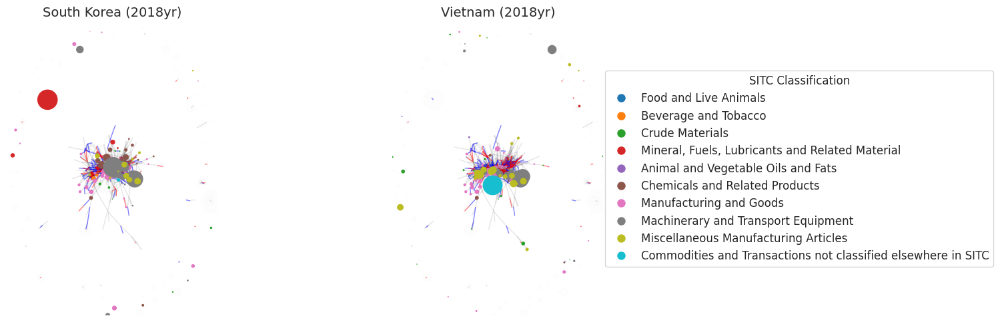

In [ ]:
import random
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Set up for consistent results
random.seed(123)
sns.set_theme(style="white")

# Create proximity network (same layout shared between both countries)
temp_year = 2018
temp_net_df = proximity[temp_year].copy()
temp_net_df = pd.DataFrame(temp_net_df, index=binary_rca[temp_year].columns, columns=binary_rca[temp_year].columns)
input_Proximity_Matrix = temp_net_df.copy()

threshold = 0.5
temp_nodes = sorted(input_Proximity_Matrix.columns)

temp_G = nx.Graph()
for i in range(len(temp_nodes)):
    temp_G.add_node(temp_nodes[i])
    for j in range(i + 1, len(temp_nodes)):
        if input_Proximity_Matrix.loc[temp_nodes[i], temp_nodes[j]] >= threshold:
            temp_G.add_edge(temp_nodes[i], temp_nodes[j], weight=input_Proximity_Matrix.loc[temp_nodes[i], temp_nodes[j]])

pos1 = nx.spring_layout(temp_G)  # Shared layout

# Function to draw network for a specific country
def draw_network(ax, country, pos1):
    temp_rca_products = (binary_rca[temp_year].loc[country] == 1).astype(int)
    temp_rca_products = temp_rca_products[temp_rca_products == 1].index

    grouped_product_df = temp_product_df[['sitc_product_code', 'export_value']].groupby('sitc_product_code').sum()
    scaler = MinMaxScaler()
    grouped_product_df['export_value_scaled'] = scaler.fit_transform(grouped_product_df[['export_value']])
    node_size_dict = dict(zip(grouped_product_df.index, 1000 * grouped_product_df['export_value_scaled']))

    for i in range(1, 10):
        temp_sub_nodes = [node for node in temp_nodes if len(node) == 4 if node[0] == str(i) if node in node_size_dict.keys()]
        node_size_list1 = []
        node_size_list2 = []
        for node in temp_sub_nodes:
            if node in temp_rca_products:
                node_size_list1.append(node_size_dict[node])
            else:
                node_size_list2.append(node_size_dict[node])

        node1 = [node for node in temp_sub_nodes if node in temp_rca_products]
        node2 = [node for node in temp_sub_nodes if node not in temp_rca_products]

        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node1, node_size=node_size_list1, node_color=sitc_code_color_dict[str(i)], alpha=1, ax=ax)
        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node2, node_size=node_size_list2, node_color='grey', alpha=0.01, ax=ax)

    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] >= 0.5 if temp_G[x[0]][x[1]]["weight"] < 0.55], alpha=0.2, edge_color="grey", ax=ax)
    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] > 0.55 if temp_G[x[0]][x[1]]["weight"] < 0.6], alpha=0.5, edge_color="blue", ax=ax)
    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] >= 0.6], alpha=0.5, edge_color="red", ax=ax)

    ax.set_xlim(min(pos1[x][0] for x in pos1), max(pos1[x][0] for x in pos1))
    ax.set_ylim(min(pos1[x][1] for x in pos1), max(pos1[x][1] for x in pos1))

    ax.axis('off')

# Create a 1x3 panel
fig, axes = plt.subplots(1, 3, figsize=(15, 5), gridspec_kw={'width_ratios': [1, 1, 0.2]})

# Draw networks
draw_network(axes[0], 'KOR', pos1)
axes[0].set_title("South Korea (2018yr)", fontsize=14)

draw_network(axes[1], 'VNM', pos1)
axes[1].set_title("Vietnam (2018yr)", fontsize=14)

# Create legend in the third panel
temp_arr_list = []
temp_key_list = []
for key in sitc_code_dict.keys():
    temp_arr_list.append(
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=sitc_code_color_dict[key], markersize=10, label=sitc_code_dict[key])
    )
    temp_key_list.append(
        sitc_code_dict[key]
    )

axes[2].legend(temp_arr_list, temp_key_list, fontsize=12, loc='center', title="SITC Classification")
axes[2].axis('off')  # Remove axis for the legend panel

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
eci[2018].sort_values()

,2018
location_code,
NGA,-1.672377
AZE,-1.593462
PNG,-1.578965
CMR,-1.552236
SDN,-1.465701
...,...
SWE,1.853921
DEU,2.006079
KOR,2.006672


In [ ]:
sitc_code_color_dict['7'] = 'black'

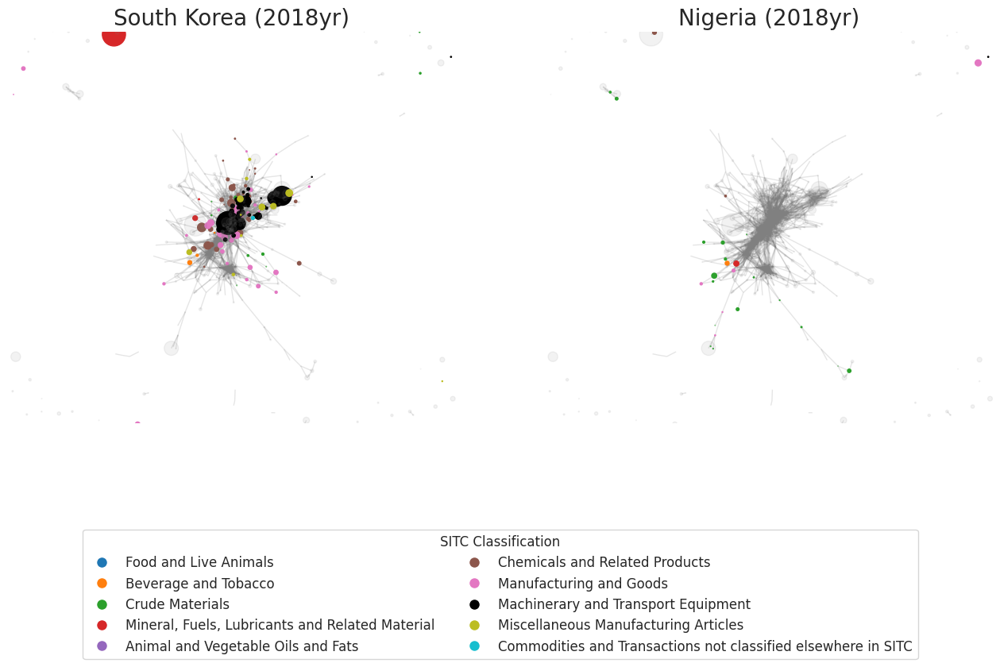

In [ ]:
import random
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Set up for consistent results
random.seed(123)
sns.set_theme(style="white")

# Create proximity network (same layout shared between both countries)
temp_year = 2018
temp_net_df = proximity[temp_year].copy()
temp_net_df = pd.DataFrame(temp_net_df, index=binary_rca[temp_year].columns, columns=binary_rca[temp_year].columns)
input_Proximity_Matrix = temp_net_df.copy()

threshold = 0.5
temp_nodes = sorted(input_Proximity_Matrix.columns)

temp_G = nx.Graph()
for i in range(len(temp_nodes)):
    temp_G.add_node(temp_nodes[i])
    for j in range(i + 1, len(temp_nodes)):
        if input_Proximity_Matrix.loc[temp_nodes[i], temp_nodes[j]] >= threshold:
            temp_G.add_edge(temp_nodes[i], temp_nodes[j], weight=input_Proximity_Matrix.loc[temp_nodes[i], temp_nodes[j]])

pos1 = nx.spring_layout(temp_G)  # Shared layout

# Function to draw network for a specific country
def draw_network(ax, country, pos1):
    temp_rca_products = (binary_rca[temp_year].loc[country] == 1).astype(int)
    temp_rca_products = temp_rca_products[temp_rca_products == 1].index

    grouped_product_df = temp_product_df[['sitc_product_code', 'export_value']].groupby('sitc_product_code').sum()
    scaler = MinMaxScaler()
    grouped_product_df['export_value_scaled'] = scaler.fit_transform(grouped_product_df[['export_value']])
    node_size_dict = dict(zip(grouped_product_df.index, 1000 * grouped_product_df['export_value_scaled']))

    for i in range(1, 10):
        temp_sub_nodes = [node for node in temp_nodes if len(node) == 4 if node[0] == str(i) if node in node_size_dict.keys()]
        node_size_list1 = []
        node_size_list2 = []
        for node in temp_sub_nodes:
            if node in temp_rca_products:
                node_size_list1.append(node_size_dict[node])
            else:
                node_size_list2.append(node_size_dict[node])

        node1 = [node for node in temp_sub_nodes if node in temp_rca_products]
        node2 = [node for node in temp_sub_nodes if node not in temp_rca_products]

        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node1, node_size=node_size_list1, node_color=sitc_code_color_dict[str(i)], alpha=1, ax=ax)
        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node2, node_size=node_size_list2, node_color='grey', alpha=0.1, ax=ax)

    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] >= 0.5 if temp_G[x[0]][x[1]]["weight"] < 0.55], alpha=0.2, edge_color="grey", ax=ax)
    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] > 0.55 if temp_G[x[0]][x[1]]["weight"] < 0.6], alpha=0.2, edge_color="grey", ax=ax)
    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=[x for x in temp_G.edges() if temp_G[x[0]][x[1]]["weight"] >= 0.6], alpha=0.2, edge_color="grey", ax=ax)

    ax.set_xlim(min(pos1[x][0] for x in pos1)*0.8, max(pos1[x][0] for x in pos1)*0.8)
    ax.set_ylim(min(pos1[x][1] for x in pos1)*0.8, max(pos1[x][1] for x in pos1)*0.8)

    ax.axis('off')

# Create a 2x1 panel with gridspec for legend below
fig = plt.figure(figsize=(16, 10))
gs = fig.add_gridspec(2, 2, height_ratios=[4, 1], hspace=0.5)

# First row: Network plots for KOR and NGA
ax_kor = fig.add_subplot(gs[0, 0])
draw_network(ax_kor, 'KOR', pos1)
ax_kor.set_title("South Korea (2018yr)", fontsize=20)

ax_NGA = fig.add_subplot(gs[0, 1])
draw_network(ax_NGA, 'NGA', pos1)
ax_NGA.set_title("Nigeria (2018yr)", fontsize=20)

# Second row: Legend spanning both columns
ax_legend = fig.add_subplot(gs[1, :])
temp_arr_list = []
temp_key_list = []
for key in sitc_code_dict.keys():
    temp_arr_list.append(
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=sitc_code_color_dict[key], markersize=10, label=sitc_code_dict[key])
    )
    temp_key_list.append(
        sitc_code_dict[key]
    )

ax_legend.legend(temp_arr_list, temp_key_list , fontsize=12, loc='center', ncol=len(temp_key_list)/4, title="SITC Classification")
ax_legend.axis('off')  # Hide axes for legend

# Show plot
plt.show()


#### Producer Space

In [ ]:
# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

In [ ]:
del continent_color_dict['Etc']

In [ ]:
sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']=='7628']

,product_id,sitc_product_code,sitc_product_name_short_en,level,parent_id
717,1281,7628,Other radio receivers,4digit,151.0


In [ ]:
binary_rca[temp_year].loc['USA'].sort_values(ascending=False).head(50)

,USA
sitc_product_code,
unspecified,1
2919,1
7822,1
7821,1
7138,1
7144,1
7148,1
2820,1
7149,1


In [ ]:
temp_id = '7234'
sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']==temp_id]

,product_id,sitc_product_code,sitc_product_name_short_en,level,parent_id
646,1210,7234,"Construction and mining machinery, nes",4digit,147.0


In [ ]:
binary_rca[temp_year][temp_id][binary_rca[temp_year][temp_id]==1]

,7234
location_code,
AUT,1
BRA,1
DEU,1
EST,1
FIN,1
GBR,1
ITA,1
JPN,1
KOR,1


In [ ]:
sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']=='7783']

,product_id,sitc_product_code,sitc_product_name_short_en,level,parent_id
747,1311,7783,Automotive electrical equipment; and parts the...,4digit,152.0


In [ ]:
binary_rca[temp_year].loc['KOR'][binary_rca[temp_year].loc['KOR']==1].index

Index(['1122', '1222', '1223', '2331', '2634', '2665', '2666', '2667', '2672',
       '2690',
       ...
       '8742', '8821', '8822', '8841', '8928', '8946', '8983', '8989', '8991',
       '9510'],
      dtype='object', name='sitc_product_code', length=173)

In [ ]:
temp_year = 2018

In [ ]:
'''
temp_list1 = imitation_density_4[temp_year].loc['KOR'].values
temp_df = pd.DataFrame()
temp_df['sitc_code'] = binary_rca[temp_year].columns
temp_df['imitation_density'] = temp_list1
temp_df['pci'] = pci[temp_year].values
temp_df = temp_df[temp_df['pci']<=0]

temp_rcas = list(binary_rca[temp_year].loc['KOR'][binary_rca[temp_year].loc['KOR']==1].index)
temp_df = temp_df[temp_df['sitc_code'].isin(temp_rcas)]
temp_df.sort_values(by='imitation_density',ascending=False).tail(20)
'''

"\ntemp_list1 = imitation_density_4[temp_year].loc['KOR'].values\ntemp_df = pd.DataFrame()\ntemp_df['sitc_code'] = binary_rca[temp_year].columns\ntemp_df['imitation_density'] = temp_list1\ntemp_df['pci'] = pci[temp_year].values\ntemp_df = temp_df[temp_df['pci']<=0]\n\ntemp_rcas = list(binary_rca[temp_year].loc['KOR'][binary_rca[temp_year].loc['KOR']==1].index)\ntemp_df = temp_df[temp_df['sitc_code'].isin(temp_rcas)]\ntemp_df.sort_values(by='imitation_density',ascending=False).tail(20)\n"

In [ ]:
len(temp_df)

124

In [ ]:
sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']=='3353']

,product_id,sitc_product_code,sitc_product_name_short_en,level,parent_id
310,874,3353,"Mineral tar pitch, pitch coke",4digit,122.0


In [ ]:
!pip install adjustText

{'AGO': 15.594885571219162, 'ALB': 2.279493524148692, 'ARE': 121.3630532496253, 'ARG': 28.090686060348876, 'AUS': 116.79455966895719, 'AUT': 92.6957587932431, 'AZE': 8.515989347191239, 'BEL': 167.1163242178281, 'BGD': 15.408613315260205, 'BGR': 16.294559051731646, 'BHR': 11.494630827305112, 'BIH': 3.4201839387149193, 'BLR': 13.889211118942848, 'BOL': 3.5691351430407767, 'BRA': 97.46084461392664, 'BWA': 2.2512361877574185, 'CAN': 201.55799127150607, 'CHE': 163.00651398193617, 'CHL': 30.307462316230676, 'CHN': 1000.0, 'CIV': 4.555660020764424, 'CMR': 2.1077518061847713, 'COG': 4.210939192072959, 'COL': 20.016814661975538, 'CRI': 8.024554938425144, 'CUB': 0.44867646491985247, 'CZE': 83.53933153287086, 'DEU': 708.3018148780747, 'DNK': 71.12863546634217, 'DOM': 7.115377850416704, 'DZA': 15.110190365802879, 'ECU': 8.878314039981573, 'EGY': 20.29927860533349, 'ESP': 185.27224402247097, 'EST': 8.839264404671269, 'ETH': 2.5838136301096255, 'FIN': 39.729396088259534, 'FRA': 321.4771561792688, 'G

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


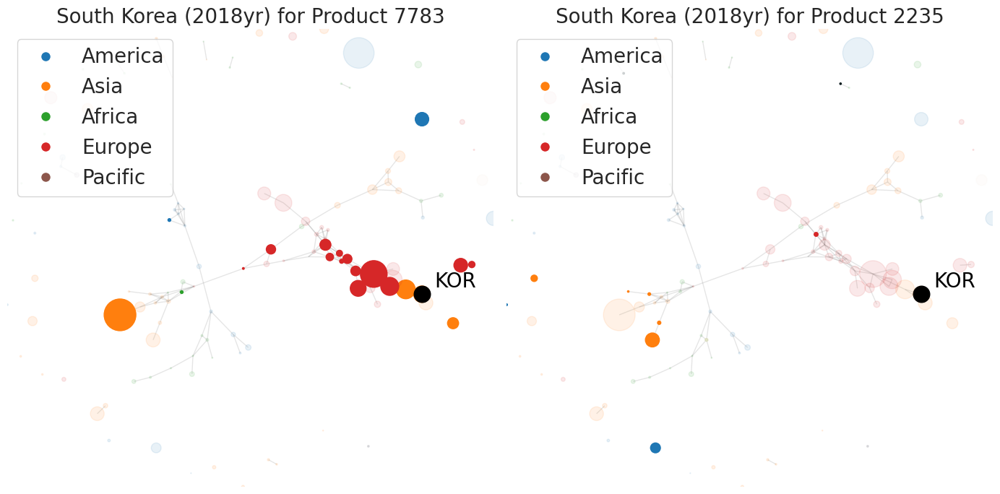

In [ ]:
import random
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from adjustText import adjust_text

# Set up consistent results
random.seed(123)
sns.set_theme(style="white")

# Common layout for both networks
temp_year = 2018
threshold = 0.4

temp_product_df = product_df[product_df['year']==temp_year]

# Create proximity network (shared layout)
temp_net_df = Export_Similarity_4[temp_year].copy()
temp_net_df = pd.DataFrame(temp_net_df, index=binary_rca[temp_year].index, columns=binary_rca[temp_year].index)
temp_nodes = sorted(temp_net_df.columns)
temp_nodes = [node for node in temp_nodes if node in country2continent.keys()]

temp_G = nx.Graph()
for i in range(len(temp_nodes)):
    temp_G.add_node(temp_nodes[i])
    for j in range(i + 1, len(temp_nodes)):
        if temp_net_df.loc[temp_nodes[i], temp_nodes[j]] >= threshold:
            temp_G.add_edge(temp_nodes[i], temp_nodes[j], weight=temp_net_df.loc[temp_nodes[i], temp_nodes[j]])

pos1 = nx.spring_layout(temp_G)  # Shared layout

grouped_product_df = temp_product_df[['location_code', 'export_value']].groupby('location_code').sum()
scaler = MinMaxScaler()
grouped_product_df['export_value_scaled'] = scaler.fit_transform(grouped_product_df[['export_value']])
node_size_dict = dict(zip(grouped_product_df.index, 1000 * grouped_product_df['export_value_scaled']))

# Function to draw network for a specific product
def draw_network_producer_space(temp_ax, temp_target_product, temp_country):
    temp_rca_countries = [
        index for index in temp_nodes
        if binary_rca[temp_year].loc[index, temp_target_product] == 1
    ]

    for i in continent_color_dict.keys():
        temp_sub_nodes = [
            node for node in temp_nodes if country2continent[node] == i
        ]

        node1 = list(([node for node in temp_sub_nodes if node in temp_rca_countries]))
        node2 = list(([node for node in temp_sub_nodes if node]))

        node_size_list1 = [node_size_dict[node] for node in node1]
        node_size_list2 = [node_size_dict[node] for node in node2]
        print(node_size_dict)

        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node1, node_size=node_size_list1, node_color=continent_color_dict[i], alpha=1, ax=temp_ax)
        nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=node2, node_size=node_size_list2, node_color=continent_color_dict[i], alpha=0.1, ax=temp_ax)

    edges_to_draw = [e for e in temp_G.edges() if temp_G[e[0]][e[1]]["weight"] >= 0.4]
    nx.draw_networkx_edges(temp_G, pos=pos1, edgelist=edges_to_draw, alpha=0.2, edge_color="grey", ax=temp_ax)

    important_nodes = [temp_country]
    texts = [
        temp_ax.text(pos1[node][0], pos1[node][1], node, fontsize=20, color="black")
        for node in important_nodes
    ]
    #texts += [
    #    temp_ax.text(pos1[node][0], pos1[node][1], node, fontsize=15, color="black")
    #    for node in temp_rca_countries if node!=important_nodes[0]
    #]
    adjust_text(texts, ax=temp_ax)
    nx.draw_networkx_nodes(temp_G, pos=pos1, nodelist=[temp_country], node_size=[node_size_dict.get(temp_country, 200)], node_color='black', ax=temp_ax)


    temp_ax.set_xlim(min(pos1[x][0] for x in pos1), max(pos1[x][0] for x in pos1))
    temp_ax.set_ylim(min(pos1[x][1] for x in pos1), max(pos1[x][1] for x in pos1))
    temp_ax.axis('off')

    # Add legend
    temp_arr_list = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=continent_color_dict[key], markersize=10, label=key)
        for key in continent_color_dict.keys() if key not in ['etc']
    ]
    temp_ax.legend(temp_arr_list, [key for key in continent_color_dict.keys() if key not in ['etc']], fontsize=20, loc='upper left')

# Create a 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

# First network plot (Product 7783)
draw_network_producer_space(axes[0], '7783', 'KOR')
axes[0].set_title("South Korea (2018yr) for Product 7783", fontsize=20)

# Second network plot (Product 2235)
draw_network_producer_space(axes[1], '2235', 'KOR')
axes[1].set_title("South Korea (2018yr) for Product 2235", fontsize=20)

# Adjust layout and show
plt.tight_layout()
plt.show()

In [ ]:
print(sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']=='7783']['sitc_product_name_short_en'].items)

<bound method Series.items of 747    Automotive electrical equipment; and parts the...
Name: sitc_product_name_short_en, dtype: object>


In [ ]:
binary_rca[temp_year]['7783'][binary_rca[temp_year]['7783']==1]

,7783
location_code,
AUT,1
CHN,1
CRI,1
CZE,1
DEU,1
ESP,1
FRA,1
HUN,1
ITA,1


In [ ]:
sitc_dictionary_df[sitc_dictionary_df['sitc_product_code']=='2235']

,product_id,sitc_product_code,sitc_product_name_short_en,level,parent_id
207,771,2235,Castor oil seeds,4digit,113.0


In [ ]:
binary_rca[temp_year]['2235'][binary_rca[temp_year]['2235']==1]

,2235
location_code,
BRA,1
ETH,1
GHA,1
IND,1
ISR,1
LAO,1
LTU,1
MMR,1
PAK,1


# Diversified Pattern

In [ ]:
year = 1970

complex_countries = eci[year][eci[year]>=0].index
simple_counties = eci[year][eci[year]<0].index

len(complex_countries), len(simple_counties)

(63, 61)

In [ ]:
end_year = 2020

In [ ]:
temp_result_list = []

year = 1962
for year in tqdm(range(start_year,end_year-1)):
  for temp_country in binary_rca[year].index:
    temp_df = Opportunity[year]*binary_rca[year+2]
    temp_diversified_list = temp_df.loc[temp_country][temp_df.loc[temp_country]==1].index
    temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
    temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

    for item in temp_diversified_list:
      temp_list = []
      temp_list.append(temp_country)
      temp_list.append(item)
      temp_list.append(year)
      temp_list.append(temp_xs[item])
      temp_list.append(temp_ys[item])
      temp_list.append(eci[year].loc[temp_country])
      temp_result_list.append(temp_list)

temp_plot_df = pd.DataFrame(temp_result_list,columns = ['country','product','year','Relative Relatedness','Relative pci','eci'])
temp_plot_df['Country Type'] = temp_plot_df['eci'].apply(lambda x: 'Complex' if x>=0 else 'Simple')
temp_plot_df

100%|██████████| 57/57 [00:08<00:00,  6.38it/s]


,country,product,year,Relative Relatedness,Relative pci,eci,Country Type
0,AGO,0721,1962,5.524756,-2.685975,-0.866697,Simple
1,AGO,2235,1962,5.111803,-2.781957,-0.866697,Simple
2,AGO,2517,1962,0.712597,-0.477500,-0.866697,Simple
3,ALB,0341,1962,1.230892,-1.094691,-0.809401,Simple
4,ALB,0342,1962,1.230892,-1.094691,-0.809401,Simple
...,...,...,...,...,...,...,...
146726,ZWE,2924,2018,2.568962,-1.794034,-1.086484,Simple
146727,ZWE,4233,2018,1.479781,-1.455087,-1.086484,Simple
146728,ZWE,6624,2018,0.318543,-0.430180,-1.086484,Simple
146729,ZWE,6724,2018,0.506832,-0.497454,-1.086484,Simple


In [ ]:
len(temp_plot_df)

146731

In [ ]:
temp_plot_df.head()

,country,product,year,Relative Relatedness,Relative pci,eci,Country Type
0,AGO,0721,1962,5.524756,-2.685975,-0.866697,Simple
1,AGO,2235,1962,5.111803,-2.781957,-0.866697,Simple
2,AGO,2517,1962,0.712597,-0.477500,-0.866697,Simple
3,ALB,0341,1962,1.230892,-1.094691,-0.809401,Simple
4,ALB,0342,1962,1.230892,-1.094691,-0.809401,Simple


In [ ]:
temp_plot_df['Product Type'] = temp_plot_df[['Relative Relatedness','Relative pci']].apply(lambda x: 'Related Complex' if x[0]>=0 and x[1]>=0 else ('Related Simple' if x[0]>=0 and x[1]<0 else ('Unrelated Complex' if x[0]<0 and x[1]>=0 else 'Unrelated Simple')), axis = 1)

<ipython-input-195-96d61c7cc634>:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  temp_plot_df['Product Type'] = temp_plot_df[['Relative Relatedness','Relative pci']].apply(lambda x: 'Related Complex' if x[0]>=0 and x[1]>=0 else ('Related Simple' if x[0]>=0 and x[1]<0 else ('Unrelated Complex' if x[0]<0 and x[1]>=0 else 'Unrelated Simple')), axis = 1)


In [ ]:
temp_plot_df2 = temp_plot_df[temp_plot_df['year']==1995]
temp_plot_df2 = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']
temp_df = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']['Product Type'].value_counts(normalize = True)

In [ ]:
temp_df.loc['Related Simple']

0.4063974829575249

In [ ]:
temp_df.loc['Related Simple']

0.4063974829575249

In [ ]:
temp_df.loc['Related Simple']

0.4063974829575249

In [ ]:
f'Related \nSimple\n({0.4063974829575249:.2f})'

'Related \nSimple\n(0.41)'

Product Type
Related Simple       0.416887
Related Complex      0.309587
Unrelated Complex    0.187335
Unrelated Simple     0.086192
Name: proportion, dtype: float64
Product Type
Related Simple       0.764324
Unrelated Complex    0.151351
Unrelated Simple     0.049730
Related Complex      0.034595
Name: proportion, dtype: float64


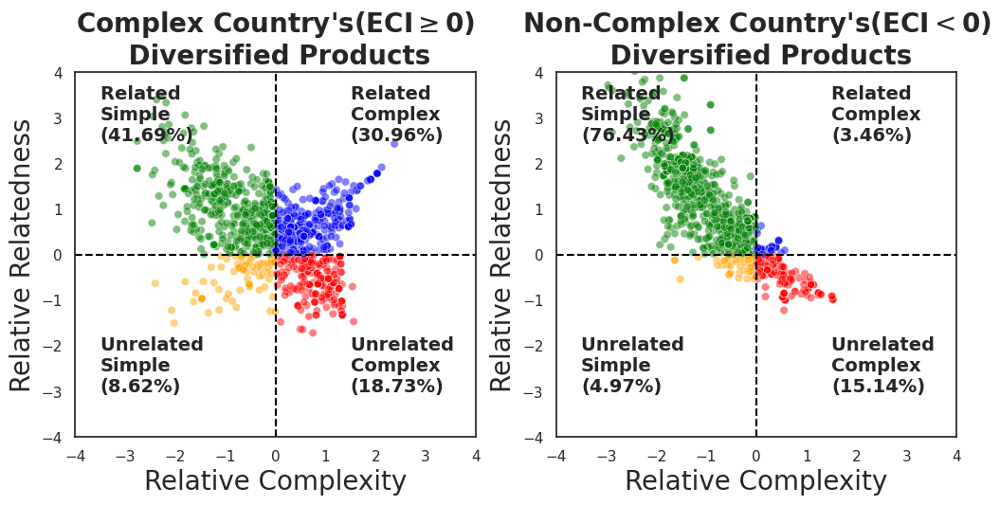

In [ ]:
# 1970

# Amount of unrelated diversification
fig, ax = plt.subplots(ncols=2, nrows=1, figsize=(12, 5))
ax = ax.flatten()

palette = {
    'Related Complex': 'blue',
    'Related Simple': 'green',
    'Unrelated Complex': 'red',
    'Unrelated Simple': 'orange'
}
temp_plot_df2 = temp_plot_df[temp_plot_df['year']==1970]
temp_plot_df2 = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']
print(temp_plot_df2[temp_plot_df2['Country Type']=='Complex']['Product Type'].value_counts(normalize = True))
temp_df = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']['Product Type'].value_counts(normalize = True)

sns.scatterplot(data=temp_plot_df2, y='Relative Relatedness', x='Relative pci', alpha = 0.5, ax = ax[0], hue = 'Product Type',palette = palette, legend = False)
temp_value = temp_df.loc['Related Simple']
ax[0].text(-3.5,2.5,f'Related \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Related Complex']
ax[0].text(1.5,2.5,f'Related \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Simple']
ax[0].text(-3.5,-3,f'Unrelated \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Complex']
ax[0].text(1.5,-3,f'Unrelated \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)

ax[0].axhline(y=0, color='black', linestyle='--')
ax[0].axvline(x=0, color='black', linestyle='--')
ax[0].set_xlim(-4,4)
ax[0].set_ylim(-4,4)
ax[0].set_title('Complex Country\'s(ECI$\\geq$0)\n Diversified Products', fontsize=20, fontweight='bold')
ax[0].set_xlabel('Relative Complexity',fontsize=20)
ax[0].set_ylabel('Relative Relatedness',fontsize=20)

temp_plot_df2 = temp_plot_df[temp_plot_df['year']==1970]
temp_plot_df2 = temp_plot_df2[temp_plot_df2['Country Type']=='Simple']
sns.scatterplot(data=temp_plot_df2, y='Relative Relatedness', x='Relative pci', alpha = 0.5, ax = ax[1], hue = 'Product Type',palette = palette, legend = False)
print(temp_plot_df2[temp_plot_df2['Country Type']=='Simple']['Product Type'].value_counts(normalize = True))
temp_df = temp_plot_df2[temp_plot_df2['Country Type']=='Simple']['Product Type'].value_counts(normalize = True)

ax[1].axhline(y=0, color='black', linestyle='--')
ax[1].axvline(x=0, color='black', linestyle='--')
ax[1].set_xlim(-4,4)
ax[1].set_ylim(-4,4)

temp_value = temp_df.loc['Related Simple']
ax[1].text(-3.5,2.5,f'Related \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Related Complex']
ax[1].text(1.5,2.5,f'Related \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Simple']
ax[1].text(-3.5,-3,f'Unrelated \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Complex']
ax[1].text(1.5,-3,f'Unrelated \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)

ax[1].set_title('Non-Complex Country\'s(ECI$<$0)\n Diversified Products', fontsize=20, fontweight='bold')
ax[1].set_xlabel('Relative Complexity',fontsize=20)
ax[1].set_ylabel('Relative Relatedness',fontsize=20)

plt.savefig(output_directory+'/Figure_241226_1970.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/Figure_241226_1970.pdf',dpi = 600, transparent=True, bbox_inches="tight")

In [ ]:
temp_df

,proportion
Product Type,
Related Simple,0.764324
Unrelated Complex,0.151351
Unrelated Simple,0.049730
Related Complex,0.034595


In [ ]:
temp_df

,proportion
Product Type,
Related Simple,0.764324
Unrelated Complex,0.151351
Unrelated Simple,0.049730
Related Complex,0.034595


In [ ]:
temp_plot_df2

,country,product,year,Relative Relatedness,Relative pci,eci,Country Type,Product Type
15547,AGO,0421,1970,1.315379,-1.914746,-1.401312,Simple,Related Simple
15548,AGO,0460,1970,0.234927,-0.660498,-1.401312,Simple,Related Simple
15549,AGO,0582,1970,0.336100,-0.988138,-1.401312,Simple,Related Simple
15550,AGO,1211,1970,2.763417,-1.894156,-1.401312,Simple,Related Simple
15551,AGO,1212,1970,2.763417,-1.894156,-1.401312,Simple,Related Simple
...,...,...,...,...,...,...,...,...
17540,ZAF,7371,1970,-0.871280,1.289494,-0.524193,Simple,Unrelated Complex
17541,ZAF,7372,1970,-0.871280,1.289494,-0.524193,Simple,Unrelated Complex
17542,ZMB,0014,1970,0.034869,-0.281628,-0.946308,Simple,Related Simple
17543,ZMB,2632,1970,1.365935,-1.502869,-0.946308,Simple,Related Simple


In [ ]:
temp_plot_df

,country,product,year,Relative Relatedness,Relative pci,eci,Country Type,Product Type
0,AGO,0721,1962,5.524756,-2.685975,-0.866697,Simple,Related Simple
1,AGO,2235,1962,5.111803,-2.781957,-0.866697,Simple,Related Simple
2,AGO,2517,1962,0.712597,-0.477500,-0.866697,Simple,Related Simple
3,ALB,0341,1962,1.230892,-1.094691,-0.809401,Simple,Related Simple
4,ALB,0342,1962,1.230892,-1.094691,-0.809401,Simple,Related Simple
...,...,...,...,...,...,...,...,...
146726,ZWE,2924,2018,2.568962,-1.794034,-1.086484,Simple,Related Simple
146727,ZWE,4233,2018,1.479781,-1.455087,-1.086484,Simple,Related Simple
146728,ZWE,6624,2018,0.318543,-0.430180,-1.086484,Simple,Related Simple
146729,ZWE,6724,2018,0.506832,-0.497454,-1.086484,Simple,Related Simple


In [ ]:
temp_plot_df['Product Type'].value_counts()

,count
Product Type,
Related Simple,72324
Related Complex,30234
Unrelated Complex,27811
Unrelated Simple,16362


In [ ]:
temp_plot_df['Product Type'].value_counts(normalize = True)

,proportion
Product Type,
Related Simple,0.492902
Related Complex,0.206051
Unrelated Complex,0.189537
Unrelated Simple,0.111510


In [ ]:
len(temp_plot_df)

146731

Product Type
Related Complex      0.401434
Related Simple       0.327599
Unrelated Complex    0.164875
Unrelated Simple     0.106093
Name: proportion, dtype: float64
Product Type
Related Simple       0.688645
Unrelated Complex    0.178571
Related Complex      0.086996
Unrelated Simple     0.045788
Name: proportion, dtype: float64


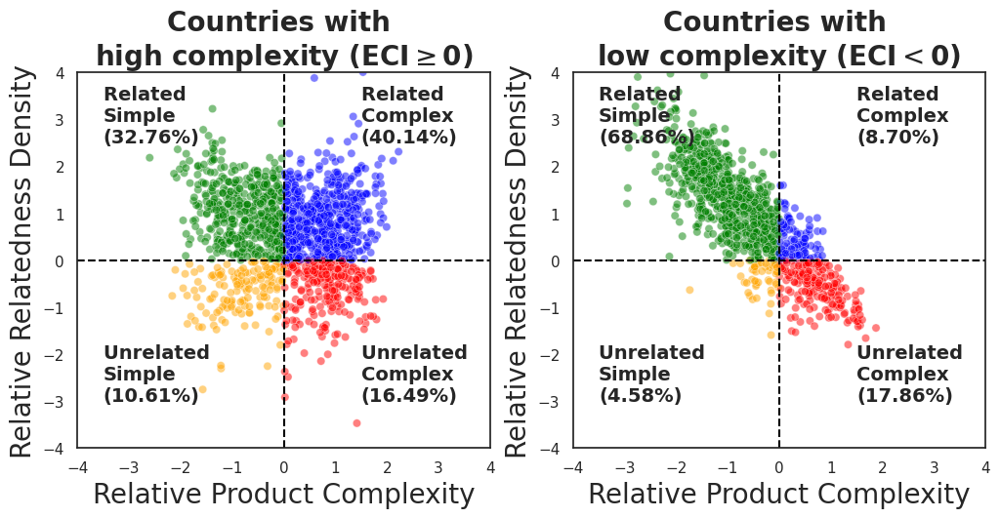

In [ ]:
# 2018

# Amount of unrelated diversification
fig, ax = plt.subplots(ncols=2, nrows=1, figsize=(12, 5))
ax = ax.flatten()

palette = {
    'Related Complex': 'blue',
    'Related Simple': 'green',
    'Unrelated Complex': 'red',
    'Unrelated Simple': 'orange'
}
temp_plot_df2 = temp_plot_df[temp_plot_df['year']==2018]
temp_plot_df2 = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']
print(temp_plot_df2[temp_plot_df2['Country Type']=='Complex']['Product Type'].value_counts(normalize = True))
temp_df = temp_plot_df2[temp_plot_df2['Country Type']=='Complex']['Product Type'].value_counts(normalize = True)

sns.scatterplot(data=temp_plot_df2, y='Relative Relatedness', x='Relative pci', alpha = 0.5, ax = ax[0], hue = 'Product Type',palette = palette, legend = False)
temp_value = temp_df.loc['Related Simple']
ax[0].text(-3.5,2.5,f'Related \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Related Complex']
ax[0].text(1.5,2.5,f'Related \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Simple']
ax[0].text(-3.5,-3,f'Unrelated \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Complex']
ax[0].text(1.5,-3,f'Unrelated \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)

ax[0].axhline(y=0, color='black', linestyle='--')
ax[0].axvline(x=0, color='black', linestyle='--')
ax[0].set_xlim(-4,4)
ax[0].set_ylim(-4,4)
ax[0].set_title('Countries with \nhigh complexity (ECI$\\geq$0)', fontsize=20, fontweight='bold')
ax[0].set_xlabel('Relative Product Complexity',fontsize=20)
ax[0].set_ylabel('Relative Relatedness Density',fontsize=20)

temp_plot_df2 = temp_plot_df[temp_plot_df['year']==2018]
temp_plot_df2 = temp_plot_df2[temp_plot_df2['Country Type']=='Simple']
sns.scatterplot(data=temp_plot_df2, y='Relative Relatedness', x='Relative pci', alpha = 0.5, ax = ax[1], hue = 'Product Type',palette = palette, legend = False)
print(temp_plot_df2[temp_plot_df2['Country Type']=='Simple']['Product Type'].value_counts(normalize = True))
temp_df = temp_plot_df2[temp_plot_df2['Country Type']=='Simple']['Product Type'].value_counts(normalize = True)

ax[1].axhline(y=0, color='black', linestyle='--')
ax[1].axvline(x=0, color='black', linestyle='--')
ax[1].set_xlim(-4,4)
ax[1].set_ylim(-4,4)

temp_value = temp_df.loc['Related Simple']
ax[1].text(-3.5,2.5,f'Related \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Related Complex']
ax[1].text(1.5,2.5,f'Related \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Simple']
ax[1].text(-3.5,-3,f'Unrelated \nSimple\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)
temp_value = temp_df.loc['Unrelated Complex']
ax[1].text(1.5,-3,f'Unrelated \nComplex\n({temp_value*100:.2f}%)',fontweight = 'bold',fontsize = 14)

ax[1].set_title('Countries with \nlow complexity (ECI$<$0)', fontsize=20, fontweight='bold')
ax[1].set_xlabel('Relative Product Complexity',fontsize=20)
ax[1].set_ylabel('Relative Relatedness Density',fontsize=20)

plt.savefig(output_directory+'/Figure_241226_2018.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/Figure_241226_2018.pdf',dpi = 600, transparent=True, bbox_inches="tight")

In [ ]:
temp_df = temp_plot_df.groupby(['year','country'])['Product Type'].value_counts().unstack().fillna(0)
temp_df.sort_values(by='Unrelated Simple',ascending=False).head(20)
temp_outliers = temp_df.sort_values(by='Unrelated Simple',ascending=False).head(30).index
temp_outliers = list(set([item[1] for item in temp_df.sort_values(by='Unrelated Simple',ascending=False).head(30).index]))
len(temp_outliers)

17

In [ ]:
temp_outliers

['ARE',
 'BIH',
 'LVA',
 'SVN',
 'ZWE',
 'KAZ',
 'CZE',
 'EST',
 'GEO',
 'BLR',
 'SRB',
 'HRV',
 'MKD',
 'SVK',
 'MDA',
 'LTU',
 'UKR']

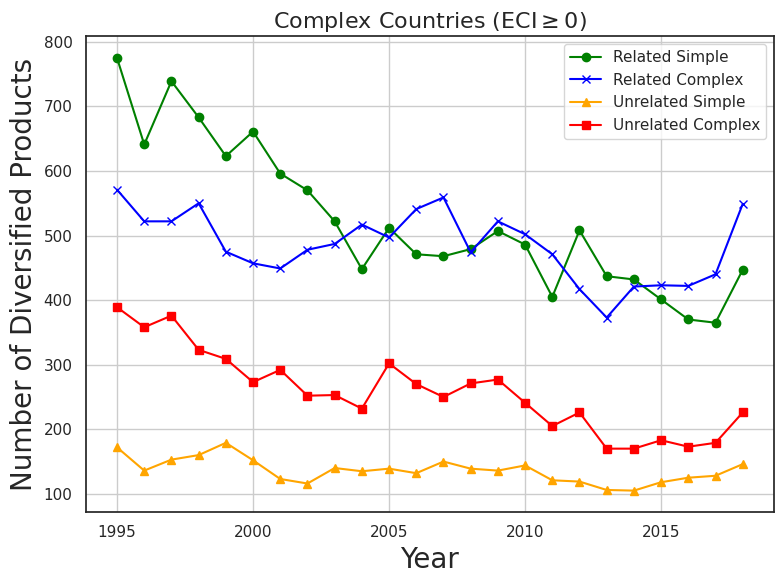

In [ ]:
temp_data = {
    'Year': [],
    'Related Simple': [],
    'Related Complex': [],
    'Unrelated Simple': [],
    'Unrelated Complex': []
}

for year in range(1995, end_year - 1):
    temp_plot_df2 = temp_plot_df[(temp_plot_df['year'] == year) & (temp_plot_df['Country Type'] == 'Complex')]
    #temp_plot_df2 = temp_plot_df2[~temp_plot_df2['country'].isin(temp_outliers)]
    temp_plot_df2 = temp_plot_df2[temp_plot_df2['country']!='SRB']
    temp_counts = temp_plot_df2['Product Type'].value_counts()

    temp_data['Year'].append(year)
    temp_data['Related Simple'].append(temp_counts.get('Related Simple', 0))
    temp_data['Related Complex'].append(temp_counts.get('Related Complex', 0))
    temp_data['Unrelated Simple'].append(temp_counts.get('Unrelated Simple', 0))
    temp_data['Unrelated Complex'].append(temp_counts.get('Unrelated Complex', 0))

temp_df = pd.DataFrame(temp_data)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)

plt.plot(temp_df['Year'], temp_df['Related Simple'], label='Related Simple', color=palette['Related Simple'], marker='o', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Related Complex'], label='Related Complex', color=palette['Related Complex'], marker='x', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Unrelated Simple'], label='Unrelated Simple', color=palette['Unrelated Simple'], marker='^', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Unrelated Complex'], label='Unrelated Complex', color=palette['Unrelated Complex'], marker='s', linestyle='-')

ax.legend()
ax.set_xlabel('Year', fontsize=20)
ax.set_ylabel('Number of Diversified Products', fontsize=20)
ax.set_title('Complex Countries (ECI$\\geq$0)', fontsize=16)
plt.grid(True)
plt.tight_layout()

plt.show()


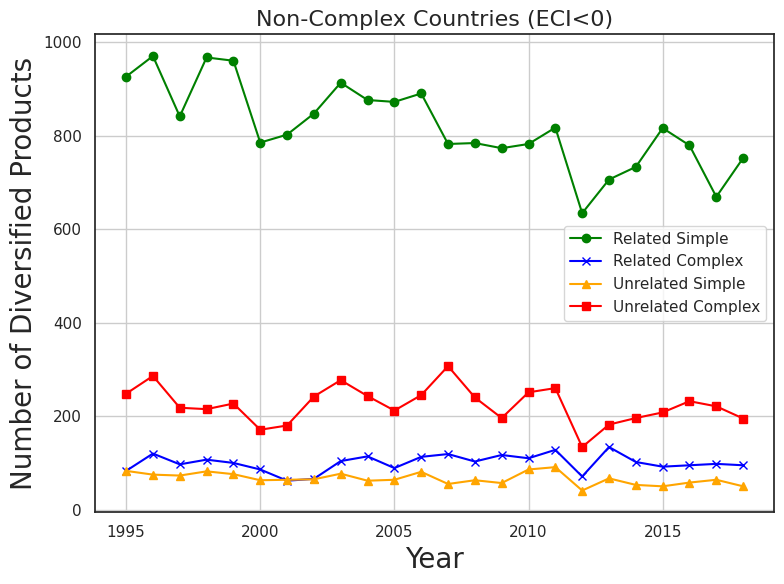

In [ ]:
temp_data = {
    'Year': [],
    'Related Simple': [],
    'Related Complex': [],
    'Unrelated Simple': [],
    'Unrelated Complex': []
}

for year in range(1995, end_year - 1):
    temp_plot_df2 = temp_plot_df[(temp_plot_df['year'] == year) & (temp_plot_df['Country Type'] == 'Simple')]
    #temp_plot_df2 = temp_plot_df2[~temp_plot_df2['country'].isin(temp_outliers)]
    temp_plot_df2 = temp_plot_df2[temp_plot_df2['country']!='SRB']
    temp_counts = temp_plot_df2['Product Type'].value_counts()


    temp_data['Year'].append(year)
    temp_data['Related Simple'].append(temp_counts.get('Related Simple', 0))
    temp_data['Related Complex'].append(temp_counts.get('Related Complex', 0))
    temp_data['Unrelated Simple'].append(temp_counts.get('Unrelated Simple', 0))
    temp_data['Unrelated Complex'].append(temp_counts.get('Unrelated Complex', 0))

# DataFrame
temp_df = pd.DataFrame(temp_data)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)

plt.plot(temp_df['Year'], temp_df['Related Simple'], label='Related Simple', color=palette['Related Simple'], marker='o', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Related Complex'], label='Related Complex', color=palette['Related Complex'], marker='x', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Unrelated Simple'], label='Unrelated Simple', color=palette['Unrelated Simple'], marker='^', linestyle='-')
plt.plot(temp_df['Year'], temp_df['Unrelated Complex'], label='Unrelated Complex', color=palette['Unrelated Complex'], marker='s', linestyle='-')

ax.legend()
ax.set_xlabel('Year', fontsize=20)
ax.set_ylabel('Number of Diversified Products', fontsize=20)
ax.set_title('Non-Complex Countries (ECI<0)', fontsize=16)
plt.grid(True)
plt.tight_layout()

plt.show()


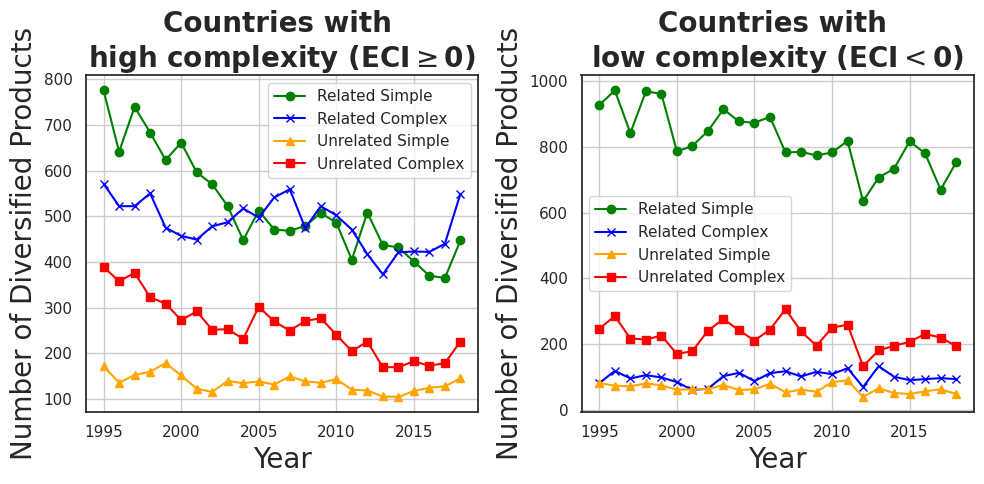

In [ ]:
temp_data_complex = {
    'Year': [],
    'Related Simple': [],
    'Related Complex': [],
    'Unrelated Simple': [],
    'Unrelated Complex': []
}

temp_data_simple = {
    'Year': [],
    'Related Simple': [],
    'Related Complex': [],
    'Unrelated Simple': [],
    'Unrelated Complex': []
}

for year in range(1995, end_year - 1):
    temp_plot_df2_complex = temp_plot_df[(temp_plot_df['year'] == year) & (temp_plot_df['Country Type'] == 'Complex')]
    temp_plot_df2_complex = temp_plot_df2_complex[temp_plot_df2_complex['country']!='SRB']
    temp_counts_complex = temp_plot_df2_complex['Product Type'].value_counts()

    temp_data_complex['Year'].append(year)
    temp_data_complex['Related Simple'].append(temp_counts_complex.get('Related Simple', 0))
    temp_data_complex['Related Complex'].append(temp_counts_complex.get('Related Complex', 0))
    temp_data_complex['Unrelated Simple'].append(temp_counts_complex.get('Unrelated Simple', 0))
    temp_data_complex['Unrelated Complex'].append(temp_counts_complex.get('Unrelated Complex', 0))

    temp_plot_df2_simple = temp_plot_df[(temp_plot_df['year'] == year) & (temp_plot_df['Country Type'] == 'Simple')]
    temp_plot_df2_simple = temp_plot_df2_simple[temp_plot_df2_simple['country']!='SRB']
    temp_counts_simple = temp_plot_df2_simple['Product Type'].value_counts()

    temp_data_simple['Year'].append(year)
    temp_data_simple['Related Simple'].append(temp_counts_simple.get('Related Simple', 0))
    temp_data_simple['Related Complex'].append(temp_counts_simple.get('Related Complex', 0))
    temp_data_simple['Unrelated Simple'].append(temp_counts_simple.get('Unrelated Simple', 0))
    temp_data_simple['Unrelated Complex'].append(temp_counts_simple.get('Unrelated Complex', 0))

# DataFrame
df_complex = pd.DataFrame(temp_data_complex)
df_simple = pd.DataFrame(temp_data_simple)

fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Complex Countries (ECI >= 0)
axes[0].plot(df_complex['Year'], df_complex['Related Simple'], label='Related Simple', color=palette['Related Simple'], marker='o', linestyle='-')
axes[0].plot(df_complex['Year'], df_complex['Related Complex'], label='Related Complex', color=palette['Related Complex'], marker='x', linestyle='-')
axes[0].plot(df_complex['Year'], df_complex['Unrelated Simple'], label='Unrelated Simple', color=palette['Unrelated Simple'], marker='^', linestyle='-')
axes[0].plot(df_complex['Year'], df_complex['Unrelated Complex'], label='Unrelated Complex', color=palette['Unrelated Complex'], marker='s', linestyle='-')
axes[0].set_title('Countries with \nhigh complexity (ECI$\\geq$0)', fontsize=20, fontweight='bold')
axes[0].set_xlabel('Year', fontsize=20)
axes[0].set_ylabel('Number of Diversified Products', fontsize=20)
axes[0].legend()
axes[0].grid(True)

# Non-Complex Countries (ECI < 0)
axes[1].plot(df_simple['Year'], df_simple['Related Simple'], label='Related Simple', color=palette['Related Simple'], marker='o', linestyle='-')
axes[1].plot(df_simple['Year'], df_simple['Related Complex'], label='Related Complex', color=palette['Related Complex'], marker='x', linestyle='-')
axes[1].plot(df_simple['Year'], df_simple['Unrelated Simple'], label='Unrelated Simple', color=palette['Unrelated Simple'], marker='^', linestyle='-')
axes[1].plot(df_simple['Year'], df_simple['Unrelated Complex'], label='Unrelated Complex', color=palette['Unrelated Complex'], marker='s', linestyle='-')
axes[1].set_title('Countries with \nlow complexity (ECI$<$0)', fontsize=20, fontweight='bold')
axes[1].set_xlabel('Year', fontsize=20)
axes[1].set_ylabel('Number of Diversified Products', fontsize=20)
axes[1].legend()
axes[1].grid(True)

# 레이아웃 조정 및 표시
plt.tight_layout()
plt.savefig(output_directory+'/Figure_241226_1995_2015.jpg',dpi = 600, transparent=True, bbox_inches="tight")
plt.savefig(output_directory+'/Figure_241226_1995_2015.pdf',dpi = 600, transparent=True, bbox_inches="tight")
plt.show()


In [ ]:
len(temp_plot_df['country'].unique())

124

In [ ]:
temp_plot_df[temp_plot_df['Country Type']=='Complex']['Product Type'].value_counts(normalize = True)

,proportion
Product Type,
Related Simple,0.350397
Related Complex,0.307451
Unrelated Complex,0.191190
Unrelated Simple,0.150962


In [ ]:
temp_plot_df[temp_plot_df['Country Type']=='Simple']['Product Type'].value_counts(normalize = True)

,proportion
Product Type,
Related Simple,0.685288
Unrelated Complex,0.187306
Related Complex,0.069157
Unrelated Simple,0.058250


In [ ]:
Diversified_product_df = temp_plot_df.copy()

In [ ]:
temp_plot_df2 = temp_plot_df.copy()

temp_result_list = []
for country in temp_plot_df2['country'].unique():
  #year = 1970
  for year in temp_plot_df2[temp_plot_df2['country']==country]['year'].unique():
    temp_plot_df3 = temp_plot_df2[(temp_plot_df2['country']==country) & (temp_plot_df2['year']==year)]
    temp_xs = np.mean(temp_plot_df3['Relative Relatedness'])
    temp_ys = np.mean(temp_plot_df3['Relative pci'])

    temp_list = []
    temp_list.append(country)
    temp_list.append(year)
    temp_list.append(temp_xs)
    temp_list.append(temp_ys)
    temp_list.append(eci[year][country])
    temp_result_list.append(temp_list)

In [ ]:
temp_plot_df_country = pd.DataFrame(temp_result_list,columns = ['country','year','Relative Relatedness','Relative pci','eci'])
temp_plot_df_country['Country Type'] = temp_plot_df_country['eci'].apply(lambda x: 'Complex' if x>=0 else 'Simple')

Text(0, 0.5, 'Relative Relatedness')

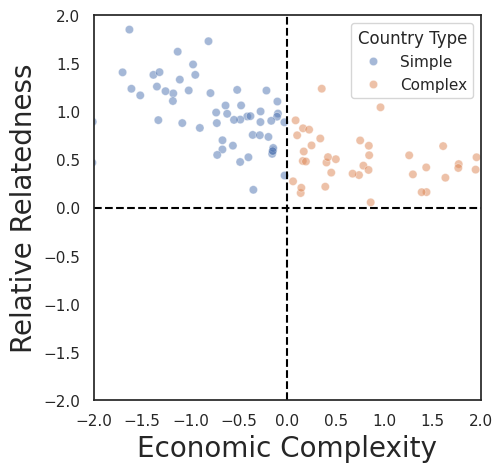

In [ ]:
# Amount of unrelated diversification
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)

temp_plot_df2 = temp_plot_df_country[temp_plot_df_country['year']==1988]
sns.scatterplot(data=temp_plot_df2, y='Relative Relatedness', x='eci', ax=ax, hue = 'Country Type', alpha = 0.5)

ax.axhline(y=0, color='black', linestyle='--')
ax.axvline(x=0, color='black', linestyle='--')
ax.set_xlim(-2,2)
ax.set_ylim(-2,2)

ax.set_xlabel('Economic Complexity',fontsize=20)
ax.set_ylabel('Relative Relatedness',fontsize=20)

Text(0, 0.5, 'Relative Relatedness')

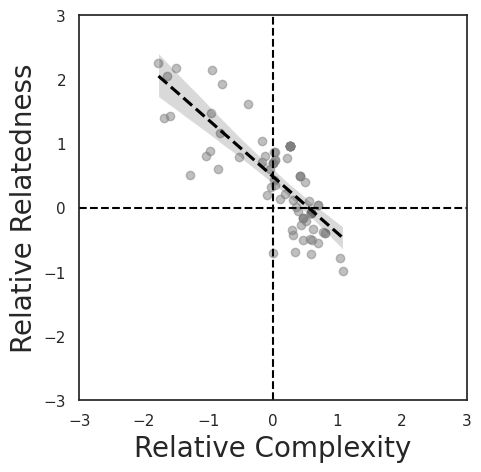

In [ ]:
# Amount of unrelated diversification
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot(111)

temp_country = 'KOR'

year = 1962
temp_df = Opportunity[year]*binary_rca[year+2]
#temp_df = binary_rca[year+2]
temp_diversified_list = temp_df.loc[temp_country][temp_df.loc[temp_country]==1].index
#temp_diversified_list = temp_df.columns
temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

temp_result_list = []

for item in temp_diversified_list:
  temp_list = []
  temp_list.append(item)
  temp_list.append(year)
  temp_list.append(temp_xs[item])
  temp_list.append(temp_ys[item])
  temp_result_list.append(temp_list)

temp_plot_df = pd.DataFrame(temp_result_list,columns = ['product','year','Relative Relatedness','Relative pci'])

#sns.scatterplot(data=temp_plot_df, y='Relative Relatedness', x='Relative pci', ax=ax, color = 'grey', alpha = 0.5)
sns.regplot(data=temp_plot_df, y='Relative Relatedness', x='Relative pci', ax=ax, color = 'black',scatter_kws={'alpha':0.5,'color':'grey'}, line_kws={'color':'black', 'linestyle':'--'})
ax.axhline(y=0, color='black', linestyle='--')
ax.axvline(x=0, color='black', linestyle='--')
ax.set_xlim(-3,3)
ax.set_ylim(-3,3)

ax.set_xlabel('Relative Complexity',fontsize=20)
ax.set_ylabel('Relative Relatedness',fontsize=20)

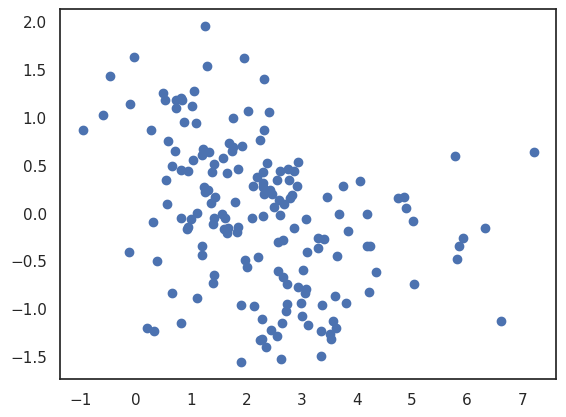

In [ ]:
# Amount of unrelated diversification

temp_country = 'KOR'

year = 1994
#temp_df = (Opportunity[year]+Opportunity[year+1]==2).astype(int)*binary_rca[year+2]
temp_df = binary_rca[year+2]
temp_diversified_list = temp_df.loc[temp_country][temp_df.loc[temp_country]==1].index
#temp_diversified_list = temp_df.columns
temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

plt.scatter(temp_xs,temp_ys)

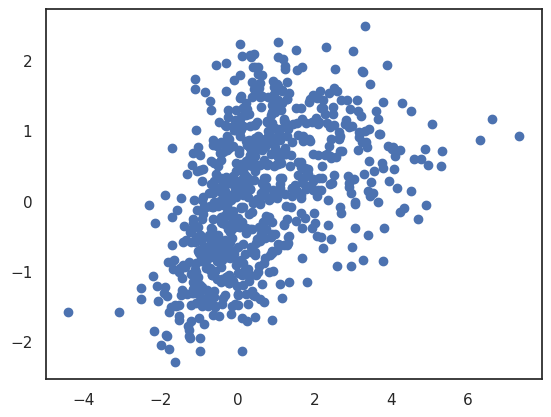

In [ ]:
# Amount of unrelated diversification

temp_country = 'KOR'

year = 2005
temp_df = Opportunity[year]*binary_rca[year+2]
temp_df = binary_rca[year+2]
temp_diversified_list = temp_df.loc[temp_country][temp_df.loc[temp_country]==1].index
temp_diversified_list = temp_df.columns
temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

plt.scatter(temp_xs,temp_ys)

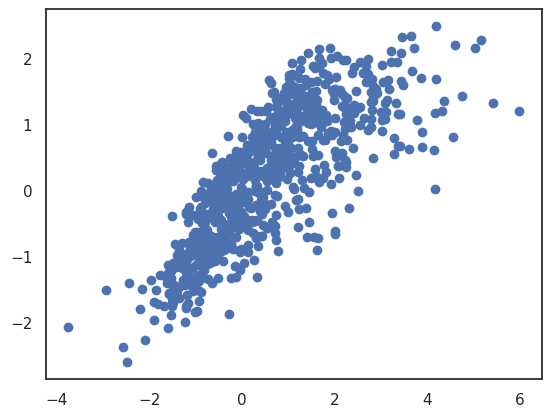

In [ ]:
# Amount of unrelated diversification

temp_country = 'KOR'

year = 2015
temp_df = Opportunity[year]*binary_rca[year+2]
temp_df = binary_rca[year+2]
temp_diversified_list = temp_df.loc[temp_country][temp_df.loc[temp_country]==1].index
temp_diversified_list = temp_df.columns
temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

plt.scatter(temp_xs,temp_ys)

In [ ]:
Diversified_product_df.head()

,country,product,year,Relative Relatedness,Relative pci,eci,Country Type,Product Type
0,AGO,0721,1962,5.524756,-2.685975,-0.866697,Simple,Related Simple
1,AGO,2235,1962,5.111803,-2.781957,-0.866697,Simple,Related Simple
2,AGO,2517,1962,0.712597,-0.477500,-0.866697,Simple,Related Simple
3,ALB,0341,1962,1.230892,-1.094691,-0.809401,Simple,Related Simple
4,ALB,0342,1962,1.230892,-1.094691,-0.809401,Simple,Related Simple


In [ ]:
Diversified_product_df['Product Type'].unique()

array(['Related Simple', 'Unrelated Simple', 'Unrelated Complex',
       'Related Complex'], dtype=object)

In [ ]:
eci[year][country]

0.5022729461905054

In [ ]:
temp_Diversified_product_df = Diversified_product_df.copy()
#temp_Diversified_product_df = temp_Diversified_product_df[temp_Diversified_product_df['Country Type']=='Simple']

temp_result_list = []

for country in temp_Diversified_product_df['country'].unique():
  for year in temp_Diversified_product_df[temp_Diversified_product_df['country']==country]['year'].unique():
    temp_df = temp_Diversified_product_df[(temp_Diversified_product_df['country']==country) & (temp_Diversified_product_df['year']==year)]
    temp_df.value_counts(normalize = True)
    for key in list(Diversified_product_df['Product Type'].unique()):
      try:
        temp_list = []
        temp_list.append(country)
        temp_list.append(year)
        temp_list.append(key)
        temp_list.append(temp_df['Product Type'].value_counts(normalize = True)[key])
        temp_list.append(temp_df['Product Type'].value_counts()[key])
        temp_list.append(eci[year][country])

        temp_result_list.append(temp_list)
      except:
        temp_list = []
        temp_list.append(country)
        temp_list.append(year)
        temp_list.append(key)
        temp_list.append(0)
        temp_list.append(0)
        temp_list.append(eci[year][country])
        temp_result_list.append(temp_list)

In [ ]:
temp_result_list[0]

['AGO', 1962, 'Related Simple', 1.0, 3, -0.8666969042882043]

In [ ]:
temp_result_list[100]

['AGO', 1989, 'Related Simple', 1.0, 3, -1.7178898530221933]

In [ ]:
temp_prob_df = pd.DataFrame(temp_result_list)
temp_prob_df.columns = ['country','year','Diversification_Type','Proportion','Count','eci']
temp_prob_df.head()

,country,year,Diversification_Type,Proportion,Count,eci
0,AGO,1962,Related Simple,1.000000,3,-0.866697
1,AGO,1962,Unrelated Simple,0.000000,0,-0.866697
2,AGO,1962,Unrelated Complex,0.000000,0,-0.866697
3,AGO,1962,Related Complex,0.000000,0,-0.866697
4,AGO,1963,Related Simple,0.909091,10,-1.407475


In [ ]:
temp_prob_df['Country_Type'] = temp_prob_df['eci'].apply(lambda x: 'Complex' if x>=0 else 'Simple')
temp_prob_df.head()

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type
0,AGO,1962,Related Simple,1.000000,3,-0.866697,Simple
1,AGO,1962,Unrelated Simple,0.000000,0,-0.866697,Simple
2,AGO,1962,Unrelated Complex,0.000000,0,-0.866697,Simple
3,AGO,1962,Related Complex,0.000000,0,-0.866697,Simple
4,AGO,1963,Related Simple,0.909091,10,-1.407475,Simple


In [ ]:
temp_prob_df['Country_Type'].unique()

array(['Simple', 'Complex'], dtype=object)

In [ ]:
temp_prob_df['year'].unique()

array([1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972,
       1973, 1975, 1976, 1977, 1978, 1980, 1981, 1982, 1983, 1984, 1985,
       1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1995, 1996, 1997,
       1998, 1999, 2000, 2001, 2002, 2004, 2005, 2006, 2007, 2008, 2009,
       2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 1974, 1979, 1994,
       2003, 2018])

In [ ]:
np.sum(Export_Similarity[1962].loc['VNM'])

16.75703895322398

In [ ]:
temp_prob_df2 = temp_prob_df[temp_prob_df['Country_Type']=='Simple']
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Diversification_Type']=='Unrelated Complex']
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Count']!=0]
temp_prob_df2[temp_prob_df2['country']=='VNM'].sort_values(by='year').head()

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type
21058,VNM,1963,Unrelated Complex,0.120000,3,-0.702315,Simple
21062,VNM,1964,Unrelated Complex,0.384615,10,-0.639607,Simple
21066,VNM,1965,Unrelated Complex,0.200000,3,-0.469401,Simple
21070,VNM,1966,Unrelated Complex,0.600000,12,-0.145521,Simple
21074,VNM,1967,Unrelated Complex,0.263158,5,-0.402323,Simple


In [ ]:
temp_prob_df2.sort_values(by='Count',ascending = False).head(10)

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type
22406,ZWE,1965,Unrelated Complex,0.508621,59,-0.784911,Simple
2094,BRA,1977,Unrelated Complex,0.535211,38,-0.123737,Simple
17194,PRK,2016,Unrelated Complex,0.493333,37,-0.352462,Simple
24242,KGZ,1994,Unrelated Complex,0.276423,34,-0.184973,Simple
17198,PRK,2017,Unrelated Complex,0.478873,34,-0.210316,Simple
7842,GRC,1996,Unrelated Complex,0.296296,32,-0.227479,Simple
22010,YEM,1978,Unrelated Complex,0.418919,31,-0.570592,Simple
11902,LBN,1996,Unrelated Complex,0.333333,31,-0.074563,Simple
22450,ZWE,1976,Unrelated Complex,0.596154,31,-0.885543,Simple
18878,SLV,1985,Unrelated Complex,0.424242,28,-1.041778,Simple


In [ ]:
temp_prob_df2[temp_prob_df2['Count']>=10].sort_values(by='Proportion', ascending = False).head(10)

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type
4322,CUB,1965,Unrelated Complex,0.833333,15,-0.381012,Simple
21070,VNM,1966,Unrelated Complex,0.600000,12,-0.145521,Simple
22450,ZWE,1976,Unrelated Complex,0.596154,31,-0.885543,Simple
7726,GRC,1967,Unrelated Complex,0.571429,12,-0.182445,Simple
9158,IND,1983,Unrelated Complex,0.560000,14,-0.170209,Simple
16550,PNG,1969,Unrelated Complex,0.551724,16,-1.269993,Simple
23382,NAM,2011,Unrelated Complex,0.541667,13,-0.505515,Simple
4502,CUB,2010,Unrelated Complex,0.541667,13,-0.584216,Simple
2094,BRA,1977,Unrelated Complex,0.535211,38,-0.123737,Simple
4474,CUB,2003,Unrelated Complex,0.523810,11,-0.626900,Simple


In [ ]:
for year in range(1980,2016):
  print(year, Export_Similarity[year].loc['VNM'].sort_values(ascending = False).head(10))

1980 location_code
VNM    1.000000
CHN    0.350643
IND    0.319396
THA    0.309525
MAR    0.308837
LKA    0.308277
PRK    0.292203
TUR    0.281691
MDG    0.277208
PHL    0.275953
Name: VNM, dtype: float64
1981 location_code
VNM    1.000000
CHN    0.361202
THA    0.358828
IND    0.322484
MDG    0.318844
LKA    0.308304
ALB    0.283319
KEN    0.283311
MAR    0.279595
TUR    0.279460
Name: VNM, dtype: float64
1982 location_code
VNM    1.000000
CHN    0.334018
THA    0.321209
MMR    0.301844
LKA    0.286624
MDG    0.286299
MOZ    0.277449
SDN    0.277413
IDN    0.271342
IND    0.265139
Name: VNM, dtype: float64
1983 location_code
VNM    1.000000
THA    0.434463
LKA    0.397523
MMR    0.397276
CHN    0.366694
MDG    0.366667
IND    0.353683
SDN    0.333912
SEN    0.323498
ARG    0.309422
Name: VNM, dtype: float64
1984 location_code
VNM    1.000000
CHN    0.390418
LKA    0.385758
THA    0.358554
SDN    0.354044
MDG    0.336788
KEN    0.336332
IND    0.304886
MMR    0.303046
ETH    0.294018
N

In [ ]:
temp_list = []
for i in tqdm(range(len(temp_prob_df))):
  temp_year = temp_prob_df.iloc[i]['year']
  temp_country = temp_prob_df.iloc[i]['country']
  temp_list.append(np.sum(Export_Similarity[temp_year].loc[temp_country]))

temp_prob_df['Export Similarity'] = temp_list

100%|██████████| 25552/25552 [00:03<00:00, 6994.01it/s]


In [ ]:
for year in range(1980,2016):
  print(year, Export_Similarity[year].loc['CHN'].sort_values(ascending = False).head(10))

1980 location_code
CHN    1.000000
HKG    0.516051
IND    0.487646
HUN    0.478734
KOR    0.475297
THA    0.470792
TUR    0.451887
ESP    0.422269
PAK    0.415783
ITA    0.406978
Name: CHN, dtype: float64
1981 location_code
CHN    1.000000
HKG    0.517392
IND    0.472593
HUN    0.468992
TUR    0.464398
KOR    0.461558
THA    0.461483
PRT    0.445146
PRK    0.441952
ITA    0.440691
Name: CHN, dtype: float64
1982 location_code
CHN    1.000000
HKG    0.518310
TUR    0.481079
IND    0.473368
THA    0.468237
KOR    0.465962
PRT    0.426934
HUN    0.424567
ITA    0.416478
SLV    0.412401
Name: CHN, dtype: float64
1983 location_code
CHN    1.000000
HKG    0.555067
IND    0.509903
THA    0.483798
TUR    0.467750
KOR    0.442227
LKA    0.441771
PRT    0.436497
HUN    0.433117
PHL    0.412964
Name: CHN, dtype: float64
1984 location_code
CHN    1.000000
HKG    0.538918
THA    0.514871
IND    0.467380
TUR    0.465312
KOR    0.444192
LKA    0.432331
PRT    0.430982
HUN    0.426860
PAK    0.410115
N

In [ ]:
temp_prob_df.head()

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type,Export Similarity
0,AGO,1962,Related Simple,1.000000,3,-0.866697,Simple,17.742151
1,AGO,1962,Unrelated Simple,0.000000,0,-0.866697,Simple,17.742151
2,AGO,1962,Unrelated Complex,0.000000,0,-0.866697,Simple,17.742151
3,AGO,1962,Related Complex,0.000000,0,-0.866697,Simple,17.742151
4,AGO,1963,Related Simple,0.909091,10,-1.407475,Simple,18.690701


<Axes: xlabel='eci', ylabel='Export Similarity'>

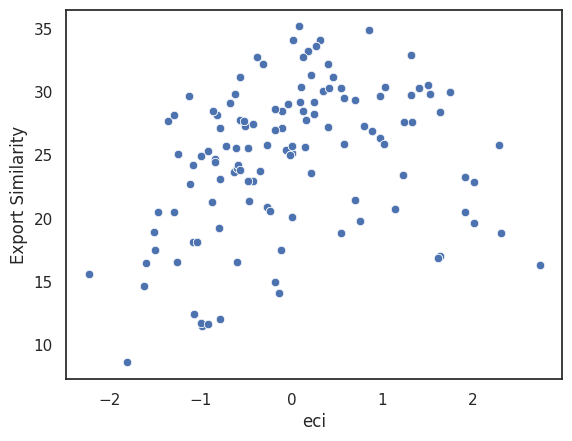

In [ ]:
temp_prob_df2 = temp_prob_df.copy()
temp_prob_df2 = temp_prob_df2[temp_prob_df2['year']==2000]
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Count']!=0]
sns.scatterplot(data = temp_prob_df2, x = 'eci', y = 'Export Similarity')

<Axes: xlabel='eci', ylabel='Export Similarity'>

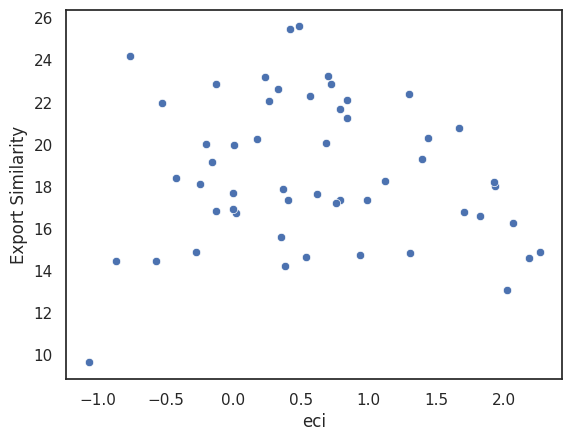

In [ ]:
temp_prob_df2 = temp_prob_df[temp_prob_df['Diversification_Type']=='Related Complex']
temp_prob_df2 = temp_prob_df2[temp_prob_df2['year']==1970]
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Count']!=0]
sns.scatterplot(data = temp_prob_df2, x = 'eci', y = 'Export Similarity')

<Axes: xlabel='eci', ylabel='Export Similarity'>

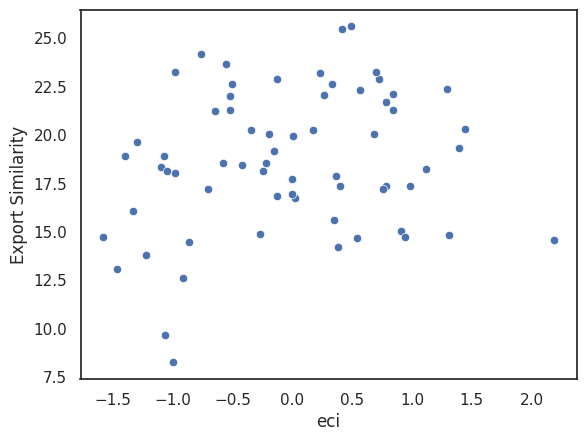

In [ ]:
temp_prob_df2 = temp_prob_df[temp_prob_df['Diversification_Type']=='Unrelated Complex']
temp_prob_df2 = temp_prob_df2[temp_prob_df2['year']==1970]
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Count']!=0]
sns.scatterplot(data = temp_prob_df2, x = 'eci', y = 'Export Similarity')

In [ ]:
temp_prob_df2 = temp_prob_df[temp_prob_df['Diversification_Type']=='Unrelated Complex']
temp_prob_df2 = temp_prob_df2[temp_prob_df2['Count']!=0]
temp_prob_df2

,country,year,Diversification_Type,Proportion,Count,eci,Country_Type,Export Similarity
22,AGO,1967,Unrelated Complex,0.125000,2,-1.316934,Simple,20.034301
26,AGO,1968,Unrelated Complex,0.050000,1,-1.385132,Simple,18.428977
34,AGO,1970,Unrelated Complex,0.235294,4,-1.401312,Simple,18.886419
38,AGO,1971,Unrelated Complex,0.300000,6,-1.438635,Simple,20.588197
54,AGO,1976,Unrelated Complex,0.125000,1,-1.744733,Simple,9.736575
...,...,...,...,...,...,...,...,...
25534,SRB,2014,Unrelated Complex,0.235294,8,0.512774,Complex,33.238277
25538,SRB,2015,Unrelated Complex,0.181818,6,0.502273,Complex,33.460267
25542,SRB,2016,Unrelated Complex,0.166667,4,0.533958,Complex,33.255962
25546,SRB,2017,Unrelated Complex,0.281250,9,0.566651,Complex,34.114070


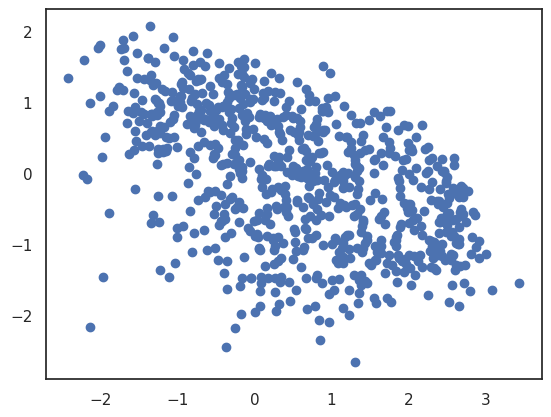

In [ ]:
temp_xs = Relative_relatedness_density[year].loc[temp_country].loc[temp_diversified_list]
temp_ys = Relative_pci[year].loc[temp_country].loc[temp_diversified_list]

plt.scatter(temp_xs,temp_ys)

0.1015071157145432


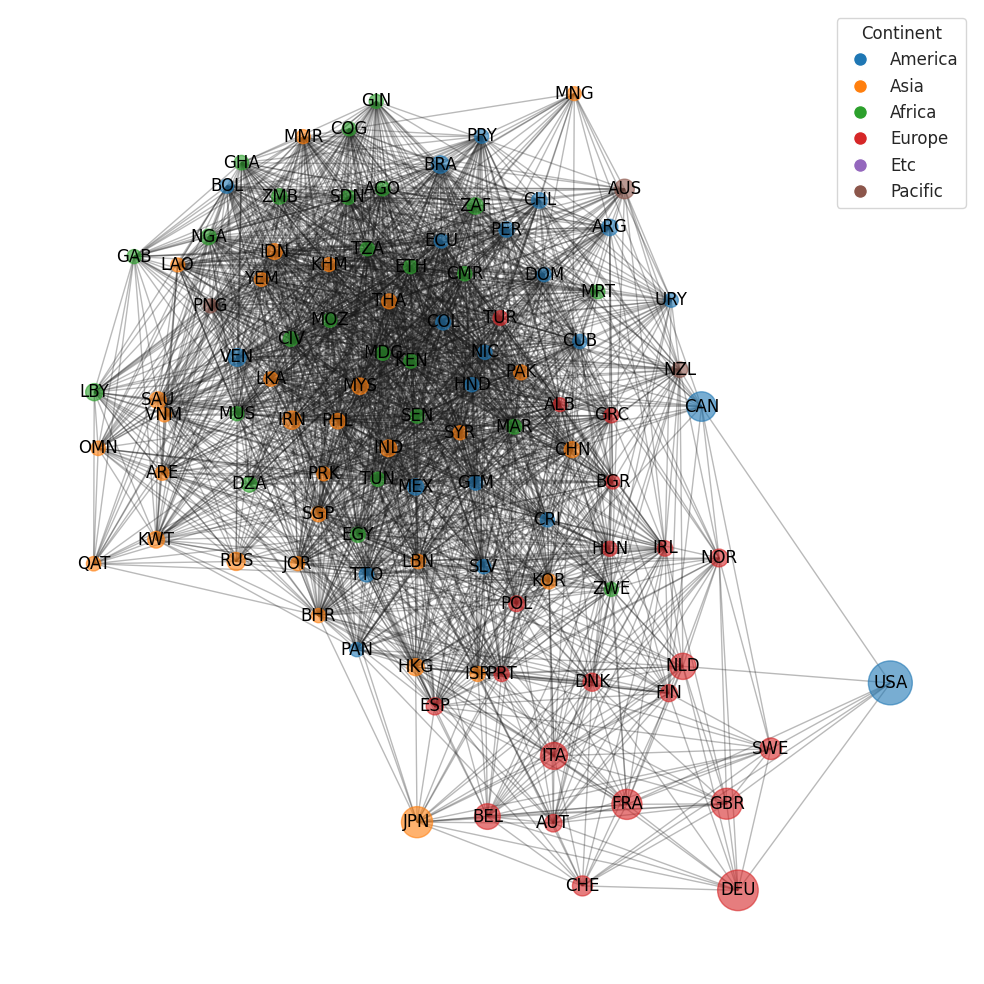

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 1970

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_4[year].copy()
temp_threshold = np.mean(temp_adj)
print(temp_threshold)
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_4[year].index, columns=Export_Similarity_4[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
    for j in range(i + 1, len(temp_adj.columns)):
        if temp_adj.iloc[i, j] == 1:
            G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value
    sizes.append(export_value)

# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_1970.graphml")
nx.write_gexf(G, "graph_gephi_1970.gexf")


In [ ]:
geo_df2['iso3']

,iso3
iso3,
ABW,ABW
AFG,AFG
AGO,AGO
AIA,AIA
ALB,ALB
...,...
YUG,YUG
ZAF,ZAF
ZAR,ZAR


0.09444602211806136


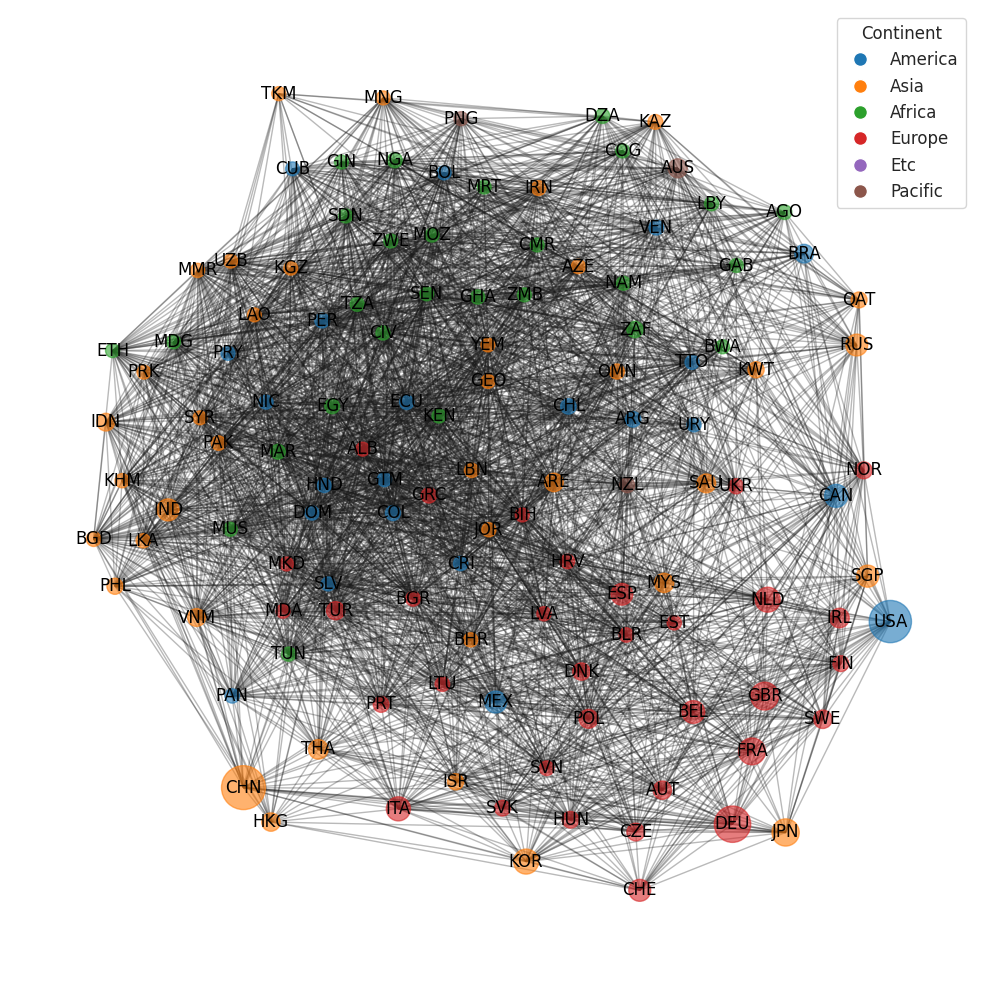

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 2015

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_4[year].copy()
temp_threshold = np.mean(temp_adj)
print(temp_threshold)
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_4[year].index, columns=Export_Similarity_4[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
  if temp_adj.index[i] in geo_df2['iso3'].unique():
    for j in range(i + 1, len(temp_adj.columns)):
      if temp_adj.columns[j] in geo_df2['iso3'].unique():
        if temp_adj.iloc[i, j] == 1:
          G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value
    sizes.append(export_value)

# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_2015.graphml")
nx.write_gexf(G, "graph_gephi_2015.gexf")

1.0151534859521332


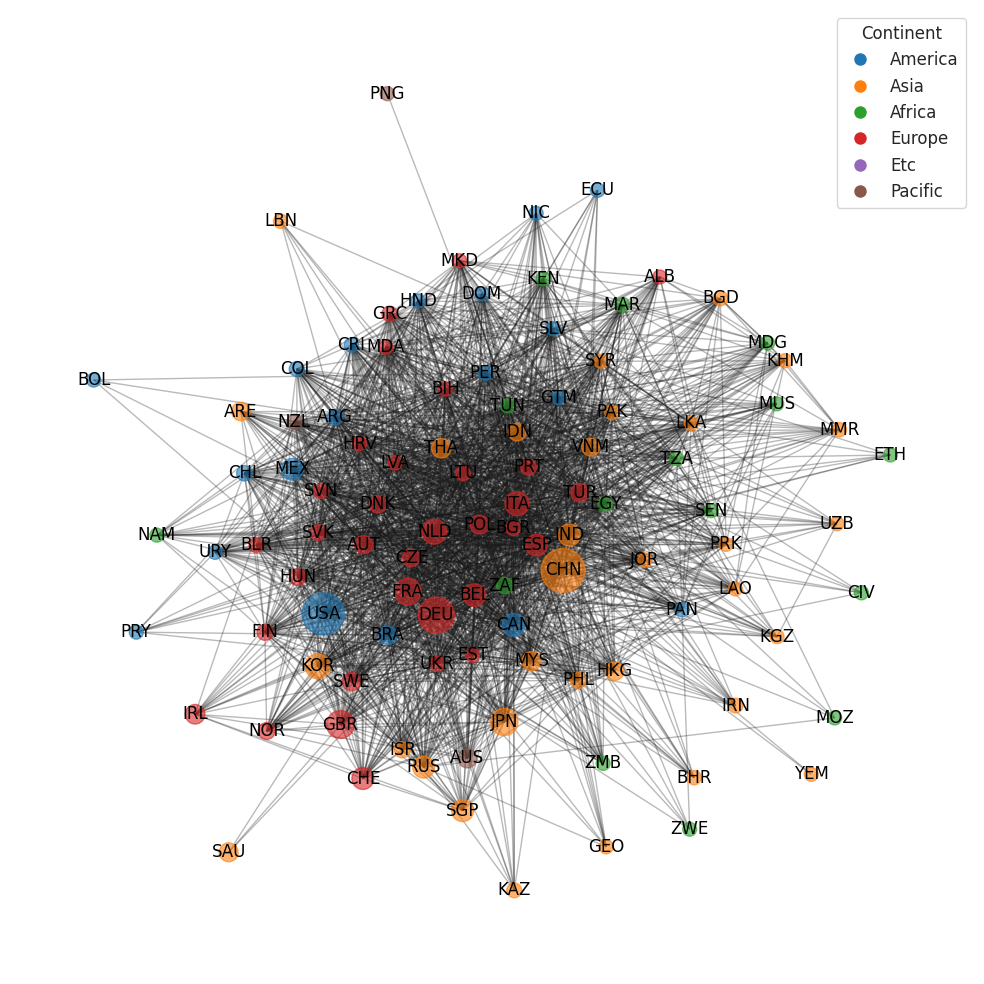

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 2015

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_3[year].copy()
temp_threshold = np.mean(temp_adj)
print(temp_threshold)
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_3[year].index, columns=Export_Similarity_3[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
  if temp_adj.index[i] in geo_df2['iso3'].unique():
    for j in range(i + 1, len(temp_adj.columns)):
      if temp_adj.columns[j] in geo_df2['iso3'].unique():
        if temp_adj.iloc[i, j] == 1:
          G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value
    sizes.append(export_value)

# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_2015_Mealy.graphml")
nx.write_gexf(G, "graph_gephi_2015_Mealy.gexf")


0.6676638917793963


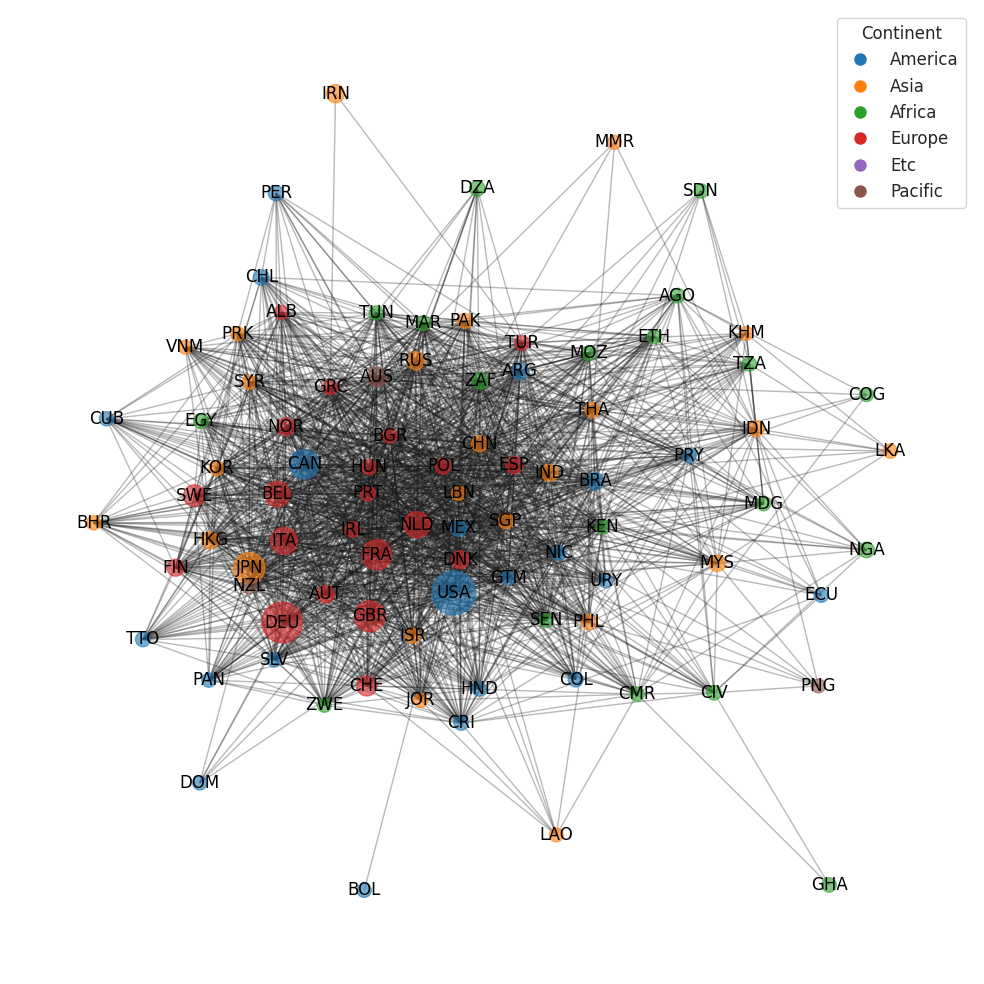

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import networkx as nx
from sklearn.preprocessing import MinMaxScaler

# Threshold and year setup
temp_threshold = 0.2
year = 1970

# Continent color mapping
continent_color_dict = dict(zip(geo_df2['continent'].unique(), sns.color_palette('tab10', len(geo_df2['continent'].unique()))))

# Adjacency matrix preparation
temp_adj = Export_Similarity_3[year].copy()

# Threshold and year setup
temp_threshold = np.mean(temp_adj)
print(temp_threshold)
temp_adj[temp_adj < temp_threshold] = 0
temp_adj[temp_adj >= temp_threshold] = 1
temp_adj = pd.DataFrame(temp_adj, index=Export_Similarity_3[year].index, columns=Export_Similarity_3[year].columns)

# Create graph
G = nx.Graph()
for i in range(len(temp_adj.index)):
  if temp_adj.index[i] in geo_df2['iso3'].unique():
    for j in range(i + 1, len(temp_adj.columns)):
      if temp_adj.columns[j] in geo_df2['iso3'].unique():
        if temp_adj.iloc[i, j] == 1:
          G.add_edge(temp_adj.index[i], temp_adj.columns[j])

# Assign attributes to nodes
sizes = []
for node in G.nodes:
    export_value = np.sum(product_df[(product_df['year'] == year) & (product_df['location_code'] == node)]['export_value'])
    G.nodes[node]['color'] = continent_color_dict[geo_df2.loc[node, 'continent']]
    G.nodes[node]['size'] = export_value
    sizes.append(export_value)

# Min-max scaling for node sizes
scaler = MinMaxScaler(feature_range=(100, 1000))  # Scale sizes to range 100–1000
scaled_sizes = scaler.fit_transform(np.array(sizes).reshape(-1, 1)).flatten()

# Update scaled sizes back to nodes
for idx, node in enumerate(G.nodes):
    G.nodes[node]['scaled_size'] = scaled_sizes[idx]

# Get node attributes for drawing
node_colors = [G.nodes[node]['color'] for node in G.nodes]
node_sizes = [G.nodes[node]['scaled_size'] for node in G.nodes]

# Get node positions
pos = nx.kamada_kawai_layout(G)

fig = plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.6)

# Draw edges
nx.draw_networkx_edges(G, pos, alpha=0.3)

# Draw labels (optional)
nx.draw_networkx_labels(G, pos, font_size=12, font_color="black")

# Legend for continents
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10)
           for color in continent_color_dict.values()]
plt.legend(handles, continent_color_dict.keys(), loc='best', title="Continent", fontsize=12)

plt.axis('off')
plt.tight_layout()
plt.show()

# Prepare attributes to be Gephi-compatible
for node in G.nodes:
    # Convert color (tuple) to a string
    G.nodes[node]['color'] = str(G.nodes[node]['color'])

    # Ensure size is a numeric type (already expected to be)
    G.nodes[node]['size'] = float(G.nodes[node]['size'])

# Export to GraphML (or GEXF)
nx.write_graphml(G, "graph_gephi_1970_Mealy.graphml")
nx.write_gexf(G, "graph_gephi_1970_Mealy.gexf")


In [ ]:
#graph = temp_G_bahar
#temp_dict = dict(graph.degree())

In [ ]:
#edge_list

In [ ]:
similarity_matrix = Export_Similarity_3[1970].copy()

G_Mealy_1970 = nx.Graph()
for i, row in similarity_matrix.iterrows():
    for j, value in row.items():
        if not pd.isna(value):  # Check for NaN
            G_Mealy_1970.add_edge(i, j, weight=value)

similarity_matrix = Export_Similarity_3[2015].copy()
G_Mealy_2015 = nx.Graph()
for i, row in similarity_matrix.iterrows():
    for j, value in row.items():
        if not pd.isna(value):  # Check for NaN
            G_Mealy_2015.add_edge(i, j, weight=value)


similarity_matrix = Export_Similarity_4[1970].copy()
G_Bahar_1970 = nx.Graph()
for i, row in similarity_matrix.iterrows():
    for j, value in row.items():
        if not pd.isna(value):  # Check for NaN
            G_Bahar_1970.add_edge(i, j, weight=value)

similarity_matrix = Export_Similarity_4[2015].copy()
G_Bahar_2015 = nx.Graph()
for i, row in similarity_matrix.iterrows():
    for j, value in row.items():
        if not pd.isna(value):  # Check for NaN
            G_Bahar_2015.add_edge(i, j, weight=value)

In [ ]:
# Load the graphs
graphs = {
    "1970 Bahar": nx.read_gexf("graph_gephi_1970.gexf"),
    "1970 Mealy": nx.read_gexf("graph_gephi_1970_Mealy.gexf"),
    "2015 Bahar": nx.read_gexf("graph_gephi_2015.gexf"),
    "2015 Mealy": nx.read_gexf("graph_gephi_2015_Mealy.gexf")
}

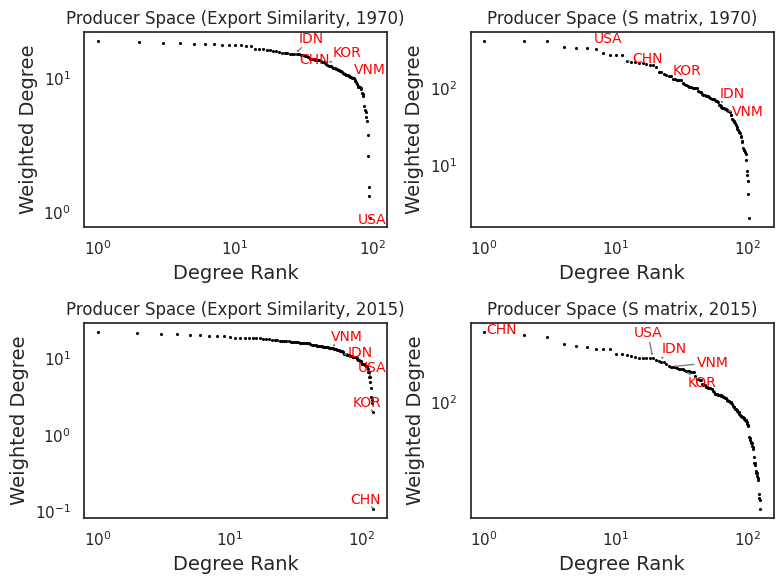

In [ ]:
import networkx as nx
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from adjustText import adjust_text

# Load the graphs
graphs = {
    "1970 Bahar": G_Bahar_1970,
    "1970 Mealy": G_Mealy_1970,
    "2015 Bahar": G_Bahar_2015,
    "2015 Mealy": G_Mealy_2015
}

# Create a function to prepare weighted degree data and plot
def plot_weighted_degree_distribution(graph, ax, title, highlight_nodes=None):
    graph = graph.copy()
    temp_dict = dict(graph.degree(weight='weight'))  # Weighted degree
    degree_df = pd.DataFrame({'node': temp_dict.keys(), 'degree': temp_dict.values()})
    degrees = degree_df['degree']
    sorted_degrees = sorted(degrees, reverse=True)
    ranks = np.arange(1, len(sorted_degrees) + 1)

    # Scatter plot
    ax.scatter(ranks, sorted_degrees, color='black', s=1.5)  # s specifies marker size

    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel("Degree Rank", fontsize=14)
    ax.set_ylabel("Weighted Degree", fontsize=14)
    ax.set_title(title)
    ax.grid(False)

    # Annotate specific nodes
    if highlight_nodes:
        texts = []
        for node in highlight_nodes:
            if node in temp_dict:
                rank = sorted_degrees.index(temp_dict[node]) + 1
                degree = temp_dict[node]
                # Add text to be adjusted
                texts.append(ax.text(rank, degree, node, fontsize=10, color='red'))

        # Adjust text positions to avoid overlap
        adjust_text(texts, ax=ax, arrowprops=dict(arrowstyle="->",
                                                  color='grey'),
                                                  #expand_points=(1.2, 1.4),
                                                  #expand_text=(1.1, 1.3),
                                                  #force_text=0.8,
                                                  #force_points=0.8,
                                                  #only_move={'points': 'y', 'texts': 'x'})
        )

# Highlighted nodes
highlight_nodes = ["CHN", "USA", "KOR", "VNM", "IDN"]
#highlight_nodes = []
# Create a 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(8, 6))

# Plot for each graph
plot_weighted_degree_distribution(graphs["1970 Bahar"], axes[0, 0], "Producer Space (Export Similarity, 1970)", highlight_nodes)
plot_weighted_degree_distribution(graphs["1970 Mealy"], axes[0, 1], "Producer Space (S matrix, 1970)", highlight_nodes)
plot_weighted_degree_distribution(graphs["2015 Bahar"], axes[1, 0], "Producer Space (Export Similarity, 2015)", highlight_nodes)
plot_weighted_degree_distribution(graphs["2015 Mealy"], axes[1, 1], "Producer Space (S matrix, 2015)", highlight_nodes)

# Adjust layout and show
plt.tight_layout()
plt.show()


## Visualization

In [ ]:
Export_Similarity_4[1962]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,1.000000,0.064499,NaN,0.206238,0.102305,-0.241157,NaN,-0.167240,NaN,0.117187,...,NaN,0.055595,-0.161192,NaN,0.137125,0.272112,0.220108,0.264354,NaN,NaN
ALB,0.064499,1.000000,NaN,0.130581,0.090487,-0.067724,NaN,-0.108433,NaN,0.050362,...,NaN,0.083746,-0.023828,NaN,0.214215,0.109852,0.161985,0.132688,NaN,NaN
ARE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ARG,0.206238,0.130581,NaN,1.000000,0.521953,-0.246126,NaN,-0.161359,NaN,0.234219,...,NaN,0.500038,-0.069263,NaN,0.005729,0.198628,0.165793,0.397989,NaN,NaN
AUS,0.102305,0.090487,NaN,0.521953,1.000000,-0.105781,NaN,-0.062169,NaN,0.145122,...,NaN,0.366990,-0.056657,NaN,0.002028,0.118797,0.134082,0.468470,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.272112,0.109852,NaN,0.198628,0.118797,-0.128399,NaN,-0.043491,NaN,0.254603,...,NaN,0.101492,-0.133997,NaN,0.019111,1.000000,0.067063,0.152519,NaN,NaN
YEM,0.220108,0.161985,NaN,0.165793,0.134082,-0.067781,NaN,-0.130638,NaN,0.010240,...,NaN,0.144469,-0.039328,NaN,0.006224,0.067063,1.000000,0.100417,NaN,NaN
ZAF,0.264354,0.132688,NaN,0.397989,0.468470,-0.161311,NaN,-0.068454,NaN,0.260606,...,NaN,0.230480,-0.162467,NaN,0.117239,0.152519,0.100417,1.000000,NaN,NaN


In [ ]:
sorted(Export_Similarity.keys())

[1962,
 1963,
 1964,
 1965,
 1966,
 1967,
 1968,
 1969,
 1970,
 1971,
 1972,
 1973,
 1974,
 1975,
 1976,
 1977,
 1978,
 1979,
 1980,
 1981,
 1982,
 1983,
 1984,
 1985,
 1986,
 1987,
 1988,
 1989,
 1990,
 1991,
 1992,
 1993,
 1994,
 1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018,
 2019,
 2020]

In [ ]:
Export_Similarity[year].loc[np.sum(Export_Similarity[year], axis = 0)==1].index

Index(['AZE', 'BGD', 'BIH', 'BLR', 'BWA', 'CZE', 'EST', 'GEO', 'HRV', 'KAZ',
       'KGZ', 'LTU', 'LVA', 'MDA', 'MKD', 'NAM', 'SRB', 'SVK', 'SVN', 'TKM',
       'UKR', 'UZB'],
      dtype='object', name='location_code')

In [ ]:
year = 1962

temp_null_countries = list(Export_Similarity[year].loc[np.sum(Export_Similarity[year], axis = 0)==1].index)
temp_mat = Export_Similarity[year].copy()
temp_mat.drop(temp_null_countries, axis = 0, inplace = True)
temp_mat.drop(temp_null_countries, axis = 1, inplace = True)
temp_mat = temp_mat.where(np.triu(np.ones(temp_mat.shape), k=1).astype(bool))
upper_triangle_values = temp_mat.values[np.triu_indices_from(temp_mat, k=1)]
upper_triangle_values

array([0.0919709 , 0.17087669, 0.11734293, ..., 0.04445542, 0.3003413 ,
       0.16162705])

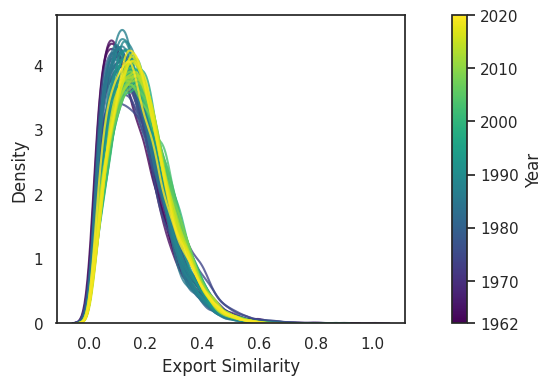

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize figure
fig, ax = plt.subplots(1, 1, figsize=(6, 4))

# Set up colormap using coolwarm
#colors = plt.cm.coolwarm(np.linspace(0, 1, end_year - start_year + 1))
colors = plt.cm.viridis(np.linspace(0, 1, end_year - start_year + 1))

# Iterate through each year and plot the KDE
for i, year in enumerate(range(start_year, end_year + 1)):
    # Identify countries with null values (sum equals 1)
    temp_null_countries = list(Export_Similarity[year].loc[np.sum(Export_Similarity[year], axis=0) == 1].index)

    # Copy and clean the matrix by dropping rows and columns for null countries
    temp_mat = Export_Similarity[year].copy()
    temp_mat.drop(temp_null_countries, axis=0, inplace=True)
    temp_mat.drop(temp_null_countries, axis=1, inplace=True)

    # Extract the upper triangle of the matrix
    temp_mat = temp_mat.where(np.triu(np.ones(temp_mat.shape), k=1).astype(bool))

    # Get the non-NaN values from the upper triangle
    upper_triangle_values = temp_mat.stack().values

    # 0 value ignore
    upper_triangle_values = upper_triangle_values[upper_triangle_values != 0]

    # Plot the KDE curve for the current year
    sns.kdeplot(upper_triangle_values, color=colors[i], alpha=0.8, bw_adjust=1)

# Add labels and a title to the plot
plt.xlabel("Export Similarity")
plt.ylabel("Density")

# Create the colormap bar below the x-axis
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=start_year, vmax=end_year))
cbar = fig.colorbar(sm, ax = ax, orientation='vertical', pad=0.1)

tick_locations = np.linspace(start_year, end_year, end_year - start_year + 1)
cbar.set_ticks([start_year] + [1970, 1980, 1990, 2000, 2010] + [end_year])  # Ensure first and last years are included
cbar.set_ticklabels([start_year] + [1970, 1980, 1990, 2000, 2010]  + [end_year])
cbar.set_label("Year")

plt.show()


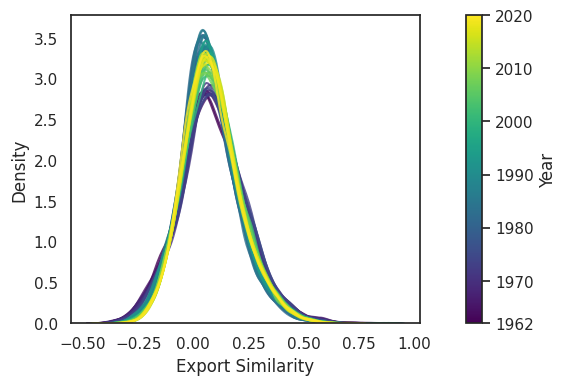

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize figure
fig, ax = plt.subplots(1, 1, figsize=(6, 4))

# Set up colormap using coolwarm
#colors = plt.cm.coolwarm(np.linspace(0, 1, end_year - start_year + 1))
colors = plt.cm.viridis(np.linspace(0, 1, end_year - start_year + 1))

# Iterate through each year and plot the KDE
for i, year in enumerate(range(start_year, end_year + 1)):
    # Identify countries with null values (sum equals 1)
    temp_null_countries = list(Export_Similarity_4[year].loc[np.sum(Export_Similarity_4[year], axis=0) == 1].index)

    # Copy and clean the matrix by dropping rows and columns for null countries
    temp_mat = Export_Similarity_4[year].copy()
    temp_mat.drop(temp_null_countries, axis=0, inplace=True)
    temp_mat.drop(temp_null_countries, axis=1, inplace=True)

    # Extract the upper triangle of the matrix
    temp_mat = temp_mat.where(np.triu(np.ones(temp_mat.shape), k=1).astype(bool))

    # Get the non-NaN values from the upper triangle
    upper_triangle_values = temp_mat.stack().values

    # 0 value ignore
    upper_triangle_values = upper_triangle_values[upper_triangle_values != 0]

    # Plot the KDE curve for the current year
    sns.kdeplot(upper_triangle_values, color=colors[i], alpha=0.8, bw_adjust=1)

# Add labels and a title to the plot
plt.xlabel("Export Similarity")
plt.ylabel("Density")

# Create the colormap bar below the x-axis
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=start_year, vmax=end_year))
cbar = fig.colorbar(sm, ax = ax, orientation='vertical', pad=0.1)

tick_locations = np.linspace(start_year, end_year, end_year - start_year + 1)
cbar.set_ticks([start_year] + [1970, 1980, 1990, 2000, 2010] + [end_year])  # Ensure first and last years are included
cbar.set_ticklabels([start_year] + [1970, 1980, 1990, 2000, 2010]  + [end_year])
cbar.set_label("Year")

plt.show()


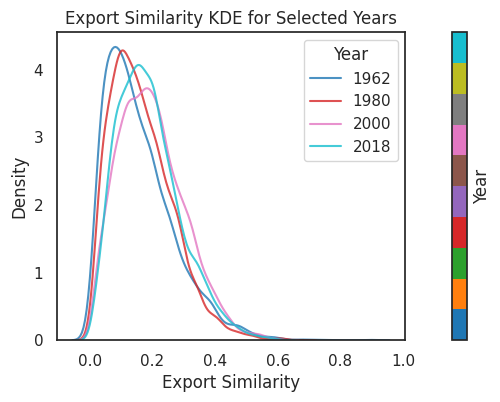

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Define specific years to plot
years_to_plot = [1962, 1980, 2000, 2018]

# Set up discrete colormap using viridis
colors = plt.cm.tab10(np.linspace(0, 1, len(years_to_plot)))

# Initialize figure
fig, ax = plt.subplots(1, 1, figsize=(6, 4))

# Iterate through the selected years and plot the KDE
for i, year in enumerate(years_to_plot):
    # Identify countries with null values (sum equals 1)
    temp_null_countries = list(Export_Similarity[year].loc[np.sum(Export_Similarity[year], axis=0) == 1].index)

    # Copy and clean the matrix by dropping rows and columns for null countries
    temp_mat = Export_Similarity[year].copy()
    temp_mat.drop(temp_null_countries, axis=0, inplace=True)
    temp_mat.drop(temp_null_countries, axis=1, inplace=True)

    # Extract the upper triangle of the matrix
    temp_mat = temp_mat.where(np.triu(np.ones(temp_mat.shape), k=1).astype(bool))

    # Get the non-NaN values from the upper triangle
    upper_triangle_values = temp_mat.stack().values

    # 0 value ignore
    upper_triangle_values = upper_triangle_values[upper_triangle_values != 0]

    # Plot the KDE curve for the current year
    sns.kdeplot(upper_triangle_values, color=colors[i], alpha=0.8, bw_adjust=1, label=str(year))
    #sns.barplot(upper_triangle_values, color=colors[i], kde=True, stats = 'density',alpha=0.8, bw_adjust=3, label=str(year))
    #sns.histplot(upper_triangle_values, kde=True, bins=100, stat='density', color = colors[i], label=str(year))

# Add labels and a title to the plot
plt.xlabel("Export Similarity")
plt.ylabel("Density")
plt.title("Export Similarity KDE for Selected Years")

# Create discrete colorbar for the selected years
sm = plt.cm.ScalarMappable(cmap='tab10', norm=plt.Normalize(vmin=min(years_to_plot), vmax=max(years_to_plot)))
sm.set_array([])  # Required for discrete colorbar
cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.1, ticks=np.linspace(0, 1, len(years_to_plot)))
cbar.set_ticklabels(years_to_plot)
cbar.set_label("Year")

# Add legend for KDE curves
plt.legend(title="Year")
plt.show()


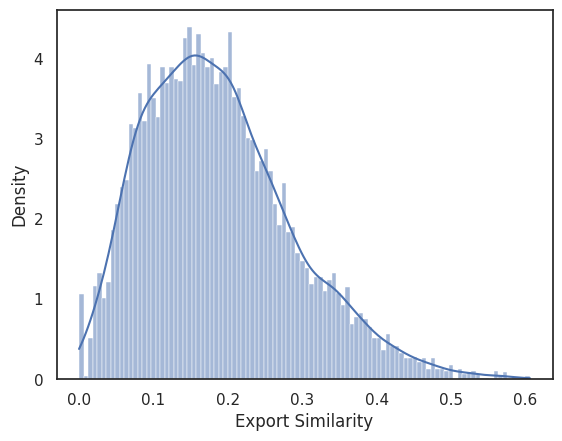

In [ ]:
import seaborn as sns
year = 2018

temp_mat = Export_Similarity[year].where(np.triu(np.ones(Export_Similarity[year].shape), k=1).astype(bool))
upper_triangle_values = temp_mat.values[np.triu_indices_from(temp_mat, k=1)]
sns.histplot(upper_triangle_values, kde=True, bins=100, stat='density')
plt.xlabel("Export Similarity")
plt.ylabel("Density")
plt.show()

/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


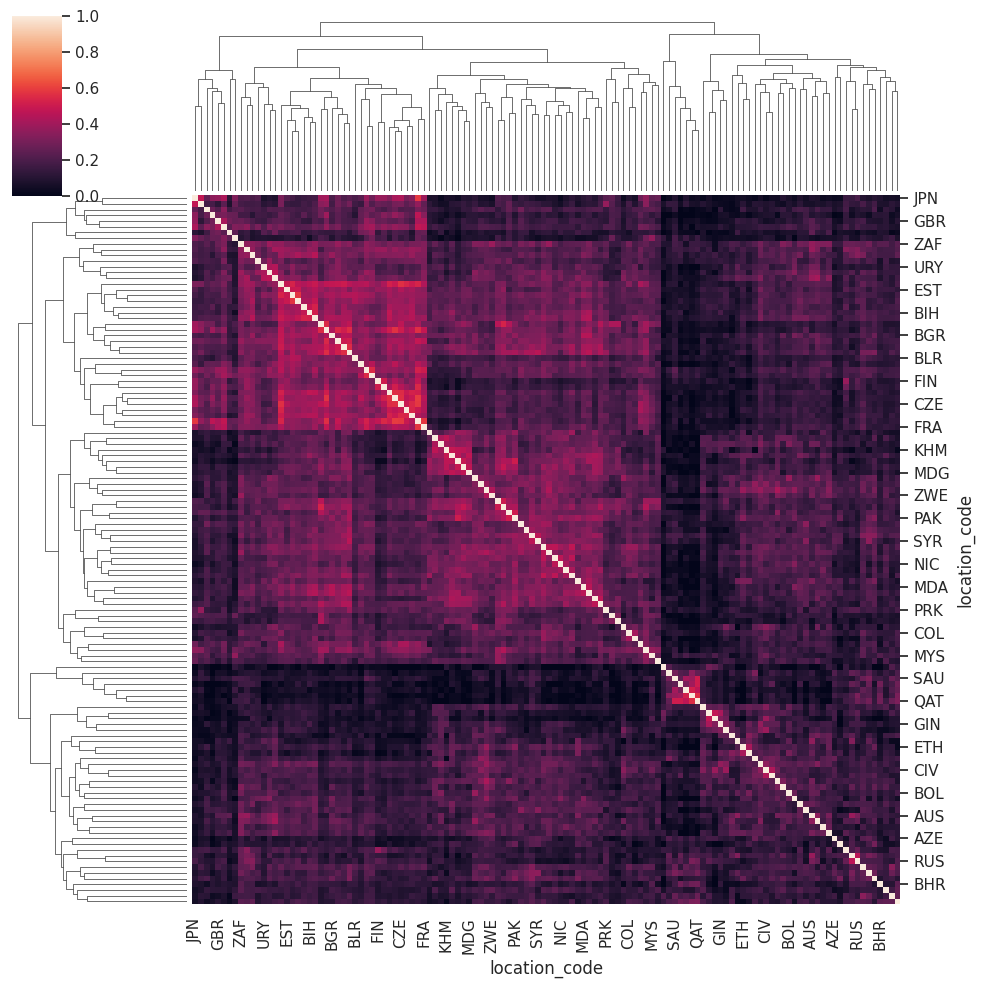

In [ ]:
import seaborn as sns
sns.clustermap(Export_Similarity[2010])

In [ ]:
input_country = 'VNM'

temp_result_list = []

for year in range(start_year, end_year + 1):
    temp_list = []
    temp_list.append(input_country)
    temp_list.append(year)
    for country in Export_Similarity_3[start_year].index:
      if country!=input_country:
        temp_list.append(list(Export_Similarity_3[year].loc[input_country].sort_values(ascending=False).index[1:]).index(country)+1)
    temp_result_list.append(temp_list)

temp_plot_df = pd.DataFrame(temp_result_list, columns=['Country', 'Year']+list([x for x in Export_Similarity_3[start_year].index if x != input_country]))
temp_plot_df

,Country,Year,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,...,TZA,UKR,URY,USA,UZB,VEN,YEM,ZAF,ZMB,ZWE
0,VNM,1962,24,82,103,29,19,38,104,5,...,96,97,48,20,91,95,86,15,98,123
1,VNM,1963,34,84,103,35,44,61,102,11,...,95,96,31,10,99,100,85,27,104,123
2,VNM,1964,67,64,105,46,23,70,104,16,...,97,98,50,6,101,102,88,11,106,123
3,VNM,1965,66,84,99,37,30,50,101,8,...,17,106,52,15,103,93,94,46,77,74
4,VNM,1966,48,72,100,38,43,4,103,12,...,15,105,68,2,102,101,82,58,92,30
5,VNM,1967,80,62,98,48,38,42,100,6,...,11,102,43,16,105,101,87,47,66,78
6,VNM,1968,59,44,24,56,9,17,100,13,...,54,107,72,1,104,103,88,40,70,21
7,VNM,1969,68,58,25,34,4,42,100,7,...,36,106,40,3,104,94,77,33,72,37
8,VNM,1970,67,56,83,52,14,63,99,18,...,32,105,70,3,102,95,48,22,65,77
9,VNM,1971,90,44,82,65,16,29,107,9,...,40,100,74,4,103,96,83,32,69,64


In [ ]:
Export_Similarity[start_year].loc[input_country].sort_values(ascending=False).index[1:]

Index(['THA', 'MOZ', 'KEN', 'ETH', 'KOR', 'BGR', 'SDN', 'ZAF', 'EGY', 'SGP',
       ...
       'KAZ', 'KGZ', 'LTU', 'LVA', 'MDA', 'MKD', 'MNG', 'MYS', 'NAM', 'ZWE'],
      dtype='object', name='location_code', length=123)

In [ ]:
temp_list1 = Export_Similarity[start_year].loc[input_country].sort_values(ascending=False).index[1:][0:5]
temp_list2 = Export_Similarity[end_year].loc[input_country].sort_values(ascending=False).index[1:][0:5]
target_countries = list(set(temp_list1).union(set(temp_list2)))

In [ ]:
from scipy.interpolate import interp1d

#plt.rc('font', family='Helvetica')
#plt.rcParams['pdf.fonttype'] = 42

xp = temp_plot_df.copy()
xp = xp[xp['Year'].isin([1965,1970,1975,1980,1985,1990,1995,2000,2005,2010,2015])]
xp = xp[['Year']+target_countries]
xp

,Year,TUN,CHN,KOR,ETH,MMR,MOZ,KEN,KHM,THA,IDN
3,1965,27,1,31,36,73,14,16,43,4,32
8,1970,29,6,46,69,35,33,27,30,13,44
13,1975,48,1,2,59,79,43,46,33,3,69
18,1980,57,1,6,65,51,40,33,73,3,29
23,1985,68,1,37,50,27,31,20,57,3,19
28,1990,66,1,43,73,8,47,31,45,2,7
33,1995,25,1,37,106,26,77,62,61,3,2
38,2000,21,1,33,101,37,66,57,60,2,3
43,2005,10,1,69,96,40,89,21,64,4,2
48,2010,10,1,56,88,61,81,36,66,3,2


In [ ]:
#!pip install adjustText

In [ ]:
from adjustText import adjust_text

In [ ]:
np.max(xp[target_countries])

106

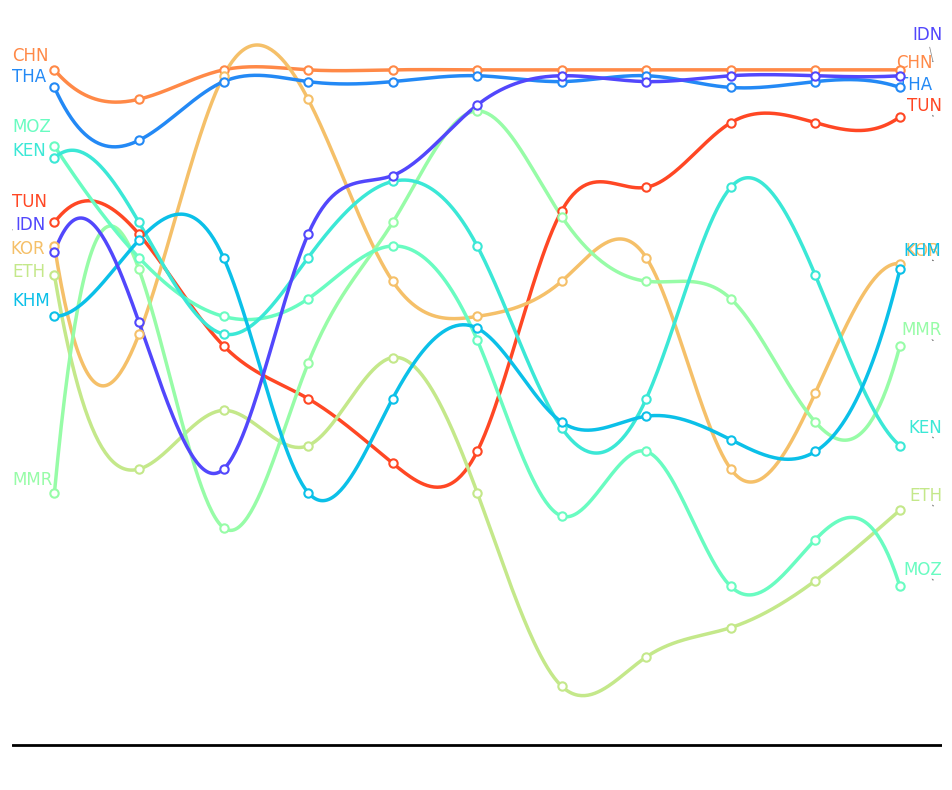

In [ ]:
from adjustText import adjust_text
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import seaborn as sns

color2 = sns.color_palette('rainbow_r', n_colors=len(target_countries))
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(1, 1, 1)

ll = xp.columns.tolist()[1:]
y_offset = 0.2
texts = []

for i in range(len(ll)):
    x = xp["Year"]
    y = -xp[ll[i]]

    # Cubic Interpolation
    cubic_interpolation_model = interp1d(x, y, kind="cubic")

    # Plotting the Graph
    X = np.linspace(x.min(), x.max(), 500)
    Y = cubic_interpolation_model(X)

    plt.plot(X, Y, "-", color=color2[i], linewidth=2.5)
    plt.plot(x, y, "o", color=color2[i],
             markersize=6, markerfacecolor="white", mew=1.5, zorder=100)

    texts.append(plt.text(1965 - 5, -xp[ll[i]].iloc[0] + i * y_offset, ll[i], color=color2[i], fontsize=12))
    texts.append(plt.text(2015 + 2, -xp[ll[i]].iloc[-1] + i * y_offset, ll[i], color=color2[i], fontsize=12))

adjust_text(texts, arrowprops=dict(arrowstyle="->", color='gray', lw=0.5))

ax.axis('off')

plt.axhline(-np.max(xp[target_countries])-10, linestyle = "-", color="black", lw=2)
ax.axis('off')


plt.show()


In [ ]:
for year in range(1985,2016):
  print(year, Export_Similarity[year].loc['VNM'].sort_values(ascending = False).head(10))

1985 location_code
VNM    1.000000
CHN    0.394438
THA    0.358027
IND    0.319398
MDG    0.318584
LKA    0.316706
PNG    0.300023
KEN    0.300023
MMR    0.299333
LAO    0.291704
Name: VNM, dtype: float64
1986 location_code
VNM    1.000000
CHN    0.410365
THA    0.390788
LKA    0.363976
MDG    0.336269
PNG    0.320970
IDN    0.310316
PAK    0.308895
CIV    0.294174
IND    0.287555
Name: VNM, dtype: float64
1987 location_code
VNM    1.000000
MMR    0.450460
THA    0.369075
CHN    0.368452
IDN    0.345307
MDG    0.340811
TZA    0.339560
LKA    0.323731
SDN    0.314391
PRK    0.286650
Name: VNM, dtype: float64
1988 location_code
VNM    1.000000
MMR    0.448090
MDG    0.404233
THA    0.385825
TZA    0.378076
CHN    0.353627
SDN    0.352180
LKA    0.348155
IDN    0.338238
PAK    0.306413
Name: VNM, dtype: float64
1989 location_code
VNM    1.000000
MMR    0.420725
THA    0.419908
KHM    0.399934
CHN    0.399220
MDG    0.396615
IDN    0.378270
LKA    0.355112
TZA    0.349648
PAK    0.337516
N

# Imitation Density

In the producer space, countries with similar export structures are close to each other. If many countries that neighbor a focal country ($c$) have specialization in a product ($p$), the focal country’s export structure may be conducive to product diversification. This concept is expressed through a formula similar to density, which we define as the imitation density ($\omega_{cp}^{\text{imi}}$) (Eq).


$$
\omega_{cp}^{\text{imi}} = \frac{\sum_{c'} (M_{c'p}) \, \phi_{cc'}^c}{\sum_{c'} \phi_{cc'}^c} \tag{Eq}
$$


In [ ]:
binary_rca[year].to_numpy().copy().shape, Export_Similarity[year].copy().shape

((124, 774), (124, 124))

In [ ]:
imitation_density = {}
for year in range(start_year, end_year+1):
    imitation_density[year] = pd.DataFrame(density_calculation(Export_Similarity[year].copy(), binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
imitation_density.keys()

dict_keys([1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020])

In [ ]:
year = 1965

temp_df = imitation_density[year]*binary_rca[year+2]
for index in temp_df.loc['THA'].sort_values(ascending = False).head(20).index:
  print(index, Relative_pci[year].loc['THA'][index], pci[year][index])

2924 -2.298638600118371 -1.9421778353952939
2119 -2.554452043510852 -2.1739998551582063
2911 -2.0828374563898744 -1.7466155680537296
2929 -2.088615293157923 -1.7518515313075234
0812 -2.3673814305114536 -2.0044736302315873
0360 -1.902168865355382 -1.582890952467063
0542 -1.974490607739197 -1.6484300115948747
0752 -2.3025274137278604 -1.9457019372309046
9410 -1.924953297277795 -1.6035385500184571
2483 -2.0818293154830183 -1.7457019754835597
2922 -2.2883026895617373 -1.9328112765876266
2225 -1.8602257653080108 -1.5448814794731767
2224 -1.8602257653080108 -1.5448814794731767
2238 -1.8602257653080108 -1.5448814794731767
2226 -1.8602257653080108 -1.5448814794731767
2879 -2.1147733161019633 -1.7755563281761864
2111 -1.9987628097038213 -1.6704258489086299
0615 -2.2449121166626242 -1.8934900817561673
1212 -2.449161686132958 -2.0785841374179412
1213 -2.449161686132958 -2.0785841374179412


In [ ]:
imitation_density_2 = {}
for year in range(start_year, end_year+1):
    imitation_density_2[year] = pd.DataFrame(density_calculation(Export_Similarity_2[year].copy(), binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
imitation_density_3 = {}
for year in range(start_year, end_year+1):
    imitation_density_3[year] = pd.DataFrame(density_calculation(Export_Similarity_3[year].copy(), binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
np.min(Export_Similarity_4[year])

-0.3573192494495067

In [ ]:
np.min(Export_Similarity_4[year]-np.min(Export_Similarity_4[year]))

0.0

In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Assuming Export_Similarity_4[year] is a pandas DataFrame for a given year
for year in range(start_year, end_year+1):
  similarity_matrix = Export_Similarity_4[year].copy()

  # MinMax scaling
  scaler = MinMaxScaler()
  scaled_matrix = pd.DataFrame(
      scaler.fit_transform(similarity_matrix),
      index=similarity_matrix.index,
      columns=similarity_matrix.columns
  )

  # Displaying the first few rows of the scaled matrix
  Export_Similarity_4[year] = scaled_matrix

In [ ]:
Export_Similarity_4[1962]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,1.000000,0.186907,NaN,0.420009,0.306937,0.010496,NaN,0.033022,NaN,0.305899,...,NaN,0.201577,0.075685,NaN,0.245436,0.414327,0.310220,0.461797,NaN,NaN
ALB,0.302912,1.000000,NaN,0.364727,0.297813,0.148764,NaN,0.081739,NaN,0.253359,...,NaN,0.225377,0.185027,NaN,0.312849,0.283769,0.258812,0.365470,NaN,NaN
ARE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ARG,0.408529,0.244342,NaN,1.000000,0.630925,0.006534,NaN,0.037893,NaN,0.397914,...,NaN,0.577320,0.148861,NaN,0.130533,0.355200,0.262180,0.559566,NaN,NaN
AUS,0.331083,0.209495,NaN,0.650697,1.000000,0.118423,NaN,0.120065,NaN,0.327863,...,NaN,0.464838,0.158895,NaN,0.127297,0.290967,0.234133,0.611130,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.457615,0.226326,NaN,0.414448,0.319670,0.100391,NaN,0.135540,NaN,0.413940,...,NaN,0.240380,0.097332,NaN,0.142235,1.000000,0.174857,0.379979,NaN,NaN
YEM,0.418864,0.271638,NaN,0.390456,0.331471,0.148719,NaN,0.063344,NaN,0.221814,...,NaN,0.276714,0.172689,NaN,0.130966,0.249340,1.000000,0.341861,NaN,NaN
ZAF,0.451834,0.246173,NaN,0.560119,0.589634,0.074152,NaN,0.114859,NaN,0.418661,...,NaN,0.349429,0.074669,NaN,0.228046,0.318100,0.204358,1.000000,NaN,NaN


In [ ]:
for year in range(start_year,end_year+1):
  Export_Similarity_4[year] = Export_Similarity_4[year].fillna(0)

In [ ]:
imitation_density_4 = {}
for year in range(start_year, end_year+1):
    imitation_density_4[year] = pd.DataFrame(density_calculation(Export_Similarity_4[year].copy(), binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
Export_Similarity_3[1962]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,3.895289,0.093057,0.0,0.625322,0.421107,0.477897,0.0,0.986043,0.0,0.843165,...,0.0,0.255952,0.859146,0.0,0.117647,0.637178,0.252376,1.063380,0.0,0.0
ALB,0.093057,1.039009,0.0,0.330154,0.190304,0.267157,0.0,0.258824,0.0,0.117397,...,0.0,0.221256,0.483407,0.0,0.223333,0.085139,0.077961,0.231970,0.0,0.0
ARE,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
ARG,0.625322,0.330154,0.0,6.381026,3.000881,0.665765,0.0,1.045205,0.0,1.900042,...,0.0,2.064360,1.922715,0.0,0.222222,0.519625,0.297591,2.116414,0.0,0.0
AUS,0.421107,0.190304,0.0,3.000881,6.663525,1.281080,0.0,2.137429,0.0,1.433772,...,0.0,1.633696,2.584456,0.0,0.083333,0.712121,0.210477,2.705372,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.637178,0.085139,0.0,0.519625,0.712121,0.483165,0.0,1.178959,0.0,1.068431,...,0.0,0.391672,0.701858,0.0,0.000000,2.973349,0.043478,0.899942,0.0,0.0
YEM,0.252376,0.077961,0.0,0.297591,0.210477,0.204877,0.0,0.000000,0.0,0.058824,...,0.0,0.178219,0.076149,0.0,0.000000,0.043478,0.566559,0.230850,0.0,0.0
ZAF,1.063380,0.231970,0.0,2.116414,2.705372,1.214333,0.0,1.955765,0.0,1.786632,...,0.0,0.979091,1.888635,0.0,0.083333,0.899942,0.230850,6.330622,0.0,0.0


In [ ]:
Export_Similarity_4[1962]

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,1.000000,0.186907,0.0,0.420009,0.306937,0.010496,0.0,0.033022,0.0,0.305899,...,0.0,0.201577,0.075685,0.0,0.245436,0.414327,0.310220,0.461797,0.0,0.0
ALB,0.302912,1.000000,0.0,0.364727,0.297813,0.148764,0.0,0.081739,0.0,0.253359,...,0.0,0.225377,0.185027,0.0,0.312849,0.283769,0.258812,0.365470,0.0,0.0
ARE,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
ARG,0.408529,0.244342,0.0,1.000000,0.630925,0.006534,0.0,0.037893,0.0,0.397914,...,0.0,0.577320,0.148861,0.0,0.130533,0.355200,0.262180,0.559566,0.0,0.0
AUS,0.331083,0.209495,0.0,0.650697,1.000000,0.118423,0.0,0.120065,0.0,0.327863,...,0.0,0.464838,0.158895,0.0,0.127297,0.290967,0.234133,0.611130,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.457615,0.226326,0.0,0.414448,0.319670,0.100391,0.0,0.135540,0.0,0.413940,...,0.0,0.240380,0.097332,0.0,0.142235,1.000000,0.174857,0.379979,0.0,0.0
YEM,0.418864,0.271638,0.0,0.390456,0.331471,0.148719,0.0,0.063344,0.0,0.221814,...,0.0,0.276714,0.172689,0.0,0.130966,0.249340,1.000000,0.341861,0.0,0.0
ZAF,0.451834,0.246173,0.0,0.560119,0.589634,0.074152,0.0,0.114859,0.0,0.418661,...,0.0,0.349429,0.074669,0.0,0.228046,0.318100,0.204358,1.000000,0.0,0.0


In [ ]:
imitation_density_4 = {}
for year in range(start_year, end_year+1):
    imitation_density_4[year] = pd.DataFrame(density_calculation(Export_Similarity_4[year].copy(), binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
Dist_m = pd.DataFrame(np.zeros(shape = (len(Export_Similarity[year].columns),len(Export_Similarity[year].columns))),index = Export_Similarity[year].columns, columns = Export_Similarity[year].columns)
for i in tqdm(Export_Similarity[year].index):
  for j in Export_Similarity[year].columns:
    try:
      Dist_m.loc[i,j] = dist_df[(dist_df['iso_o']==i) & (dist_df['iso_d']==j)].iloc[0]['dist']
    except:
      Dist_m.loc[i,j] = None

100%|██████████| 124/124 [01:35<00:00,  1.30it/s]


In [ ]:
Export_Similarity_4[year].copy()

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,1.000000,0.245357,0.405322,0.252832,0.366532,0.069407,0.282676,0.125186,0.183952,0.136050,...,0.142876,0.248579,0.217299,0.139762,0.351711,0.189345,0.349707,0.222132,0.278866,0.259892
ALB,0.240265,1.000000,0.196598,0.217467,0.268168,0.217843,0.313270,0.088329,0.517562,0.369207,...,0.246670,0.192970,0.063371,0.297378,0.271966,0.447501,0.269402,0.252663,0.227658,0.314075
ARE,0.440827,0.249628,1.000000,0.225864,0.364579,0.107272,0.365481,0.224854,0.194873,0.149764,...,0.179652,0.163693,0.252159,0.249809,0.306972,0.209879,0.335245,0.364199,0.287059,0.320182
ARG,0.197094,0.164727,0.115294,1.000000,0.451843,0.154651,0.360349,0.231835,0.143793,0.270454,...,0.329953,0.608098,0.343029,0.272820,0.232057,0.102432,0.274406,0.348445,0.360982,0.284521
AUS,0.266375,0.158140,0.217388,0.409244,1.000000,0.093515,0.182989,0.110767,0.096016,0.150301,...,0.219961,0.457277,0.306310,0.118626,0.250996,0.070220,0.241553,0.469171,0.312425,0.306057
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.171570,0.439171,0.141286,0.146428,0.179554,0.163751,0.145011,0.053546,0.478473,0.269231,...,0.194109,0.146338,0.049250,0.297434,0.181242,1.000000,0.206231,0.090365,0.169108,0.189845
YEM,0.360882,0.286769,0.305185,0.336380,0.356352,0.077561,0.274114,0.073206,0.256526,0.126147,...,0.106790,0.276576,0.193421,0.139489,0.380939,0.236609,1.000000,0.247609,0.272236,0.212710
ZAF,0.216400,0.252201,0.318846,0.389208,0.538264,0.128233,0.311135,0.145986,0.140885,0.156729,...,0.249333,0.311065,0.271049,0.253237,0.200601,0.103322,0.228812,1.000000,0.485298,0.445066


In [ ]:
Export_Similarity_4[year].copy()/Dist_m.copy()

location_code,AGO,ALB,ARE,ARG,AUS,AUT,AZE,BEL,BGD,BGR,...,UKR,URY,USA,UZB,VEN,VNM,YEM,ZAF,ZMB,ZWE
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.002381,0.000044,0.000070,0.000032,0.000027,0.000011,0.000043,0.000019,0.000020,0.000023,...,0.000021,0.000033,0.000021,0.000018,0.000038,0.000018,0.000080,0.000078,0.000156,0.000120
ALB,0.000043,0.015681,0.000053,0.000019,0.000017,0.000268,0.000124,0.000056,0.000077,0.001139,...,0.000189,0.000017,0.000009,0.000073,0.000030,0.000055,0.000072,0.000030,0.000036,0.000047
ARE,0.000076,0.000067,0.009192,0.000017,0.000030,0.000025,0.000201,0.000044,0.000053,0.000043,...,0.000051,0.000012,0.000023,0.000108,0.000024,0.000040,0.000229,0.000048,0.000054,0.000060
ARG,0.000025,0.000014,0.000009,0.001598,0.000038,0.000013,0.000026,0.000020,0.000009,0.000023,...,0.000026,0.002827,0.000040,0.000018,0.000045,0.000006,0.000023,0.000051,0.000041,0.000032
AUS,0.000020,0.000010,0.000018,0.000035,0.000959,0.000006,0.000014,0.000007,0.000011,0.000010,...,0.000015,0.000039,0.000019,0.000010,0.000016,0.000009,0.000019,0.000043,0.000026,0.000027
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.000016,0.000054,0.000027,0.000008,0.000023,0.000020,0.000026,0.000006,0.000295,0.000034,...,0.000027,0.000008,0.000004,0.000072,0.000011,0.004620,0.000032,0.000008,0.000018,0.000021
YEM,0.000083,0.000077,0.000208,0.000028,0.000028,0.000017,0.000097,0.000014,0.000052,0.000035,...,0.000026,0.000023,0.000017,0.000037,0.000032,0.000036,0.003594,0.000040,0.000071,0.000054
ZAF,0.000076,0.000030,0.000042,0.000057,0.000049,0.000014,0.000035,0.000015,0.000014,0.000018,...,0.000026,0.000047,0.000022,0.000026,0.000020,0.000009,0.000037,0.002407,0.000213,0.000204


In [ ]:
imitation_density_4_dist = {}
for year in range(start_year, end_year+1):
  temp_Export_Similarity = Export_Similarity_4[year].copy()/Dist_m.copy()
  imitation_density_4_dist[year] = pd.DataFrame(density_calculation(temp_Export_Similarity, binary_rca[year].copy(), type = 'imitation'), index=binary_rca[year].index, columns=binary_rca[year].columns)

In [ ]:
imitation_density_4_dist[2015]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.126306,0.082122,0.038919,0.089577,0.038954,0.098133,0.088911,0.028706,0.071160,0.038850,...,0.072151,0.289029,0.085185,0.029823,0.228795,0.010083,0.044442,0.207898,0.306363,0.047164
ALB,0.182969,0.072947,0.080716,0.195418,0.026648,0.088909,0.164783,0.045146,0.111442,0.084039,...,0.581185,0.611736,0.143529,0.093506,0.071802,0.002553,0.037059,0.416127,0.761721,0.006728
ARE,0.075895,0.123664,0.027961,0.047011,0.084892,0.031319,0.049764,0.014994,0.041800,0.020650,...,0.630442,0.749468,0.038062,0.026558,0.564971,0.002090,0.076412,0.261915,0.266990,0.005241
ARG,0.539694,0.054007,0.042229,0.125938,0.526895,0.640550,0.401422,0.107325,0.301499,0.585768,...,0.060704,0.167835,0.087872,0.038306,0.340165,0.009797,0.029277,0.535819,0.727924,0.013085
AUS,0.478247,0.366791,0.071192,0.173032,0.361528,0.396405,0.380125,0.057977,0.100677,0.377025,...,0.153564,0.521442,0.099699,0.327966,0.486711,0.230416,0.068926,0.303401,0.646627,0.022279
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.182365,0.054337,0.105128,0.070081,0.026399,0.051576,0.055909,0.020456,0.109794,0.034964,...,0.556943,0.600980,0.032841,0.034083,0.194847,0.002620,0.061171,0.216009,0.404585,0.390730
YEM,0.190871,0.177834,0.049193,0.101060,0.059631,0.068863,0.169097,0.031686,0.070381,0.057733,...,0.126296,0.331941,0.072725,0.039842,0.225071,0.008743,0.072518,0.363488,0.398723,0.017361
ZAF,0.186085,0.119734,0.041521,0.143653,0.057894,0.156090,0.134850,0.043523,0.111055,0.072598,...,0.082905,0.618936,0.455781,0.045609,0.588253,0.013403,0.044397,0.244347,0.725848,0.018682


Text(0, 0.5, 'Average Imitation Density × Relative PCI \nfor Diversified Products')

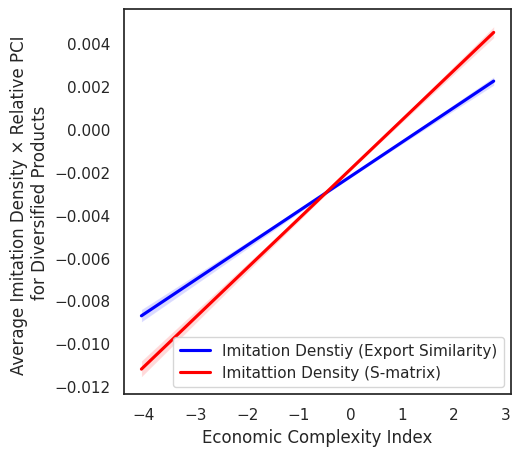

In [ ]:
temp_list1 = []
temp_list2 = []
temp_list3 = []
temp_list4 = []
temp_list5 = {}

for temp_year in range(start_year, end_year-1):
  temp_list1 += np.mean(imitation_density_3[temp_year]*Opportunity[temp_year]*Relative_pci[temp_year]*binary_rca[temp_year+2],axis = 1).values.tolist()
  temp_list2 += np.mean(imitation_density_4[temp_year]*Opportunity[temp_year]*Relative_pci[temp_year]*binary_rca[temp_year+2],axis = 1).values.tolist()
  temp_list3 += np.mean(binary_rca[temp_year],axis = 1).values.tolist()
  temp_list4 += eci[temp_year].values.tolist()
  #temp_list5 += np.mean(Relative_relatedness_density[temp_year]*Opportunity[temp_year]*Relative_pci[temp_year],axis = 1).values.tolist()

temp_check_df = pd.DataFrame()
temp_check_df['imitation_density_3'] = temp_list1
temp_check_df['imitation_density_4'] = temp_list2
#temp_check_df['Relative_relatedness_density'] = temp_list5
temp_check_df['RCA'] = temp_list3
temp_check_df['eci'] = temp_list4
temp_check_df.index = list(binary_rca[temp_year].index)*(end_year-1-start_year)
temp_check_df.sort_values(by = 'imitation_density_4', ascending = False).head(30)

fig  = plt.figure(figsize = (5,5))
ax = fig.add_subplot(1,1,1)

sns.regplot(data = temp_check_df, x = 'eci', y = 'imitation_density_4', color = 'blue',ax = ax, label = 'Imitation Denstiy (Export Similarity)', scatter=None)
sns.regplot(data = temp_check_df, x = 'eci', y = 'imitation_density_3', color = 'red',ax = ax, label = 'Imitattion Density (S-matrix)', scatter=None)

ax.legend()
ax.set_xlabel('Economic Complexity Index',fontsize = 12)
ax.set_ylabel('Average Imitation Density × Relative PCI \nfor Diversified Products', fontsize=12)

Text(0, 0.5, 'Average Imitation Density × Relative PCI \nfor Diversified Products')

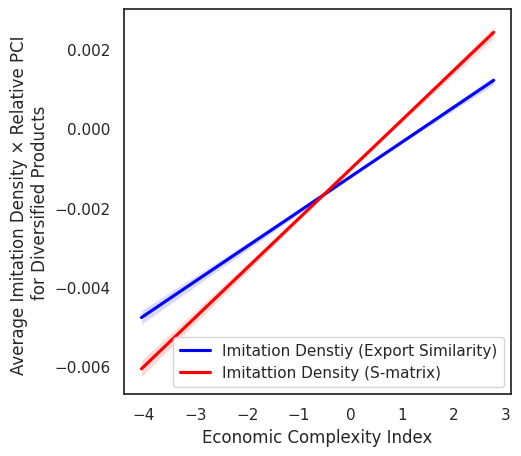

In [ ]:
temp_list1 = []
temp_list2 = []
temp_list3 = []
temp_list4 = []
temp_list5 = {}

for temp_year in range(start_year, end_year-1):
  temp_list1 += np.mean(imitation_density_3[temp_year]*(Opportunity[temp_year]+Opportunity[temp_year+1]==2).astype(int)*Relative_pci[temp_year]*binary_rca[temp_year+2],axis = 1).values.tolist()
  temp_list2 += np.mean(imitation_density_4[temp_year]*(Opportunity[temp_year]+Opportunity[temp_year+1]==2).astype(int)*Relative_pci[temp_year]*binary_rca[temp_year+2],axis = 1).values.tolist()
  temp_list3 += np.mean(binary_rca[temp_year],axis = 1).values.tolist()
  temp_list4 += eci[temp_year].values.tolist()
  #temp_list5 += np.mean(Relative_relatedness_density[temp_year]*Opportunity[temp_year]*Relative_pci[temp_year],axis = 1).values.tolist()

temp_check_df = pd.DataFrame()
temp_check_df['imitation_density_3'] = temp_list1
temp_check_df['imitation_density_4'] = temp_list2
#temp_check_df['Relative_relatedness_density'] = temp_list5
temp_check_df['RCA'] = temp_list3
temp_check_df['eci'] = temp_list4
temp_check_df.index = list(binary_rca[temp_year].index)*(end_year-1-start_year)
temp_check_df.sort_values(by = 'imitation_density_4', ascending = False).head(30)

fig  = plt.figure(figsize = (5,5))
ax = fig.add_subplot(1,1,1)

sns.regplot(data = temp_check_df, x = 'eci', y = 'imitation_density_4', color = 'blue',ax = ax, label = 'Imitation Denstiy (Export Similarity)', scatter=None)
sns.regplot(data = temp_check_df, x = 'eci', y = 'imitation_density_3', color = 'red',ax = ax, label = 'Imitattion Density (S-matrix)', scatter=None)

ax.legend()
ax.set_xlabel('Economic Complexity Index',fontsize = 12)
ax.set_ylabel('Average Imitation Density × Relative PCI \nfor Diversified Products', fontsize=12)

In [ ]:
sitc_dictionary_df=pd.read_csv(data_directory+'/sitc_product.tab',delimiter='\t')
sitc_dictionary_df['sitc_product_code']=sitc_dictionary_df['sitc_product_code'].apply(lambda item:str(item).zfill(4))
temp_sitc_dict=dict(zip(
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_code'],
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_name_short_en']
))

In [ ]:
temp_sitc_dict['2119']

'Hides and skins, nes; waste and used leather'

In [ ]:
imitation_density_4[1967].loc['CUB'].sort_values(ascending = False).head(20).index

Index(['2119', '0615', '0360', '2911', '0542', '2929', '2924', '0612', '0611',
       '1213', '1211', '1212', '0711', '0752', '2483', '9410', '0980', '2919',
       '0812', '6612'],
      dtype='object', name='sitc_product_code')

In [ ]:
Relative_pci[1967].loc['CUB']

,CUB
sitc_product_code,
0011,-1.140442
0012,-1.639749
0013,-0.892533
0014,-0.405775
0015,-0.379244
...,...
ZZZZ,-0.368938
financial,-0.368938
transport,-0.368938


In [ ]:
for item in imitation_density_4[1968].loc['CUB'].sort_values(ascending = False).head(20).index:
  print(temp_sitc_dict[item],item,Relative_pci[1968].loc['CUB',item])

Hides and skins, nes; waste and used leather 2119 -2.3422316336698734
Crustaceans and molluscs, fresh, chilled, frozen, salted, etc 0360 -1.5622298182142427
Bones, ivory, horns, coral, shells and similar products 2911 -1.7357128606602796
Molasses 0615 -2.0507443898075413
Plants and parts of trees used in perfumery; in pharmacy; etc 2924 -1.9553365315958853
Other materials of vegetable origin, nes 2929 -1.8250581406468855
Refined sugar etc 0612 -1.7156707089651866
Beans, peas, other leguminous vegetables, dried, shelled 0542 -1.6275757291881447
Edible products and preparations, nes 0980 -1.3502585293604232
Animals, live, nes, (including zoo animals, pets, insects, etc) 9410 -1.6253898697534879
Coffee green, roasted; coffee substitutes containing coffee 0711 -2.3238111694764356
Tobacco, not stripped 1211 -1.9151269905117363
Tobacco refuse 1213 -1.9151269905117363
Tobacco, wholly or partly stripped 1212 -1.9151269905117363
Spices, except pepper and pimento 0752 -1.9325657987192015
Jams, j

In [ ]:
for item in imitation_density_4[1967].loc['CUB'].sort_values(ascending = False).head(20).index:
  print(temp_sitc_dict[item],item,Relative_pci[1967].loc['CUB',item])

Hides and skins, nes; waste and used leather 2119 -2.191078487593087
Molasses 0615 -1.9316231069964547
Crustaceans and molluscs, fresh, chilled, frozen, salted, etc 0360 -1.5397724969320892
Bones, ivory, horns, coral, shells and similar products 2911 -1.6122731199372666
Beans, peas, other leguminous vegetables, dried, shelled 0542 -1.4806585928662332
Other materials of vegetable origin, nes 2929 -2.0350256146868504
Plants and parts of trees used in perfumery; in pharmacy; etc 2924 -2.0217522024235617
Refined sugar etc 0612 -1.5638247061192359
Sugars, beet and cane, raw, solid 0611 -1.7606607842830106
Tobacco refuse 1213 -2.0291971334881715
Tobacco, not stripped 1211 -2.0291971334881715
Tobacco, wholly or partly stripped 1212 -2.0291971334881715
Coffee green, roasted; coffee substitutes containing coffee 0711 -2.2645620059257943
Spices, except pepper and pimento 0752 -1.899221204679153
Wood, non-coniferous species, sawn, planed, tongued, grooved, etc 2483 -2.098230631155573
Animals, liv

## Relative Imitation Denstiy

In [ ]:
imitation_density.keys()

dict_keys([1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020])

In [ ]:
Relative_imitation_density = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = imitation_density[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country]!=0].index
    temp_std = imitation_density[year].loc[temp_country][Ops].std()
    temp_mean = imitation_density[year].loc[temp_country][Ops].mean()
    relative_density = (imitation_density[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_imitation_density[year] = temp_mat

100%|██████████| 59/59 [00:07<00:00,  8.08it/s]


In [ ]:
Relative_imitation_density_2 = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = imitation_density_2[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country]!=0].index
    temp_std = imitation_density_2[year].loc[temp_country][Ops].std()
    temp_mean = imitation_density_2[year].loc[temp_country][Ops].mean()
    relative_density = (imitation_density_2[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_imitation_density_2[year] = temp_mat

100%|██████████| 59/59 [00:07<00:00,  8.27it/s]


In [ ]:
Relative_imitation_density_3 = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = imitation_density_3[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country]!=0].index
    temp_std = imitation_density_3[year].loc[temp_country][Ops].std()
    temp_mean = imitation_density_3[year].loc[temp_country][Ops].mean()
    relative_density = (imitation_density_3[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_imitation_density_3[year] = temp_mat

100%|██████████| 59/59 [00:07<00:00,  7.82it/s]


In [ ]:
Relative_imitation_density_4 = {}
for year in tqdm(range(start_year, end_year+1)):
  temp_mat = imitation_density_4[year].copy()
  for temp_country in temp_mat.index:
    Ops = Opportunity[year].loc[temp_country][Opportunity[year].loc[temp_country]!=0].index
    temp_std = imitation_density_4[year].loc[temp_country][Ops].std()
    temp_mean = imitation_density_4[year].loc[temp_country][Ops].mean()
    relative_density = (imitation_density_4[year].loc[temp_country] - temp_mean)/temp_std
    temp_mat.loc[temp_country] = relative_density
  Relative_imitation_density_4[year] = temp_mat

100%|██████████| 59/59 [00:07<00:00,  8.22it/s]


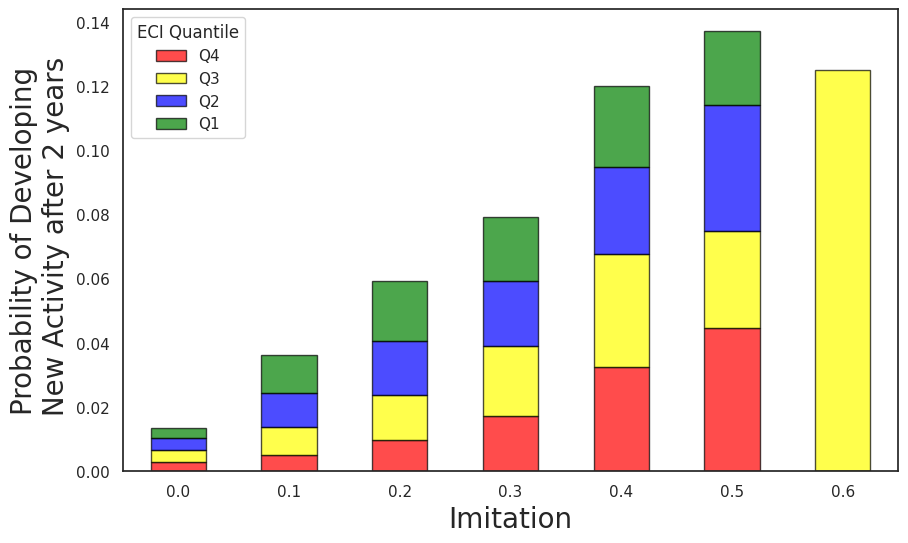

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * imitation_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * imitation_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * imitation_density[year]) > i) & \
                               ((Opportunity[year] * imitation_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Imitation",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


In [ ]:
imitation_density_4[year].max().max()

0.7054172293797761

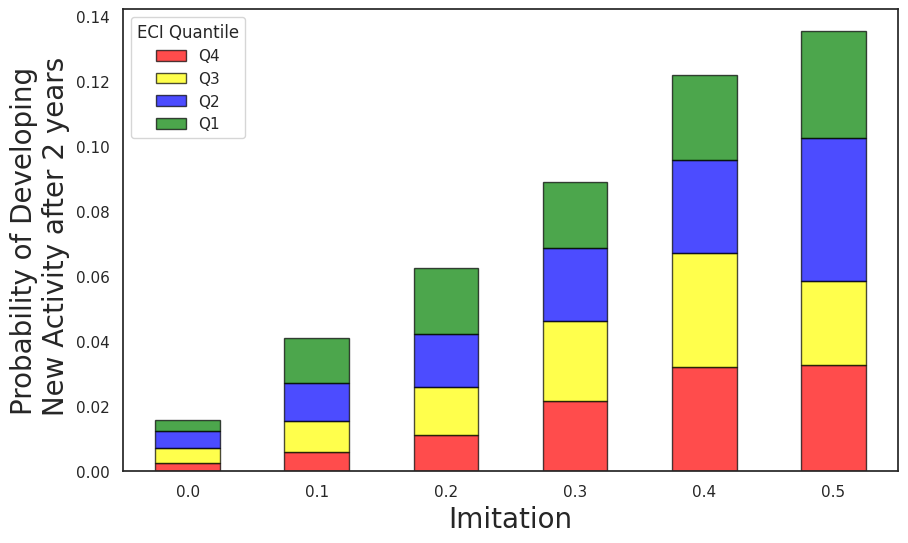

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.1 if i == 0.5 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * imitation_density_4[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * imitation_density_4[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * imitation_density_4[year]) > i) & \
                               ((Opportunity[year] * imitation_density_4[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Imitation",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


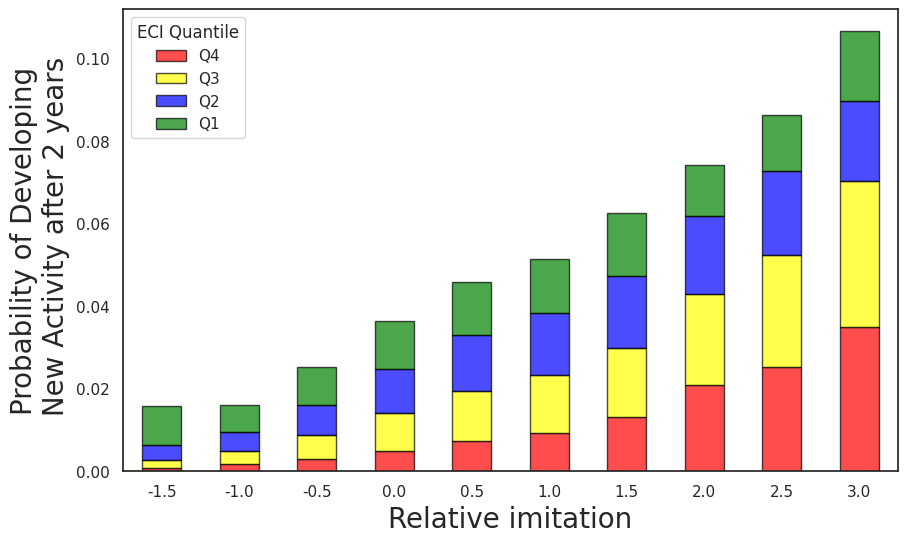

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * Relative_imitation_density[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * Relative_imitation_density[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * Relative_imitation_density[year]) > i) & \
                               ((Opportunity[year] * Relative_imitation_density[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative imitation",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


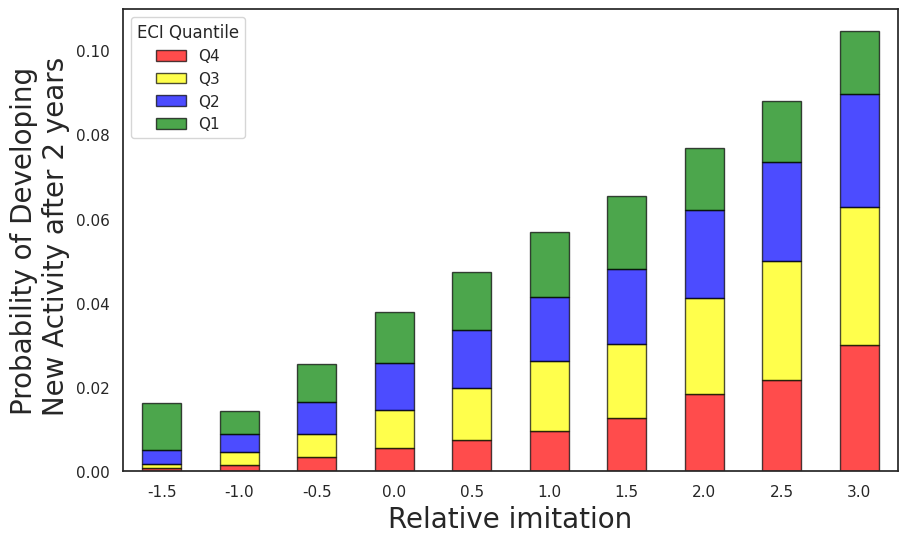

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [-1.5, -1, -0.5, 0, 0.5, 1.0, 1.5, 2, 2.5, 3]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.4 if i == 0.6 else i + 0.1

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * Relative_imitation_density_4[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * Relative_imitation_density_4[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * Relative_imitation_density_4[year]) > i) & \
                               ((Opportunity[year] * Relative_imitation_density_4[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors)
plt.xlabel("Relative imitation",fontsize = 20)
plt.ylabel("Probability of Developing\n New Activity after 2 years",fontsize = 20)
plt.xticks(rotation=0)
plt.legend(title="ECI Quantile")
plt.show()


# Regression Analysis

In [ ]:
start_year = 1962
end_year = 2020

In [ ]:
relatedness_density.keys()

In [ ]:
Opportunity[year]

In [ ]:
!pip install openpyxl

In [ ]:
temp_pwt_data=pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/pwt1001.xlsx',sheet_name='Data')
temp_pwt_data.head()

Mayer, T. & Zignago, S. (2011), Notes on CEPII’s distances measures : the GeoDist Database, CEPII Working Paper 2011-25

In [ ]:
!pip install xlrd

In [ ]:
geo_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/geo_cepii.xls')
dist_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/dist_cepii.xls')

In [ ]:
geo_df['continent'].unique()

In [ ]:
dist_df.columns

In [ ]:
dist_df.head()

In [ ]:
Export_Similarity[year].columns

In [ ]:
'''

dist Simple distance (most populated cities, km)
distcap Simple distance between capitals (capitals, km)
distw Weighted distance (pop-wt, km) with theta=1 (theta measures the sensitivity of trade flows to bilateral distance dkl)
distwces Weighted distance (pop-wt, km) theta=-1.

'''

In [ ]:
dist_df['contig'].unique()

In [ ]:
dist_df[dist_df['iso_o']=='ABW']

In [ ]:
Dist_m = pd.DataFrame(np.zeros(shape = (len(Export_Similarity[year].columns),len(Export_Similarity[year].columns))),index = Export_Similarity[year].columns, columns = Export_Similarity[year].columns)
for i in tqdm(Export_Similarity[year].index):
  for j in Export_Similarity[year].columns:
    try:
      Dist_m.loc[i,j] = dist_df[(dist_df['iso_o']==i) & (dist_df['iso_d']==j)].iloc[0]['dist']
    except:
      Dist_m.loc[i,j] = None

In [ ]:
Dist_m.head()

In [ ]:
CapDist_m = pd.DataFrame(np.zeros(shape = (len(Export_Similarity[year].columns),len(Export_Similarity[year].columns))),index = Export_Similarity[year].columns, columns = Export_Similarity[year].columns)
for i in tqdm(Export_Similarity[year].index):
  for j in Export_Similarity[year].columns:
    try:
      CapDist_m.loc[i,j] = dist_df[(dist_df['iso_o']==i) & (dist_df['iso_d']==j)].iloc[0]['distcap']
    except:
      CapDist_m.loc[i,j] = None

In [ ]:
Dist_m

In [ ]:
source_country = 'KOR'
temp_df1 = Export_Similarity[year].loc[source_country]
temp_df2 = Dist_m.loc[source_country]
temp_df3 = CapDist_m.loc[source_country]

temp_df = pd.concat([temp_df1, temp_df2, temp_df3], axis=1)

# Rename the columns to reflect their sources, if needed
temp_df.columns = ['Export_Similarity', 'Dist', 'CapDist']

# Display the temp DataFrame
index = [x for x in temp_df.index if x!=source_country]
temp_df = temp_df.loc[index]
temp_df.sort_values(by='Export_Similarity', ascending=False)

In [ ]:
sns.regplot(data=temp_df, x='Dist', y='Export_Similarity')

In [ ]:
geo_df = pd.read_excel(r'/content/drive/MyDrive/Research/Learning from Rivals/Data/geo_cepii.xls')
geo_df.head()

In [ ]:
relatedness_density.keys()

In [ ]:
start_year, end_year

In [ ]:
from tqdm import tqdm
import numpy as np
import pandas as pd

# Relative Imitation density와 contigent 추가

# Pre-compute percentiles for all years to avoid redundant calculations
eci_quartiles = {
    year: np.percentile(eci[year].values, [25, 50, 75])
    for year in range(start_year, end_year - 1)
}

# Initialize an empty list for results
temp_result_list = []

# Iterate through years
for year in tqdm(range(start_year, end_year - 1)):
    # Extract necessary data for the current year
    eci_values = eci[year]
    quartiles = eci_quartiles[year]
    opportunity_data = Opportunity[year]
    opportunity_data = opportunity_data+Opportunity[year+1]

    binary_rca_data = binary_rca[year + 2]
    rr_density = Relative_relatedness_density[year]
    r_density = relatedness_density[year]
    imitation = imitation_density[year]
    relative_density = Relative_imitation_density[year]
    relative_pci = Relative_pci[year]

    # Pre-filter countries and products with Opportunity = 1
    filtered_opportunity = opportunity_data.stack()
    valid_indices = filtered_opportunity[filtered_opportunity == 2].index
    #valid_indices = filtered_opportunity[filtered_opportunity == 1].index

    # Loop through valid country-product pairs
    for country, product in valid_indices:
        try:
            # Prepare result row
            temp_list = [
                country,
                product,
                year,
                binary_rca_data.loc[country, product],
                r_density.loc[country, product],
                rr_density.loc[country, product],
                imitation.loc[country, product],
                relative_density.loc[country, product],
                relative_pci.loc[country, product],
                eci_values.loc[country]
            ]

            # Determine ECI quantile
            eci_value = eci_values.loc[country]
            if eci_value >= quartiles[2]:
                temp_list.append('Q1')
            elif eci_value >= quartiles[1]:
                temp_list.append('Q2')
            elif eci_value >= quartiles[0]:
                temp_list.append('Q3')
            else:
                temp_list.append('Q4')

            # Add PWT data for the country-year
            temp_df = temp_pwt_data[
                (temp_pwt_data['countrycode'] == country) &
                (temp_pwt_data['year'] == year)
            ]
            if not temp_df.empty:
                temp_country_dict = dict(zip(temp_df.columns, temp_df.iloc[0]))
                temp_list.extend([
                    temp_country_dict.get('rnna', np.nan),
                    temp_country_dict.get('pop', np.nan),
                    temp_country_dict.get('hc', np.nan),
                    temp_country_dict.get('rgdpo', np.nan),
                    temp_country_dict.get('rgdpe', np.nan),
                    temp_country_dict.get('rgdpo', np.nan) / temp_country_dict.get('pop', 1),
                    temp_country_dict.get('rgdpe', np.nan) / temp_country_dict.get('pop', 1)
                ])
            else:
                temp_list.extend([np.nan] * 7)  # Fill with NaNs if no data is available

            try:
              temp_list.append(geo_df[(geo_df['iso3']==country)].iloc[0]['continent'])
            except:
              temp_list.append(None)

            # Append the row to the result list
            temp_result_list.append(temp_list)

        except Exception as e:
            # Optional: Log or print exceptions for debugging
            pass

# Create DataFrame from the result list
columns = [
    'country', 'product', 'year', 'binary_rca', 'relatedness_density', 'Relative_relatedness_density',
    'imitation_density','Relative_imitation_density','Relative_pci', 'eci', 'eci_quantile',
    'rnna', 'pop', 'hc', 'rgdpo', 'rgdpe', 'rgdpo_per_capita', 'rgdpe_per_capita','continent'
]
Regression_df = pd.DataFrame(temp_result_list, columns=columns)

# Display the first few rows
Regression_df.head()


In [ ]:
len(Regression_df)

In [ ]:
data_directory

In [ ]:
import pickle

with open(class_directory+r'/Regression_df_250110.pkl', 'wb') as f:
  pickle.dump(Regression_df, f)

In [ ]:
Regression_df.head()

In [ ]:
!pip install linearmodels

In [ ]:
import statsmodels.api as sm
from linearmodels.panel import PanelOLS

In [ ]:
import pickle

with open(class_directory+r'/Regression_df_250110.pkl', 'rb') as f:
  Regression_df = pickle.load(f)

In [ ]:
Regression_df.columns

Index(['country', 'product', 'year', 'binary_rca', 'relatedness_density',
       'Relative_relatedness_density', 'imitation_density',
       'Relative_imitation_density', 'Relative_pci', 'eci', 'eci_quantile',
       'rnna', 'pop', 'hc', 'rgdpo', 'rgdpe', 'rgdpo_per_capita',
       'rgdpe_per_capita', 'continent'],
      dtype='object')

In [ ]:
Regression_df['continent'] = Regression_df['continent'].replace(np.nan,'etc')

In [ ]:
Regression_df.continent.unique()

array(['Africa', 'Europe', 'Asia', 'America', 'Pacific', 'etc'],
      dtype=object)

In [ ]:
Regression_df.head()

,country,product,year,binary_rca,relatedness_density,Relative_relatedness_density,imitation_density,Relative_imitation_density,Relative_pci,eci,eci_quantile,rnna,pop,hc,rgdpo,rgdpe,rgdpo_per_capita,rgdpe_per_capita,continent
0,AGO,0011,1962,0,0.115482,1.936249,0.215384,2.220916,-1.793921,-0.866697,Q3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Africa
1,AGO,0012,1962,0,0.107004,1.702076,0.141182,1.063397,-1.742458,-0.866697,Q3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Africa
2,AGO,0013,1962,0,0.078126,0.904476,0.158088,1.327119,-0.889369,-0.866697,Q3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Africa
3,AGO,0014,1962,0,0.059343,0.385675,0.097241,0.377927,-0.556197,-0.866697,Q3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Africa
4,AGO,0015,1962,0,0.048865,0.096267,0.097481,0.381668,-0.671058,-0.866697,Q3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Africa


In [ ]:
years = list(Regression_df['year'].unique())

temp_list2 = []
temp_list3 = []
temp_list4 = []

temp_list5 = []
temp_list6 = []
temp_list7 = []


for i in tqdm(range(len(Regression_df))):
  temp_country = Regression_df.iloc[i]['country']
  temp_year = Regression_df.iloc[i]['year']
  temp_product = Regression_df.iloc[i]['product']

  temp_list2.append(imitation_density_2[temp_year].loc[temp_country,temp_product])
  temp_list3.append(imitation_density_3[temp_year].loc[temp_country,temp_product])
  temp_list4.append(imitation_density_4[temp_year].loc[temp_country,temp_product])

  temp_list5.append(Relative_imitation_density_2[temp_year].loc[temp_country,temp_product])
  temp_list6.append(Relative_imitation_density_3[temp_year].loc[temp_country,temp_product])
  temp_list7.append(Relative_imitation_density_4[temp_year].loc[temp_country,temp_product])


In [ ]:
Regression_df['imitation_density_2'] = temp_list2
Regression_df['imitation_density_3'] = temp_list3
Regression_df['imitation_density_4'] = temp_list4

Regression_df['Relative_imitation_density_2'] = temp_list5
Regression_df['Relative_imitation_density_3'] = temp_list6
Regression_df['Relative_imitation_density_4'] = temp_list7

In [ ]:
years = list(Regression_df['year'].unique())

temp_list2 = []

for i in tqdm(range(len(Regression_df))):
  temp_country = Regression_df.iloc[i]['country']
  temp_year = Regression_df.iloc[i]['year']
  temp_product = Regression_df.iloc[i]['product']
  temp_list2.append(imitation_density_4_dist[temp_year].loc[temp_country,temp_product])

Regression_df['imitation_density_4_dist'] = temp_list2

In [ ]:
import math

Regression_df['log_rnna'] = Regression_df['rnna'].apply(lambda x: math.log(x+1))
Regression_df['log_pop'] = Regression_df['pop'].apply(lambda x: math.log(x+1))

In [ ]:
(Opportunity[2010] == 0).sum().sum()

In [ ]:
(Opportunity[2010] == 1).sum().sum()

In [ ]:
len(Regression_df)

In [ ]:
Regression_df.dropna(inplace=True)

In [ ]:
with open(class_directory+r'/Regression_df_250110_f.pkl', 'wb') as f:
  pickle.dump(Regression_df, f)

## Relatedness Density vs. Imitation Density

In [ ]:
binary_rca[1990]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ALB,0,1,0,0,1,0,0,0,0,0,...,0,1,0,1,0,0,0,0,0,1
ARE,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,1,1,0,0,0,0
ARG,0,0,0,0,1,1,1,0,0,1,...,0,1,0,0,0,0,0,1,1,0
AUS,0,1,0,0,1,1,1,0,0,1,...,0,1,0,1,1,0,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
YEM,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ZAF,0,0,0,0,0,1,0,0,0,0,...,0,1,0,0,1,0,1,0,1,0


In [ ]:
!pip install linearmodels
import statsmodels.api as sm
from linearmodels.panel import PanelOLS

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 21.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.7/115.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.7/43.7 kB 3.0 MB/s eta 0:00:00


In [ ]:
import pickle
import pandas as pd

In [ ]:
with open(class_directory+r'/Regression_df_250111_f.pkl', 'rb') as f:
  Regression_df = pickle.load(f)

In [ ]:
years = list(Regression_df['year'].unique())
years

[1962,
 1963,
 1964,
 1965,
 1966,
 1967,
 1968,
 1969,
 1970,
 1971,
 1972,
 1973,
 1974,
 1975,
 1976,
 1977,
 1978,
 1979,
 1980,
 1981,
 1982,
 1983,
 1984,
 1985,
 1986,
 1987,
 1988,
 1989,
 1990,
 1991,
 1992,
 1993,
 1994,
 1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018]

In [ ]:
country2continent = dict(zip(Regression_df.country,Regression_df.continent))

In [ ]:
temp_df = Regression_df.copy()
temp_df = temp_df[['binary_rca','Relative_relatedness_density','imitation_density_4']]
temp_df.dropna(inplace=True)
temp_df.reset_index(inplace=True,drop=True)
len(temp_df)

3689383

In [ ]:
data = Regression_df.copy()
data = data[data['binary_rca']==1]
data = data[['country', 'product', 'year', 'Relative_pci', 'Relative_relatedness_density', 'relatedness_density', 'Relative_imitation_density_4','imitation_density_4','eci']]
data

,country,product,year,Relative_pci,Relative_relatedness_density,relatedness_density,Relative_imitation_density_4,imitation_density_4,eci
2252,ARG,0142,1962,-0.932231,0.886656,0.097628,0.975240,0.133561,-0.546232
2273,ARG,0545,1962,-1.250032,1.381210,0.117985,1.984717,0.197493,-0.546232
2283,ARG,0585,1962,-1.493594,1.451287,0.120870,1.629404,0.174990,-0.546232
2286,ARG,0611,1962,-2.525300,3.951118,0.223768,3.158870,0.271855,-0.546232
2304,ARG,1122,1962,0.111321,-0.044189,0.059313,-0.134638,0.063270,-0.546232
...,...,...,...,...,...,...,...,...,...
4734757,ZWE,2924,2018,-1.794034,2.568962,0.133196,4.080741,0.470851,-1.086484
4734776,ZWE,4233,2018,-1.455087,1.479781,0.105746,0.558709,0.174816,-1.086484
4734972,ZWE,6624,2018,-0.430180,0.318543,0.076480,0.362918,0.158359,-1.086484
4735000,ZWE,6724,2018,-0.497454,0.506832,0.081225,0.539420,0.173194,-1.086484


In [ ]:
len(data)

125606

In [ ]:
data = Regression_df.copy()
data = data[data['binary_rca']==1]
data = data[['country', 'product', 'year', 'Relative_pci', 'Relative_relatedness_density', 'relatedness_density', 'Relative_imitation_density_4','imitation_density_4','eci']]

# Create DataFrame from collected data
temp_df = data.copy()
temp_df.columns = ['country', 'product', 'year', 'Relative PCI', 'Relative Relatedness', 'Relatedness', 'Relative Imitation','Imitation','ECI']

# Calculate means efficiently using groupby
grouped = temp_df.groupby(['country', 'year'], as_index=False).agg({
    'Relative PCI': 'mean',
    #'PCI': 'mean',
    'Relative Relatedness': 'mean',
    'Relatedness': 'mean',
    'Relative Imitation': 'mean',
    'Imitation': 'mean',
    'ECI': 'first'  # Use 'first' since ECI is constant per (country, year)
})

# Rename columns to match original
plot_df = grouped.rename(columns={
    'Relative PCI': 'Relative PCI',
    #'PCI': 'PCI',
    'Relative Relatedness': 'Relative Relatedness',
    'Relatedness': 'Relatedness',
    'Relative Imitation': 'Relative Imitation',
    'Imitation': 'Imitation',
})

# Drop NaN values if any
plot_df.dropna(inplace=True)

# Display the head of the DataFrame
plot_df.head()


,country,year,Relative PCI,Relative Relatedness,Relatedness,Relative Imitation,Imitation,ECI
0,AGO,1970,-1.046225,1.081943,0.076252,1.105797,0.170064,-1.401312
1,AGO,1971,-0.639139,0.626135,0.066497,0.666229,0.136854,-1.438635
2,AGO,1972,-1.283319,1.610136,0.107789,1.786890,0.230442,-1.078024
3,AGO,1973,-1.804975,2.231467,0.133088,1.467651,0.208726,-0.894224
4,AGO,1975,-0.939703,0.974767,0.071665,1.287216,0.200092,-1.566500


In [ ]:
Regression_df['Diversified'] = Regression_df['binary_rca'].apply(lambda x: 'Diversified Products' if x==1 else 'Non-Diversified Products')

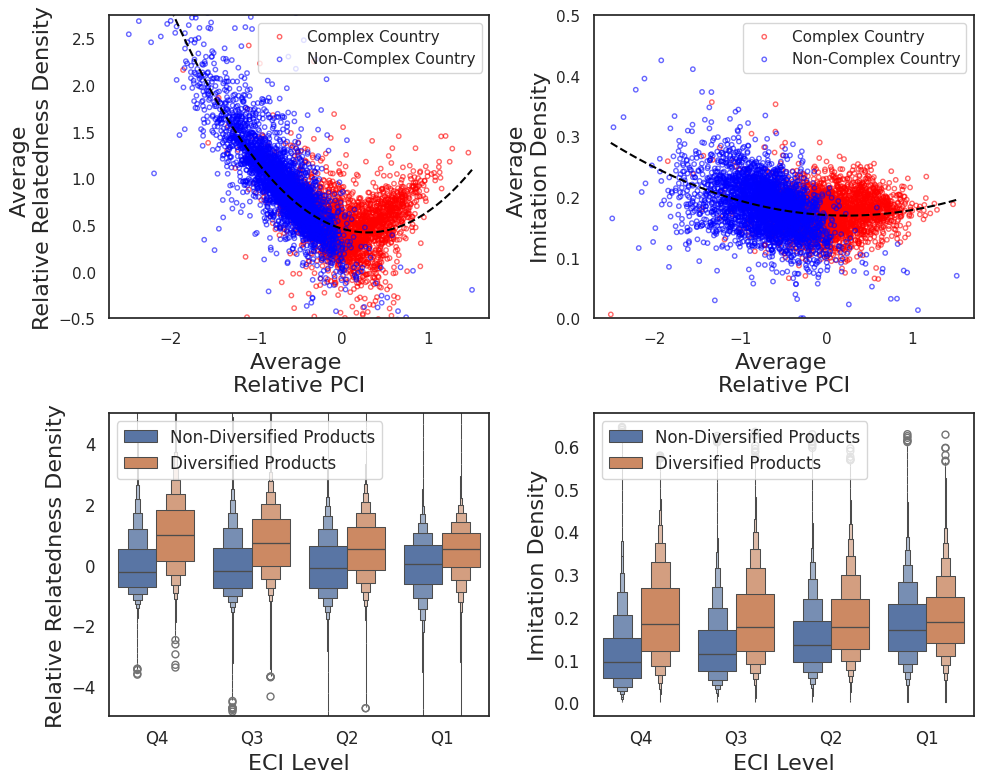

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Prepare data for scatter plots
filtered_df1 = plot_df[['Relative PCI', 'Relative Relatedness', 'ECI']].dropna()
filtered_df2 = plot_df[['Relative PCI', 'Imitation', 'ECI']].dropna()

# Create the 2x2 grid
fig, axes = plt.subplots(2, 2, figsize=(10, 8))  # 2x2 grid layout

# First scatter plot
filtered_df_complex1 = filtered_df1[filtered_df1['ECI'] >= 0]
filtered_df_simple1 = filtered_df1[filtered_df1['ECI'] < 0]
axes[0, 0].scatter(
    filtered_df_complex1['Relative PCI'], filtered_df_complex1['Relative Relatedness'],
    alpha=0.6, color='red', s=10, label='Complex Country', facecolors='none'
)
axes[0, 0].scatter(
    filtered_df_simple1['Relative PCI'], filtered_df_simple1['Relative Relatedness'],
    alpha=0.6, color='blue', s=10, label='Non-Complex Country', facecolors='none'
)
z1 = np.polyfit(filtered_df1['Relative PCI'], filtered_df1['Relative Relatedness'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['Relative PCI'].min(), filtered_df1['Relative PCI'].max(), 100)
axes[0, 0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')
axes[0, 0].set_xlabel("Average \nRelative PCI", fontsize=16)
axes[0, 0].set_ylabel("Average \nRelative Relatedness Density", fontsize=16)
axes[0, 0].legend()
axes[0, 0].set_ylim(-0.5, 2.75)

# Second scatter plot
filtered_df_complex2 = filtered_df2[filtered_df2['ECI'] >= 0]
filtered_df_simple2 = filtered_df2[filtered_df2['ECI'] < 0]
axes[0, 1].scatter(
    filtered_df_complex2['Relative PCI'], filtered_df_complex2['Imitation'],
    alpha=0.6, color='red', s=10, label='Complex Country', facecolors='none'
)
axes[0, 1].scatter(
    filtered_df_simple2['Relative PCI'], filtered_df_simple2['Imitation'],
    alpha=0.6, color='blue', s=10, label='Non-Complex Country', facecolors='none'
)
z2 = np.polyfit(filtered_df2['Relative PCI'], filtered_df2['Imitation'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df2['Relative PCI'].min(), filtered_df2['Relative PCI'].max(), 100)
axes[0, 1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')
axes[0, 1].set_xlabel("Average \nRelative PCI", fontsize=16)
axes[0, 1].set_ylabel("Average \nImitation Density", fontsize=16)
axes[0, 1].legend()
axes[0, 1].set_ylim(0, 0.5)

# First boxen plot
sns.boxenplot(
    data=Regression_df,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[1, 0]
)
axes[1, 0].set_xlabel("ECI Level", fontsize=16)
axes[1, 0].set_ylabel("Relative Relatedness Density", fontsize=16)
axes[1, 0].legend(title=None, loc="upper left", fontsize=12)
axes[1, 0].tick_params(axis='both', which='major', labelsize=12)
axes[1, 0].set_ylim(-5, 5)

# Second boxen plot
sns.boxenplot(
    data=Regression_df,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[1, 1]
)
axes[1, 1].set_xlabel("ECI Level", fontsize=16)
axes[1, 1].set_ylabel("Imitation Density", fontsize=16)
axes[1, 1].legend(title=None, loc="upper left", fontsize=12)
axes[1, 1].tick_params(axis='both', which='major', labelsize=12)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


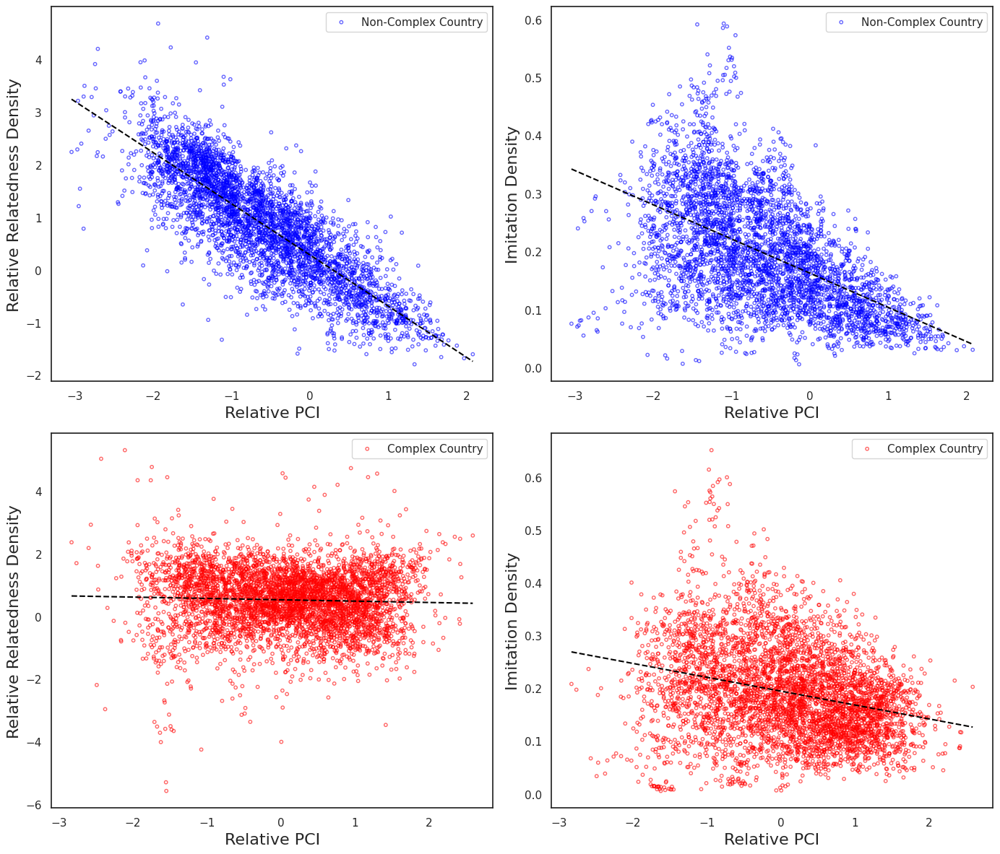

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Prepare data for scatter plots
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year'] >= 2015]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]
filtered_df1 = temp_Regression_df[['Relative_pci', 'Relative_relatedness_density', 'eci']].dropna()
filtered_df2 = temp_Regression_df[['Relative_pci', 'imitation_density_4', 'eci']].dropna()

# Create the 2x2 grid
fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid layout

# First scatter plot (Top-left) - Non-Complex Countries: Relative PCI vs Relative Relatedness Density
filtered_df_simple1 = filtered_df1[filtered_df1['eci'] < 0]
axes[0, 0].scatter(
    filtered_df_simple1['Relative_pci'], filtered_df_simple1['Relative_relatedness_density'],
    alpha=0.6, color='blue', s=10, label='Non-Complex Country', facecolors='none'
)
z1 = np.polyfit(filtered_df_simple1['Relative_pci'], filtered_df_simple1['Relative_relatedness_density'], 1)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df_simple1['Relative_pci'].min(), filtered_df_simple1['Relative_pci'].max(), 100)
axes[0, 0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')
axes[0, 0].set_xlabel("Relative PCI", fontsize=16)
axes[0, 0].set_ylabel("Relative Relatedness Density", fontsize=16)
axes[0, 0].legend()

# Second scatter plot (Top-right) - Non-Complex Countries: Relative PCI vs Imitation Density
filtered_df_simple2 = filtered_df2[filtered_df2['eci'] < 0]
axes[0, 1].scatter(
    filtered_df_simple2['Relative_pci'], filtered_df_simple2['imitation_density_4'],
    alpha=0.6, color='blue', s=10, label='Non-Complex Country', facecolors='none'
)
z2 = np.polyfit(filtered_df_simple2['Relative_pci'], filtered_df_simple2['imitation_density_4'], 1)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df_simple2['Relative_pci'].min(), filtered_df_simple2['Relative_pci'].max(), 100)
axes[0, 1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')
axes[0, 1].set_xlabel("Relative PCI", fontsize=16)
axes[0, 1].set_ylabel("Imitation Density", fontsize=16)
axes[0, 1].legend()

# Third scatter plot (Bottom-left) - Complex Countries: Relative PCI vs Relative Relatedness Density
filtered_df_complex1 = filtered_df1[filtered_df1['eci'] >= 0]
axes[1, 0].scatter(
    filtered_df_complex1['Relative_pci'], filtered_df_complex1['Relative_relatedness_density'],
    alpha=0.6, color='red', s=10, label='Complex Country', facecolors='none'
)
z3 = np.polyfit(filtered_df_complex1['Relative_pci'], filtered_df_complex1['Relative_relatedness_density'], 1)
p3 = np.poly1d(z3)
trendline_x3 = np.linspace(filtered_df_complex1['Relative_pci'].min(), filtered_df_complex1['Relative_pci'].max(), 100)
axes[1, 0].plot(trendline_x3, p3(trendline_x3), color='black', linestyle='--')
axes[1, 0].set_xlabel("Relative PCI", fontsize=16)
axes[1, 0].set_ylabel("Relative Relatedness Density", fontsize=16)
axes[1, 0].legend()

# Fourth scatter plot (Bottom-right) - Complex Countries: Relative PCI vs Imitation Density
filtered_df_complex2 = filtered_df2[filtered_df2['eci'] >= 0]
axes[1, 1].scatter(
    filtered_df_complex2['Relative_pci'], filtered_df_complex2['imitation_density_4'],
    alpha=0.6, color='red', s=10, label='Complex Country', facecolors='none'
)
z4 = np.polyfit(filtered_df_complex2['Relative_pci'], filtered_df_complex2['imitation_density_4'], 1)
p4 = np.poly1d(z4)
trendline_x4 = np.linspace(filtered_df_complex2['Relative_pci'].min(), filtered_df_complex2['Relative_pci'].max(), 100)
axes[1, 1].plot(trendline_x4, p4(trendline_x4), color='black', linestyle='--')
axes[1, 1].set_xlabel("Relative PCI", fontsize=16)
axes[1, 1].set_ylabel("Imitation Density", fontsize=16)
axes[1, 1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


<ipython-input-339-00c2aa1cfc53>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
<ipython-input-339-00c2aa1cfc53>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)
<ipython-input-339-00c2aa1cfc53>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavio

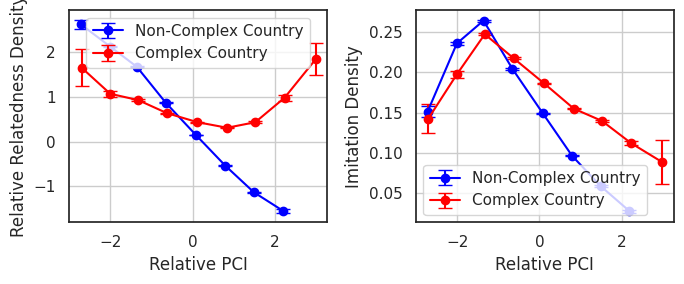

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Prepare data
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year'] >= 1994]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex = temp_Regression_df[temp_Regression_df['eci'] < 0]
complex_countries = temp_Regression_df[temp_Regression_df['eci'] >= 0]

# Binning Relative PCI for aggregation
bins = np.linspace(temp_Regression_df['Relative_pci'].min(), temp_Regression_df['Relative_pci'].max(), 10)
non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)

# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('pci_bin').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_stats = aggregate_density(non_complex)
complex_stats = aggregate_density(complex_countries)

# Create 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(7, 3), sharey=False)

# First panel: Relatedness Density
axes[0].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_relative_relatedness'],
    yerr=non_complex_stats['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[0].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_relative_relatedness'],
    yerr=complex_stats['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[0].set_xlabel("Relative PCI", fontsize=12)
axes[0].set_ylabel("Relative Relatedness Density", fontsize=12)
#axes[0].set_title("Relatedness Density vs Relative PCI", fontsize=16)
axes[0].legend()
axes[0].grid(True)

# Second panel: Imitation Density
axes[1].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_imitation_density'],
    yerr=non_complex_stats['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_imitation_density'],
    yerr=complex_stats['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1].set_xlabel("Relative PCI", fontsize=12)
axes[1].set_ylabel("Imitation Density", fontsize=12)
#axes[1].set_title("Imitation Density vs Relative PCI", fontsize=16)
axes[1].legend()
axes[1].grid(True)

# Adjust layout and show
plt.tight_layout()
plt.show()


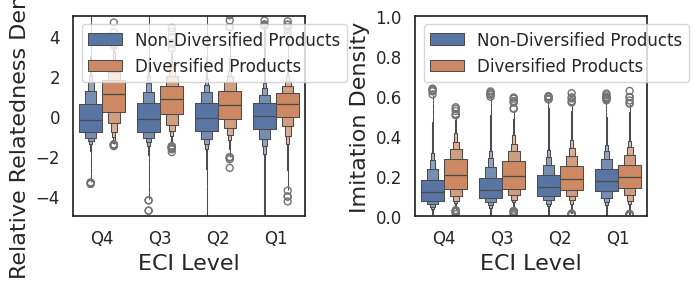

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the data for the year >= 2015
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year'] >= 2015]

# Create the 1x2 grid
fig, axes = plt.subplots(1, 2, figsize=(7, 3), sharey=False)

# First plot - Relative Relatedness Density
sns.boxenplot(
    data=temp_Regression_df,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0]
)
axes[0].set_xlabel("ECI Level", fontsize=16)
axes[0].set_ylabel("Relative Relatedness Density", fontsize=16)
axes[0].legend(title=None, loc="upper left", fontsize=12)
axes[0].tick_params(axis='both', which='major', labelsize=12)
axes[0].set_ylim(-5, 5)

# Second plot - Imitation Density
sns.boxenplot(
    data=temp_Regression_df,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[1]
)
axes[1].set_xlabel("ECI Level", fontsize=16)
axes[1].set_ylabel("Imitation Density", fontsize=16)
axes[1].legend(title=None, loc="upper left", fontsize=12)
axes[1].tick_params(axis='both', which='major', labelsize=12)
axes[1].set_ylim(0, 1)


# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
12%2

0

<ipython-input-342-6bc007a8e123>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
<ipython-input-342-6bc007a8e123>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)
<ipython-input-342-6bc007a8e123>:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavio

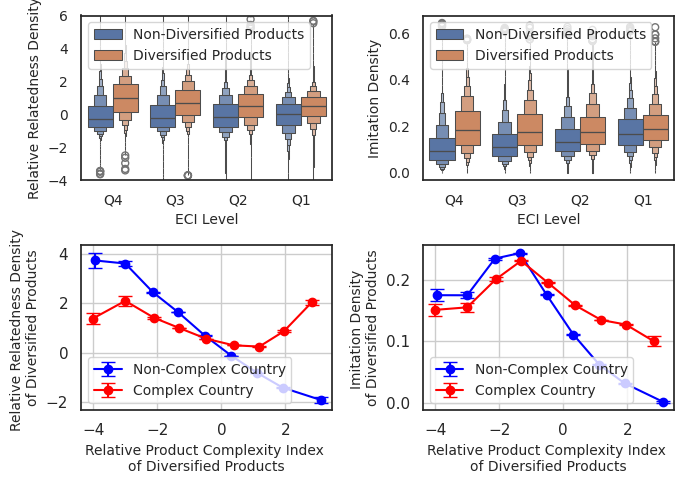

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Filter the data for the year >= 2015
temp_Regression_df1 = Regression_df.copy()
temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] >= 1962]
#temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] % 2 == 0]

# Boxen plot data preparation
temp_Regression_df2 = Regression_df.copy()
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] >= 1962]
#temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] % 2 == 0]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex = temp_Regression_df2[temp_Regression_df2['eci'] < 0]
complex_countries = temp_Regression_df2[temp_Regression_df2['eci'] >= 0]

# Binning Relative PCI for aggregation
bins = np.linspace(temp_Regression_df2['Relative_pci'].min(), temp_Regression_df2['Relative_pci'].max(), 10)
non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)

# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('pci_bin').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_stats = aggregate_density(non_complex)
complex_stats = aggregate_density(complex_countries)

# Create 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(7, 5), sharey=False)

# First panel: Relative Relatedness Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 0]
)
axes[0, 0].set_xlabel("ECI Level", fontsize=10)
axes[0, 0].set_ylabel("Relative Relatedness Density", fontsize=10)
axes[0, 0].legend(title=None, loc="upper left", fontsize=10)
axes[0, 0].tick_params(axis='both', which='major', labelsize=10)
axes[0, 0].set_ylim(-4, 6)

# Second panel: Imitation Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 1]
)
axes[0, 1].set_xlabel("ECI Level", fontsize=10)
axes[0, 1].set_ylabel("Imitation Density", fontsize=10)
axes[0, 1].legend(title=None, loc="upper left", fontsize=10)
axes[0, 1].tick_params(axis='both', which='major', labelsize=10)
#axes[0, 1].set_ylim(0, 1)

# Third panel: Relative Relatedness Density vs Relative PCI (Line plot)
axes[1, 0].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_relative_relatedness'],
    yerr=non_complex_stats['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1, 0].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_relative_relatedness'],
    yerr=complex_stats['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1, 0].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 0].set_ylabel("Relative Relatedness Density \nof Diversified Products", fontsize=10)
axes[1, 0].legend(loc = 'best',fontsize=10)
axes[1, 0].grid(True)

# Fourth panel: Imitation Density vs Relative Product Complexity Index (Line plot)
axes[1, 1].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_imitation_density'],
    yerr=non_complex_stats['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1, 1].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_imitation_density'],
    yerr=complex_stats['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1, 1].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 1].set_ylabel("Imitation Density \nof Diversified Products", fontsize=10)
axes[1, 1].legend(fontsize=10)
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
non_complex_stats['mean_relative_relatedness']

,mean_relative_relatedness
pci_bin,
"(-4.537, -3.642]",3.738003
"(-3.642, -2.748]",3.611737
"(-2.748, -1.853]",2.442332
"(-1.853, -0.958]",1.642462
"(-0.958, -0.0633]",0.691547
"(-0.0633, 0.832]",-0.131031
"(0.832, 1.726]",-0.827254
"(1.726, 2.621]",-1.421866
"(2.621, 3.516]",-1.922471


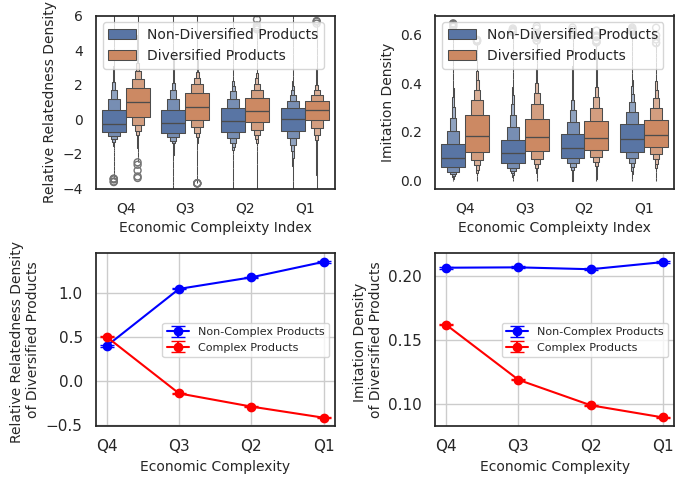

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Filter the data for the year >= 2015
temp_Regression_df1 = Regression_df.copy()
temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] >= 1962]
#temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] % 2 == 0]

# Boxen plot data preparation
temp_Regression_df2 = Regression_df.copy()
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] >= 1962]
#temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] % 2 == 0]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex_df = temp_Regression_df2[temp_Regression_df2['Relative_pci'] < 0]
complex_df = temp_Regression_df2[temp_Regression_df2['Relative_pci'] >= 0]

# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('eci_quantile').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_products = aggregate_density(non_complex_df)
complex_products = aggregate_density(complex_df)

# Create 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(7, 5), sharey=False)

# First panel: Relative Relatedness Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 0]
)
axes[0, 0].set_xlabel("Economic Compleixty Index", fontsize=10)
axes[0, 0].set_ylabel("Relative Relatedness Density", fontsize=10)
axes[0, 0].legend(title=None, loc="upper left", fontsize=10)
axes[0, 0].tick_params(axis='both', which='major', labelsize=10)
axes[0, 0].set_ylim(-4, 6)

# Second panel: Imitation Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 1]
)
axes[0, 1].set_xlabel("Economic Compleixty Index", fontsize=10)
axes[0, 1].set_ylabel("Imitation Density", fontsize=10)
axes[0, 1].legend(title=None, loc="upper left", fontsize=10)
axes[0, 1].tick_params(axis='both', which='major', labelsize=10)
#axes[0, 1].set_ylim(0, 1)

# Third panel: Relative Relatedness Density vs Relative PCI (Line plot)
axes[1, 0].errorbar(
    ['Q4','Q3','Q2','Q1'],
    non_complex_products['mean_relative_relatedness'],
    yerr=non_complex_products['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Products"
)
axes[1, 0].errorbar(
    ['Q4','Q3','Q2','Q1'],
    complex_products['mean_relative_relatedness'],
    yerr=complex_products['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Products"
)
axes[1, 0].set_xlabel("Economic Complexity", fontsize=10)
axes[1, 0].set_ylabel("Relative Relatedness Density \nof Diversified Products", fontsize=10)
axes[1, 0].legend(loc = 'best',fontsize=8)
axes[1, 0].grid(True)

# Fourth panel: Imitation Density vs Relative Product Complexity Index (Line plot)
axes[1, 1].errorbar(
    ['Q4','Q3','Q2','Q1'],
    non_complex_products['mean_imitation_density'],
    yerr=non_complex_products['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Products"
)
axes[1, 1].errorbar(
    ['Q4','Q3','Q2','Q1'],
    complex_products['mean_imitation_density'],
    yerr=complex_products['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Products"
)
axes[1, 1].set_xlabel("Economic Complexity", fontsize=10)
axes[1, 1].set_ylabel("Imitation Density \nof Diversified Products", fontsize=10)
axes[1, 1].legend(fontsize=8)
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


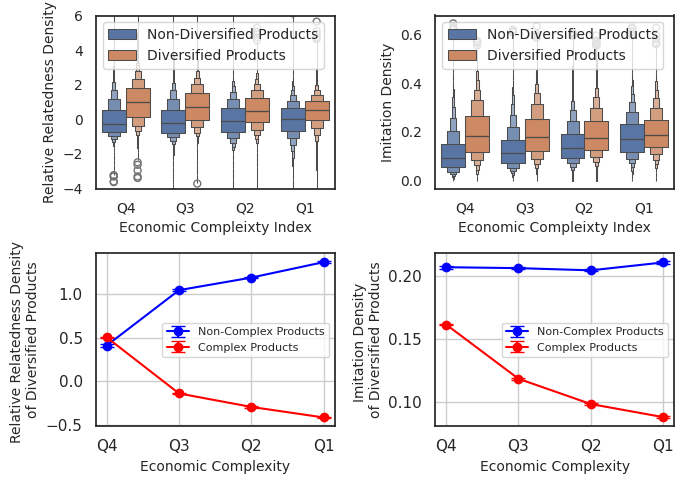

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Filter the data for the year >= 2015
temp_Regression_df1 = Regression_df.copy()
temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] >= 1962]
temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] % 2 == 0]

# Boxen plot data preparation
temp_Regression_df2 = Regression_df.copy()
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] >= 1962]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] % 2 == 0]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex_df = temp_Regression_df2[temp_Regression_df2['Relative_pci'] < 0]
complex_df = temp_Regression_df2[temp_Regression_df2['Relative_pci'] >= 0]



# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('eci_quantile').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_products = aggregate_density(non_complex_df)
complex_products = aggregate_density(complex_df)

# Create 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(7, 5), sharey=False)

# First panel: Relative Relatedness Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 0]
)
axes[0, 0].set_xlabel("Economic Compleixty Index", fontsize=10)
axes[0, 0].set_ylabel("Relative Relatedness Density", fontsize=10)
axes[0, 0].legend(title=None, loc="upper left", fontsize=10)
axes[0, 0].tick_params(axis='both', which='major', labelsize=10)
axes[0, 0].set_ylim(-4, 6)

# Second panel: Imitation Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 1]
)
axes[0, 1].set_xlabel("Economic Compleixty Index", fontsize=10)
axes[0, 1].set_ylabel("Imitation Density", fontsize=10)
axes[0, 1].legend(title=None, loc="upper left", fontsize=10)
axes[0, 1].tick_params(axis='both', which='major', labelsize=10)
#axes[0, 1].set_ylim(0, 1)

# Third panel: Relative Relatedness Density vs Relative PCI (Line plot)
axes[1, 0].errorbar(
    ['Q4','Q3','Q2','Q1'],
    non_complex_products['mean_relative_relatedness'],
    yerr=non_complex_products['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Products"
)
axes[1, 0].errorbar(
    ['Q4','Q3','Q2','Q1'],
    complex_products['mean_relative_relatedness'],
    yerr=complex_products['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Products"
)
axes[1, 0].set_xlabel("Economic Complexity", fontsize=10)
axes[1, 0].set_ylabel("Relative Relatedness Density \nof Diversified Products", fontsize=10)
axes[1, 0].legend(loc = 'best',fontsize=8)
axes[1, 0].grid(True)

# Fourth panel: Imitation Density vs Relative Product Complexity Index (Line plot)
axes[1, 1].errorbar(
    ['Q4','Q3','Q2','Q1'],
    non_complex_products['mean_imitation_density'],
    yerr=non_complex_products['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Products"
)
axes[1, 1].errorbar(
    ['Q4','Q3','Q2','Q1'],
    complex_products['mean_imitation_density'],
    yerr=complex_products['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Products"
)
axes[1, 1].set_xlabel("Economic Complexity", fontsize=10)
axes[1, 1].set_ylabel("Imitation Density \nof Diversified Products", fontsize=10)
axes[1, 1].legend(fontsize=8)
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
np.mean(temp_Regression_df2[(temp_Regression_df2['eci_quantile']=='Q1') & (temp_Regression_df['Relative_pci']>=0)]['imitation_density_4'])

<ipython-input-346-017148dae74a>:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  np.mean(temp_Regression_df2[(temp_Regression_df2['eci_quantile']=='Q1') & (temp_Regression_df['Relative_pci']>=0)]['imitation_density_4'])


0.1807119891860691

In [ ]:
non_complex_df[non_complex_df['eci_quantile']=='Q1'].describe()

,year,binary_rca,relatedness_density,Relative_relatedness_density,imitation_density,Relative_imitation_density,Relative_pci,eci,rnna,pop,...,rgdpe_per_capita,imitation_density_2,imitation_density_3,imitation_density_4,Relative_imitation_density_2,Relative_imitation_density_3,Relative_imitation_density_4,imitation_density_4_dist,log_rnna,log_pop
count,8056.000000,8056.0,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8.056000e+03,8056.000000,...,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000,8056.000000
mean,1990.938183,1.0,0.286352,0.408823,0.224868,0.613024,-0.711339,1.236606,4.773807e+06,43.699570,...,23533.554091,0.169827,0.243741,0.207209,0.713479,0.313774,0.686624,0.146735,14.109834,2.841772
std,15.899846,0.0,0.099358,1.128442,0.093251,1.179564,0.521760,0.453166,9.559693e+06,116.228013,...,14135.346700,0.083373,0.099476,0.091369,1.107410,1.124904,1.205461,0.104027,1.738834,1.264497
min,1962.000000,1.0,0.000000,-13.615145,0.000000,-2.525989,-4.258698,0.551130,9.574159e+03,1.019899,...,889.500284,0.000000,0.000000,0.000000,-2.035773,-2.857128,-2.523875,0.000000,9.166927,0.703047
25%,1978.000000,1.0,0.218998,-0.161002,0.159477,-0.218787,-1.075527,0.838510,4.586232e+05,5.183878,...,12557.522759,0.109219,0.174087,0.142814,-0.071770,-0.477320,-0.159152,0.067644,13.035987,1.821945
50%,1992.000000,1.0,0.287468,0.465473,0.219187,0.536613,-0.613872,1.179461,1.297719e+06,10.237299,...,21842.441842,0.155283,0.240933,0.198999,0.574164,0.289636,0.581100,0.127359,14.076120,2.419239
75%,2004.000000,1.0,0.357007,1.076732,0.286412,1.440877,-0.271572,1.552579,4.819562e+06,46.931015,...,32298.872825,0.219473,0.309827,0.265609,1.399444,1.066565,1.509874,0.208607,15.388194,3.869763
max,2018.000000,1.0,0.629693,7.129283,0.626180,5.095428,-0.000057,2.769452,9.132246e+07,1427.647786,...,90300.436944,0.573345,0.622682,0.651280,5.858591,4.292664,5.634551,0.648719,18.329907,7.264484


In [ ]:
non_complex_products

,mean_relative_relatedness,sem_relative_relatedness,mean_imitation_density,sem_imitation_density,mean_pci
eci_quantile,,,,,
Q1,0.408823,0.012572,0.207209,0.001018,-0.711339
Q2,1.038685,0.009483,0.206484,0.000971,-0.856718
Q3,1.181720,0.008580,0.204738,0.000845,-0.956979
Q4,1.357646,0.011503,0.210986,0.001061,-1.108681


In [ ]:
complex_products

,mean_relative_relatedness,sem_relative_relatedness,mean_imitation_density,sem_imitation_density,mean_pci
eci_quantile,,,,,
Q1,0.501905,0.007293,0.161805,0.000572,0.832428
Q2,-0.136509,0.008556,0.118822,0.000705,0.624974
Q3,-0.289853,0.007755,0.098775,0.000696,0.518217
Q4,-0.409689,0.010407,0.088415,0.001011,0.510260


In [ ]:
complex_products['mean_imitation_density']

,mean_imitation_density
eci_quantile,
Q1,0.161805
Q2,0.118822
Q3,0.098775
Q4,0.088415


In [ ]:
complex_products['mean_imitation_density']

,mean_imitation_density
eci_quantile,
Q1,0.161805
Q2,0.118822
Q3,0.098775
Q4,0.088415


In [ ]:
Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.703386
imitation_density_4,0.703386,1.000000


In [ ]:
temp_Regression_df = Regression_df.copy()
#temp_Regression_df = temp_Regression_df[temp_Regression_df['year']==2016]
#temp_Regression_df = temp_Regression_df[temp_Regression_df['year']%2 == 0]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]
#temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_pci']>=0]
#temp_Regression_df = temp_Regression_df[(temp_Regression_df['Relative_pci']<=0) | (temp_Regression_df['Relative_pci']>=-2)]
temp_Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.677793
imitation_density_4,0.677793,1.000000


In [ ]:
temp_Regression_df = Regression_df.copy()
#temp_Regression_df = temp_Regression_df[temp_Regression_df['year']==2016]
#temp_Regression_df = temp_Regression_df[temp_Regression_df['year']%2 == 0]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]
#temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_pci']>=0]
#temp_Regression_df = temp_Regression_df[(temp_Regression_df['Relative_pci']<=0) | (temp_Regression_df['Relative_pci']>=-2)]
temp_Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.677793
imitation_density_4,0.677793,1.000000


In [ ]:
alpha = 2

temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year']%2 == 0]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]
temp_Regression_df = temp_Regression_df[(temp_Regression_df['Relative_pci']<=-alpha) | (temp_Regression_df['Relative_pci']>=alpha)]
temp_Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.515945
imitation_density_4,0.515945,1.000000


In [ ]:
# Re-import required libraries
import pandas as pd
from scipy.stats import ttest_ind

# Assuming `Regression_df` has been loaded in your environment
# Filter data for Diversified and Non-Diversified groups
diversified_group = Regression_df[Regression_df['Diversified'] == 'Diversified Products']
non_diversified_group = Regression_df[Regression_df['Diversified'] == 'Non-Diversified Products']

# Perform t-tests for Relative_relatedness_density
t_test_relatedness = ttest_ind(
    diversified_group['Relative_relatedness_density'].dropna(),
    non_diversified_group['Relative_relatedness_density'].dropna(),
    equal_var=False  # Welch's t-test, assuming unequal variance
)

# Perform t-tests for imitation_density_4
t_test_imitation = ttest_ind(
    diversified_group['imitation_density_4'].dropna(),
    non_diversified_group['imitation_density_4'].dropna(),
    equal_var=False  # Welch's t-test, assuming unequal variance
)

t_test_relatedness, t_test_imitation


(TtestResult(statistic=221.89349209763208, pvalue=0.0, df=133483.1725683872),
 TtestResult(statistic=207.20698350316582, pvalue=0.0, df=132585.16716665472))

In [ ]:
# Add a new column for imitation_group
Regression_df['imitation_group'] = Regression_df.groupby(['year', 'country'])['imitation_density_4'] \
    .transform(lambda x: ['high' if val >= x.median() else 'low' for val in x])

#Regression_df['Relative_relatedness_density_group'] = Regression_df.groupby(['year', 'country'])['Relative_relatedness_density'] \
#    .transform(lambda x: ['high' if val >= x.median() else 'low' for val in x])


In [ ]:
Regression_df['Relative_relatedness_density_group'] = Regression_df['Relative_relatedness_density'].apply(lambda x: 'high' if x >= 0 else 'low')

In [ ]:
base_line = len(Regression_df[Regression_df['binary_rca']==1])/len(Regression_df)

In [ ]:
p1_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='high')]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='high')])
p2_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='low')]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='low')])
p3_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='high')]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='high')])
p4_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='low')]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='low')])

p1_r, p2_r, p3_r , p4_r

(0.0685503969685537,
 0.026983858891307846,
 0.04508056571269916,
 0.010543220712211065)

<ipython-input-361-ff6a92e2a7df>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities, x='Group', y='Probability', palette='coolwarm')


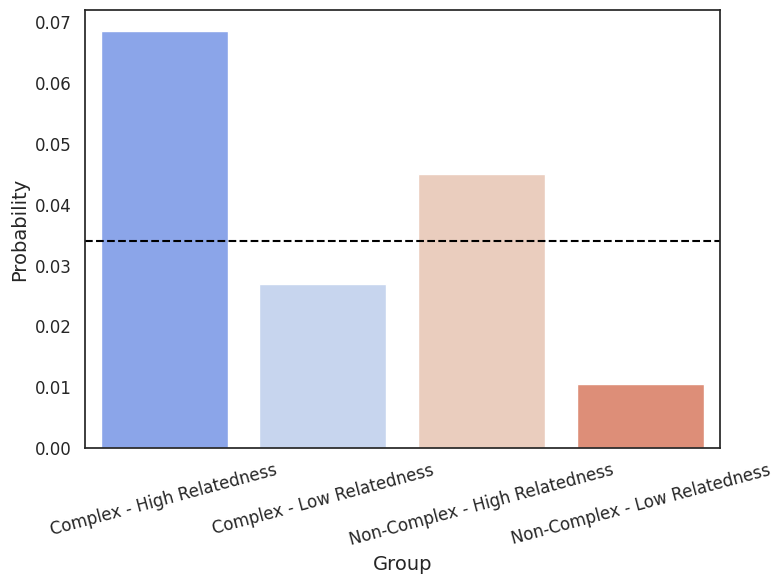

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Create a DataFrame for probabilities
probabilities = pd.DataFrame({
    'Group': ['Complex - High Relatedness', 'Complex - Low Relatedness',
              'Non-Complex - High Relatedness', 'Non-Complex - Low Relatedness'],
    'Probability': [p1_r, p2_r, p3_r, p4_r]
})

# Create the bar plot
plt.figure(figsize=(8, 6))
sns.barplot(data=probabilities, x='Group', y='Probability', palette='coolwarm')

# Customize the plot
plt.xlabel("Group", fontsize=14)
plt.ylabel("Probability", fontsize=14)
plt.xticks(rotation=15, fontsize=12)
plt.yticks(fontsize=12)
plt.axhline(y = base_line, color='black', linestyle='--')

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
p1_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['imitation_group']=='high')]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['imitation_group']=='high')])
p2_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['imitation_group']=='low')]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['imitation_group']=='low')])
p3_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['imitation_group']=='high')]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['imitation_group']=='high')])
p4_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['imitation_group']=='low')]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['imitation_group']=='low')])

p1_i, p2_i, p3_i , p4_i

(0.062179702028283525,
 0.032598757329844,
 0.04017979380101771,
 0.010019943925250567)

<ipython-input-363-81bed2368d4b>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities, x='Group', y='Probability', palette='coolwarm')


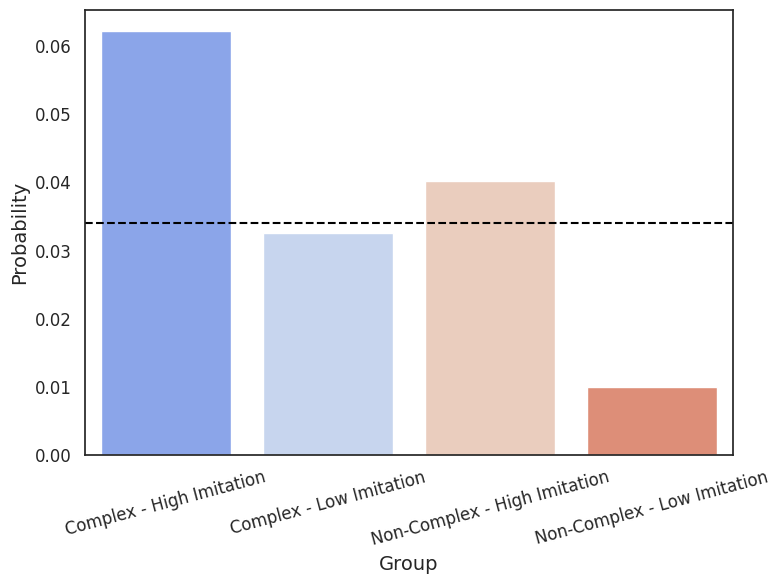

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Create a DataFrame for probabilities
probabilities = pd.DataFrame({
    'Group': ['Complex - High Imitation', 'Complex - Low Imitation',
              'Non-Complex - High Imitation', 'Non-Complex - Low Imitation'],
    'Probability': [p1_i, p2_i, p3_i, p4_i]
})

# Create the bar plot
plt.figure(figsize=(8, 6))
sns.barplot(data=probabilities, x='Group', y='Probability', palette='coolwarm')

# Customize the plot
plt.xlabel("Group", fontsize=14)
plt.ylabel("Probability", fontsize=14)
plt.xticks(rotation=15, fontsize=12)
plt.yticks(fontsize=12)
plt.axhline(y = base_line, color='black', linestyle='--')

# Show the plot
plt.tight_layout()
plt.show()


<ipython-input-364-b0344621fc37>:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities_relatedness, x='Group', y='Probability', palette='coolwarm', ax=axes[0])
<ipython-input-364-b0344621fc37>:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90, fontsize=12)
<ipython-input-364-b0344621fc37>:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities_imitation, x='Group', y='Probability', palette='coolwarm', ax=axes[1])
<ipython-input-364-b0344621fc37>:33: UserWarning: set_ticklabels() should only be used with a fixed number

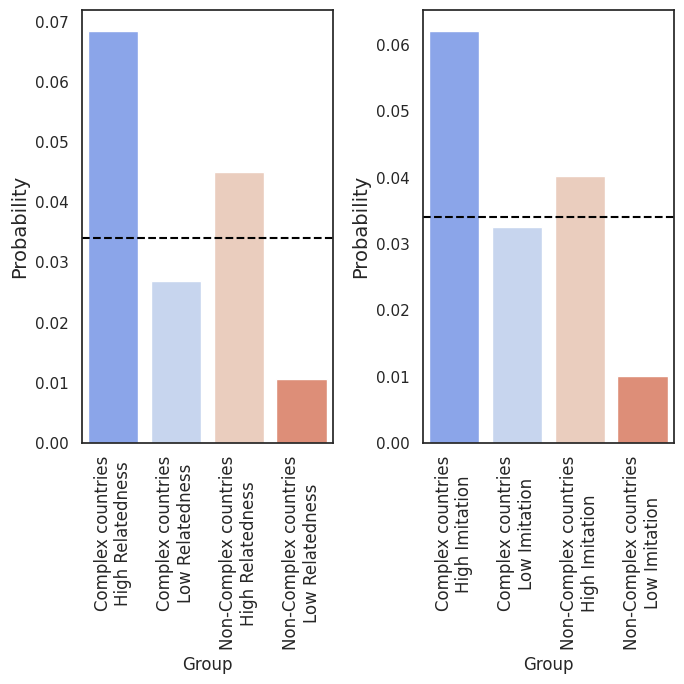

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Data for Relatedness Density
probabilities_relatedness = pd.DataFrame({
    'Group': ['Complex countries\nHigh Relatedness', 'Complex countries\nLow Relatedness',
              'Non-Complex countries\nHigh Relatedness', 'Non-Complex countries\nLow Relatedness'],
    'Probability': [p1_r, p2_r, p3_r, p4_r]
})

# Data for Imitation Density
probabilities_imitation = pd.DataFrame({
    'Group': ['Complex countries\nHigh Imitation', 'Complex countries\nLow Imitation',
              'Non-Complex countries\nHigh Imitation', 'Non-Complex countries\nLow Imitation'],
    'Probability': [p1_i, p2_i, p3_i, p4_i]
})

# Create the 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(7, 7))

# First plot - Relatedness Density
sns.barplot(data=probabilities_relatedness, x='Group', y='Probability', palette='coolwarm', ax=axes[0])
#axes[0].set_xlabel("Group", fontsize=14)
axes[0].set_ylabel("Probability", fontsize=14)
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90, fontsize=12)
axes[0].axhline(y=base_line, color='black', linestyle='--')

# Second plot - Imitation Density
sns.barplot(data=probabilities_imitation, x='Group', y='Probability', palette='coolwarm', ax=axes[1])
#axes[1].set_xlabel("Group", fontsize=14)
axes[1].set_ylabel("Probability", fontsize=14)
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, fontsize=12)
axes[1].axhline(y=base_line, color='black', linestyle='--')

# Adjust layout and show
plt.tight_layout()
plt.show()


In [ ]:
p1_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='high') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='high') & (Regression_df['Relative_pci']>=0)])
p2_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='low') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['Relative_relatedness_density_group']=='low') & (Regression_df['Relative_pci']>=0)])
p3_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='high') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='high') & (Regression_df['Relative_pci']>=0)])
p4_r = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='low') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['Relative_relatedness_density_group']=='low') & (Regression_df['Relative_pci']>=0)])

p1_r, p2_r, p3_r , p4_r

(0.07728803231918047,
 0.029871152531519604,
 0.03520008758964253,
 0.009567290535099372)

In [ ]:
p1_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['imitation_group']=='high') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['imitation_group']=='high') & (Regression_df['Relative_pci']>=0)])
p2_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']>=0) & (Regression_df['imitation_group']=='low') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']>=0) & (Regression_df['imitation_group']=='low') & (Regression_df['Relative_pci']>=0)])
p3_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['imitation_group']=='high') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['imitation_group']=='high') & (Regression_df['Relative_pci']>=0)])
p4_i = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['eci']<0) & (Regression_df['imitation_group']=='low') & (Regression_df['Relative_pci']>=0)]) / len(Regression_df[(Regression_df['eci']<0) & (Regression_df['imitation_group']=='low') & (Regression_df['Relative_pci']>=0)])

p1_i, p2_i, p3_i , p4_i

(0.0700442413743124,
 0.03663976537424244,
 0.023579887825893348,
 0.008279203225623059)

In [ ]:
base_line = len(Regression_df[(Regression_df['binary_rca']==1) & (Regression_df['Relative_pci']>=0)])/len(Regression_df[Regression_df['Relative_pci']>=0])

<ipython-input-368-dfb86b2348d7>:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities_relatedness, x='Group', y='Probability', palette='coolwarm', ax=axes[0])
<ipython-input-368-dfb86b2348d7>:25: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=0, fontsize=12)
<ipython-input-368-dfb86b2348d7>:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=probabilities_imitation, x='Group', y='Probability', palette='coolwarm', ax=axes[1])
<ipython-input-368-dfb86b2348d7>:32: UserWarning: set_ticklabels() should only be used with a fixed number 

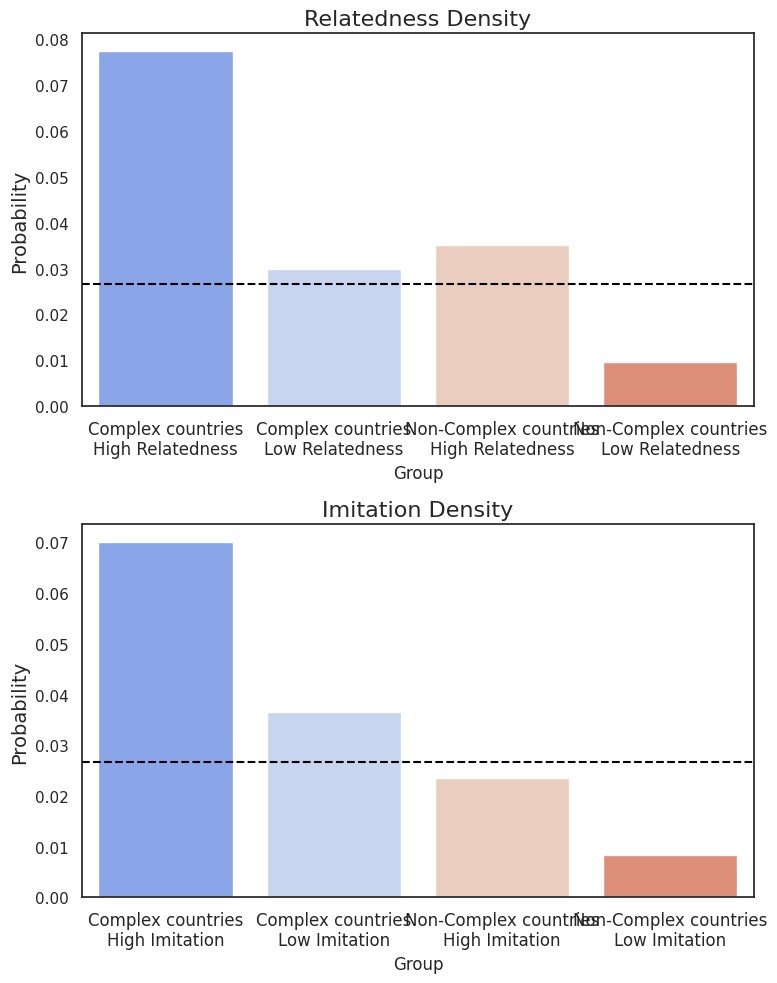

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Data for Relatedness Density
probabilities_relatedness = pd.DataFrame({
    'Group': ['Complex countries\nHigh Relatedness', 'Complex countries\nLow Relatedness',
              'Non-Complex countries\nHigh Relatedness', 'Non-Complex countries\nLow Relatedness'],
    'Probability': [p1_r, p2_r, p3_r, p4_r]
})

# Data for Imitation Density
probabilities_imitation = pd.DataFrame({
    'Group': ['Complex countries\nHigh Imitation', 'Complex countries\nLow Imitation',
              'Non-Complex countries\nHigh Imitation', 'Non-Complex countries\nLow Imitation'],
    'Probability': [p1_i, p2_i, p3_i, p4_i]
})

# Create the 2x1 panel
fig, axes = plt.subplots(2, 1, figsize=(8, 10))

# First plot - Relatedness Density
sns.barplot(data=probabilities_relatedness, x='Group', y='Probability', palette='coolwarm', ax=axes[0])
axes[0].set_ylabel("Probability", fontsize=14)
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=0, fontsize=12)
axes[0].axhline(y=base_line, color='black', linestyle='--')
axes[0].set_title("Relatedness Density", fontsize=16)

# Second plot - Imitation Density
sns.barplot(data=probabilities_imitation, x='Group', y='Probability', palette='coolwarm', ax=axes[1])
axes[1].set_ylabel("Probability", fontsize=14)
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=0, fontsize=12)
axes[1].axhline(y=base_line, color='black', linestyle='--')
axes[1].set_title("Imitation Density", fontsize=16)

# Adjust layout and show
plt.tight_layout()
plt.show()


In [ ]:
len(temp_Regression_df)

2094

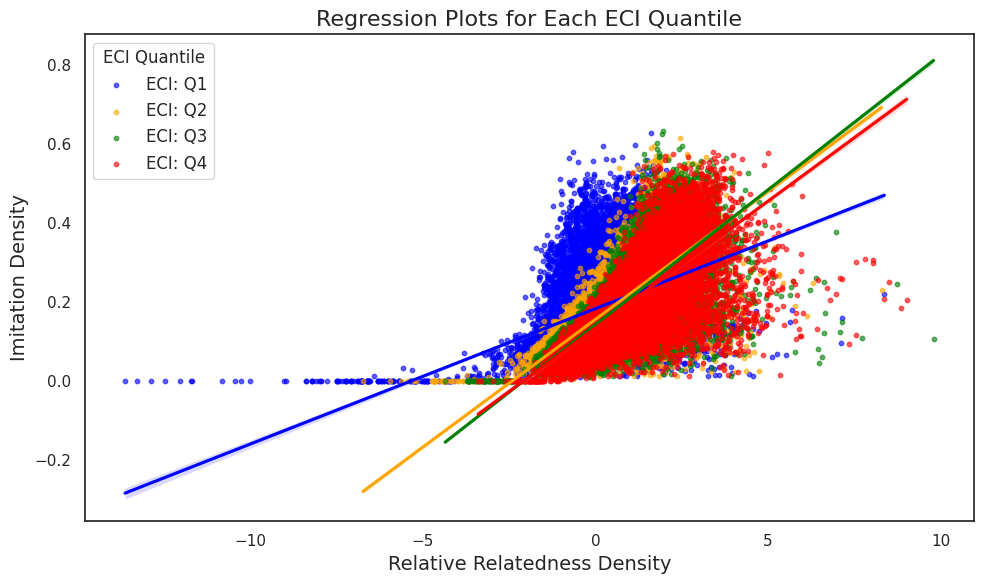

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define quantiles
quantiles = ['Q1', 'Q2', 'Q3', 'Q4']
colors = ['blue', 'orange', 'green', 'red']  # Different colors for each quantile

# Initialize figure
plt.figure(figsize=(10, 6))

# Loop through quantiles and plot
for quantile, color in zip(quantiles, colors):
    subset = Regression_df[(Regression_df['binary_rca'] == 1) & (Regression_df['eci_quantile'] == quantile)]
    sns.regplot(
        data=subset,
        x='Relative_relatedness_density',
        y='imitation_density',
        scatter_kws={'alpha': 0.6, 's': 10, 'color': color},
        line_kws={'color': color},
        label=f'ECI: {quantile}'
    )

# Add legend and labels
plt.legend(title="ECI Quantile", fontsize=12)
plt.xlabel("Relative Relatedness Density", fontsize=14)
plt.ylabel("Imitation Density", fontsize=14)
plt.title("Regression Plots for Each ECI Quantile", fontsize=16)
plt.tight_layout()

# Show plot
plt.show()


### Correlation Check

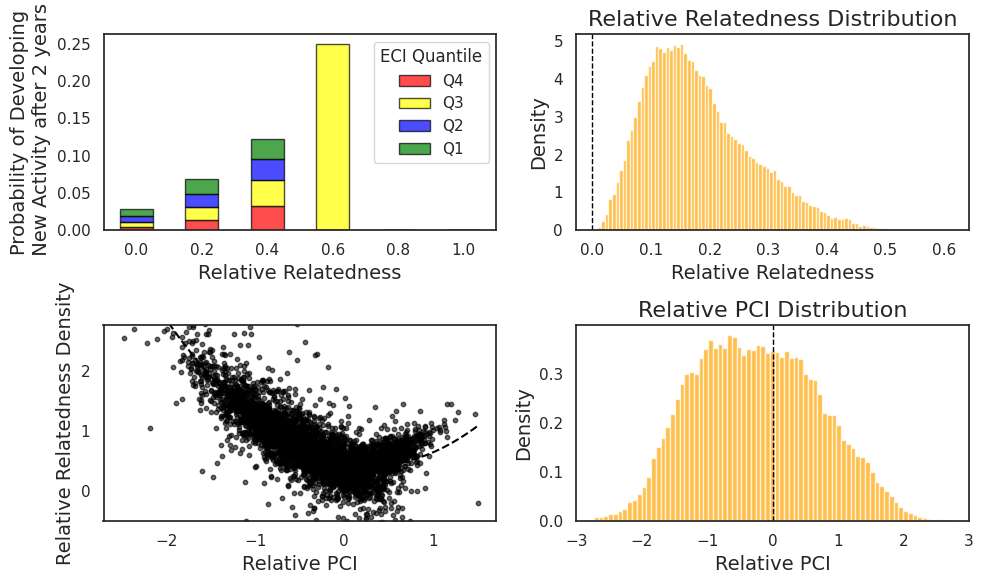

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


bins = [0, 0.2, 0.4 ,0.6 ,0.8 ,1]
temp_df = pd.DataFrame(np.zeros(shape=(4, len(bins))), columns=bins)
temp_df.index = ['Q4', 'Q3', 'Q2', 'Q1']

# Function to calculate ratios for each quartile
def calculate_ratios(Q, bins, years, temp_df):
    total_ratios = []
    for i in bins:
        # Set the upper bound based on bin value
        upper_bound = i + 0.2 if i == 1 else i + 0.2

        # Initialize total nominator and denominator for all years
        total_nominator = 0
        total_denominator = 0

        # Loop over each year to calculate cumulative nominator and denominator
        for year in years:
            temp_eci = eci[year].copy()
            temp_eci = pd.DataFrame(list(temp_eci), index=temp_eci.index, columns=['ECI'])

            # Define quartiles and labels
            labels = ['Q1', 'Q2', 'Q3', 'Q4']
            temp_eci['ECI_Level'] = pd.qcut(temp_eci['ECI'], q=4, labels=labels)

            # Dictionary for quartile indices
            Q_dict = {
                'Q1': temp_eci[temp_eci['ECI_Level'] == 'Q4'].index.tolist(),
                'Q2': temp_eci[temp_eci['ECI_Level'] == 'Q3'].index.tolist(),
                'Q3': temp_eci[temp_eci['ECI_Level'] == 'Q2'].index.tolist(),
                'Q4': temp_eci[temp_eci['ECI_Level'] == 'Q1'].index.tolist(),
            }

            # Calculate masks and accumulate nominator and denominator
            mask_nominator = ((Opportunity[year] * binary_rca[year + 2] * imitation_density_4[year]).loc[Q_dict[Q]] > i) & \
                             ((Opportunity[year] * binary_rca[year + 2] * imitation_density_4[year]).loc[Q_dict[Q]] <= upper_bound)
            total_nominator += mask_nominator.sum().sum()

            mask_denominator = ((Opportunity[year] * imitation_density_4[year]) > i) & \
                               ((Opportunity[year] * imitation_density_4[year]) <= upper_bound)
            total_denominator += mask_denominator.sum().sum()

        # Calculate ratio and add to the list
        ratio = total_nominator / total_denominator if total_denominator != 0 else np.nan
        total_ratios.append(ratio)

    temp_df.loc[Q] = total_ratios

# Define figure and axes for 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(14, 12))


# Apply the function to each quartile
years = range(1984, 2011)
for quartile in ['Q1', 'Q2', 'Q3', 'Q4']:
    calculate_ratios(quartile, bins, years, temp_df)

# Define colors for each quartile: Q1=green, Q2=blue, Q3=yellow, Q4=red
colors = ["red","yellow",'blue',"green"]

# Plot the stacked bar chart with specified colors
temp_df.T.plot(kind='bar', stacked=True, figsize=(10, 6), edgecolor='black', alpha=0.7, color=colors, ax = axes[0, 0])
axes[0, 0].set_xlabel("Relative Relatedness", fontsize=14)
axes[0, 0].set_ylabel("Probability of Developing\n New Activity after 2 years", fontsize=14)
#axes[0, 0].set_title("Stacked Bar Chart", fontsize=16)
axes[0, 0].legend(title="ECI Quantile")
axes[0, 0].tick_params(axis='x', rotation=0)

# Plot 2: Histogram (Relative Relatedness Density)
temp_list = []
for year in years:
    temp_df = binary_rca[year+2] * Opportunity[year] * imitation_density_4[year]
    temp_df = temp_df[temp_df != 0].values
    valid_values = temp_df[~np.isnan(temp_df)]
    temp_list.extend(list(valid_values))

axes[0, 1].hist(temp_list, density=True, bins=100, color='orange', alpha=0.7)
#axes[0, 1].set_xlim(-3, 3)
axes[0, 1].axvline(x=0, color='black', linestyle='dashed', linewidth=1)
axes[0, 1].set_xlabel("Relative Relatedness", fontsize=14)
axes[0, 1].set_ylabel("Density", fontsize=14)
axes[0, 1].set_title("Relative Relatedness Distribution", fontsize=16)

# Plot 3: Scatter Plot with Trendline
filtered_df = plot_df[['Relative PCI', 'Relative Relatedness']].dropna()
axes[1, 0].scatter(
    filtered_df['Relative PCI'], filtered_df['Relative Relatedness'],
    alpha=0.6, color='black', s=10
)
z = np.polyfit(filtered_df['Relative PCI'], filtered_df['Relative Relatedness'], 2)
p = np.poly1d(z)
trendline_x = np.linspace(filtered_df['Relative PCI'].min(), filtered_df['Relative PCI'].max(), 100)
axes[1, 0].plot(trendline_x, p(trendline_x), color='black', linestyle='--')
axes[1, 0].set_xlabel("Relative PCI", fontsize=14)
axes[1, 0].set_ylabel("Relative Relatedness Density", fontsize=14)
axes[1, 0].set_ylim(-0.5, 2.75)
#axes[1, 0].set_title("Scatter Plot with Trendline", fontsize=16)

# Plot 4: Histogram (Relative PCI)
temp_list = []
for year in years:
    temp_df = binary_rca[year+2] * Opportunity[year] * Relative_pci[year]
    temp_df = temp_df[temp_df != 0].values
    valid_values = temp_df[~np.isnan(temp_df)]
    temp_list.extend(list(valid_values))

axes[1, 1].hist(temp_list, density=True, bins=100, color='orange', alpha=0.7)
axes[1, 1].set_xlim(-3, 3)
axes[1, 1].axvline(x=0, color='black', linestyle='dashed', linewidth=1)
axes[1, 1].set_xlabel("Relative PCI", fontsize=14)
axes[1, 1].set_ylabel("Density", fontsize=14)
axes[1, 1].set_title("Relative PCI Distribution", fontsize=16)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [ ]:
Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.703386
imitation_density_4,0.703386,1.000000


In [ ]:
Regression_df.imitation_group

,imitation_group
2247,high
2248,high
2249,high
2250,high
2251,high
...,...
4735300,low
4735301,low
4735302,high
4735303,high


In [ ]:
len(Regression_df[Regression_df['binary_rca']==1]) / len(Regression_df)

0.03404525905822193

In [ ]:
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['eci']>=0]

In [ ]:
len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0])


0.04909186103203282

In [ ]:
p1 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='high')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='high')])

In [ ]:
p2 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='low')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='low')])

In [ ]:
p3 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='high')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='high')])

In [ ]:
p4 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='low')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='low')])

In [ ]:
# Rel Imi
# high high
# low high
# high low
# low low

p1, p2, p3, p4

(0.08127477889600487,
 0.04055406791961761,
 0.0693390086554997,
 0.027638138381624443)

In [ ]:
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['eci']<0]

In [ ]:
len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0])

0.011948102574532635

In [ ]:
p1 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='high')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='high')])
p2 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='low')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='high') & (temp_Regression_df['Relative_relatedness_density_group']=='low')])
p3 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='high')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='high')])
p4 = len(temp_Regression_df[(temp_Regression_df['binary_rca']==1) & (temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='low')]) / len(temp_Regression_df[(temp_Regression_df['Relative_pci']>=0) & (temp_Regression_df['imitation_group']=='low') & (temp_Regression_df['Relative_relatedness_density_group']=='low')])

In [ ]:
# Rel Imi
# high high
# low high
# high low
# low low

p1, p2, p3, p4

(0.03664233576642336,
 0.016882915537307606,
 0.025105823967304042,
 0.00801820312102019)

In [ ]:
# Filter data for specific conditions
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['eci'] >= 0]
temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_relatedness_density_group'] == 'low']

print(len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0]))

# Compute probabilities
p1 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')])

p2 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')])

p3 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')])

p4 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')])

# Print the results
print(f"p1: {p1}")
print(f"p2: {p2}")
print(f"p3: {p3}")
print(f"p4: {p4}")

p1_com = p1
p2_com = p3
p_base_com = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0])

0.029871152531519604
p1: 0.04055406791961761
p2: 0.04055406791961761
p3: 0.027638138381624443
p4: 0.027638138381624443


In [ ]:
len(temp_Regression_df)

751931

In [ ]:
# Filter data for specific conditions
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['eci'] < 0]
temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_relatedness_density_group'] == 'low']

print(len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0]))

# Compute probabilities
p1 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')])

p2 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'high')])

p3 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')])

p4 = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) &
                            (temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')]) / \
     len(temp_Regression_df[(temp_Regression_df['Relative_pci'] >= 0) &
                            (temp_Regression_df['imitation_group'] == 'low')])

# Print the results
print(f"p1: {p1}")
print(f"p2: {p2}")
print(f"p3: {p3}")
print(f"p4: {p4}")

p1_ncom = p1
p2_ncom = p3
p_base_ncom = len(temp_Regression_df[(temp_Regression_df['binary_rca'] == 1) & (temp_Regression_df['Relative_pci'] >= 0)]) / len(temp_Regression_df[temp_Regression_df['Relative_pci'] >= 0])

0.009567290535099372
p1: 0.016882915537307606
p2: 0.016882915537307606
p3: 0.00801820312102019
p4: 0.00801820312102019


In [ ]:
len(temp_Regression_df)

1278357

In [ ]:
temp_Regression_df

,country,product,year,binary_rca,relatedness_density,Relative_relatedness_density,imitation_density,Relative_imitation_density,Relative_pci,eci,...,imitation_density_4,Relative_imitation_density_2,Relative_imitation_density_3,Relative_imitation_density_4,imitation_density_4_dist,log_rnna,log_pop,Diversified,imitation_group,Relative_relatedness_density_group
2253,ARG,0223,1962,0,0.059081,-0.049832,0.058089,-0.399865,0.502616,-0.546232,...,0.041225,-0.684234,-0.053867,-0.482726,0.013503,13.377290,3.100595,Non-Diversified Products,low,low
2270,ARG,0488,1962,0,0.056535,-0.111688,0.065216,-0.288488,0.267129,-0.546232,...,0.044770,-0.580758,-0.069961,-0.426757,0.014594,13.377290,3.100595,Non-Diversified Products,low,low
2295,ARG,0730,1962,0,0.046243,-0.361712,0.053108,-0.477713,0.530017,-0.546232,...,0.040331,-0.593463,-0.209788,-0.496843,0.013258,13.377290,3.100595,Non-Diversified Products,low,low
2301,ARG,0ict,1962,0,0.000000,-1.485150,0.000000,-1.307630,-0.503944,-0.546232,...,0.000000,-1.059728,-2.004442,-1.133662,0.000000,13.377290,3.100595,Non-Diversified Products,low,low
2304,ARG,1122,1962,1,0.059313,-0.044189,0.088028,0.067996,0.111321,-0.546232,...,0.063270,-0.370672,0.449727,-0.134638,0.021543,13.377290,3.100595,Diversified Products,high,low
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4735292,ZWE,8994,2018,0,0.044732,-0.941161,0.052338,-1.092329,-0.261752,-1.086484,...,0.048980,-0.946443,-1.302696,-0.938398,0.016541,10.977701,2.736884,Non-Diversified Products,low,low
4735293,ZWE,8996,2018,0,0.042404,-1.033531,0.068481,-0.898915,1.360679,-1.086484,...,0.054692,-0.587027,-0.905433,-0.870445,0.015224,10.977701,2.736884,Non-Diversified Products,low,low
4735294,ZWE,8997,2018,0,0.066180,-0.090139,0.141333,-0.026064,-0.618315,-1.086484,...,0.125820,-0.164691,-0.122502,-0.024208,0.054483,10.977701,2.736884,Non-Diversified Products,high,low
4735295,ZWE,8998,2018,0,0.047764,-0.820880,0.081853,-0.738708,0.284219,-1.086484,...,0.063273,-0.866916,-0.702091,-0.768345,0.020444,10.977701,2.736884,Non-Diversified Products,low,low


<ipython-input-393-6bc007a8e123>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
<ipython-input-393-6bc007a8e123>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)
<ipython-input-393-6bc007a8e123>:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavio

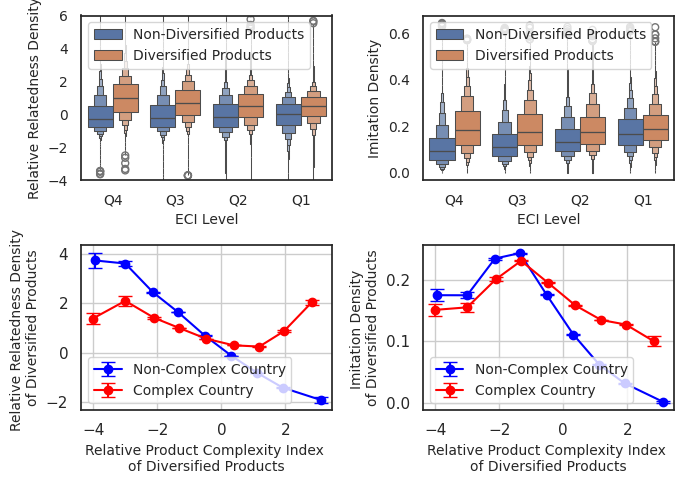

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Filter the data for the year >= 2015
temp_Regression_df1 = Regression_df.copy()
temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] >= 1962]
#temp_Regression_df1 = temp_Regression_df1[temp_Regression_df1['year'] % 2 == 0]

# Boxen plot data preparation
temp_Regression_df2 = Regression_df.copy()
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] >= 1962]
#temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] % 2 == 0]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex = temp_Regression_df2[temp_Regression_df2['eci'] < 0]
complex_countries = temp_Regression_df2[temp_Regression_df2['eci'] >= 0]

# Binning Relative PCI for aggregation
bins = np.linspace(temp_Regression_df2['Relative_pci'].min(), temp_Regression_df2['Relative_pci'].max(), 10)
non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)

# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('pci_bin').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_stats = aggregate_density(non_complex)
complex_stats = aggregate_density(complex_countries)

# Create 2x2 panel
fig, axes = plt.subplots(2, 2, figsize=(7, 5), sharey=False)

# First panel: Relative Relatedness Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='Relative_relatedness_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 0]
)
axes[0, 0].set_xlabel("ECI Level", fontsize=10)
axes[0, 0].set_ylabel("Relative Relatedness Density", fontsize=10)
axes[0, 0].legend(title=None, loc="upper left", fontsize=10)
axes[0, 0].tick_params(axis='both', which='major', labelsize=10)
axes[0, 0].set_ylim(-4, 6)

# Second panel: Imitation Density (Boxen plot)
sns.boxenplot(
    data=temp_Regression_df1,
    x='eci_quantile',
    y='imitation_density',
    order=['Q4', 'Q3', 'Q2', 'Q1'],
    hue='Diversified',
    ax=axes[0, 1]
)
axes[0, 1].set_xlabel("ECI Level", fontsize=10)
axes[0, 1].set_ylabel("Imitation Density", fontsize=10)
axes[0, 1].legend(title=None, loc="upper left", fontsize=10)
axes[0, 1].tick_params(axis='both', which='major', labelsize=10)
#axes[0, 1].set_ylim(0, 1)

# Third panel: Relative Relatedness Density vs Relative PCI (Line plot)
axes[1, 0].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_relative_relatedness'],
    yerr=non_complex_stats['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1, 0].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_relative_relatedness'],
    yerr=complex_stats['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1, 0].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 0].set_ylabel("Relative Relatedness Density \nof Diversified Products", fontsize=10)
axes[1, 0].legend(loc = 'best',fontsize=10)
axes[1, 0].grid(True)

# Fourth panel: Imitation Density vs Relative Product Complexity Index (Line plot)
axes[1, 1].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_imitation_density'],
    yerr=non_complex_stats['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1, 1].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_imitation_density'],
    yerr=complex_stats['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1, 1].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 1].set_ylabel("Imitation Density \nof Diversified Products", fontsize=10)
axes[1, 1].legend(fontsize=10)
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
len(Regression_df)

3689383

<ipython-input-395-0efa25907103>:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
<ipython-input-395-0efa25907103>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)
<ipython-input-395-0efa25907103>:33: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavio

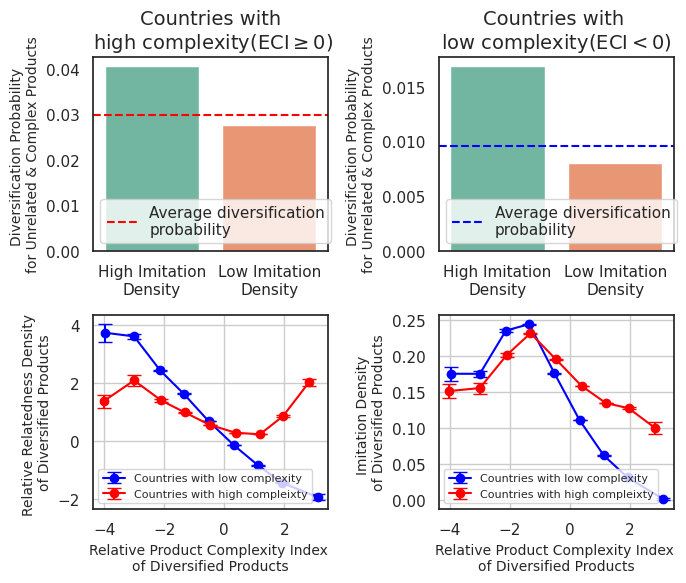

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Data Preparation for First Two Panels
temp_plot_df = pd.DataFrame()
temp_plot_df['probability'] = [p1_com, p2_com, p1_ncom, p2_ncom]
temp_plot_df['group'] = [
    'High Imitation\nDensity',
    'Low Imitation\nDensity'
] * 2
temp_plot_df['Country Type'] = ['Complex', 'Complex', 'Non-Complex', 'Non-Complex']

# Data Preparation for Last Two Panels
temp_Regression_df2 = Regression_df.copy()
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['year'] >= 1962]
temp_Regression_df2 = temp_Regression_df2[temp_Regression_df2['binary_rca'] == 1]

non_complex = temp_Regression_df2[temp_Regression_df2['eci'] < 0]
complex_countries = temp_Regression_df2[temp_Regression_df2['eci'] >= 0]

bins = np.linspace(
    temp_Regression_df2['Relative_pci'].min(),
    temp_Regression_df2['Relative_pci'].max(),
    10
)

non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)

def aggregate_density(data):
    return data.groupby('pci_bin').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_stats = aggregate_density(non_complex)
complex_stats = aggregate_density(complex_countries)

# Create 2x2 Panel Plot
fig, axes = plt.subplots(2, 2, figsize=(7, 6))

# First Panel: Bar Plot for Complex Countries
sns.barplot(
    data=temp_plot_df[temp_plot_df['Country Type'] == 'Complex'],
    x='group', y='probability', ax=axes[0, 0], palette='Set2'
)
axes[0, 0].axhline(y=p_base_com, color='red', linestyle='--', label='Average diversification\nprobability')
axes[0, 0].set_title('Countries with\n high complexity(ECI$\geq$0)', fontsize=14)
axes[0, 0].set_ylabel('Diversification Probability \nfor Unrelated & Complex Products', fontsize=10)
axes[0, 0].legend(loc='lower left')
axes[0, 0].set_xlabel('')

# Second Panel: Bar Plot for Non-Complex Countries
sns.barplot(
    data=temp_plot_df[temp_plot_df['Country Type'] == 'Non-Complex'],
    x='group', y='probability', ax=axes[0, 1], palette='Set2'
)
axes[0, 1].axhline(y=p_base_ncom, color='blue', linestyle='--', label='Average diversification\nprobability')
axes[0, 1].set_title('Countries with \nlow complexity(ECI$<$0)', fontsize=14)
axes[0, 1].set_ylabel('Diversification Probability \nfor Unrelated & Complex Products', fontsize=10)
axes[0, 1].legend(loc='lower left')
axes[0, 1].set_xlabel('')

# Third panel: Relative Relatedness Density vs Relative PCI (Line plot)
axes[1, 0].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_relative_relatedness'],
    yerr=non_complex_stats['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Countries with low complexity"
)
axes[1, 0].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_relative_relatedness'],
    yerr=complex_stats['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Countries with high compleixty"
)
axes[1, 0].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 0].set_ylabel("Relative Relatedness Density \nof Diversified Products", fontsize=10)
axes[1, 0].legend(loc = 'lower left',fontsize=8)
axes[1, 0].grid(True)

# Fourth panel: Imitation Density vs Relative Product Complexity Index (Line plot)
axes[1, 1].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_imitation_density'],
    yerr=non_complex_stats['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Countries with low complexity"
)
axes[1, 1].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_imitation_density'],
    yerr=complex_stats['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Countries with high compleixty"
)
axes[1, 1].set_xlabel("Relative Product Complexity Index \nof Diversified Products", fontsize=10)
axes[1, 1].set_ylabel("Imitation Density \nof Diversified Products", fontsize=10)
axes[1, 1].legend(fontsize=8)
axes[1, 1].grid(True)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
len(temp_Regression_df2)

125606

In [ ]:
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_relatedness_density_group'] == 'low']
temp_Regression_df[['Relative_relatedness_density','imitation_density_4']].corr()

,Relative_relatedness_density,imitation_density_4
Relative_relatedness_density,1.000000,0.393939
imitation_density_4,0.393939,1.000000


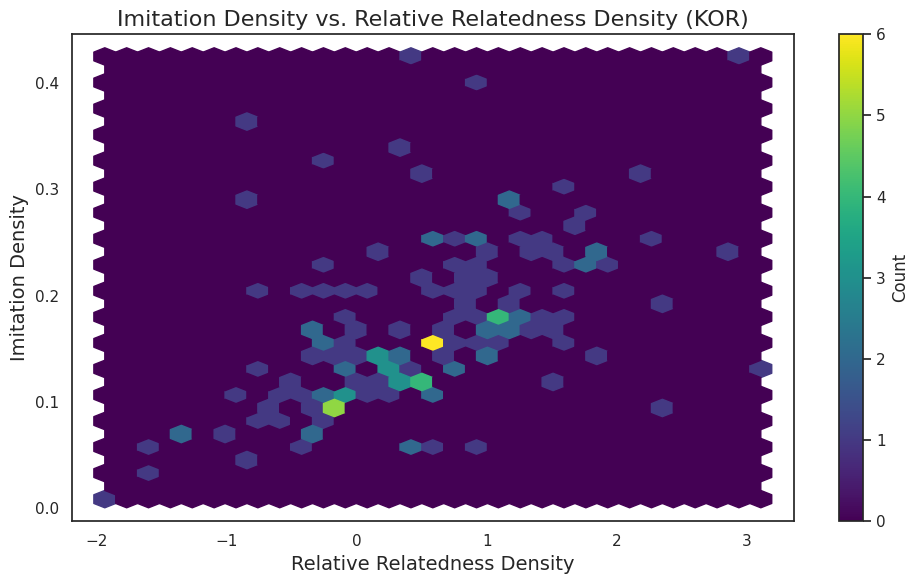

In [ ]:
import matplotlib.pyplot as plt

# Filter and preprocess the data
temp_Regression_df = Regression_df.copy()
temp_Regression_df_KOR = temp_Regression_df[temp_Regression_df['country'] == 'KOR']
temp_Regression_df_KOR = temp_Regression_df_KOR[temp_Regression_df_KOR['binary_rca'] == 1]
temp_Regression_df_KOR = temp_Regression_df_KOR[temp_Regression_df_KOR['year'].isin([1970, 1980, 1990, 2000, 2010, 2018])]

# Create hexbin plot
plt.figure(figsize=(10, 6))
hb = plt.hexbin(
    temp_Regression_df_KOR['Relative_relatedness_density'],
    temp_Regression_df_KOR['imitation_density_4'],
    gridsize=30,
    cmap='viridis'
)
plt.colorbar(hb, label='Count')
plt.title('Imitation Density vs. Relative Relatedness Density (KOR)', fontsize=16)
plt.xlabel('Relative Relatedness Density', fontsize=14)
plt.ylabel('Imitation Density', fontsize=14)
plt.tight_layout()
plt.show()


<Axes: xlabel='Relative_relatedness_density', ylabel='imitation_density_4'>

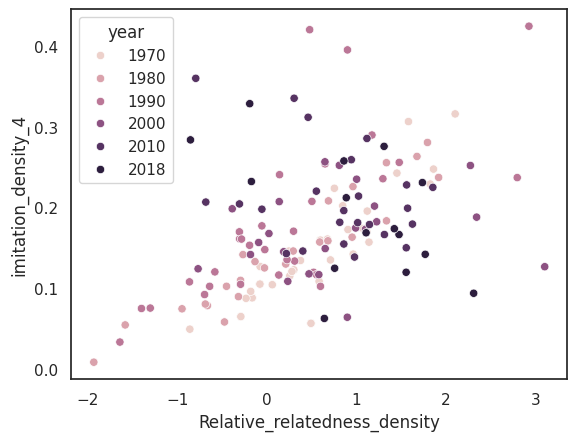

In [ ]:

# Filter and preprocess the data
temp_Regression_df = Regression_df.copy()
temp_Regression_df_KOR = temp_Regression_df[temp_Regression_df['country'] == 'KOR']
temp_Regression_df_KOR = temp_Regression_df_KOR[temp_Regression_df_KOR['binary_rca'] == 1]
temp_Regression_df_KOR = temp_Regression_df_KOR[temp_Regression_df_KOR['year'].isin([1970, 1980, 1990, 2000, 2010, 2018])]
sns.scatterplot(x='Relative_relatedness_density', y='imitation_density_4', data=temp_Regression_df_KOR, hue ='year')

<Axes: xlabel='Relative_relatedness_density', ylabel='imitation_density_4'>

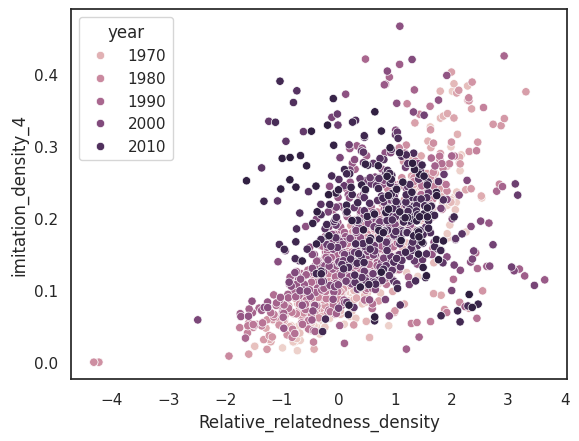

In [ ]:
temp_Regression_df_KOR = temp_Regression_df[temp_Regression_df['country']=='KOR']
temp_Regression_df_KOR = temp_Regression_df_KOR[temp_Regression_df_KOR['binary_rca'] == 1]
sns.scatterplot(x='Relative_relatedness_density', y='imitation_density_4', data=temp_Regression_df_KOR, hue ='year')

In [ ]:
imitation_density_4[year]*Opportunity[year]*binary_rca[year+2]

sitc_product_code,0011,0012,0013,0014,0015,0111,0112,0113,0114,0115,...,9310,9410,9510,9610,9710,ZZZZ,financial,transport,travel,unspecified
location_code,,,,,,,,,,,,,,,,,,,,,
AGO,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
ALB,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
ARE,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.214092,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
ARG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
AUS,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VNM,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0
YEM,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.397055,0.0,0.000000,0.0,0.0,0.0
ZAF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0


In [ ]:
imitation_density_4[year].loc[temp_country]

,ZWE
sitc_product_code,
0011,0.269759
0012,0.157922
0013,0.102984
0014,0.193248
0015,0.098874
...,...
ZZZZ,0.058580
financial,0.062093
transport,0.388662


In [ ]:
country2continent = dict(zip(Regression_df.country,Regression_df.continent))

In [ ]:
# Initialize an empty DataFrame
temp_result_list = []

# Loop over unique years and countries
for year in Regression_df['year'].unique():
    for temp_country in Regression_df['country'].unique():
        # Define masks for each calculation
        mask_export_similarity = Export_Similarity_4[year].loc[temp_country] != 0
        mask_relatedness_desntiy = Relative_relatedness_density[year].loc[temp_country] != 0
        mask_imitation_density = imitation_density_4[year].loc[temp_country] != 0
        mask_diversified1 = (
            imitation_density_4[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country] != 0
        mask_diversified2 = (
            Relative_relatedness_density[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country] != 0

        # Create temporary data for calculations
        export_similarity_data = Export_Similarity_4[year].loc[temp_country][mask_export_similarity]
        imitation_density_data = imitation_density_4[year].loc[temp_country][mask_imitation_density]
        relatedness_density_data = Relative_relatedness_density[year].loc[temp_country][mask_relatedness_desntiy]
        diversified_data1 = (
            imitation_density_4[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country][mask_diversified1]
        diversified_data2 = (
            Relative_relatedness_density[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country][mask_diversified2]

        # Append calculated metrics to the result list
        temp_result_list.append(
            [
                year,
                temp_country,
                export_similarity_data.mean(),
                imitation_density_data.mean(),
                relatedness_density_data.mean(),
                diversified_data1.mean(),
                diversified_data2.mean(),
                eci[year][temp_country],
            ]
        )

# Convert the result list to a DataFrame
temp_plot_df = pd.DataFrame(
    temp_result_list,
    columns=[
        'year',
        'country',
        'Average Export Similarity',
        'Average Imitation_density',
        'Average Relatedness_density',
        'Average Imitation_density for diversified products',
        'Average Relatedness_density for diversified products',
        'ECI',
    ]
)

# Filter for rows with positive export similarity
temp_plot_df = temp_plot_df[temp_plot_df['Average Export Similarity'] > 0]

# Display the result
temp_plot_df['continent'] = temp_plot_df['country'].map(country2continent)
temp_plot_df.head()


,year,country,Average Export Similarity,Average Imitation_density,Average Relatedness_density,Average Imitation_density for diversified products,Average Relatedness_density for diversified products,ECI,continent
0,1962,ARG,0.268450,0.084596,0.327904,0.091958,0.354213,-0.546232,America
1,1962,AUS,0.257380,0.086118,0.299735,0.093783,0.182072,-0.188033,Pacific
2,1962,AUT,0.167691,0.184248,0.616689,0.160911,0.458994,1.803938,Europe
3,1962,BEL,0.169850,0.191103,0.711548,0.164758,0.205362,1.439318,Europe
4,1962,BOL,0.248142,0.076220,0.115041,0.074525,-0.258508,-0.383369,America


In [ ]:
temp_plot_df = temp_plot_df.dropna()
temp_plot_df = temp_plot_df[temp_plot_df['continent']!='etc']

In [ ]:
temp_plot_df['continent'].unique()

array(['America', 'Pacific', 'Europe', 'Asia', 'Africa'], dtype=object)

<ipython-input-407-cb6fe7b52e54>:27: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend()
<ipython-input-407-cb6fe7b52e54>:44: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


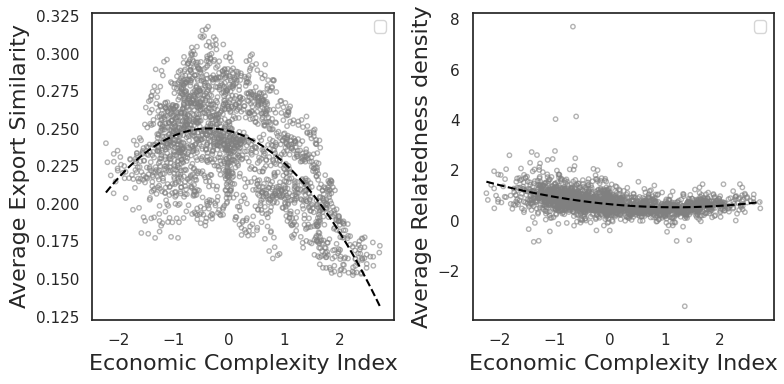

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Remove NaN values from the data for the first plot
plot_df2 = temp_plot_df.copy()
plot_df2 = plot_df2[plot_df2['year']>=2000]
filtered_df1 = plot_df2.dropna()

# Create a 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(8, 4))

# First plot
axes[0].scatter(
    filtered_df1['ECI'], filtered_df1['Average Export Similarity'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z1 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Export Similarity'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')

# Customize the first plot
axes[0].set_xlabel("Economic Complexity Index", fontsize=16)
axes[0].set_ylabel("Average Export Similarity", fontsize=16)
axes[0].legend()

# Second plot
axes[1].scatter(
    filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')

# Customize the second plot
axes[1].set_xlabel("Economic Complexity Index", fontsize=16)
axes[1].set_ylabel("Average Relatedness density", fontsize=16)
axes[1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

<ipython-input-408-86d9422a9e1b>:22: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend()
<ipython-input-408-86d9422a9e1b>:40: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


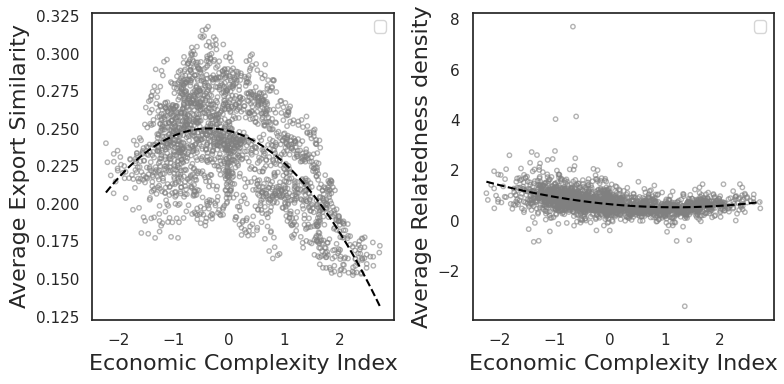

<ipython-input-408-86d9422a9e1b>:61: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create a 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(8, 4))

# First plot
axes[0].scatter(
    filtered_df1['ECI'], filtered_df1['Average Export Similarity'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z1 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Export Similarity'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')

# Customize the first plot
axes[0].set_xlabel("Economic Complexity Index", fontsize=16)
axes[0].set_ylabel("Average Export Similarity", fontsize=16)
axes[0].legend()


# Second plot
axes[1].scatter(
    filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')

# Customize the second plot
axes[1].set_xlabel("Economic Complexity Index", fontsize=16)
axes[1].set_ylabel("Average Relatedness density", fontsize=16)
axes[1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

# third plot
axes[1].scatter(
    filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'], 1)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')

# Customize the second plot
axes[1].set_xlabel("Economic Complexity Index", fontsize=16)
axes[1].set_ylabel("Average imitation density", fontsize=16)
axes[1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

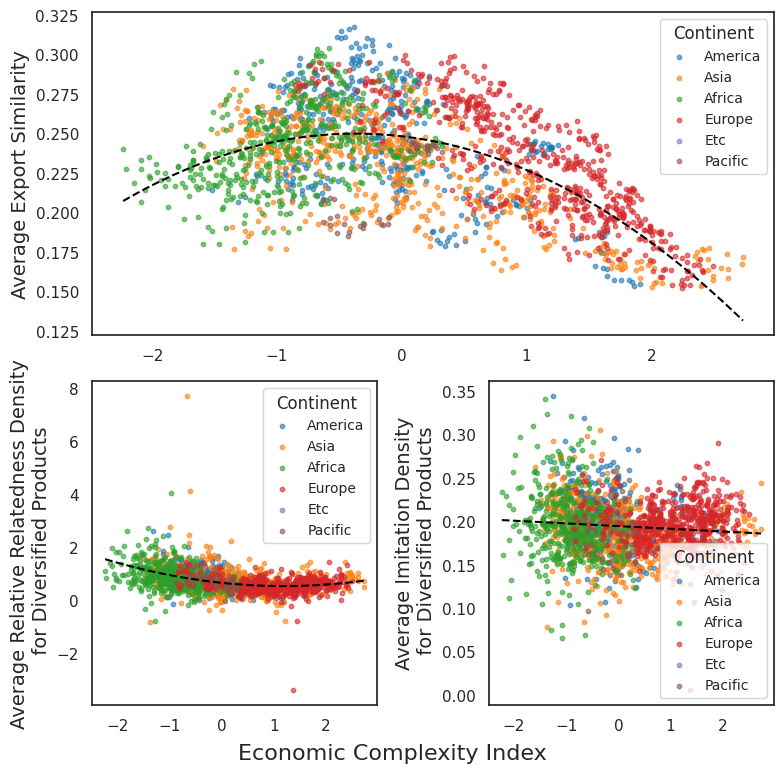

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Assume `continent_color_dict` is defined as provided
# Example: continent_color_dict = {'Asia': 'blue', 'Europe': 'green', ...}

# Create a 2x1 panel with the top figure as a single plot and the bottom as a 1x2 panel
fig = plt.figure(figsize=(8, 8))

# First plot: Full-width on the top
ax1 = fig.add_subplot(2, 1, 1)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax1.scatter(
        data['ECI'], data['Average Export Similarity'],
        alpha=0.6, color=color, s=10, label=continent
    )
z1 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Export Similarity'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax1.plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')
ax1.set_ylabel("Average Export Similarity", fontsize=14)
ax1.legend(title="Continent", fontsize=10)

# Second and third plots: Side-by-side in the bottom row
ax2 = fig.add_subplot(2, 2, 3)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax2.scatter(
        data['ECI'], data['Average Relatedness_density for diversified products'],
        alpha=0.6, color=color, s=10, label=continent
    )
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax2.plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')
ax2.set_ylabel("Average Relative Relatedness Density\n for Diversified Products", fontsize=14)
ax2.legend(title="Continent", fontsize=10)

ax3 = fig.add_subplot(2, 2, 4)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax3.scatter(
        data['ECI'], data['Average Imitation_density for diversified products'],
        alpha=0.6, color=color, s=10, label=continent
    )
z3 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'], 1)
p3 = np.poly1d(z3)
trendline_x3 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax3.plot(trendline_x3, p3(trendline_x3), color='black', linestyle='--')
ax3.set_ylabel("Average Imitation Density\n for Diversified Products", fontsize=14)
ax3.legend(title="Continent", fontsize=10)

# Add a common x-axis label
fig.text(0.5, 0.04, "Economic Complexity Index", ha='center', fontsize=16)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the common x-axis label
plt.show()


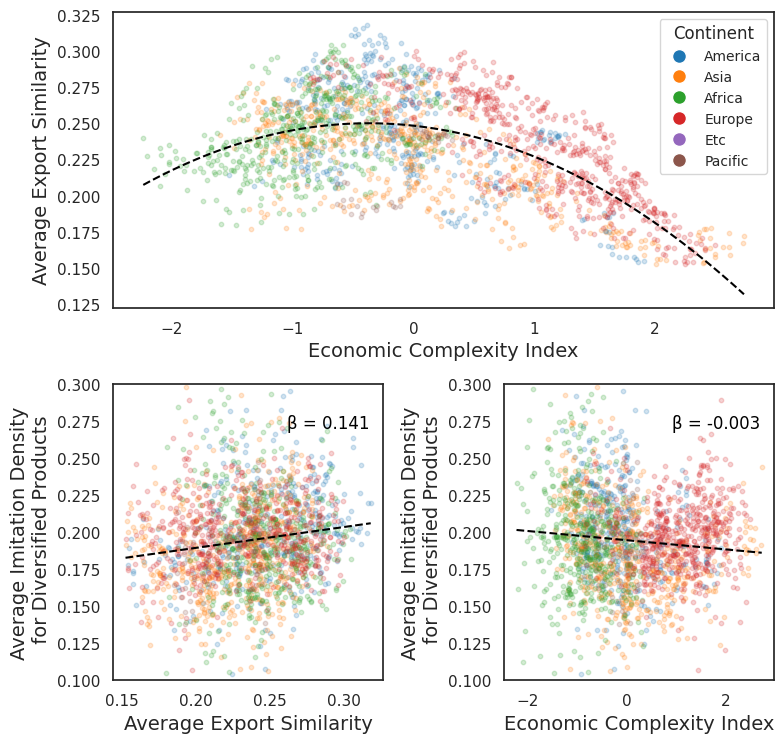

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Assume `continent_color_dict` is defined
# Example: continent_color_dict = {'Asia': 'blue', 'Europe': 'green', ...}

# Create a 2x1 panel with the top figure as a single plot and the bottom as a 1x2 panel
fig = plt.figure(figsize=(8, 8))

# First plot: Full-width on the top
ax1 = fig.add_subplot(2, 1, 1)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax1.scatter(
        data['ECI'], data['Average Export Similarity'],
        alpha=0.2, color=color, s=10  # Set scatter alpha to 0.1
    )
z1 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Export Similarity'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax1.plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')
ax1.set_ylabel("Average Export Similarity", fontsize=14)
ax1.set_xlabel("Economic Complexity Index", fontsize=14)

# Create custom legend with alpha=1
legend_elements = [
    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=continent)
    for continent, color in continent_color_dict.items()
]
ax1.legend(handles=legend_elements, title="Continent", fontsize=10)

# Second and third plots: Side-by-side in the bottom row
ax2 = fig.add_subplot(2, 2, 3)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax2.scatter(
        data['Average Export Similarity'], data['Average Imitation_density for diversified products'],
        alpha=0.2, color=color, s=10  # Set scatter alpha to 0.1
    )
z2 = np.polyfit(filtered_df1['Average Export Similarity'], filtered_df1['Average Imitation_density for diversified products'], 1)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['Average Export Similarity'].min(), filtered_df1['Average Export Similarity'].max(), 100)
ax2.plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')
ax2.set_ylabel("Average Imitation Density\n for Diversified Products", fontsize=14)
ax2.set_xlabel("Average Export Similarity", fontsize=14)
ax2.set_ylim(0.1, 0.3)

# Add beta to the panel
beta_2 = z2[0]
ax2.text(0.95, 0.9, f"β = {beta_2:.3f}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='top', horizontalalignment='right', color='black')

# Add custom legend with alpha=1
#ax2.legend(handles=legend_elements, title="Continent", fontsize=10)

ax3 = fig.add_subplot(2, 2, 4)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax3.scatter(
        data['ECI'], data['Average Imitation_density for diversified products'],
        alpha=0.2, color=color, s=10  # Set scatter alpha to 0.1
    )
z3 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'], 1)
p3 = np.poly1d(z3)
trendline_x3 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax3.plot(trendline_x3, p3(trendline_x3), color='black', linestyle='--')
ax3.set_ylabel("Average Imitation Density\n for Diversified Products", fontsize=14)
ax3.set_xlabel("Economic Complexity Index", fontsize=14)
ax3.set_ylim(0.1, 0.3)

# Add beta to the panel
beta_3 = z3[0]
ax3.text(0.95, 0.9, f"β = {beta_3:.3f}", transform=ax3.transAxes, fontsize=12,
         verticalalignment='top', horizontalalignment='right', color='black')

# Add custom legend with alpha=1
#ax3.legend(handles=legend_elements, title="Continent", fontsize=10)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the common x-axis label
plt.show()


In [ ]:
beta_3

-0.003101001405176441

In [ ]:
# Initialize an empty DataFrame
temp_result_list = []

# Loop over unique years and countries
for year in Regression_df['year'].unique():
    for temp_country in Regression_df['country'].unique():
        # Define masks for each calculation
        mask_export_similarity = Export_Similarity_4[year].loc[temp_country] != 0
        mask_relatedness_desntiy = Relative_relatedness_density[year].loc[temp_country] != 0
        mask_imitation_density = imitation_density_4[year].loc[temp_country] != 0
        mask_diversified1 = (
            imitation_density_4[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country] != 0
        mask_diversified2 = (
            Relative_relatedness_density[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country] != 0

        # Create temporary data for calculations
        export_similarity_data = Export_Similarity_4[year].loc[temp_country][mask_export_similarity]
        imitation_density_data = imitation_density_4[year].loc[temp_country][mask_imitation_density]
        relatedness_density_data = Relative_relatedness_density[year].loc[temp_country][mask_relatedness_desntiy]
        diversified_data1 = (
            imitation_density_4[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country][mask_diversified1]
        diversified_data2 = (
            Relative_relatedness_density[year] * Opportunity[year] * binary_rca[year + 2]
        ).loc[temp_country][mask_diversified2]

        # Append calculated metrics to the result list
        temp_result_list.append(
            [
                year,
                temp_country,
                export_similarity_data.mean(),
                imitation_density_data.mean(),
                relatedness_density_data.mean(),
                diversified_data1.mean(),
                diversified_data2.mean(),
                eci[year][temp_country],
            ]
        )

# Convert the result list to a DataFrame
temp_plot_df = pd.DataFrame(
    temp_result_list,
    columns=[
        'year',
        'country',
        'Average Export Similarity',
        'Average Imitation_density',
        'Average Relatedness_density',
        'Average Imitation_density for diversified products',
        'Average Relatedness_density for diversified products',
        'ECI',
    ]
)

# Filter for rows with positive export similarity
temp_plot_df = temp_plot_df[temp_plot_df['Average Export Similarity'] > 0]

# Display the result
temp_plot_df['continent'] = temp_plot_df['country'].map(country2continent)
temp_plot_df.head()

,year,country,Average Export Similarity,Average Imitation_density,Average Relatedness_density,Average Imitation_density for diversified products,Average Relatedness_density for diversified products,ECI,continent
0,1962,ARG,0.268450,0.084596,0.327904,0.091958,0.354213,-0.546232,America
1,1962,AUS,0.257380,0.086118,0.299735,0.093783,0.182072,-0.188033,Pacific
2,1962,AUT,0.167691,0.184248,0.616689,0.160911,0.458994,1.803938,Europe
3,1962,BEL,0.169850,0.191103,0.711548,0.164758,0.205362,1.439318,Europe
4,1962,BOL,0.248142,0.076220,0.115041,0.074525,-0.258508,-0.383369,America


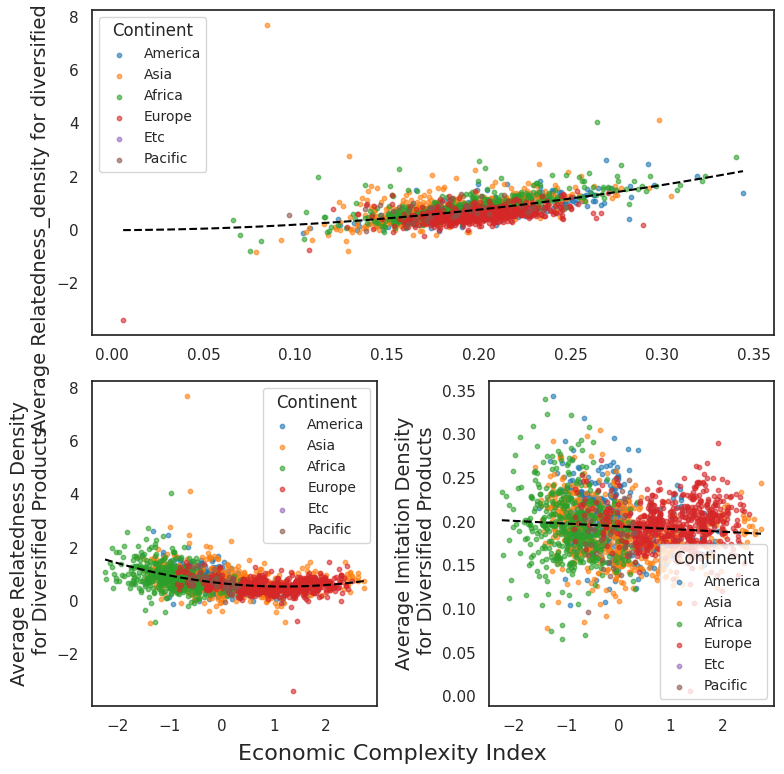

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# Assume `continent_color_dict` is defined as provided
# Example: continent_color_dict = {'Asia': 'blue', 'Europe': 'green', ...}

# Create a 2x1 panel with the top figure as a single plot and the bottom as a 1x2 panel
fig = plt.figure(figsize=(8, 8))

# First plot: Full-width on the top
ax1 = fig.add_subplot(2, 1, 1)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax1.scatter(
        data['Average Imitation_density for diversified products'], data['Average Relatedness_density for diversified products'],
        alpha=0.6, color=color, s=10, label=continent
    )
z1 = np.polyfit(filtered_df1['Average Imitation_density for diversified products'], filtered_df1['Average Relatedness_density for diversified products'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['Average Imitation_density for diversified products'].min(), filtered_df1['Average Imitation_density for diversified products'].max(), 100)
ax1.plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')
ax1.set_ylabel("Average Relatedness_density for diversified products", fontsize=14)
ax1.legend(title="Continent", fontsize=10)

# Second and third plots: Side-by-side in the bottom row
ax2 = fig.add_subplot(2, 2, 3)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax2.scatter(
        data['ECI'], data['Average Relatedness_density for diversified products'],
        alpha=0.6, color=color, s=10, label=continent
    )
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Relatedness_density for diversified products'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax2.plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')
ax2.set_ylabel("Average Relatedness Density\n for Diversified Products", fontsize=14)
ax2.legend(title="Continent", fontsize=10)

ax3 = fig.add_subplot(2, 2, 4)
for continent, color in continent_color_dict.items():
    data = filtered_df1[filtered_df1['continent'] == continent]
    ax3.scatter(
        data['ECI'], data['Average Imitation_density for diversified products'],
        alpha=0.6, color=color, s=10, label=continent
    )
z3 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'], 1)
p3 = np.poly1d(z3)
trendline_x3 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
ax3.plot(trendline_x3, p3(trendline_x3), color='black', linestyle='--')
ax3.set_ylabel("Average Imitation Density\n for Diversified Products", fontsize=14)
ax3.legend(title="Continent", fontsize=10)

# Add a common x-axis label
fig.text(0.5, 0.04, "Economic Complexity Index", ha='center', fontsize=16)

# Adjust layout
plt.tight_layout(rect=[0, 0.05, 1, 1])  # Leave space for the common x-axis label
plt.show()


In [ ]:
from scipy.stats import pearsonr

# Compute correlation

temp_plot_df2 = temp_plot_df.dropna()
corr, p_value = pearsonr(temp_plot_df2['ECI'], temp_plot_df2['Average Imitation_density for diversified products'])

print(f"Pearson Correlation: {corr:.3f}")
print(f"P-value: {p_value:.3f}")


Pearson Correlation: -0.073
P-value: 0.000


In [ ]:
import statsmodels.api as sm

# Prepare data
X = sm.add_constant(temp_plot_df2['ECI'])  # Add constant term for regression
y = temp_plot_df2['Average Imitation_density for diversified products']

# Fit the model
model = sm.OLS(y, X).fit()

# Display summary
print(model.summary())

                                            OLS Regression Results                                            
Dep. Variable:     Average Imitation_density for diversified products   R-squared:                       0.005
Model:                                                            OLS   Adj. R-squared:                  0.005
Method:                                                 Least Squares   F-statistic:                     30.49
Date:                                                Fri, 24 Jan 2025   Prob (F-statistic):           3.49e-08
Time:                                                        22:53:33   Log-Likelihood:                 10542.
No. Observations:                                                5759   AIC:                        -2.108e+04
Df Residuals:                                                    5757   BIC:                        -2.107e+04
Df Model:                                                           1                                         
C

In [ ]:
import statsmodels.api as sm

# Prepare data
X = sm.add_constant(temp_plot_df2['Average Export Similarity'])  # Add constant term for regression
y = temp_plot_df2['Average Imitation_density for diversified products']

# Fit the model
model = sm.OLS(y, X).fit()

# Display summary
print(model.summary())

                                            OLS Regression Results                                            
Dep. Variable:     Average Imitation_density for diversified products   R-squared:                       0.001
Model:                                                            OLS   Adj. R-squared:                  0.001
Method:                                                 Least Squares   F-statistic:                     8.522
Date:                                                Fri, 24 Jan 2025   Prob (F-statistic):            0.00352
Time:                                                        22:53:33   Log-Likelihood:                 10531.
No. Observations:                                                5759   AIC:                        -2.106e+04
Df Residuals:                                                    5757   BIC:                        -2.104e+04
Df Model:                                                           1                                         
C

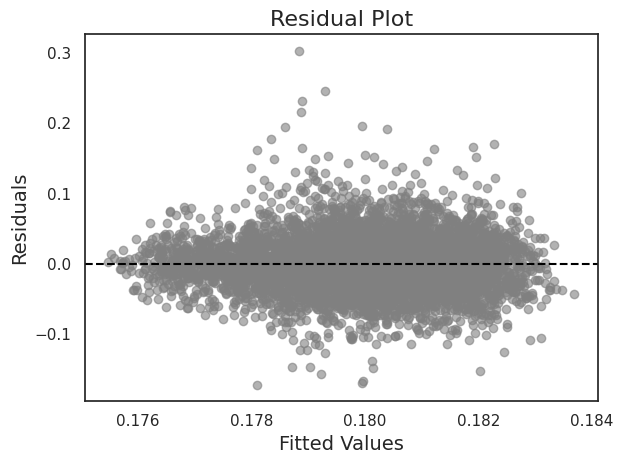

In [ ]:
import matplotlib.pyplot as plt

# Residual plot
plt.scatter(model.fittedvalues, model.resid, alpha=0.6, color='grey')
plt.axhline(0, color='black', linestyle='--')
plt.xlabel("Fitted Values", fontsize=14)
plt.ylabel("Residuals", fontsize=14)
plt.title("Residual Plot", fontsize=16)
plt.tight_layout()
plt.show()


<ipython-input-419-3c84ea8cb86e>:26: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend()
<ipython-input-419-3c84ea8cb86e>:43: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


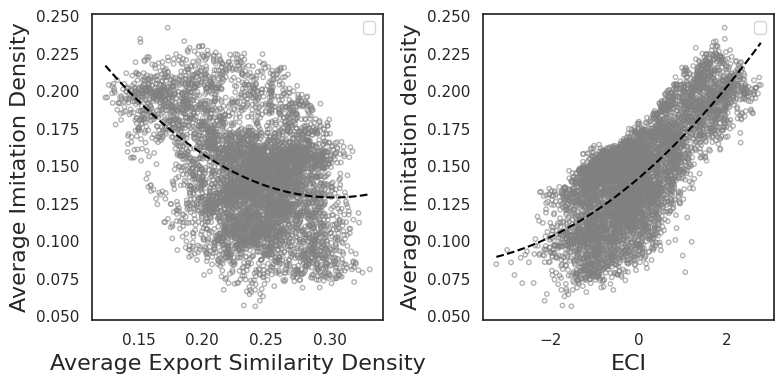

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Remove NaN values from the data for the first plot
plot_df2 = temp_plot_df.copy()
filtered_df1 = plot_df2.dropna()

# Create a 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(8, 4))

# First plot
axes[0].scatter(
    filtered_df1['Average Export Similarity'], filtered_df1['Average Imitation_density'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z1 = np.polyfit(filtered_df1['Average Export Similarity'], filtered_df1['Average Imitation_density'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['Average Export Similarity'].min(), filtered_df1['Average Export Similarity'].max(), 100)
axes[0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')

# Customize the first plot
axes[0].set_xlabel("Average Export Similarity Density", fontsize=16)
axes[0].set_ylabel("Average Imitation Density", fontsize=16)
axes[0].legend()

# Second plot
axes[1].scatter(
    filtered_df1['ECI'], filtered_df1['Average Imitation_density'],
    alpha=0.6, color='grey', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')

# Customize the second plot
axes[1].set_xlabel("ECI", fontsize=16)
axes[1].set_ylabel("Average imitation density", fontsize=16)
axes[1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [ ]:
temp_plot_df.columns

Index(['year', 'country', 'Average Export Similarity',
       'Average Imitation_density', 'Average Relatedness_density',
       'Average Imitation_density for diversified products',
       'Average Relatedness_density for diversified products', 'ECI',
       'continent'],
      dtype='object')

<ipython-input-421-00c2aa1cfc53>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
<ipython-input-421-00c2aa1cfc53>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)
<ipython-input-421-00c2aa1cfc53>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavio

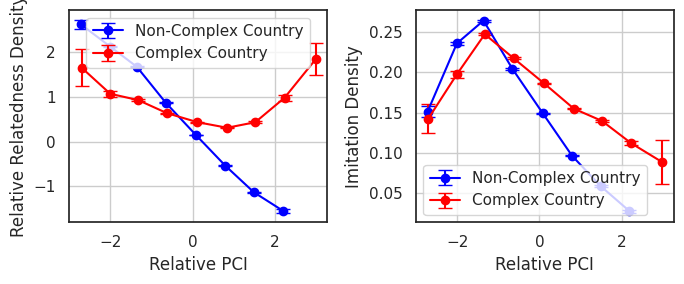

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Prepare data
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year'] >= 1994]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]

# Divide data into Non-Complex and Complex countries
non_complex = temp_Regression_df[temp_Regression_df['eci'] < 0]
complex_countries = temp_Regression_df[temp_Regression_df['eci'] >= 0]

# Binning Relative PCI for aggregation
bins = np.linspace(temp_Regression_df['Relative_pci'].min(), temp_Regression_df['Relative_pci'].max(), 10)
non_complex['pci_bin'] = pd.cut(non_complex['Relative_pci'], bins)
complex_countries['pci_bin'] = pd.cut(complex_countries['Relative_pci'], bins)

# Aggregate mean and SEM for each group
def aggregate_density(data):
    return data.groupby('pci_bin').agg(
        mean_relative_relatedness=('Relative_relatedness_density', 'mean'),
        sem_relative_relatedness=('Relative_relatedness_density', lambda x: x.std() / np.sqrt(len(x))),
        mean_imitation_density=('imitation_density_4', 'mean'),
        sem_imitation_density=('imitation_density_4', lambda x: x.std() / np.sqrt(len(x))),
        mean_pci=('Relative_pci', 'mean')
    ).dropna()

non_complex_stats = aggregate_density(non_complex)
complex_stats = aggregate_density(complex_countries)

# Create 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(7, 3), sharey=False)

# First panel: Relatedness Density
axes[0].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_relative_relatedness'],
    yerr=non_complex_stats['sem_relative_relatedness'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[0].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_relative_relatedness'],
    yerr=complex_stats['sem_relative_relatedness'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[0].set_xlabel("Relative PCI", fontsize=12)
axes[0].set_ylabel("Relative Relatedness Density", fontsize=12)
#axes[0].set_title("Relatedness Density vs Relative PCI", fontsize=16)
axes[0].legend()
axes[0].grid(True)

# Second panel: Imitation Density
axes[1].errorbar(
    non_complex_stats['mean_pci'],
    non_complex_stats['mean_imitation_density'],
    yerr=non_complex_stats['sem_imitation_density'],
    fmt='-o', color='blue', capsize=5, label="Non-Complex Country"
)
axes[1].errorbar(
    complex_stats['mean_pci'],
    complex_stats['mean_imitation_density'],
    yerr=complex_stats['sem_imitation_density'],
    fmt='-o', color='red', capsize=5, label="Complex Country"
)
axes[1].set_xlabel("Relative PCI", fontsize=12)
axes[1].set_ylabel("Imitation Density", fontsize=12)
#axes[1].set_title("Imitation Density vs Relative PCI", fontsize=16)
axes[1].legend()
axes[1].grid(True)

# Adjust layout and show
plt.tight_layout()
plt.show()


<ipython-input-422-da88ba93bf4a>:26: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend()
<ipython-input-422-da88ba93bf4a>:43: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


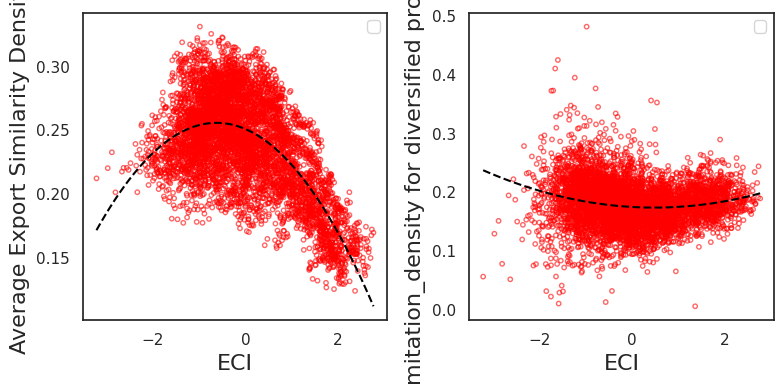

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Remove NaN values from the data for the first plot
plot_df2 = temp_plot_df.copy()
filtered_df1 = plot_df2.dropna()

# Create a 1x2 panel
fig, axes = plt.subplots(1, 2, figsize=(8, 4))

# First plot
axes[0].scatter(
    filtered_df1['ECI'], filtered_df1['Average Export Similarity'],
    alpha=0.6, color='red', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z1 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Export Similarity'], 2)
p1 = np.poly1d(z1)
trendline_x1 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[0].plot(trendline_x1, p1(trendline_x1), color='black', linestyle='--')

# Customize the first plot
axes[0].set_xlabel("ECI", fontsize=16)
axes[0].set_ylabel("Average Export Similarity Density", fontsize=16)
axes[0].legend()

# Second plot
axes[1].scatter(
    filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'],
    alpha=0.6, color='red', s=10, facecolor = 'none'
)

# Fit and plot the 2nd degree polynomial trendline
z2 = np.polyfit(filtered_df1['ECI'], filtered_df1['Average Imitation_density for diversified products'], 2)
p2 = np.poly1d(z2)
trendline_x2 = np.linspace(filtered_df1['ECI'].min(), filtered_df1['ECI'].max(), 100)
axes[1].plot(trendline_x2, p2(trendline_x2), color='black', linestyle='--')

# Customize the second plot
axes[1].set_xlabel("ECI", fontsize=16)
axes[1].set_ylabel("Average Imitation_density for diversified products Density", fontsize=16)
axes[1].legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

<Axes: xlabel='Average Export Similarity', ylabel='Average Imitation_density'>

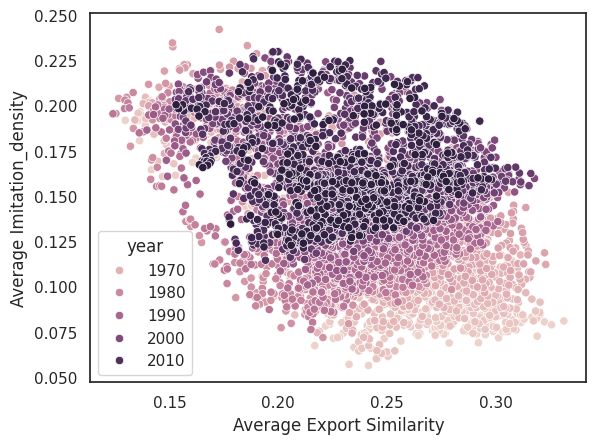

In [ ]:
sns.scatterplot(y='Average Imitation_density', x='Average Export Similarity', data=temp_plot_df, hue = 'year')

<Axes: xlabel='Average Imitation_density for diversified products', ylabel='Average Imitation_density'>

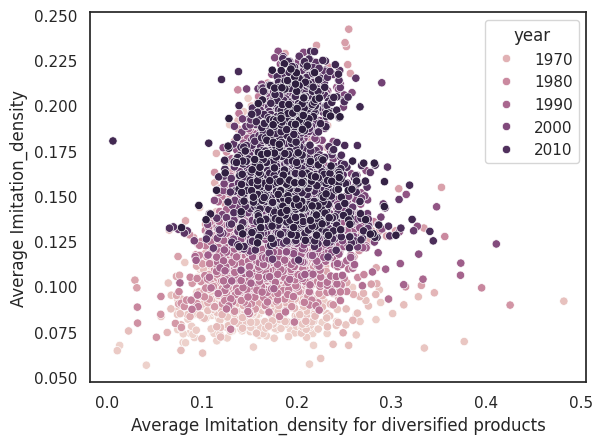

In [ ]:
sns.scatterplot(y='Average Imitation_density', x='Average Imitation_density for diversified products', data=temp_plot_df, hue = 'year')

In [ ]:
np.mean(Export_Similarity_4[year].loc['KOR'])

0.15292452541399312

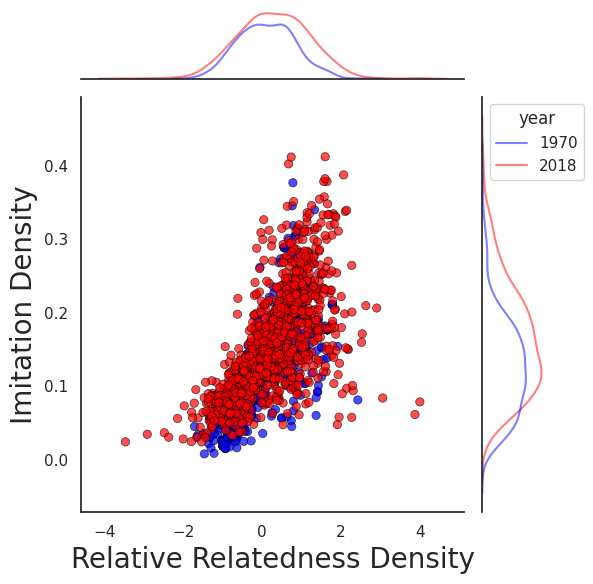

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the DataFrame for the specified years
temp_Regression_df = Regression_df.copy()
temp_Regression_df = temp_Regression_df[temp_Regression_df['year'].isin([1970, 2018])]
temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca'] == 1]
temp_Regression_df = temp_Regression_df[temp_Regression_df['Relative_pci']>=0]
#temp_Regression_df = temp_Regression_df[temp_Regression_df['binary_rca']==1]

# Create a JointGrid object for better control
g = sns.JointGrid(
    data=temp_Regression_df,
    x='Relative_relatedness_density',
    y='imitation_density_4',
    hue='year'
)

# Add scatterplot with hollow markers
sns.scatterplot(
    data=temp_Regression_df,
    x='Relative_relatedness_density',
    y='imitation_density_4',
    hue='year',
    palette={1970: 'blue', 2018: 'red'},
    alpha=0.7,
    edgecolor='black',  # Marker edge color
    facecolor='none',   # Make markers hollow
    linewidth=0.5,      # Edge thickness
    ax=g.ax_joint,
    legend=False
)

# Add KDE plots on the marginal axes
sns.kdeplot(
    data=temp_Regression_df,
    x='Relative_relatedness_density',
    hue='year',
    palette={1970: 'blue', 2018: 'red'},
    alpha=0.5,
    ax=g.ax_marg_x,
    legend=False
)

sns.kdeplot(
    data=temp_Regression_df,
    y='imitation_density_4',
    hue='year',
    palette={1970: 'blue', 2018: 'red'},
    alpha=0.5,
    ax=g.ax_marg_y
)

# Set axis labels
g.ax_joint.set_xlabel('Relative Relatedness Density', fontsize=20)
g.ax_joint.set_ylabel('Imitation Density', fontsize=20)

# Adjust layout and display
plt.tight_layout()
plt.show()


In [ ]:
from scipy.stats import pearsonr, spearmanr

x = Regression_df['Relative_relatedness_density']
y = Regression_df['imitation_density_4']


# Pearson Correlation
corr_pearson, p_pearson = pearsonr(x, y)
print(f"Pearson Correlation: {corr_pearson}, p-value: {p_pearson}")

# Spearman Correlation
corr_spearman, p_spearman = spearmanr(x, y)
print(f"Spearman Correlation: {corr_spearman}, p-value: {p_spearman}")

Pearson Correlation: 0.7033856676211868, p-value: 0.0
Spearman Correlation: 0.7552363849742709, p-value: 0.0


In [ ]:
import statsmodels.api as sm

#x = Regression_df[Regression_df['year']==2015]['Relative_relatedness_density']
#y = Regression_df[Regression_df['year']==2015]['imitation_density_4']

#lowess = sm.nonparametric.lowess
#smooth = lowess(y, x, frac=0.3)  # Lowess 스무딩
#plt.plot(smooth[:, 0], smooth[:, 1], color='red')
#plt.show()

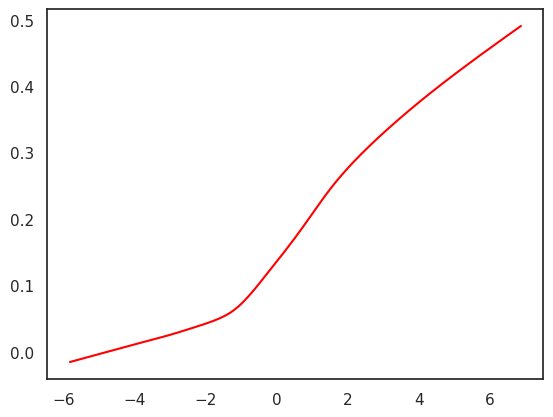

In [ ]:
import statsmodels.api as sm

x = Regression_df[Regression_df['year']==2015]['Relative_relatedness_density']
y = Regression_df[Regression_df['year']==2015]['imitation_density_4']

lowess = sm.nonparametric.lowess
smooth = lowess(y, x, frac=0.3)  # Lowess 스무딩
plt.plot(smooth[:, 0], smooth[:, 1], color='red')
plt.show()

In [ ]:
from statsmodels.stats.diagnostic import het_breuschpagan
from statsmodels.api import OLS

model = OLS(y, sm.add_constant(x)).fit()
bp_test = het_breuschpagan(model.resid, model.model.exog)
print(f"Breusch-Pagan Test: {bp_test}")

Breusch-Pagan Test: (4647.256053606027, 0.0, 4975.073742315303, 0.0)


In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

X = Regression_df[['Relative_relatedness_density', 'imitation_density_4','rgdpe_per_capita','eci','Relative_pci']]
vif = pd.DataFrame()
vif["Variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif)


                       Variable       VIF
0  Relative_relatedness_density  1.738959
1           imitation_density_4  1.766516
2              rgdpe_per_capita  1.579348
3                           eci  1.064354
4                  Relative_pci  1.549569


## Diversification Pattern

In [10]:
import pickle

with open(class_directory+r'/Regression_df_250111_f.pkl', 'rb') as f:
  Regression_df = pickle.load(f)

In [11]:
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt

filtered_df = Regression_df[Regression_df['binary_rca'] == 1]
filtered_df

temp_result_list = []

grouped = filtered_df.groupby(['year', 'country'])

for (year, country), temp_df in tqdm(grouped):
    temp_corr1 = np.corrcoef(temp_df['imitation_density_4'], temp_df['Relative_relatedness_density'])[0, 1]
    temp_corr2 = np.corrcoef(temp_df['Relative_pci'], temp_df['Relative_relatedness_density'])[0, 1]
    temp_corr3 = np.corrcoef(temp_df['Relative_pci'], temp_df['imitation_density_4'])[0, 1]
    temp_corr4 = np.corrcoef(temp_df['Relative_pci'], temp_df['imitation_density_4'])[0, 1]

    temp_result_list.append([
        country,
        year,
        temp_corr1,
        temp_corr2,
        temp_corr3,
        temp_corr4,
        temp_df.iloc[0]['eci']  # ECI 값 추출
    ])

result_df = pd.DataFrame(temp_result_list, columns=[
    'name', 'Year', 'corr1', 'corr2', 'corr3','corr4', 'ECI'
])


  0%|          | 0/5599 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2889: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)
100%|██████████| 5599/5599 [00:03<00:00, 1584.91it/s]


In [12]:
temp_corr_df = pd.DataFrame(temp_result_list)
temp_corr_df.columns = ['name','year','corr1','corr2','corr3','corr4','ECI']

In [13]:
temp_corr_df = temp_corr_df[(temp_corr_df['corr1']!=1) & (temp_corr_df['corr1']!=-1)]
temp_corr_df = temp_corr_df[(temp_corr_df['corr2']!=1) & (temp_corr_df['corr2']!=-1)]
temp_corr_df = temp_corr_df[(temp_corr_df['corr3']!=1) & (temp_corr_df['corr3']!=-1)]
temp_corr_df = temp_corr_df[(temp_corr_df['corr4']!=1) & (temp_corr_df['corr4']!=-1)]
len(temp_corr_df)

5522

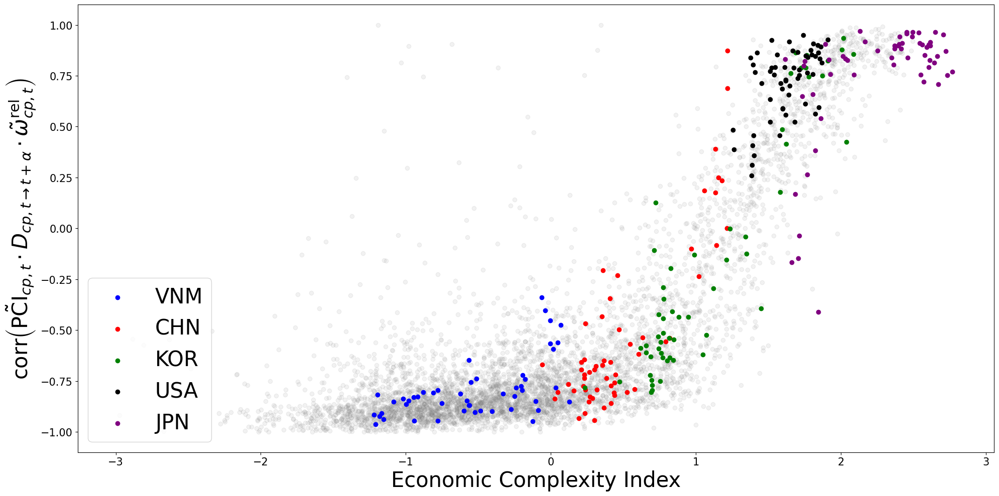

In [14]:
import matplotlib.pyplot as plt

# Create the figure and axis
fig = plt.figure(figsize=(20, 10))
ax = plt.subplot(111)

# Customize tick parameters
ax.tick_params(labelsize=15)

# Scatter plot for the main data
ax.scatter(temp_corr_df['ECI'], temp_corr_df['corr2'], color='grey', alpha=0.1)

# Set axis labels with LaTeX for ylabel
ax.set_xlabel('Economic Complexity Index', size=30)
ax.set_ylabel(
    r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \tilde\omega_{cp,t}^{\text{rel}}\right)$",
    size=30,
)

# Highlight specific countries with different colors
highlight_countries = {
    'VNM': 'blue',
    'CHN': 'red',
    'KOR': 'green',
    'USA': 'black',
    'JPN': 'purple',
}

for country, color in highlight_countries.items():
    temp_df = temp_corr_df[temp_corr_df['name'] == country]
    ax.scatter(temp_df['ECI'], temp_df['corr2'], color=color, alpha=1, label=country)

# Adding a legend with a larger font size
ax.legend(loc='lower left', fontsize=30)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig(output_directory + '/Scatter_Plot_ECI_corr_RRD_RPC_countries.jpg', dpi=600)


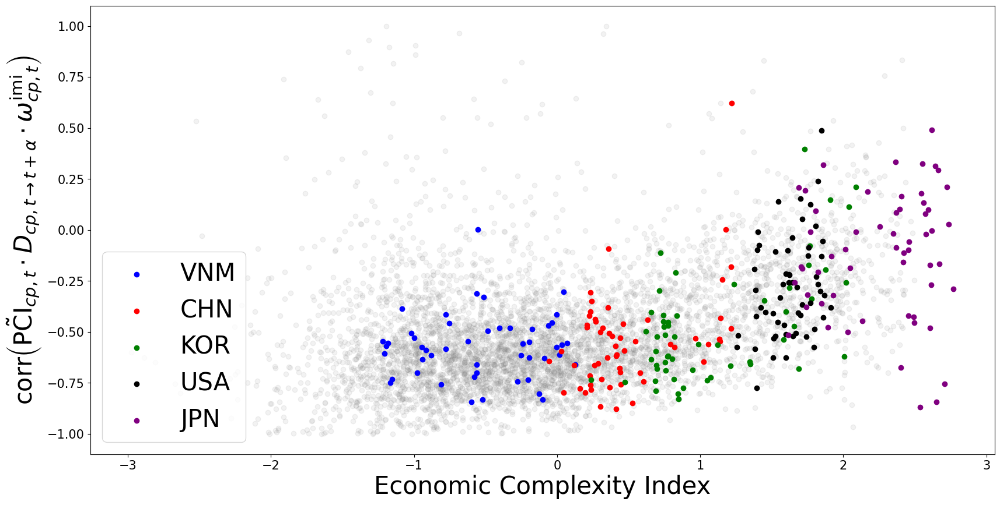

In [15]:
fig = plt.figure(figsize=(20,10))
ax = plt.subplot(111)
ax.tick_params(
    labelsize=15
)
ax.scatter(temp_corr_df['ECI'],temp_corr_df['corr3'],color='grey',alpha=0.1)
ax.set_xlabel('Economic Complexity Index', size=30)
ax.set_ylabel(
    r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \omega_{cp,t}^{\text{imi}}\right)$",
    size=30,
)

temp_df = temp_corr_df[temp_corr_df['name']=='VNM']
ax.scatter(temp_df['ECI'],temp_df['corr3'],color='blue',alpha=1,label='VNM')

temp_df = temp_corr_df[temp_corr_df['name']=='CHN']
ax.scatter(temp_df['ECI'],temp_df['corr3'],color='red',alpha=1,label='CHN')

temp_df = temp_corr_df[temp_corr_df['name']=='KOR']
ax.scatter(temp_df['ECI'],temp_df['corr3'],color='green',alpha=1,label='KOR')

temp_df = temp_corr_df[temp_corr_df['name']=='USA']
ax.scatter(temp_df['ECI'],temp_df['corr3'],color='black',alpha=1,label='USA')

temp_df = temp_corr_df[temp_corr_df['name']=='JPN']
ax.scatter(temp_df['ECI'],temp_df['corr3'],color='purple',alpha=1,label='JPN')

# Adding a legend with a larger font size
ax.legend(loc='lower left', fontsize=30)
#plt.tight_layout()
plt.savefig(output_directory+'/Scatter Plot_ECI_corr_RID_RPC_countries.jpg',dpi=600)

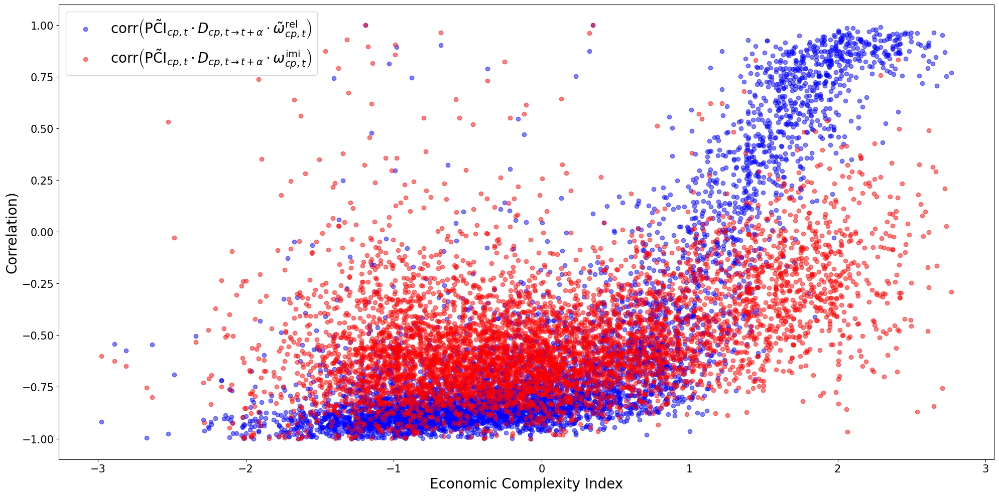

In [16]:
fig = plt.figure(figsize=(20,10))
ax = plt.subplot(111)
ax.tick_params(
    labelsize=15
)

ax.scatter(temp_corr_df['ECI'],temp_corr_df['corr2'],color='blue',alpha=0.5,label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \tilde\omega_{cp,t}^{\text{rel}}\right)$",)
ax.scatter(temp_corr_df['ECI'],temp_corr_df['corr3'],color='red',alpha=0.5,label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \omega_{cp,t}^{\text{imi}}\right)$",)

ax.set_xlabel('Economic Complexity Index',size=20)
ax.set_ylabel('Correlation)',size=20)
ax.legend(loc='upper left',fontsize=20)
plt.tight_layout()
plt.savefig(output_directory+'/Scatter Plot_ECI_corr.jpg',dpi=600)


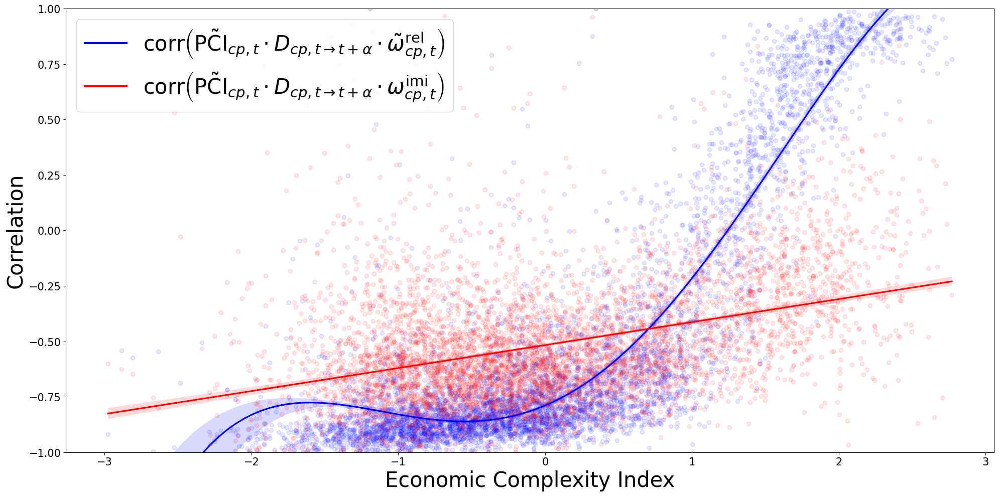

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.lines import Line2D

# Create the figure and axis
fig = plt.figure(figsize=(20, 10))
ax = plt.subplot(111)

# Customize tick parameters
ax.tick_params(labelsize=15)

# Plotting the regression plots
sns.regplot(
    x=temp_corr_df['ECI'],
    y=temp_corr_df['corr2'],
    color='blue',
    scatter_kws={'alpha': 0.1},
    order=4
)
sns.regplot(
    x=temp_corr_df['ECI'],
    y=temp_corr_df['corr3'],
    color='red',
    scatter_kws={'alpha': 0.1},
    order=1
)

# Set axis labels
ax.set_xlabel('Economic Complexity Index', size=30)
ax.set_ylabel('Correlation', size=30)

# Define custom legend
custom_legend = [
    Line2D([0], [0], color='blue', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \tilde\omega_{cp,t}^{\text{rel}}\right)$"),
    Line2D([0], [0], color='red', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \omega_{cp,t}^{\text{imi}}\right)$")
]

ax.set_ylim(-1,1)
# Add the custom legend to the plot
ax.legend(handles=custom_legend, loc='upper left', fontsize=30)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig(output_directory + '/Scatter_Plot_ECI_corr_custom_legend.jpg', dpi=600)


In [18]:
temp_corr_df2 = temp_corr_df.copy()
temp_corr_df2 = temp_corr_df2[temp_corr_df2['ECI']<0]
temp_corr_df2 = temp_corr_df2[temp_corr_df2['ECI']>=-2]
temp_corr_df2[['corr1','corr2','corr3','corr4','ECI']].corr()

,corr1,corr2,corr3,corr4,ECI
corr1,1.000000,-0.137407,-0.560234,-0.560234,0.124518
corr2,-0.137407,1.000000,0.499302,0.499302,0.154696
corr3,-0.560234,0.499302,1.000000,1.000000,-0.015239
corr4,-0.560234,0.499302,1.000000,1.000000,-0.015239
ECI,0.124518,0.154696,-0.015239,-0.015239,1.000000


In [19]:
temp_corr_df2 = temp_corr_df.copy()
temp_corr_df2 = temp_corr_df2[temp_corr_df2['ECI']>=0]
temp_corr_df2[['corr1','corr2','corr3','corr4','ECI']].corr()

,corr1,corr2,corr3,corr4,ECI
corr1,1.000000,-0.776419,-0.301370,-0.301370,-0.708573
corr2,-0.776419,1.000000,0.625082,0.625082,0.891857
corr3,-0.301370,0.625082,1.000000,1.000000,0.533320
corr4,-0.301370,0.625082,1.000000,1.000000,0.533320
ECI,-0.708573,0.891857,0.533320,0.533320,1.000000


In [20]:
temp_corr_df[['corr1','corr2','corr3','corr4','ECI']].corr()

,corr1,corr2,corr3,corr4,ECI
corr1,1.000000,-0.707041,-0.438541,-0.438541,-0.515572
corr2,-0.707041,1.000000,0.572562,0.572562,0.797081
corr3,-0.438541,0.572562,1.000000,1.000000,0.386990
corr4,-0.438541,0.572562,1.000000,1.000000,0.386990
ECI,-0.515572,0.797081,0.386990,0.386990,1.000000


In [21]:
temp_corr_df['corr3']

,corr3
0,-0.965823
1,-0.677391
2,-0.462777
3,0.023911
4,-0.996147
...,...
5594,-0.563279
5595,-0.989751
5596,-0.482212
5597,-0.168718


In [22]:
temp_corr_df['corr2']

,corr2
0,-0.963595
1,-0.744364
2,-0.296480
3,-0.168199
4,-0.985426
...,...
5594,-0.783550
5595,-0.981486
5596,-0.905136
5597,-0.868888


In [23]:
sitc_dictionary_df=pd.read_csv(data_directory+'/sitc_product.tab',delimiter='\t')
sitc_dictionary_df['sitc_product_code']=sitc_dictionary_df['sitc_product_code'].apply(lambda item:str(item).zfill(4))
temp_sitc_dict=dict(zip(
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_code'],
    sitc_dictionary_df[sitc_dictionary_df['level']=='4digit']['sitc_product_name_short_en']
))

In [25]:
temp_corr_df

,name,year,corr1,corr2,corr3,corr4,ECI
0,ARG,1962,0.943252,-0.963595,-0.965823,-0.965823,-0.546232
1,AUS,1962,0.905040,-0.744364,-0.677391,-0.677391,-0.188033
2,AUT,1962,0.750627,-0.296480,-0.462777,-0.462777,1.803938
3,BEL,1962,0.868588,-0.168199,0.023911,0.023911,1.439318
4,BOL,1962,0.996424,-0.985426,-0.996147,-0.996147,-0.383369
...,...,...,...,...,...,...,...
5594,VNM,2018,0.856032,-0.783550,-0.563279,-0.563279,0.032839
5595,YEM,2018,0.998779,-0.981486,-0.989751,-0.989751,-1.374111
5596,ZAF,2018,0.695984,-0.905136,-0.482212,-0.482212,-0.024953
5597,ZMB,2018,0.553323,-0.868888,-0.168718,-0.168718,-0.670744


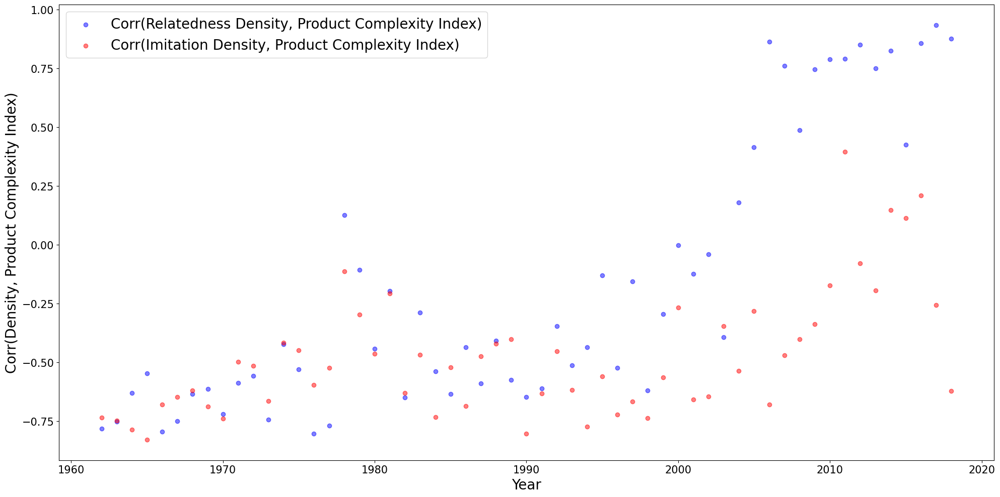

In [26]:
fig = plt.figure(figsize=(20,10))
ax = plt.subplot(111)
ax.tick_params(
    labelsize=15
)

temp_corr_df_2 = temp_corr_df[temp_corr_df['name']=='KOR']
ax.scatter(temp_corr_df_2['year'],temp_corr_df_2['corr2'],color='blue',alpha=0.5,label='Corr(Relatedness Density, Product Complexity Index)')
ax.scatter(temp_corr_df_2['year'],temp_corr_df_2['corr3'],color='red',alpha=0.5,label='Corr(Imitation Density, Product Complexity Index)')

ax.set_xlabel('Year',size=20)
ax.set_ylabel('Corr(Density, Product Complexity Index)',size=20)
ax.legend(loc='upper left',fontsize=20)
plt.tight_layout()
plt.savefig(output_directory+'/Scatter Plot_year_corr_KOR.jpg',dpi=600)


In [29]:
# Define custom legend
custom_legend = [
    Line2D([0], [0], color='blue', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \tilde\omega_{cp,t}^{\text{rel}}\right)$"),
    Line2D([0], [0], color='red', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \omega_{cp,t}^{\text{imi}}\right)$")
]

# Add the custom legend to the plot
ax.legend(handles=custom_legend, loc='upper left', fontsize=20)

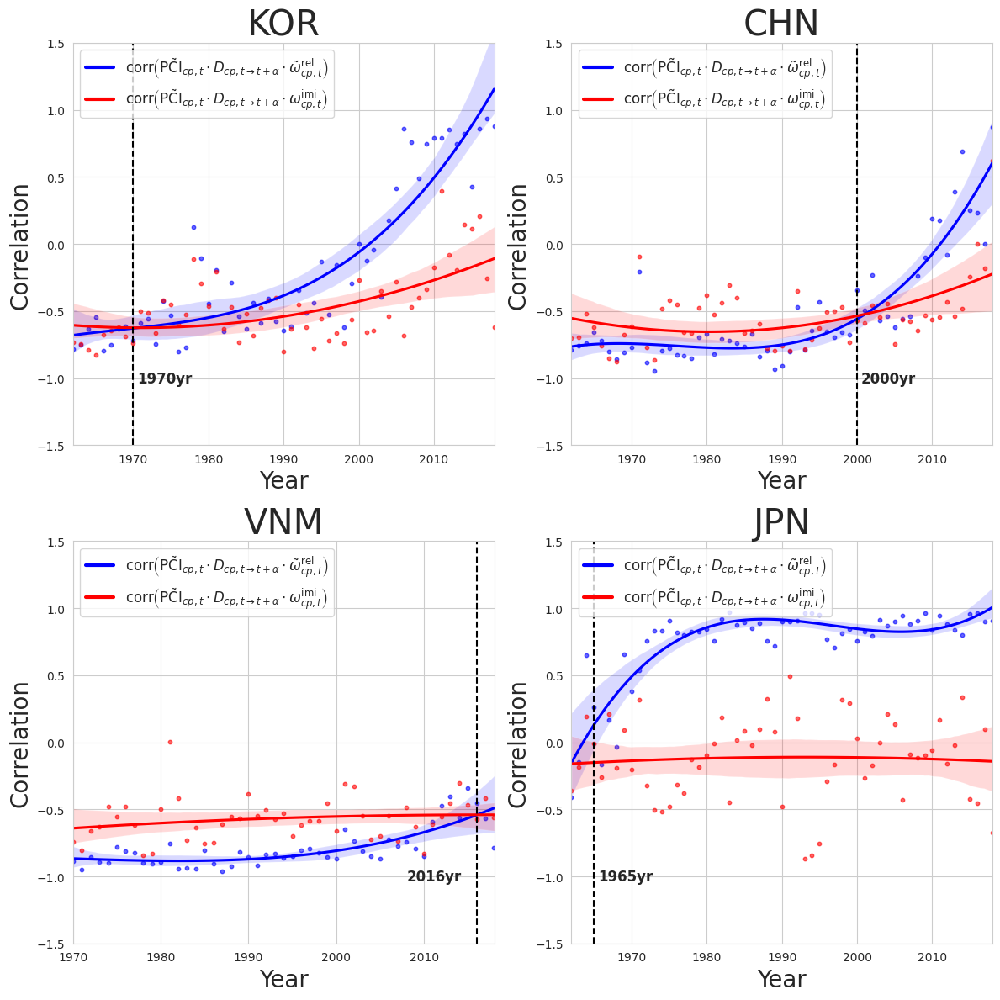

In [30]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Create a 2x2 panel for the countries
fig, axes = plt.subplots(2, 2, figsize=(12, 12))

# Set the common plot style
sns.set_style("whitegrid")

# List of countries, their respective datasets, and year annotations
countries = [
    {"name": "KOR", "year": 1970},
    {"name": "CHN", "year": 2000},
     {"name": "VNM", "year": 2016},
    {"name": "JPN", "year": 1965},

]

# Define custom legend
custom_legend = [
    Line2D([0], [0], color='blue', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \tilde\omega_{cp,t}^{\text{rel}}\right)$"),
    Line2D([0], [0], color='red', lw=3, label=r"$\text{corr}\left(\tilde{\text{PCI}}_{cp,t} \cdot D_{cp,t \to t+\alpha} \cdot \omega_{cp,t}^{\text{imi}}\right)$")
]

# Iterate over countries to create each subplot
for ax, country in zip(axes.flatten(), countries):
    # Filter the data for the country
    temp_df = temp_corr_df[temp_corr_df["name"] == country["name"]]

    # Polynomial regression for `corr2`
    sns.regplot(
        data=temp_df,
        x="year",
        y="corr2",
        lowess=False,  # Disable LOWESS, enable polynomial
        order=3,  # Polynomial degree 3
        scatter_kws={"color": "blue", "s": 10, "alpha": 0.6},
        line_kws={"color": "blue"},
        ax=ax
    )

    # Polynomial regression for `corr3`
    sns.regplot(
        data=temp_df,
        x="year",
        y="corr3",
        lowess=False,
        order=2,  # Polynomial degree 2
        scatter_kws={"color": "red", "s": 10, "alpha": 0.6},
        line_kws={"color": "red"},
        ax=ax
    )

    # Add vertical line and text annotation for the specified year
    ax.axvline(x=country["year"], color="black", linestyle="--")
    ax.text(
        country["year"] + (0.5 if country["name"] != "VNM" else -8), -1, f"{country['year']}yr",
        fontsize=12, va="center", ha="left", weight='bold'
    )

    # Set title, labels, and limits
    ax.set_title(f"{country['name']}", fontsize=30)
    ax.set_xlabel('Year', size=20)
    ax.set_ylabel('Correlation', size=20)
    ax.set_ylim(-1.5, 1.5)
    ax.set_xlim(temp_df["year"].min(), temp_df["year"].max())

    # Add the custom legend to each subplot
    ax.legend(handles=custom_legend, loc="upper left", fontsize=12)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [31]:
Regression_df.head()

,country,product,year,binary_rca,relatedness_density,Relative_relatedness_density,imitation_density,Relative_imitation_density,Relative_pci,eci,...,continent,imitation_density_2,imitation_density_3,imitation_density_4,Relative_imitation_density_2,Relative_imitation_density_3,Relative_imitation_density_4,imitation_density_4_dist,log_rnna,log_pop
2247,ARG,0012,1962,0,0.180504,2.900051,0.185487,1.590993,-1.733402,-0.546232,...,America,0.085323,0.216255,0.152149,0.843815,1.222042,1.268736,0.369529,13.37729,3.100595
2248,ARG,0013,1962,0,0.098210,0.900775,0.153125,1.085272,-0.893986,-0.546232,...,America,0.078971,0.211622,0.129657,0.702102,1.152916,0.913604,0.035132,13.37729,3.100595
2249,ARG,0014,1962,0,0.071293,0.246856,0.089388,0.089243,-0.566155,-0.546232,...,America,0.052156,0.142057,0.081474,0.103868,0.115016,0.152799,0.025227,13.37729,3.100595
2250,ARG,0114,1962,0,0.089616,0.692000,0.112895,0.456598,-0.272348,-0.546232,...,America,0.036594,0.216505,0.087775,-0.243317,1.225774,0.252296,0.027362,13.37729,3.100595
2251,ARG,0121,1962,0,0.101831,0.988756,0.083211,-0.007283,-0.194704,-0.546232,...,America,0.021372,0.155597,0.062100,-0.582925,0.317030,-0.153116,0.018445,13.37729,3.100595


In [33]:
temp_df = Regression_df[(Regression_df['country']=='KOR') & (Regression_df['binary_rca']==1) & (Regression_df['year']==year)]
temp_df

,country,product,year,binary_rca,relatedness_density,Relative_relatedness_density,imitation_density,Relative_imitation_density,Relative_pci,eci,...,continent,imitation_density_2,imitation_density_3,imitation_density_4,Relative_imitation_density_2,Relative_imitation_density_3,Relative_imitation_density_4,imitation_density_4_dist,log_rnna,log_pop
4694015,KOR,0589,2018,1,0.194220,-0.853204,0.326387,1.347551,-0.798478,2.006672,...,Asia,0.297443,0.345444,0.284056,1.724319,1.055894,1.279976,0.089573,16.151965,3.95454
4694128,KOR,2881,2018,1,0.217267,-0.190995,0.345967,1.572359,-0.001542,2.006672,...,Asia,0.265545,0.371528,0.328942,1.338627,1.315648,1.867362,0.067457,16.151965,3.95454
4694169,KOR,5113,2018,1,0.275345,1.477698,0.157289,-0.593985,0.788035,2.006672,...,Asia,0.073161,0.213953,0.166712,-0.987581,-0.253543,-0.255623,0.101876,16.151965,3.95454
4694179,KOR,5155,2018,1,0.278103,1.556952,0.106192,-1.180669,1.774975,2.006672,...,Asia,0.045747,0.156603,0.119941,-1.319063,-0.824660,-0.867692,0.091012,16.151965,3.95454
4694182,KOR,5161,2018,1,0.262531,1.109525,0.164789,-0.507875,0.612289,2.006672,...,Asia,0.093988,0.196855,0.168892,-0.735757,-0.423816,-0.227097,0.041040,16.151965,3.95454
4694187,KOR,5232,2018,1,0.217919,-0.172284,0.259701,0.581879,-0.315675,2.006672,...,Asia,0.199069,0.281580,0.232446,0.534829,0.419908,0.604586,0.209678,16.151965,3.95454
4694221,KOR,5922,2018,1,0.254817,0.887885,0.233394,0.279832,1.122255,2.006672,...,Asia,0.126502,0.303532,0.212331,-0.342616,0.638520,0.341359,0.081643,16.151965,3.95454
4694224,KOR,5989,2018,1,0.253903,0.861630,0.265000,0.642726,0.873294,2.006672,...,Asia,0.149987,0.327247,0.257960,-0.058638,0.874683,0.938475,0.232337,16.151965,3.95454
4694311,KOR,6658,2018,1,0.284433,1.738809,0.243569,0.396662,1.302598,2.006672,...,Asia,0.097993,0.323839,0.231133,-0.687330,0.840745,0.587401,0.258834,16.151965,3.95454
4694370,KOR,7187,2018,1,0.246296,0.643061,0.072657,-1.565702,1.390559,2.006672,...,Asia,0.031805,0.095597,0.062720,-1.487633,-1.432174,-1.616500,0.012209,16.151965,3.95454


In [34]:
code2sitc_dict = dict(zip(sitc_dictionary_df['sitc_product_code'],sitc_dictionary_df['sitc_product_name_short_en']))

In [35]:
Regression_df['sitc_description'] = Regression_df['product'].map(code2sitc_dict)

In [36]:
temp_result_list = []

start_year = 1962
end_year = 2018
year_list = [year for year in range(start_year,end_year+1)]

temp_pcis1 = []
temp_densities1 = []
for year in range(1962,1971):
    temp_df = Regression_df[(Regression_df['country']=='KOR') & (Regression_df['binary_rca']==1) & (Regression_df['year']==year)]
    temp_df = temp_df.sort_values(by='Relative_relatedness_density',ascending=False)
    print(year)
    temp_string = ''
    for item in range(0,5):
      try:
        #print(temp_df.iloc[item]['product'])
        #print(temp_df.iloc[item]['sitc_description'])
        #print(temp_df.iloc[item]['Relative_pci'])
        #print(temp_df.iloc[item]['Relative_relatedness_density'])
        temp_pci = temp_df.iloc[item]["Relative_pci"]
        temp_pcis1.append(temp_pci)
        temp_density = temp_df.iloc[item]["Relative_relatedness_density"]
        temp_densities1.append(temp_density)
        temp_string += ' '+ temp_df.iloc[item]['sitc_description'] + ' '+f'({round(temp_pci,2)}, {round(temp_density,2)}),'
      except:
        pass
    print(temp_string.strip())
    print('--------------------------------------------')


1962
Copper ore and concentrates; copper matte; cement copper (-1.77, 2.26), Refined sugar etc (-1.5, 2.17), Cement (-0.95, 2.15), Horsehair and other coarse animal hair, not carded or combed (-1.65, 2.05), Other fresh, chilled or frozen meat or edible meat offal (-0.79, 1.93),
--------------------------------------------
1963
Bags, sacks of textile materials, for the packing of goods (-1.54, 2.54), Other fresh, chilled or frozen meat or edible meat offal (-0.76, 2.08), Beans, peas, other leguminous vegetables, dried, shelled (-1.84, 2.02), Cement (-0.97, 1.99), True hemp, raw or processed but not spun, its tow and waste (-1.41, 1.94),
--------------------------------------------
1964
Cotton fabrics, woven, bleached, dyed, etc, or otherwise finished (-0.41, 2.09), Bags, sacks of textile materials, for the packing of goods (-1.42, 1.97), Articles of apparel, clothing accessories of leather (-0.11, 1.92), Beans, peas, other leguminous vegetables, dried, shelled (-1.74, 1.63), Wood, simpl

In [37]:
temp_result_list = []

start_year = 1962
end_year = 2018
year_list = [year for year in range(start_year,end_year+1)]
temp_pcis2 = []
temp_densities2 = []
for year in range(1962,1971):
    temp_df = Regression_df[(Regression_df['country']=='KOR') & (Regression_df['binary_rca']==1) & (Regression_df['year']==year)]
    temp_df = temp_df.sort_values(by='imitation_density_4',ascending=False)
    print(year)
    temp_string = ''
    for item in range(0,5):
      try:
        #print(temp_df.iloc[item]['product'])
        #print(temp_df.iloc[item]['sitc_description'])
        #print(temp_df.iloc[item]['Relative_pci'])
        #print(temp_df.iloc[item]['imitation_density_4'])
        temp_pci = temp_df.iloc[item]["Relative_pci"]
        temp_pcis2.append(temp_pci)
        temp_density = temp_df.iloc[item]["imitation_density_4"]
        temp_densities2.append(temp_density)
        temp_string += ' '+ temp_df.iloc[item]['sitc_description'] + ' '+f'({round(temp_pci,2)}, {round(temp_density,2)}),'
      except:
        pass
    print(temp_string.strip())
    print('--------------------------------------------')


1962
Refined sugar etc (-1.5, 0.29), Cement (-0.95, 0.27), Essential oil, resinoid, etc (-1.59, 0.24), Horsehair and other coarse animal hair, not carded or combed (-1.65, 0.23), Other fresh, chilled or frozen meat or edible meat offal (-0.79, 0.22),
--------------------------------------------
1963
Beans, peas, other leguminous vegetables, dried, shelled (-1.84, 0.38), Cement (-0.97, 0.3), Vegetable products roots and tubers, nes, fresh, dried (-1.62, 0.25), Refined sugar etc (-1.3, 0.25), Horsehair and other coarse animal hair, not carded or combed (-1.57, 0.24),
--------------------------------------------
1964
Beans, peas, other leguminous vegetables, dried, shelled (-1.74, 0.33), Cotton fabrics, woven, bleached, dyed, etc, or otherwise finished (-0.41, 0.24), Tobacco, not stripped (-2.12, 0.22), Tobacco, wholly or partly stripped (-2.12, 0.22), Tobacco refuse (-2.12, 0.22),
--------------------------------------------
1965
Tobacco, not stripped (-2.07, 0.23), Tobacco, wholly or pa